In [1]:
from multi_imbalance.datasets import load_datasets
import experiment_safeness20 as ex
from sklearn.model_selection import StratifiedKFold
from collections import Counter, defaultdict
from multi_imbalance.utils.metrics import gmean_score
from sklearn.metrics import f1_score
from sklearn.ensemble import RandomForestClassifier
from sklearn.neighbors import KNeighborsClassifier
import numpy as np
import pandas as pd
from sklearn.tree import DecisionTreeClassifier
from utils import plot_embeddings
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis, QuadraticDiscriminantAnalysis

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/utils/deprecation.py:143: FutureWarning: The sklearn.datasets.base module is  deprecated in version 0.22 and will be removed in version 0.24. The corresponding classes / functions should instead be imported from sklearn.datasets. Anything that cannot be imported from sklearn.datasets is now part of the private API.
  warnings.warn(message, FutureWarning)


In [2]:
datasets = load_datasets()

In [3]:
ds_name = 'hayes-roth'
test_on_all_folds = True
test_all_ds = True

In [4]:
datasets = ex.one_hot_encode_all(datasets)

In [5]:
config = ex.config_calculation_strategy2(datasets)

In [6]:
config['cmc'] = {'nn_config': {'units_1st_layer': 17,
                               'units_2nd_layer': 256,
                               'units_3rd_layer': 128,
                               'units_latent_layer': 8},
                 'weighted_triplet_loss': True,
                 'lr': 0.0002,
                 'batch_size': 16,
                 'gamma': 0.99,
                 'epochs': 30}


config['dermatology'] = {'nn_config': {'units_1st_layer': 97,
                                       'units_2nd_layer': 512,
                                       'units_3rd_layer': 256,
                                       'units_latent_layer': 16},
                         'weighted_triplet_loss': True,
                         'lr': 0.0010,
                         'batch_size': 16,
                         'gamma': 0.99,
                         'epochs': 45}

config['hayes-roth'] = {'nn_config': {'units_1st_layer': 11,
                                      'units_2nd_layer': 128,
                                      'units_3rd_layer': 64,
                                      'units_latent_layer': 16},
                        'weighted_triplet_loss': True,
                        'lr': 0.0015,
                        'batch_size': 16,
                        'gamma': 0.99,
                        'epochs': 30}

config['new_vehicle'] = {'nn_config': {'units_1st_layer': 18,
                                       'units_2nd_layer': 256,
                                       'units_3rd_layer': 128,
                                       'units_latent_layer': 16},
                         'weighted_triplet_loss': True,
                         'lr': 0.001,
                         'batch_size': 16,
                         'gamma': 0.99,
                         'epochs': 45}

config['new_yeast'] = {'nn_config': {'units_1st_layer': 9,
                                     'units_2nd_layer': 300,
                                     'units_3rd_layer': 200,
                                     'units_latent_layer': 12},
                       'weighted_triplet_loss': True,
                       'lr': 0.0004,
                       'batch_size': 32,
                       'gamma': 0.99,
                       'epochs': 60}

config['balance-scale'] = {'nn_config': {'units_1st_layer': 16,
                                         'units_2nd_layer': 256,
                                         'units_3rd_layer': 128,
                                         'units_latent_layer': 10},
                           'weighted_triplet_loss': True,
                           'lr': 0.007,
                           'batch_size': 16,
                           'gamma': 0.99,
                           'epochs': 50}

config['cleveland'] = {'nn_config': {'units_1st_layer': 24,
                                     'units_2nd_layer': 72,
                                     'units_3rd_layer': 48,
                                     'units_latent_layer': 16},
                       'weighted_triplet_loss': True,
                       'lr': 0.00002,
                       'batch_size': 16,
                       'gamma': 0.99,
                       'epochs': 50}

config['cleveland_v2'] = {'nn_config': {'units_1st_layer': 23,
                                        'units_2nd_layer': 256,
                                        'units_3rd_layer': 128,
                                        'units_latent_layer': 16},
                          'weighted_triplet_loss': True,
                          'lr': 0.00002,
                          'batch_size': 16,
                          'gamma': 0.99,
                          'epochs': 50}

config['glass'] = {'nn_config': {'units_1st_layer': 9,
                                 'units_2nd_layer': 256,
                                 'units_3rd_layer': 128,
                                 'units_latent_layer': 12},
                   'weighted_triplet_loss': True,
                   'lr': 0.001,
                   'batch_size': 16,
                   'gamma': 0.99,
                   'epochs': 50}

config['thyroid-newthyroid'] = {'nn_config': {'units_1st_layer': 5,
                                              'units_2nd_layer': 64,
                                              'units_3rd_layer': 32,
                                              'units_latent_layer': 8},
                                'weighted_triplet_loss': True,
                                'lr': 0.001,
                                'batch_size': 16,
                                'gamma': 0.99,
                                'epochs': 50}

config['new_ecoli'] = {'nn_config': {'units_1st_layer': 7,
                                     'units_2nd_layer': 128,
                                     'units_3rd_layer': 64,
                                     'units_latent_layer': 12},
                       'weighted_triplet_loss': True,
                       'lr': 0.0001,
                       'batch_size': 16,
                       'gamma': 0.99,
                       'epochs': 50}

config['new_led7digit'] = {'nn_config': {'units_1st_layer': 7,
                                         'units_2nd_layer': 64,
                                         'units_3rd_layer': 32,
                                         'units_latent_layer': 8},
                           'weighted_triplet_loss': True,
                           'lr': 0.001,
                           'batch_size': 16,
                           'gamma': 0.99,
                           'epochs': 50}

config['new_winequality-red'] = {'nn_config': {'units_1st_layer': 11,
                                               'units_2nd_layer': 128,
                                               'units_3rd_layer': 64,
                                               'units_latent_layer': 12},
                                 'weighted_triplet_loss': True,
                                 'lr': 0.003,
                                 'batch_size': 16,
                                 'gamma': 0.99,
                                 'epochs': 50}

config['4delikatne-bezover-cut'] = {'nn_config': {'units_1st_layer': 2,
                                                  'units_2nd_layer': 128,
                                                  'units_3rd_layer': 64,
                                                  'units_latent_layer': 8},
                                    'weighted_triplet_loss': True,
                                    'lr': 0.004,
                                    'batch_size': 16,
                                    'gamma': 0.99,
                                    'epochs': 50}

config['3mocniej-cut'] = {'nn_config': {'units_1st_layer': 2,
                                        'units_2nd_layer': 128,
                                        'units_3rd_layer': 64,
                                        'units_latent_layer': 10},
                          'weighted_triplet_loss': True,
                          'lr': 0.04,
                          'batch_size': 16,
                          'gamma': 0.99,
                          'epochs': 50}


config['1czysty-cut'] = {'nn_config': {'units_1st_layer': 2,
                                       'units_2nd_layer': 64,
                                       'units_3rd_layer': 32,
                                       'units_latent_layer': 8},
                         'weighted_triplet_loss': True,
                         'lr': 0.004,
                         'batch_size': 16,
                         'gamma': 0.99,
                         'epochs': 50}

config['2delikatne-cut'] = {'nn_config': {'units_1st_layer': 2,
                                          'units_2nd_layer': 128,
                                          'units_3rd_layer': 64,
                                          'units_latent_layer': 12},
                            'weighted_triplet_loss': True,
                            'lr': 0.04,
                            'batch_size': 16,
                            'gamma': 0.99,
                            'epochs': 50}

In [7]:
config

{'1czysty-cut': {'nn_config': {'units_1st_layer': 2,
   'units_2nd_layer': 64,
   'units_3rd_layer': 32,
   'units_latent_layer': 8},
  'weighted_triplet_loss': True,
  'lr': 0.004,
  'batch_size': 16,
  'gamma': 0.99,
  'epochs': 50},
 '2delikatne-cut': {'nn_config': {'units_1st_layer': 2,
   'units_2nd_layer': 128,
   'units_3rd_layer': 64,
   'units_latent_layer': 12},
  'weighted_triplet_loss': True,
  'lr': 0.04,
  'batch_size': 16,
  'gamma': 0.99,
  'epochs': 50},
 '3mocniej-cut': {'nn_config': {'units_1st_layer': 2,
   'units_2nd_layer': 128,
   'units_3rd_layer': 64,
   'units_latent_layer': 10},
  'weighted_triplet_loss': True,
  'lr': 0.04,
  'batch_size': 16,
  'gamma': 0.99,
  'epochs': 50},
 '4delikatne-bezover-cut': {'nn_config': {'units_1st_layer': 2,
   'units_2nd_layer': 128,
   'units_3rd_layer': 64,
   'units_latent_layer': 8},
  'weighted_triplet_loss': True,
  'lr': 0.004,
  'batch_size': 16,
  'gamma': 0.99,
  'epochs': 50},
 'balance-scale': {'nn_config': {'unit

In [8]:
def instantiate_classifiers():
    classifiers = {
            "RF24": RandomForestClassifier(random_state=0, min_samples_leaf=2, min_samples_split=4, class_weight='balanced'),
            "DT": DecisionTreeClassifier(random_state=0, min_samples_split=4, min_samples_leaf=2, class_weight='balanced'),
            "KNN": KNeighborsClassifier(n_neighbors=1),
            "QDA": QuadraticDiscriminantAnalysis(),
            "LDA": LinearDiscriminantAnalysis()
        } 
    return classifiers

In [9]:
from experiment import dt_name_to_cols_to_encode


In [10]:
from sklearn.neighbors import KNeighborsClassifier

def calc_safety5(X,y):
    result = {
        "safe":0,
        "borderline":0,
        "rare":0,
        "outlier":0
    }
    neigh = KNeighborsClassifier(n_neighbors=5)
    neigh.fit(X, y)
    neighbors = neigh.kneighbors(X, 5+1, False)
    for i, (x, nbors) in enumerate(list(zip(X, neighbors))):
#         print(x)
#         print(y[i])
#         print(nbors[1:])
#         print(y[nbors[1:]])
        same_class_nbrs = (y[nbors[1:]] == y[i]).sum()
        if same_class_nbrs >= 4:
            result['safe'] += 1
        elif same_class_nbrs >= 2:
            result['borderline'] += 1
        elif same_class_nbrs == 1:
            result['rare'] += 1
        else:
            result['outlier'] += 1
    return result

In [11]:
def standardize(X_train, X_test):
    means = X_train.mean(axis=0)
    stds = X_train.std(axis=0)
    return (X_train - means) / (stds+1e-6), (X_test - means) / (stds + 1e-6)

cmc


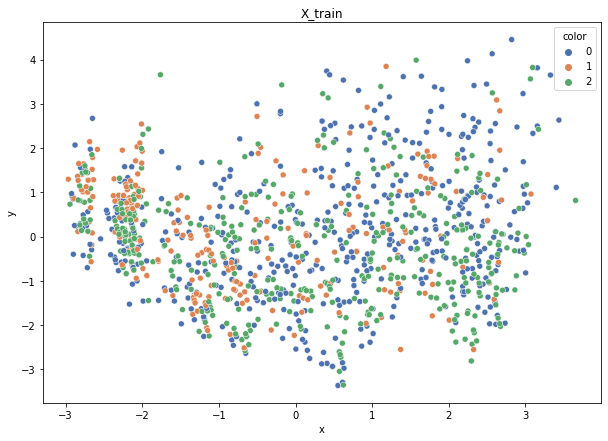

Class cardinalities: Counter({0: 503, 2: 409, 1: 266})
Weights: {0: 0.2426709552796112, 1: 0.45888530265279864, 2: 0.29844374206759033}


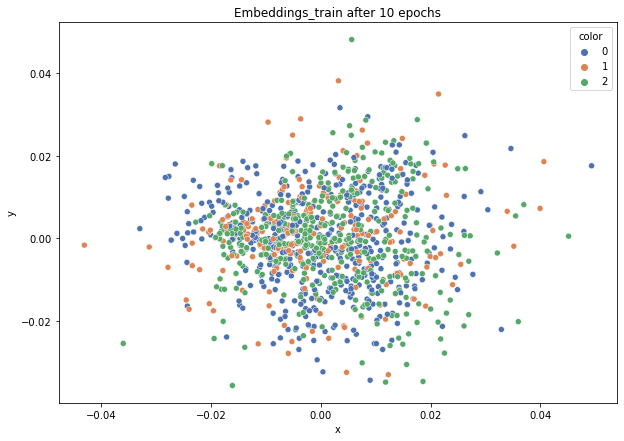

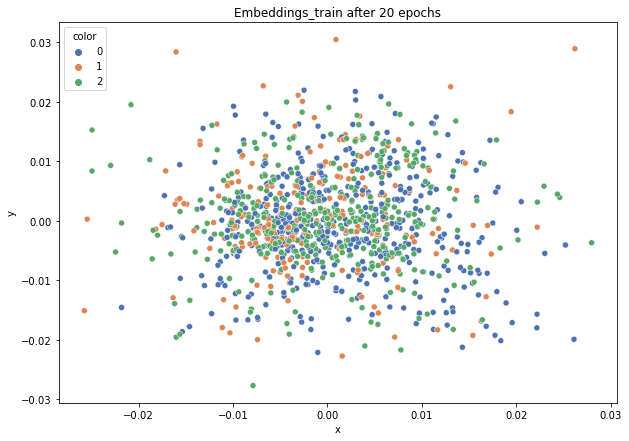

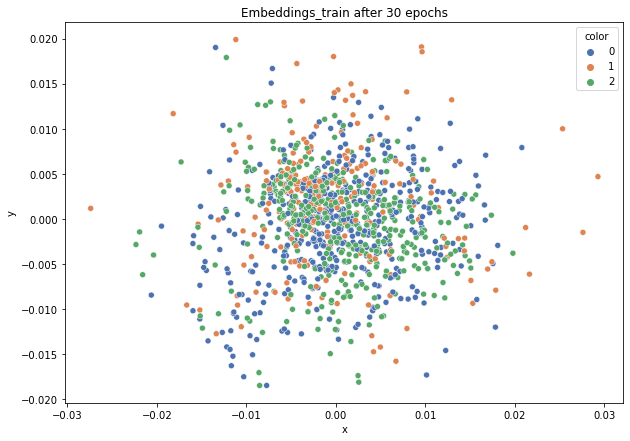

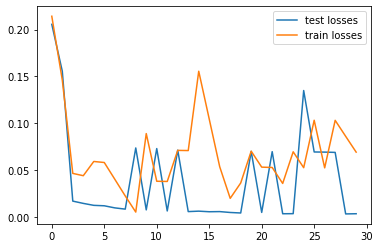

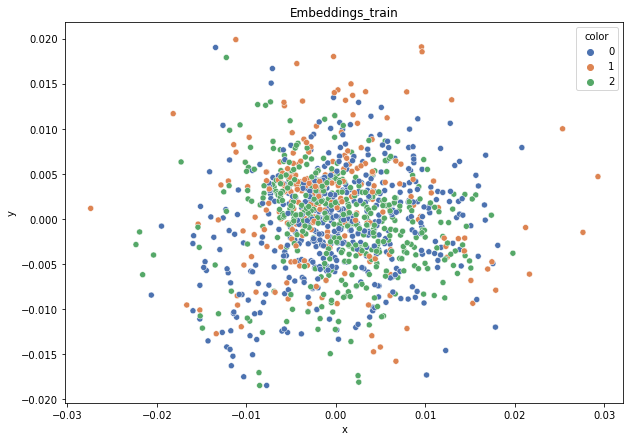

DT-f1-new-features: 0.322
DT-f1-old+new-features: 0.405
DT-f1-old-features: 0.469
DT-gmean-new-features: 0.327
DT-gmean-old+new-features: 0.407
DT-gmean-old-features: 0.467
KNN-f1-new-features: 0.397
KNN-f1-old+new-features: 0.428
KNN-f1-old-features: 0.431
KNN-gmean-new-features: 0.399
KNN-gmean-old+new-features: 0.422
KNN-gmean-old-features: 0.425
LDA-f1-new-features: 0.307
LDA-f1-old+new-features: 0.437
LDA-f1-old-features: 0.482
LDA-gmean-new-features: 0.289
LDA-gmean-old+new-features: 0.439
LDA-gmean-old-features: 0.47
QDA-f1-new-features: 0.35
QDA-f1-old+new-features: 0.437
QDA-f1-old-features: 0.483
QDA-gmean-new-features: 0.338
QDA-gmean-old+new-features: 0.445
QDA-gmean-old-features: 0.496
RF24-f1-new-features: 0.393
RF24-f1-old+new-features: 0.464
RF24-f1-old-features: 0.519
RF24-gmean-new-features: 0.382
RF24-gmean-old+new-features: 0.456
RF24-gmean-old-features: 0.523


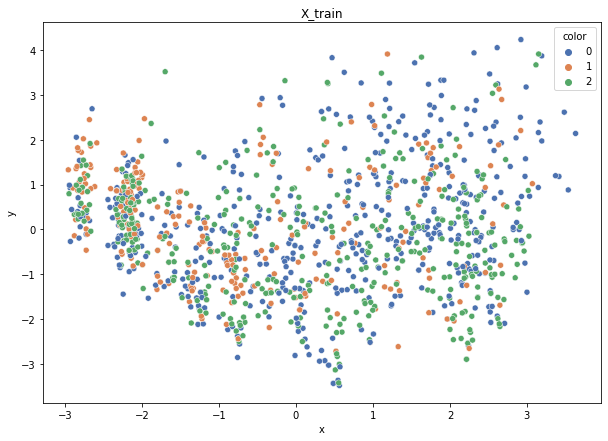

Class cardinalities: Counter({0: 503, 2: 409, 1: 266})
Weights: {0: 0.2426709552796112, 1: 0.45888530265279864, 2: 0.29844374206759033}


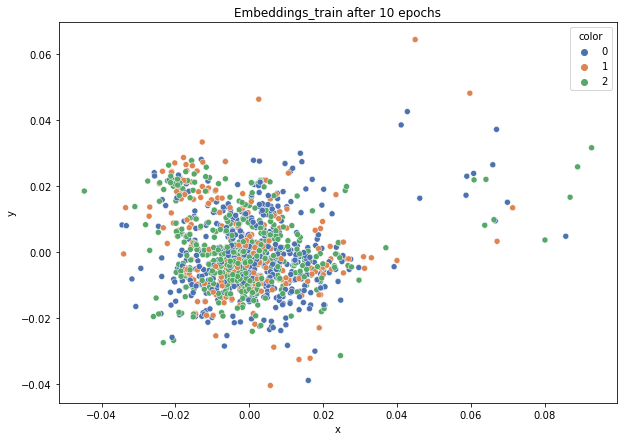

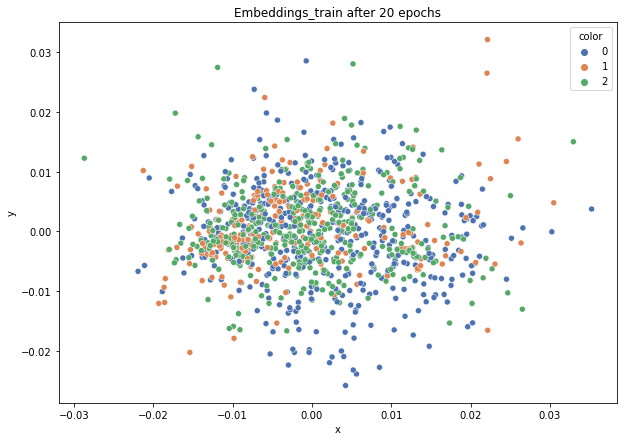

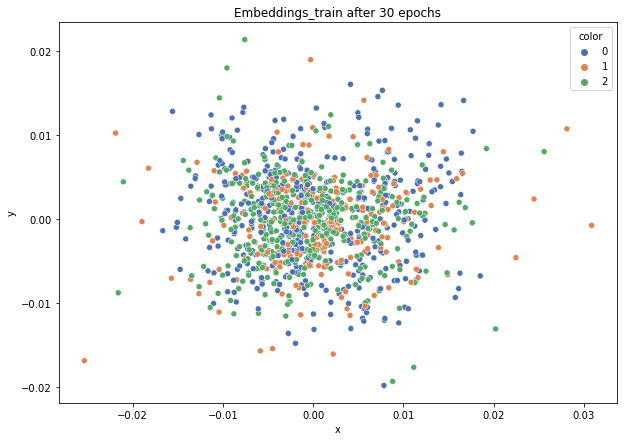

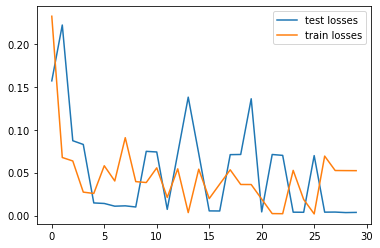

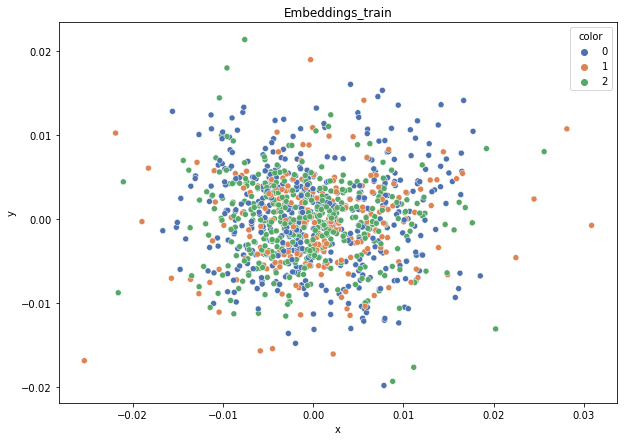

DT-f1-new-features: 0.372
DT-f1-old+new-features: 0.419
DT-f1-old-features: 0.491
DT-gmean-new-features: 0.375
DT-gmean-old+new-features: 0.42
DT-gmean-old-features: 0.503
KNN-f1-new-features: 0.407
KNN-f1-old+new-features: 0.453
KNN-f1-old-features: 0.443
KNN-gmean-new-features: 0.393
KNN-gmean-old+new-features: 0.448
KNN-gmean-old-features: 0.433
LDA-f1-new-features: 0.304
LDA-f1-old+new-features: 0.493
LDA-f1-old-features: 0.501
LDA-gmean-new-features: 0.225
LDA-gmean-old+new-features: 0.489
LDA-gmean-old-features: 0.49
QDA-f1-new-features: 0.363
QDA-f1-old+new-features: 0.461
QDA-f1-old-features: 0.513
QDA-gmean-new-features: 0.331
QDA-gmean-old+new-features: 0.464
QDA-gmean-old-features: 0.528
RF24-f1-new-features: 0.427
RF24-f1-old+new-features: 0.494
RF24-f1-old-features: 0.508
RF24-gmean-new-features: 0.398
RF24-gmean-old+new-features: 0.474
RF24-gmean-old-features: 0.512


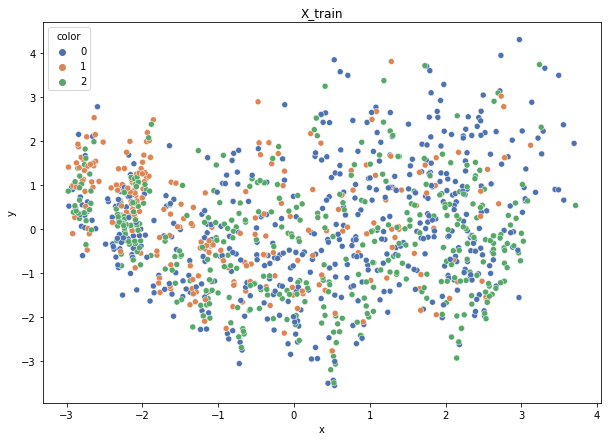

Class cardinalities: Counter({0: 503, 2: 408, 1: 267})
Weights: {0: 0.2429107547813522, 1: 0.45761838822104933, 2: 0.29947085699759846}


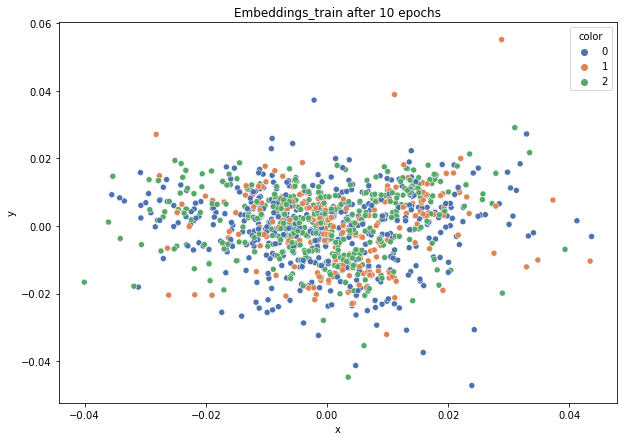

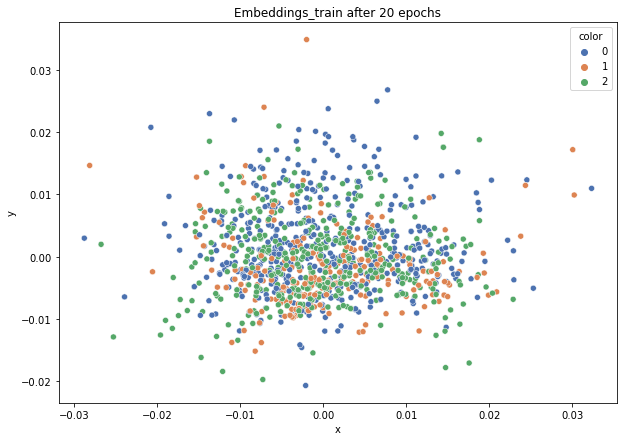

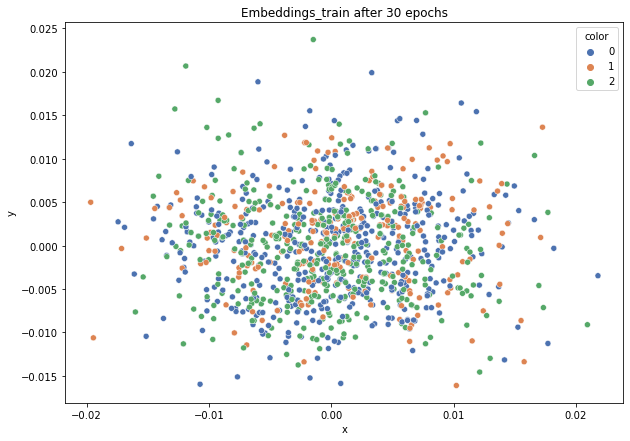

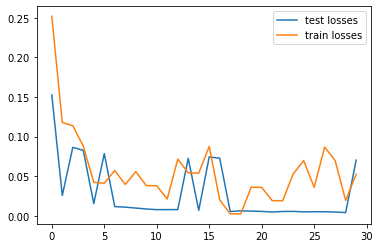

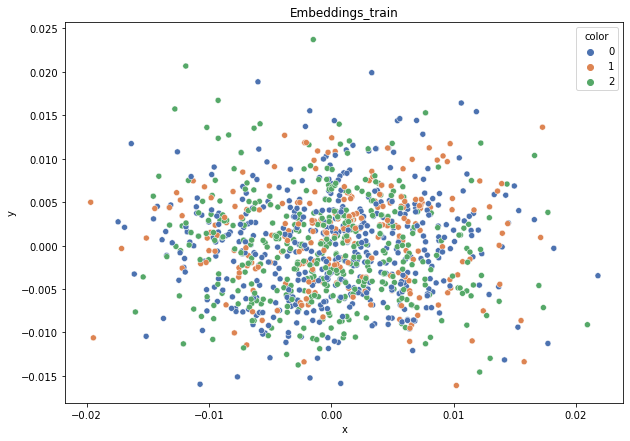

DT-f1-new-features: 0.343
DT-f1-old+new-features: 0.402
DT-f1-old-features: 0.462
DT-gmean-new-features: 0.344
DT-gmean-old+new-features: 0.395
DT-gmean-old-features: 0.46
KNN-f1-new-features: 0.394
KNN-f1-old+new-features: 0.411
KNN-f1-old-features: 0.413
KNN-gmean-new-features: 0.382
KNN-gmean-old+new-features: 0.399
KNN-gmean-old-features: 0.399
LDA-f1-new-features: 0.337
LDA-f1-old+new-features: 0.43
LDA-f1-old-features: 0.447
LDA-gmean-new-features: 0.297
LDA-gmean-old+new-features: 0.405
LDA-gmean-old-features: 0.425
QDA-f1-new-features: 0.387
QDA-f1-old+new-features: 0.492
QDA-f1-old-features: 0.486
QDA-gmean-new-features: 0.353
QDA-gmean-old+new-features: 0.486
QDA-gmean-old-features: 0.493
RF24-f1-new-features: 0.363
RF24-f1-old+new-features: 0.474
RF24-f1-old-features: 0.519
RF24-gmean-new-features: 0.338
RF24-gmean-old+new-features: 0.461
RF24-gmean-old-features: 0.513


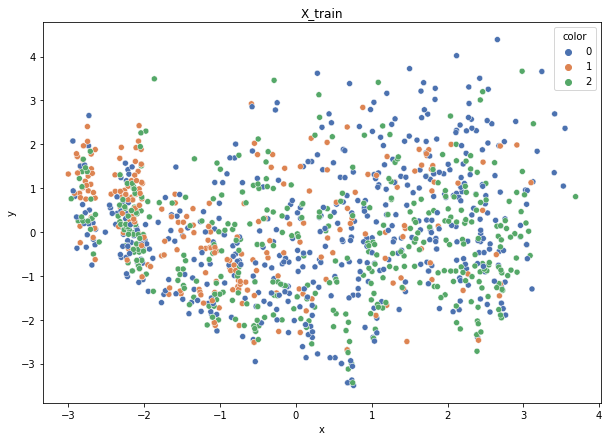

Class cardinalities: Counter({0: 503, 2: 409, 1: 267})
Weights: {0: 0.24308874498865835, 1: 0.4579537031059744, 2: 0.29895755190536716}


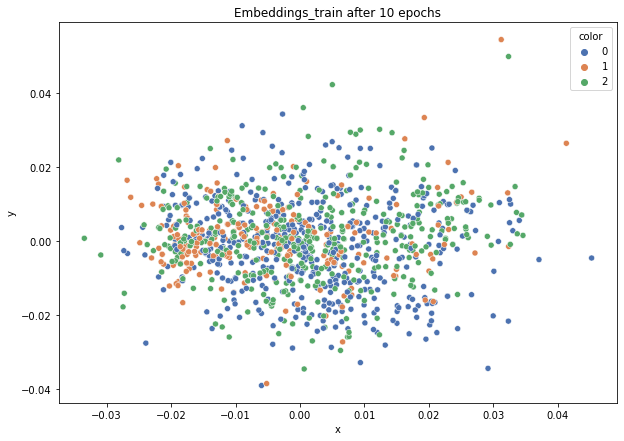

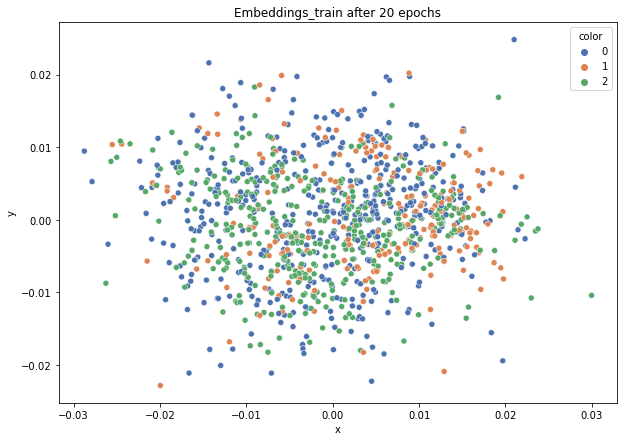

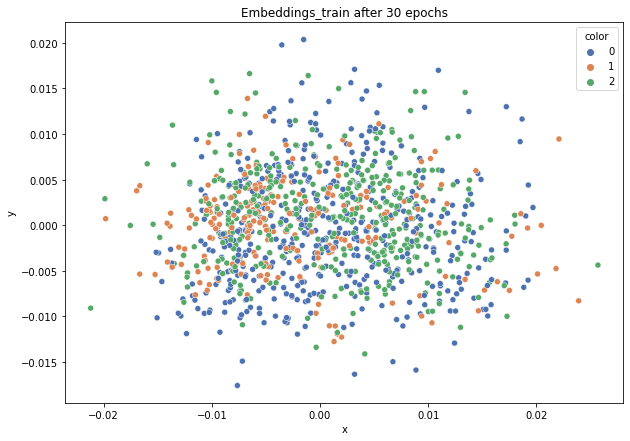

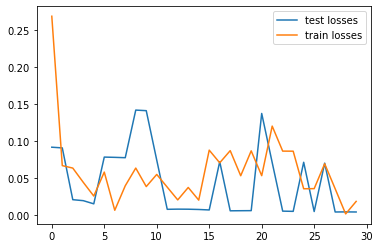

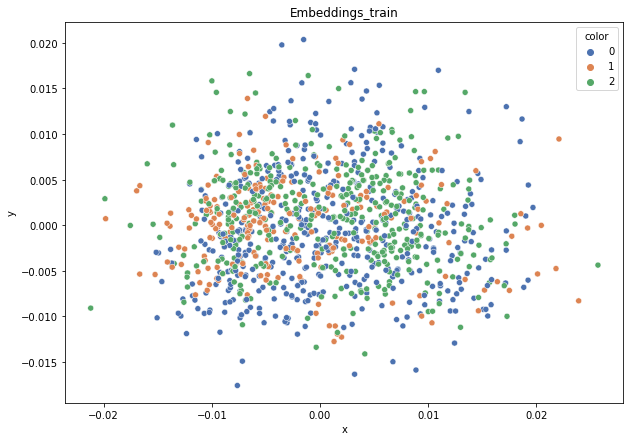

DT-f1-new-features: 0.343
DT-f1-old+new-features: 0.37
DT-f1-old-features: 0.44
DT-gmean-new-features: 0.346
DT-gmean-old+new-features: 0.366
DT-gmean-old-features: 0.438
KNN-f1-new-features: 0.352
KNN-f1-old+new-features: 0.407
KNN-f1-old-features: 0.418
KNN-gmean-new-features: 0.347
KNN-gmean-old+new-features: 0.404
KNN-gmean-old-features: 0.413
LDA-f1-new-features: 0.288
LDA-f1-old+new-features: 0.508
LDA-f1-old-features: 0.485
LDA-gmean-new-features: 0.229
LDA-gmean-old+new-features: 0.489
LDA-gmean-old-features: 0.451
QDA-f1-new-features: 0.403
QDA-f1-old+new-features: 0.454
QDA-f1-old-features: 0.516
QDA-gmean-new-features: 0.381
QDA-gmean-old+new-features: 0.453
QDA-gmean-old-features: 0.524
RF24-f1-new-features: 0.396
RF24-f1-old+new-features: 0.443
RF24-f1-old-features: 0.509
RF24-gmean-new-features: 0.374
RF24-gmean-old+new-features: 0.422
RF24-gmean-old-features: 0.497


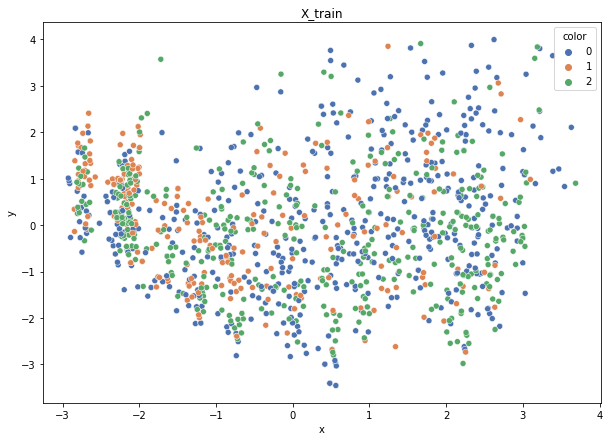

Class cardinalities: Counter({0: 504, 2: 409, 1: 266})
Weights: {0: 0.24230613326681422, 1: 0.4591063577687006, 2: 0.29858750896448505}


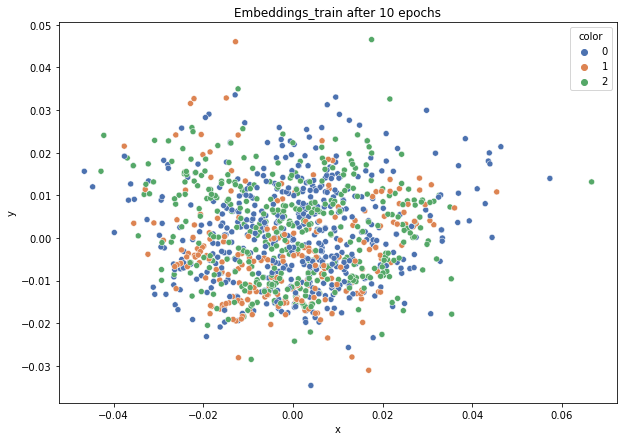

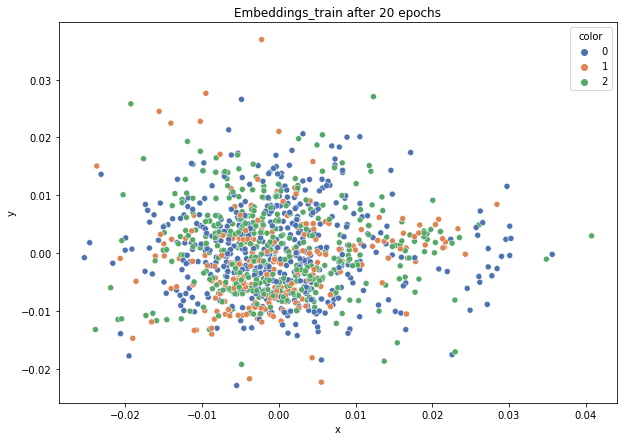

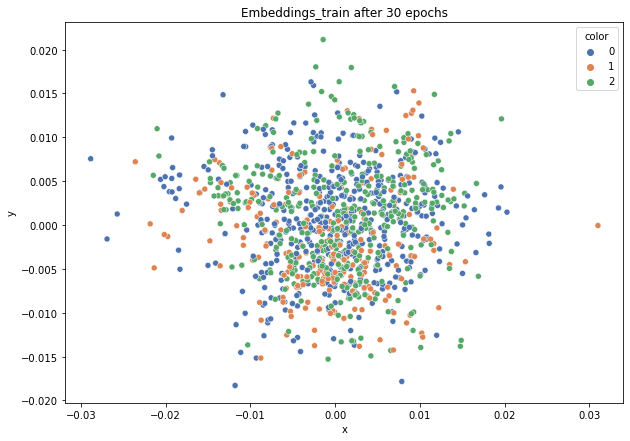

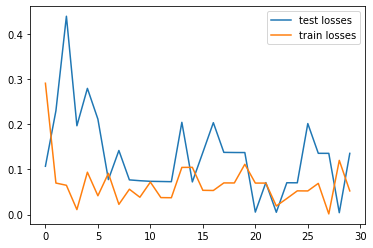

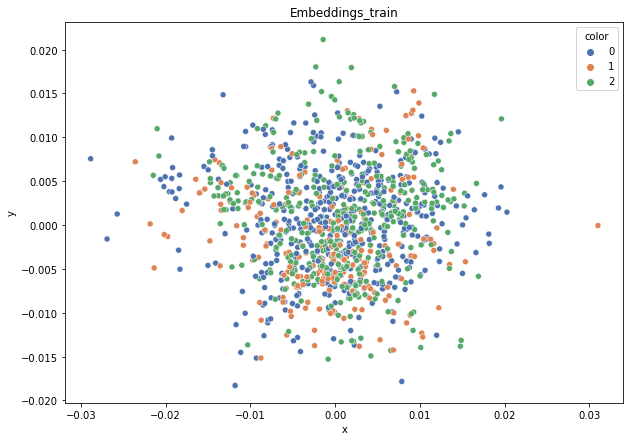

DT-f1-new-features: 0.37
DT-f1-old+new-features: 0.404
DT-f1-old-features: 0.473
DT-gmean-new-features: 0.37
DT-gmean-old+new-features: 0.406
DT-gmean-old-features: 0.483
KNN-f1-new-features: 0.404
KNN-f1-old+new-features: 0.405
KNN-f1-old-features: 0.408
KNN-gmean-new-features: 0.398
KNN-gmean-old+new-features: 0.393
KNN-gmean-old-features: 0.394
LDA-f1-new-features: 0.363
LDA-f1-old+new-features: 0.5
LDA-f1-old-features: 0.527
LDA-gmean-new-features: 0.318
LDA-gmean-old+new-features: 0.489
LDA-gmean-old-features: 0.509
QDA-f1-new-features: 0.449
QDA-f1-old+new-features: 0.48
QDA-f1-old-features: 0.542
QDA-gmean-new-features: 0.429
QDA-gmean-old+new-features: 0.486
QDA-gmean-old-features: 0.557
RF24-f1-new-features: 0.394
RF24-f1-old+new-features: 0.472
RF24-f1-old-features: 0.515
RF24-gmean-new-features: 0.37
RF24-gmean-old+new-features: 0.451
RF24-gmean-old-features: 0.518
dermatology


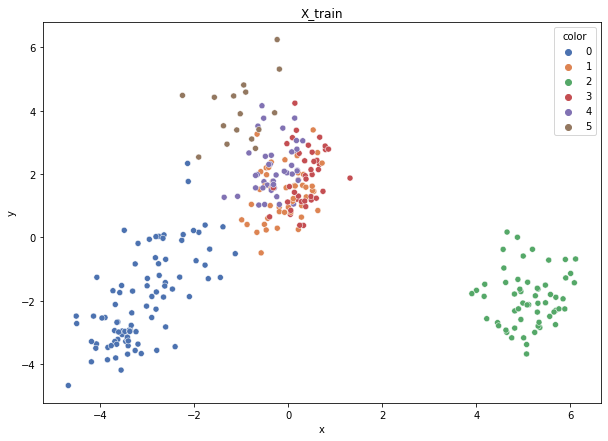

Class cardinalities: Counter({0: 90, 2: 58, 1: 48, 4: 41, 3: 39, 5: 16})
Weights: {1: 0.1288257963857323, 0: 0.0687070914057239, 2: 0.10661445218129569, 4: 0.15082044454915, 3: 0.1585548263209013, 5: 0.38647738915719687}


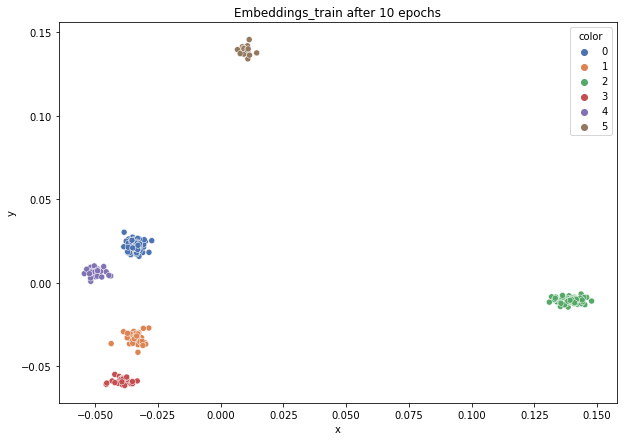

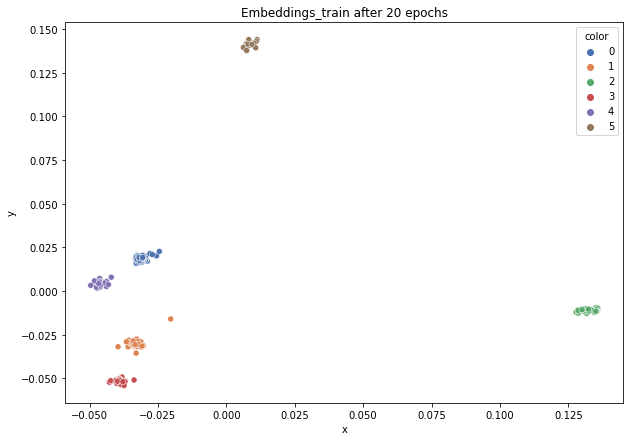

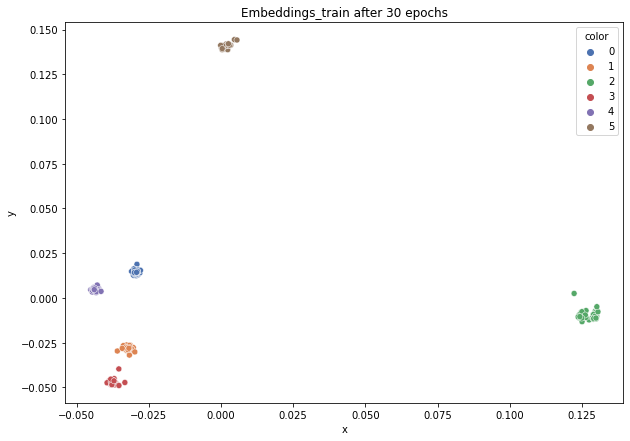

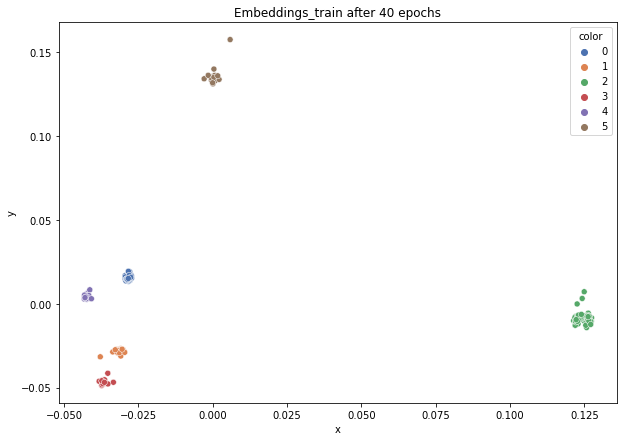

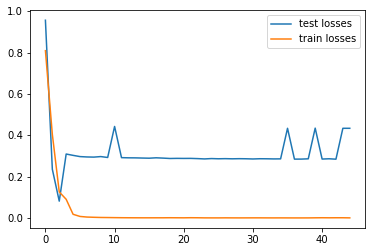

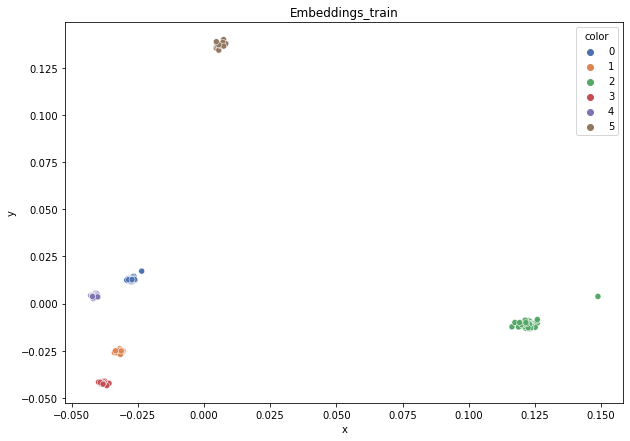

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/discriminant_analysis.py:715: UserWarning: Variables are collinear
  warnings.warn("Variables are collinear")
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/discriminant_analysis.py:715: UserWarning: Variables are collinear
  warnings.warn("Variables are collinear")
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/discriminant_analysis.py:715: UserWarning: Variables are collinear
  warnings.warn("Variables are collinear")


DT-f1-new-features: 0.728
DT-f1-old+new-features: 0.586
DT-f1-old-features: 0.914
DT-gmean-new-features: 0.728
DT-gmean-old+new-features: 0.56
DT-gmean-old-features: 0.911
KNN-f1-new-features: 0.933
KNN-f1-old+new-features: 0.944
KNN-f1-old-features: 0.944
KNN-gmean-new-features: 0.926
KNN-gmean-old+new-features: 0.941
KNN-gmean-old-features: 0.941
LDA-f1-new-features: 0.918
LDA-f1-old+new-features: 0.918
LDA-f1-old-features: 0.943
LDA-gmean-new-features: 0.911
LDA-gmean-old+new-features: 0.911
LDA-gmean-old-features: 0.942
QDA-f1-new-features: 0.716
QDA-f1-old+new-features: 0.827
QDA-f1-old-features: 0.749
QDA-gmean-new-features: 0.28
QDA-gmean-old+new-features: 0.857
QDA-gmean-old-features: 0.74
RF24-f1-new-features: 0.901
RF24-f1-old+new-features: 0.929
RF24-f1-old-features: 0.959
RF24-gmean-new-features: 0.891
RF24-gmean-old+new-features: 0.931
RF24-gmean-old-features: 0.957


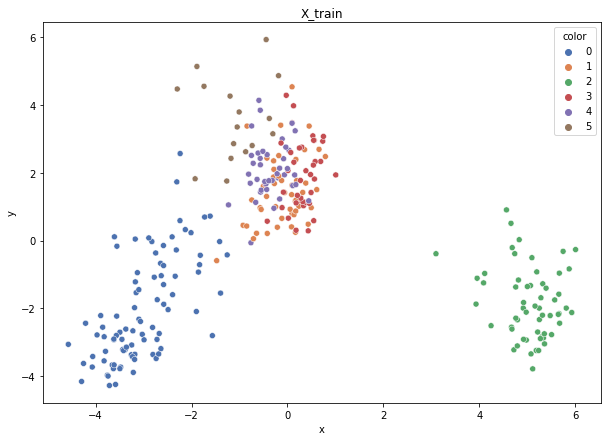

Class cardinalities: Counter({0: 89, 2: 58, 1: 49, 4: 41, 3: 40, 5: 16})
Weights: {1: 0.1269355878601628, 2: 0.10723868629565478, 0: 0.06988588545110087, 4: 0.1517035074426336, 3: 0.15549609512869944, 5: 0.3887402378217486}


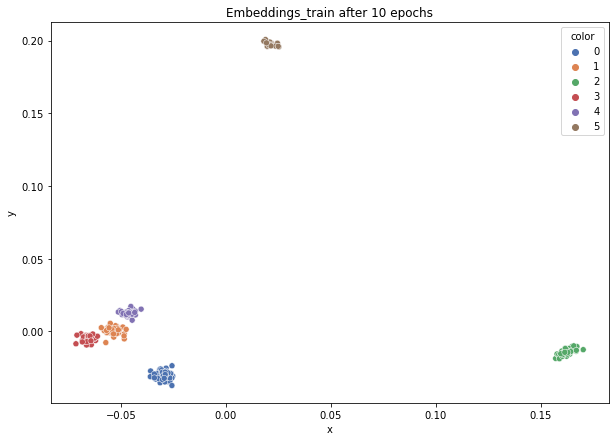

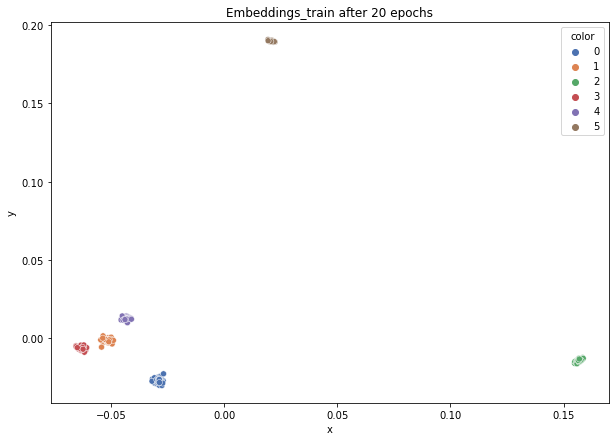

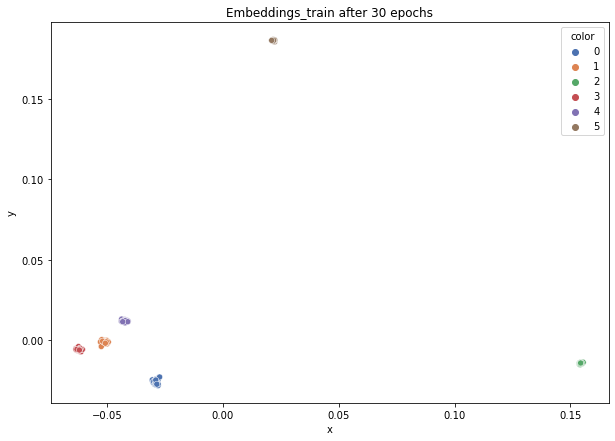

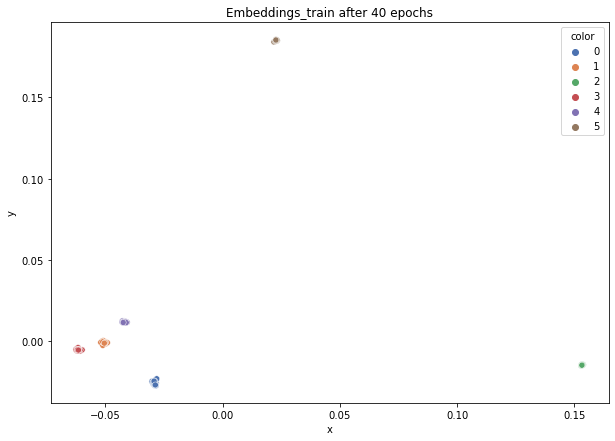

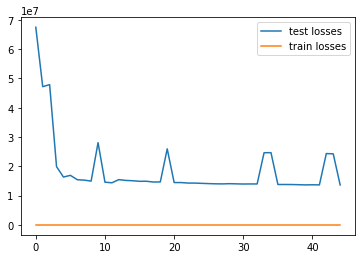

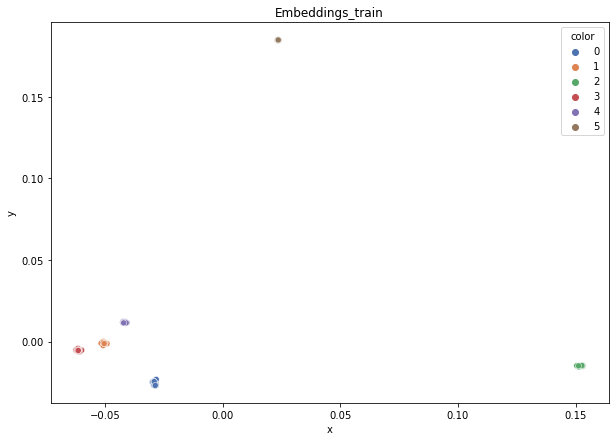

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/discriminant_analysis.py:715: UserWarning: Variables are collinear
  warnings.warn("Variables are collinear")
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/discriminant_analysis.py:715: UserWarning: Variables are collinear
  warnings.warn("Variables are collinear")
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/discriminant_analysis.py:715: UserWarning: Variables are collinear
  warnings.warn("Variables are collinear")


DT-f1-new-features: 0.689
DT-f1-old+new-features: 0.664
DT-f1-old-features: 0.955
DT-gmean-new-features: 0.662
DT-gmean-old+new-features: 0.596
DT-gmean-old-features: 0.955
KNN-f1-new-features: 0.886
KNN-f1-old+new-features: 0.927
KNN-f1-old-features: 0.952
KNN-gmean-new-features: 0.896
KNN-gmean-old+new-features: 0.94
KNN-gmean-old-features: 0.951
LDA-f1-new-features: 0.86
LDA-f1-old+new-features: 0.86
LDA-f1-old-features: 0.968
LDA-gmean-new-features: 0.872
LDA-gmean-old+new-features: 0.872
LDA-gmean-old-features: 0.97
QDA-f1-new-features: 0.64
QDA-f1-old+new-features: 0.91
QDA-f1-old-features: 0.786
QDA-gmean-new-features: 0.256
QDA-gmean-old+new-features: 0.907
QDA-gmean-old-features: 0.766
RF24-f1-new-features: 0.839
RF24-f1-old+new-features: 0.885
RF24-f1-old-features: 0.984
RF24-gmean-new-features: 0.846
RF24-gmean-old+new-features: 0.896
RF24-gmean-old-features: 0.986


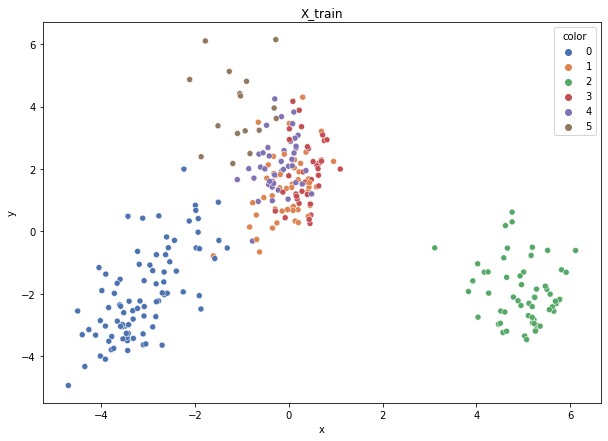

Class cardinalities: Counter({0: 89, 2: 58, 1: 49, 4: 42, 3: 39, 5: 16})
Weights: {0: 0.06985968170695418, 2: 0.10719847710205038, 4: 0.14803599218854577, 3: 0.15942337620304928, 1: 0.1268879933044678, 5: 0.38859447949493264}


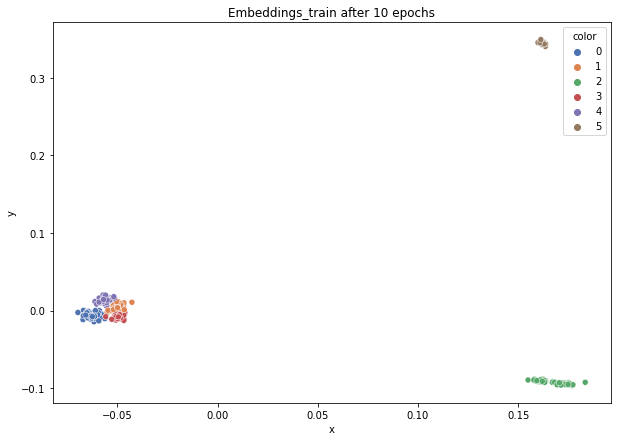

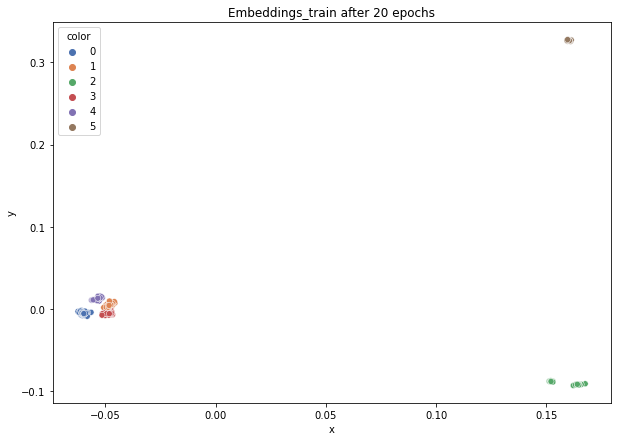

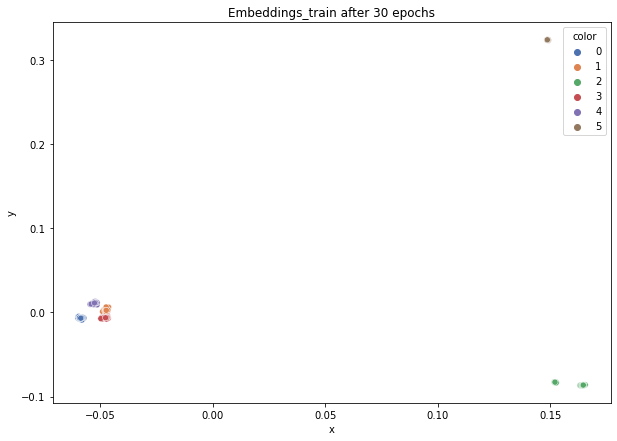

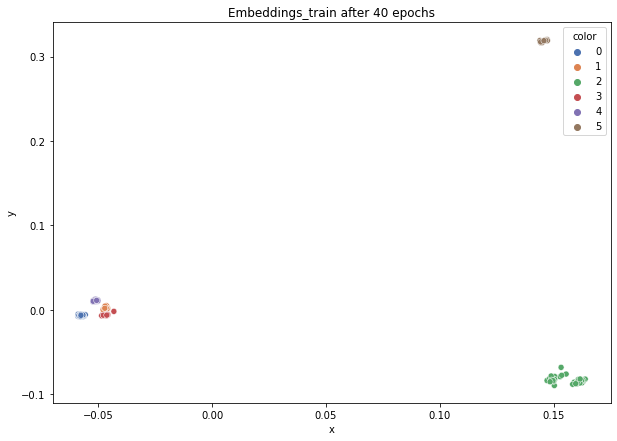

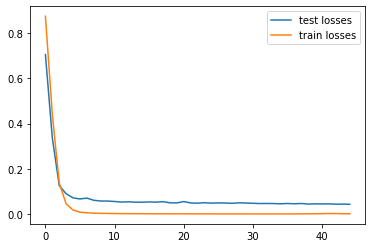

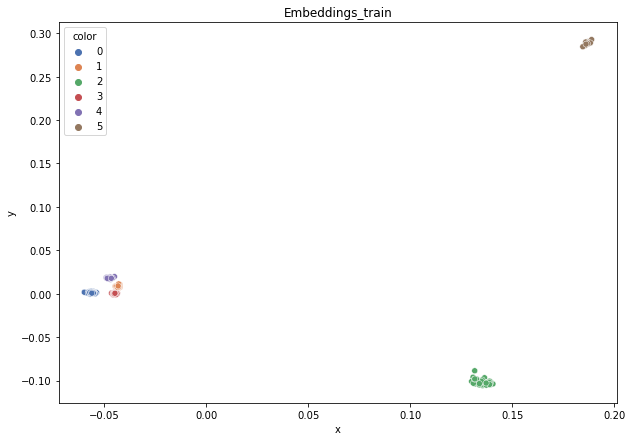

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/discriminant_analysis.py:715: UserWarning: Variables are collinear
  warnings.warn("Variables are collinear")
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/discriminant_analysis.py:715: UserWarning: Variables are collinear
  warnings.warn("Variables are collinear")
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/discriminant_analysis.py:715: UserWarning: Variables are collinear
  warnings.warn("Variables are collinear")


DT-f1-new-features: 0.574
DT-f1-old+new-features: 0.545
DT-f1-old-features: 0.945
DT-gmean-new-features: 0.512
DT-gmean-old+new-features: 0.467
DT-gmean-old-features: 0.953
KNN-f1-new-features: 0.879
KNN-f1-old+new-features: 0.906
KNN-f1-old-features: 0.906
KNN-gmean-new-features: 0.875
KNN-gmean-old+new-features: 0.891
KNN-gmean-old-features: 0.891
LDA-f1-new-features: 0.883
LDA-f1-old+new-features: 0.883
LDA-f1-old-features: 0.922
LDA-gmean-new-features: 0.869
LDA-gmean-old+new-features: 0.869
LDA-gmean-old-features: 0.913
QDA-f1-new-features: 0.734
QDA-f1-old+new-features: 0.878
QDA-f1-old-features: 0.865
QDA-gmean-new-features: 0.291
QDA-gmean-old+new-features: 0.858
QDA-gmean-old-features: 0.861
RF24-f1-new-features: 0.875
RF24-f1-old+new-features: 0.887
RF24-f1-old-features: 0.909
RF24-gmean-new-features: 0.885
RF24-gmean-old+new-features: 0.892
RF24-gmean-old-features: 0.905


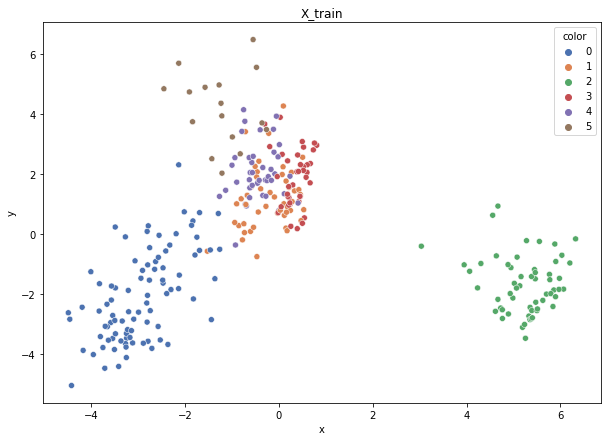

Class cardinalities: Counter({0: 90, 2: 57, 1: 49, 4: 42, 3: 39, 5: 16})
Weights: {1: 0.12674800566460384, 0: 0.06900724752850654, 2: 0.10895881188711559, 4: 0.14787267327537115, 3: 0.15924749429655355, 5: 0.3881657673478493}


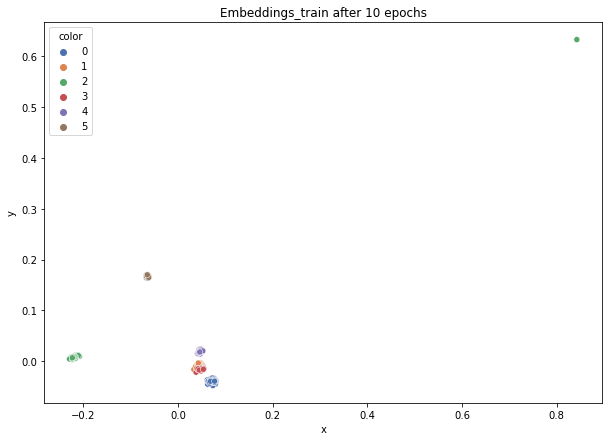

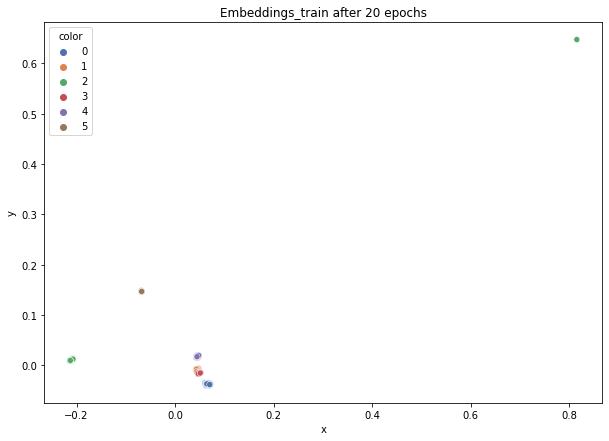

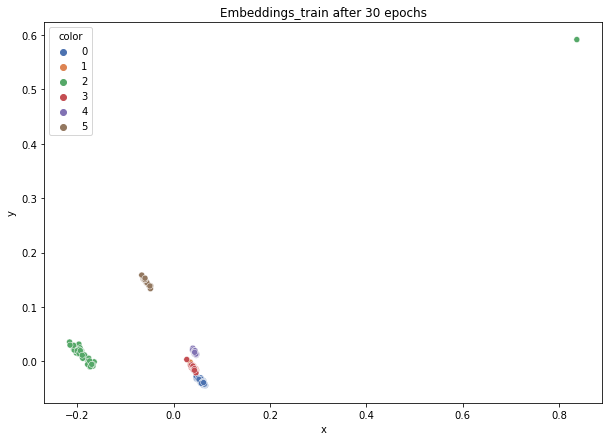

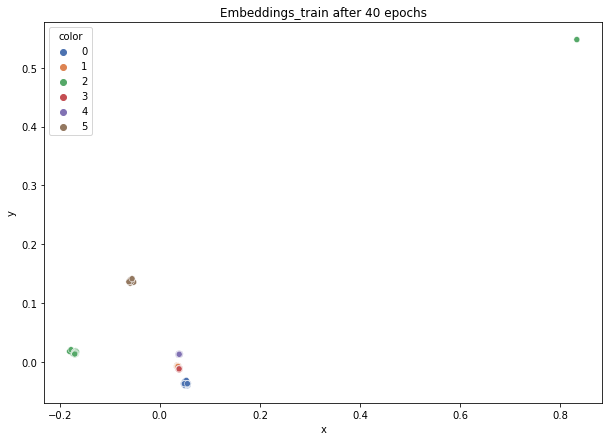

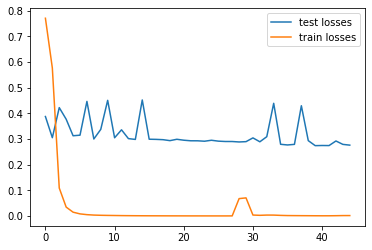

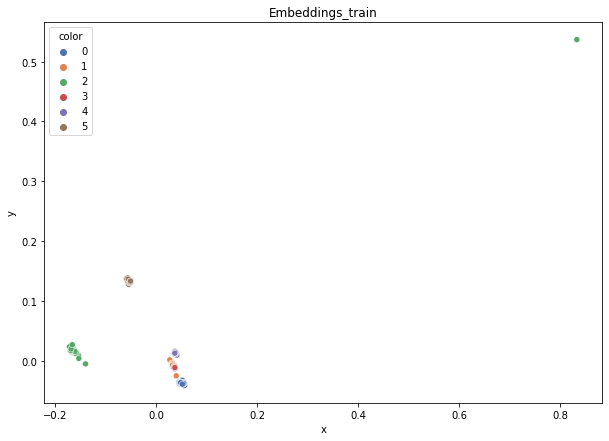

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/discriminant_analysis.py:715: UserWarning: Variables are collinear
  warnings.warn("Variables are collinear")
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/discriminant_analysis.py:715: UserWarning: Variables are collinear
  warnings.warn("Variables are collinear")
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/discriminant_analysis.py:715: UserWarning: Variables are collinear
  warnings.warn("Variables are collinear")


DT-f1-new-features: 0.831
DT-f1-old+new-features: 0.667
DT-f1-old-features: 0.946
DT-gmean-new-features: 0.823
DT-gmean-old+new-features: 0.653
DT-gmean-old-features: 0.945
KNN-f1-new-features: 0.96
KNN-f1-old+new-features: 0.939
KNN-f1-old-features: 0.939
KNN-gmean-new-features: 0.964
KNN-gmean-old+new-features: 0.937
KNN-gmean-old-features: 0.937
LDA-f1-new-features: 0.944
LDA-f1-old+new-features: 0.944
LDA-f1-old-features: 0.969
LDA-gmean-new-features: 0.945
LDA-gmean-old+new-features: 0.945
LDA-gmean-old-features: 0.968
QDA-f1-new-features: 0.678
QDA-f1-old+new-features: 0.778
QDA-f1-old-features: 0.652
QDA-gmean-new-features: 0.263
QDA-gmean-old+new-features: 0.708
QDA-gmean-old-features: 0.553
RF24-f1-new-features: 0.944
RF24-f1-old+new-features: 0.927
RF24-f1-old-features: 0.969
RF24-gmean-new-features: 0.942
RF24-gmean-old+new-features: 0.927
RF24-gmean-old-features: 0.963


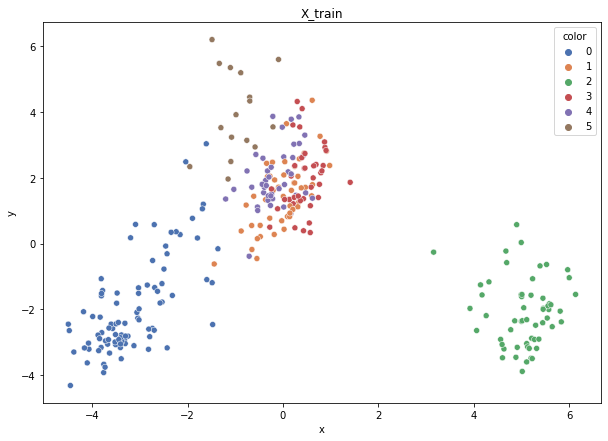

Class cardinalities: Counter({0: 90, 2: 57, 1: 49, 4: 42, 3: 39, 5: 16})
Weights: {1: 0.12674800566460384, 0: 0.06900724752850654, 2: 0.10895881188711559, 3: 0.15924749429655355, 4: 0.14787267327537115, 5: 0.3881657673478493}


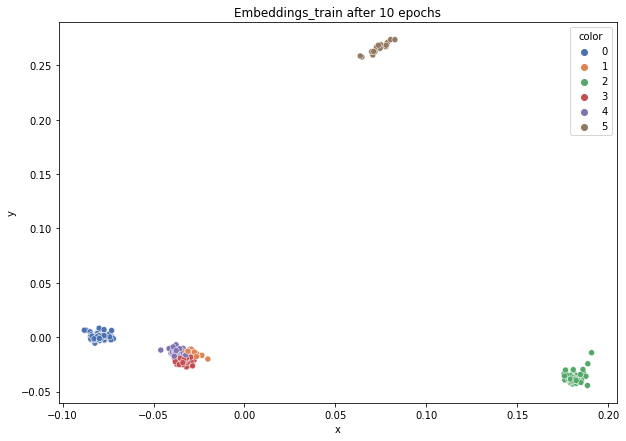

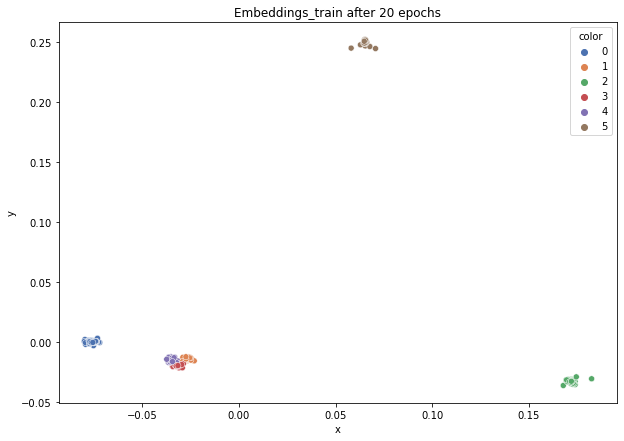

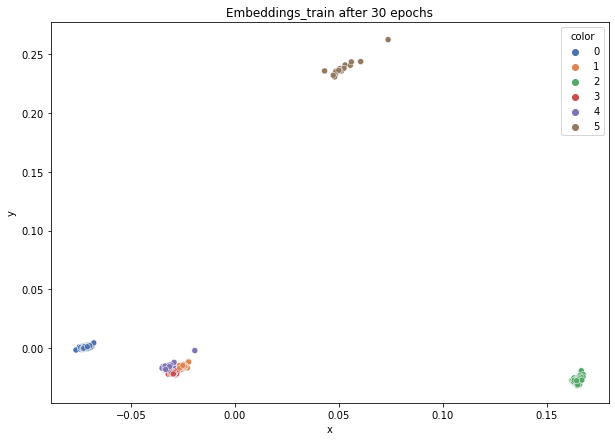

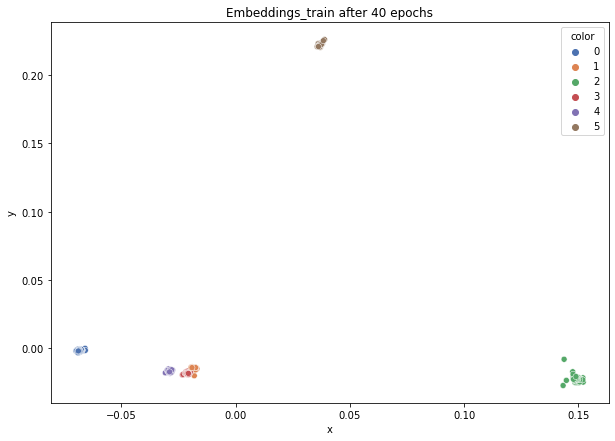

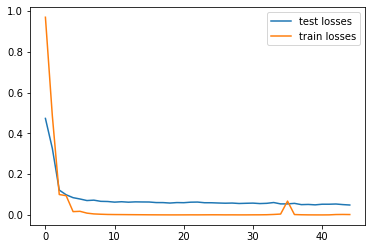

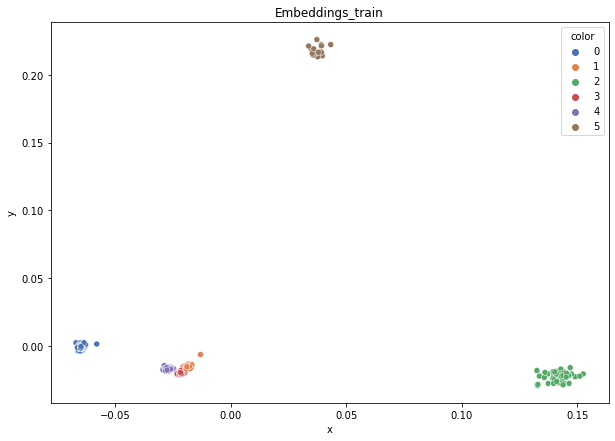

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/discriminant_analysis.py:715: UserWarning: Variables are collinear
  warnings.warn("Variables are collinear")
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/discriminant_analysis.py:715: UserWarning: Variables are collinear
  warnings.warn("Variables are collinear")


DT-f1-new-features: 0.614
DT-f1-old+new-features: 0.715
DT-f1-old-features: 0.989
DT-gmean-new-features: 0.589
DT-gmean-old+new-features: 0.709
DT-gmean-old-features: 0.992
KNN-f1-new-features: 0.988
KNN-f1-old+new-features: 0.944
KNN-f1-old-features: 0.944
KNN-gmean-new-features: 0.992
KNN-gmean-old+new-features: 0.942
KNN-gmean-old-features: 0.942
LDA-f1-new-features: 0.969
LDA-f1-old+new-features: 0.969
LDA-f1-old-features: 0.989
LDA-gmean-new-features: 0.968
LDA-gmean-old+new-features: 0.968
LDA-gmean-old-features: 0.992
QDA-f1-new-features: 0.74
QDA-f1-old+new-features: 0.899
QDA-f1-old-features: 0.835
QDA-gmean-new-features: 0.29
QDA-gmean-old+new-features: 0.888
QDA-gmean-old-features: 0.814
RF24-f1-new-features: 0.951
RF24-f1-old+new-features: 0.973
RF24-f1-old-features: 1.0
RF24-gmean-new-features: 0.959
RF24-gmean-old+new-features: 0.978
RF24-gmean-old-features: 1.0
hayes-roth


/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/discriminant_analysis.py:715: UserWarning: Variables are collinear
  warnings.warn("Variables are collinear")


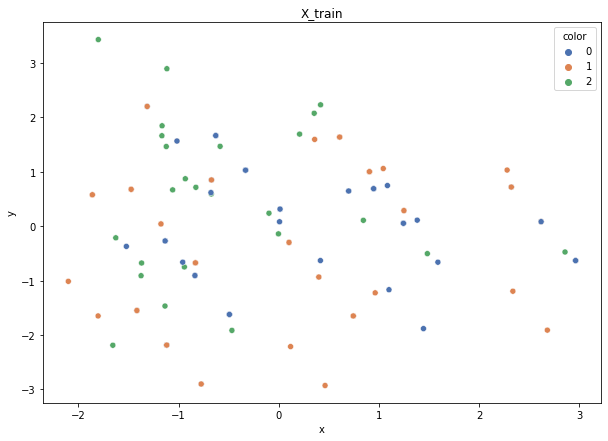

Class cardinalities: Counter({0: 52, 1: 51, 2: 25})
Weights: {0: 0.243925770040176, 1: 0.24870862827625786, 2: 0.507365601683566}


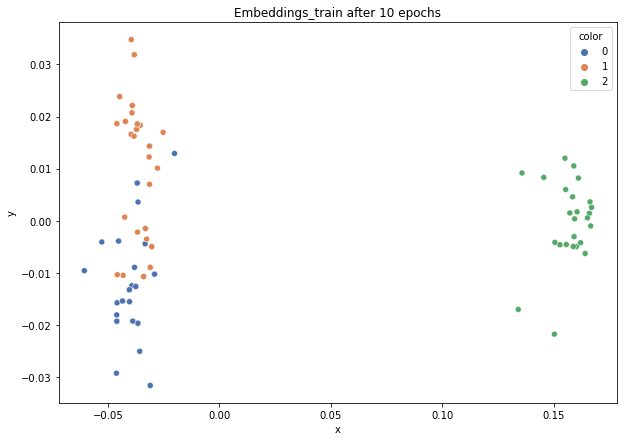

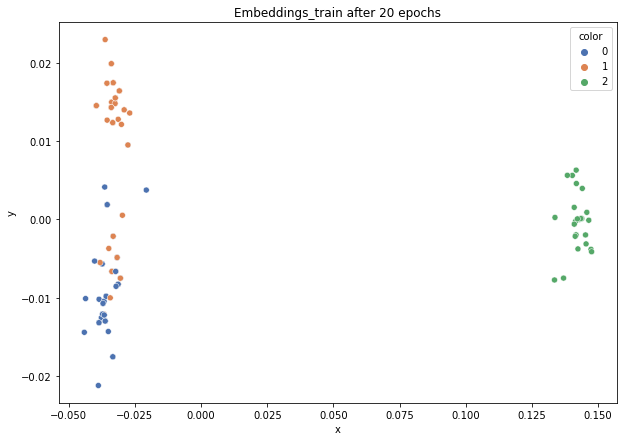

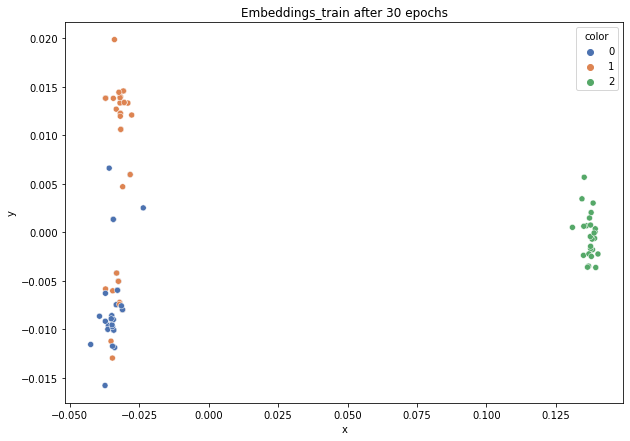

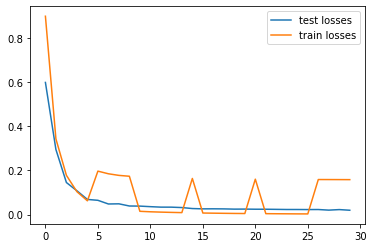

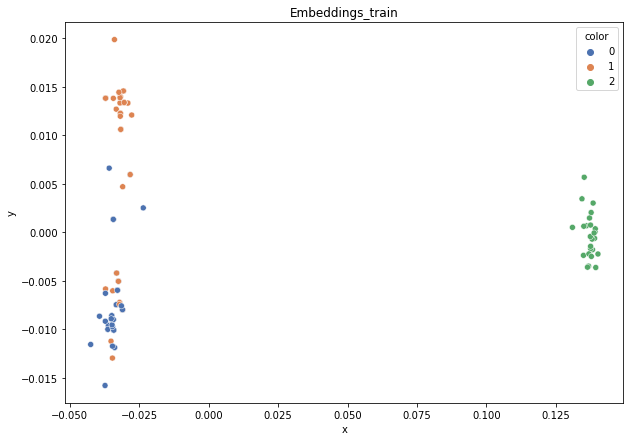

DT-f1-new-features: 0.728
DT-f1-old+new-features: 0.72
DT-f1-old-features: 0.842
DT-gmean-new-features: 0.708
DT-gmean-old+new-features: 0.675
DT-gmean-old-features: 0.828
KNN-f1-new-features: 0.82
KNN-f1-old+new-features: 0.733
KNN-f1-old-features: 0.733
KNN-gmean-new-features: 0.811
KNN-gmean-old+new-features: 0.688
KNN-gmean-old-features: 0.688
LDA-f1-new-features: 0.728
LDA-f1-old+new-features: 0.75
LDA-f1-old-features: 0.57
LDA-gmean-new-features: 0.692
LDA-gmean-old+new-features: 0.711
LDA-gmean-old-features: 0.549
QDA-f1-new-features: 0.678
QDA-f1-old+new-features: 0.68
QDA-f1-old-features: 0.58
QDA-gmean-new-features: 0.639
QDA-gmean-old+new-features: 0.639
QDA-gmean-old-features: 0.574
RF24-f1-new-features: 0.783
RF24-f1-old+new-features: 0.829
RF24-f1-old-features: 0.838
RF24-gmean-new-features: 0.752
RF24-gmean-old+new-features: 0.811
RF24-gmean-old-features: 0.814


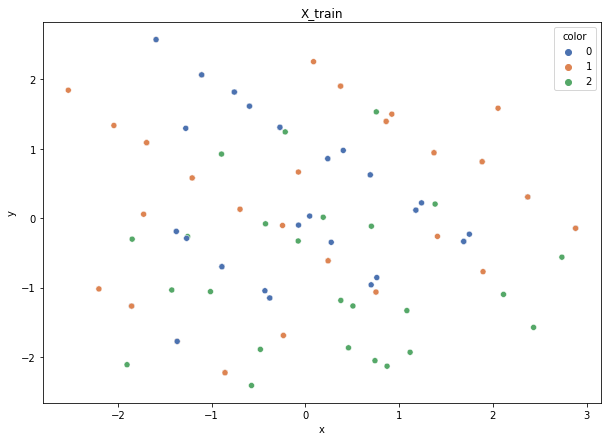

Class cardinalities: Counter({0: 52, 1: 51, 2: 25})
Weights: {0: 0.243925770040176, 1: 0.24870862827625786, 2: 0.507365601683566}


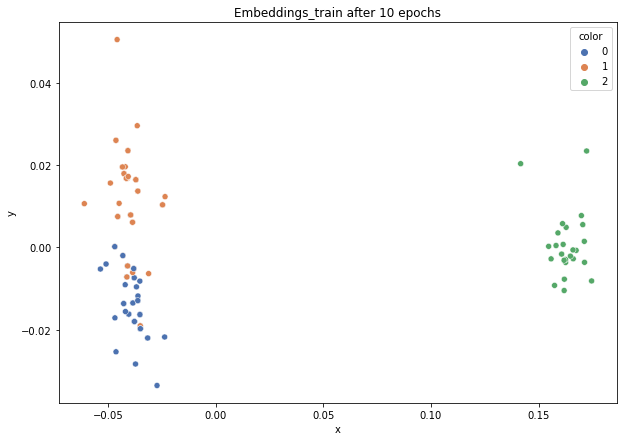

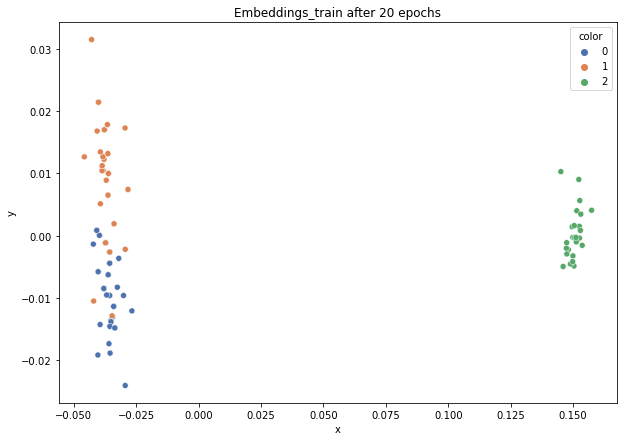

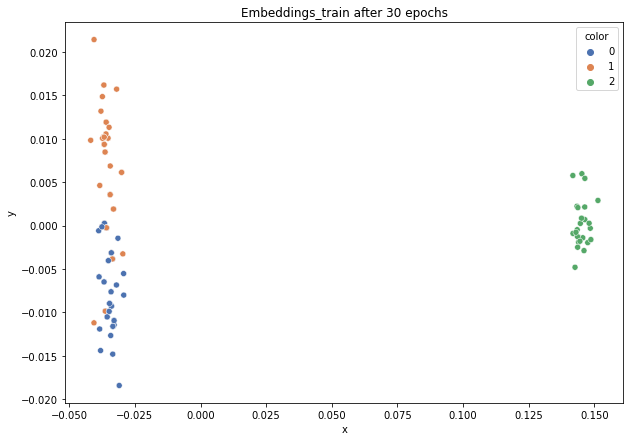

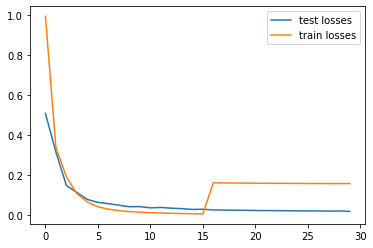

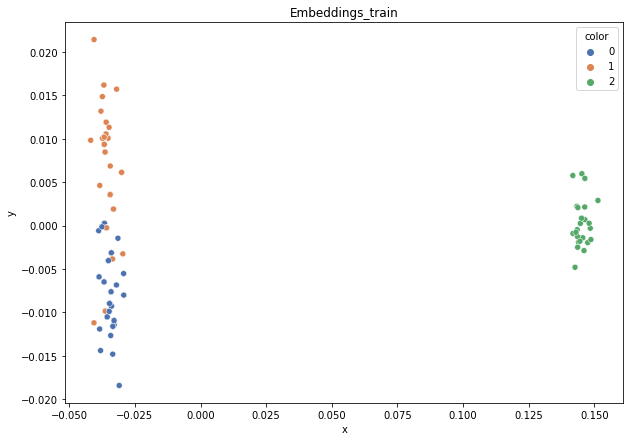

DT-f1-new-features: 0.539
DT-f1-old+new-features: 0.736
DT-f1-old-features: 0.872
DT-gmean-new-features: 0.446
DT-gmean-old+new-features: 0.708
DT-gmean-old-features: 0.867
KNN-f1-new-features: 0.845
KNN-f1-old+new-features: 0.643
KNN-f1-old-features: 0.643
KNN-gmean-new-features: 0.837
KNN-gmean-old+new-features: 0.619
KNN-gmean-old-features: 0.619
LDA-f1-new-features: 0.795
LDA-f1-old+new-features: 0.795
LDA-f1-old-features: 0.439
LDA-gmean-new-features: 0.783
LDA-gmean-old+new-features: 0.783
LDA-gmean-old-features: 0.414
QDA-f1-new-features: 0.794
QDA-f1-old+new-features: 0.794
QDA-f1-old-features: 0.54
QDA-gmean-new-features: 0.779
QDA-gmean-old+new-features: 0.779
QDA-gmean-old-features: 0.529
RF24-f1-new-features: 0.795
RF24-f1-old+new-features: 0.795
RF24-f1-old-features: 0.846
RF24-gmean-new-features: 0.783
RF24-gmean-old+new-features: 0.783
RF24-gmean-old-features: 0.84


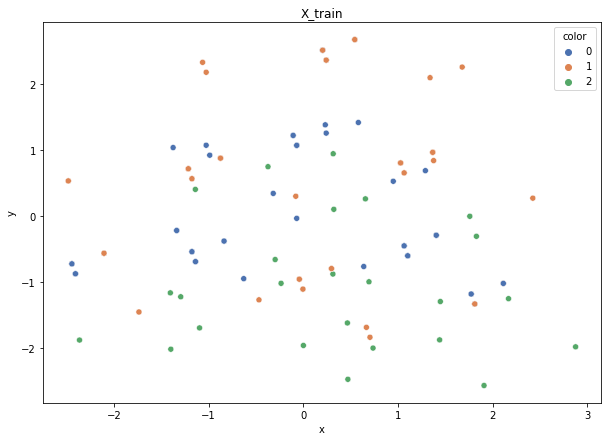

Class cardinalities: Counter({0: 52, 1: 51, 2: 25})
Weights: {0: 0.243925770040176, 1: 0.24870862827625786, 2: 0.507365601683566}


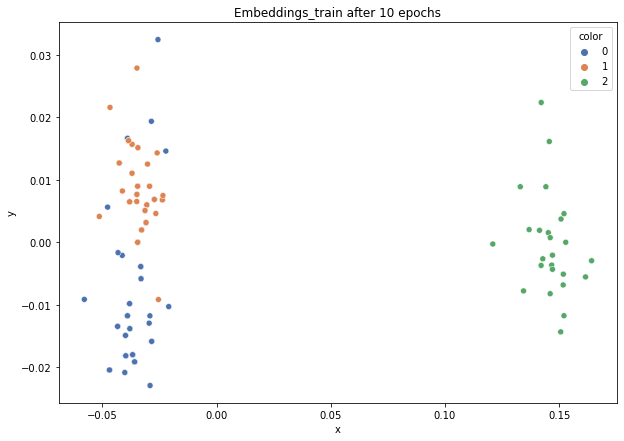

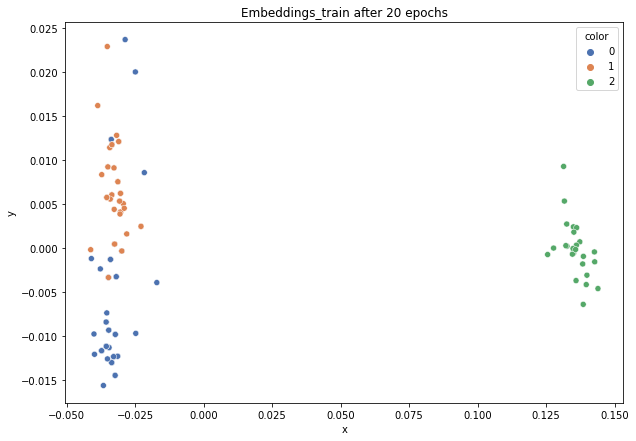

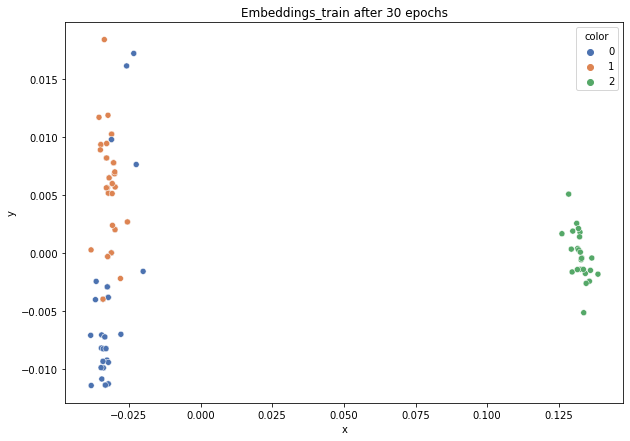

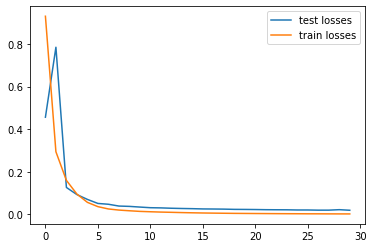

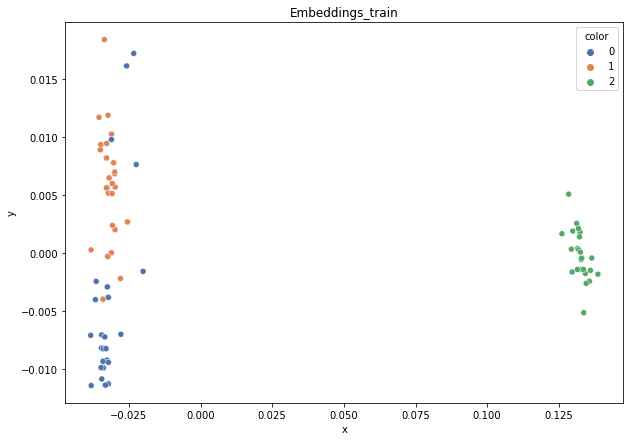

DT-f1-new-features: 0.857
DT-f1-old+new-features: 0.756
DT-f1-old-features: 0.923
DT-gmean-new-features: 0.842
DT-gmean-old+new-features: 0.71
DT-gmean-old-features: 0.921
KNN-f1-new-features: 0.949
KNN-f1-old+new-features: 0.836
KNN-f1-old-features: 0.836
KNN-gmean-new-features: 0.948
KNN-gmean-old+new-features: 0.805
KNN-gmean-old-features: 0.805
LDA-f1-new-features: 0.923
LDA-f1-old+new-features: 0.923
LDA-f1-old-features: 0.565
LDA-gmean-new-features: 0.921
LDA-gmean-old+new-features: 0.921
LDA-gmean-old-features: 0.474
QDA-f1-new-features: 0.907
QDA-f1-old+new-features: 0.907
QDA-f1-old-features: 0.666
QDA-gmean-new-features: 0.89
QDA-gmean-old+new-features: 0.89
QDA-gmean-old-features: 0.643
RF24-f1-new-features: 0.923
RF24-f1-old+new-features: 0.923
RF24-f1-old-features: 0.923
RF24-gmean-new-features: 0.921
RF24-gmean-old+new-features: 0.921
RF24-gmean-old-features: 0.921


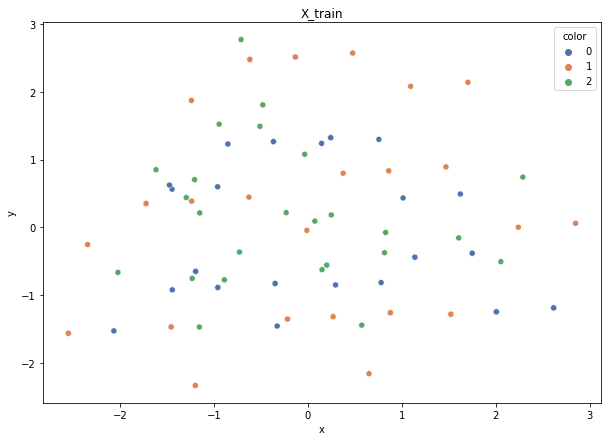

Class cardinalities: Counter({0: 52, 1: 51, 2: 25})
Weights: {1: 0.24870862827625786, 2: 0.507365601683566, 0: 0.243925770040176}


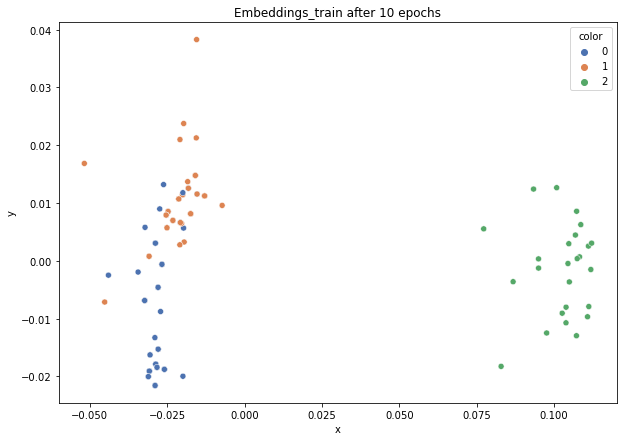

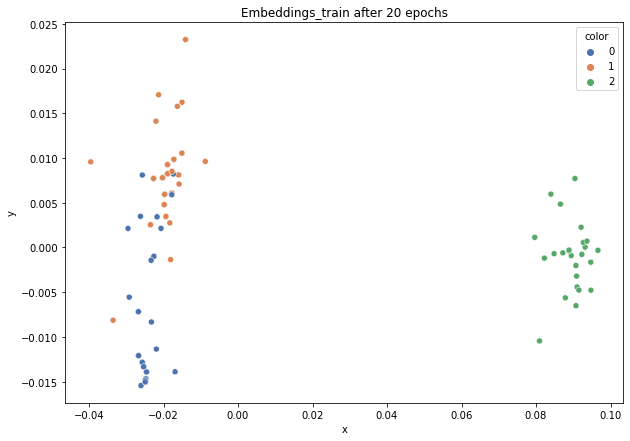

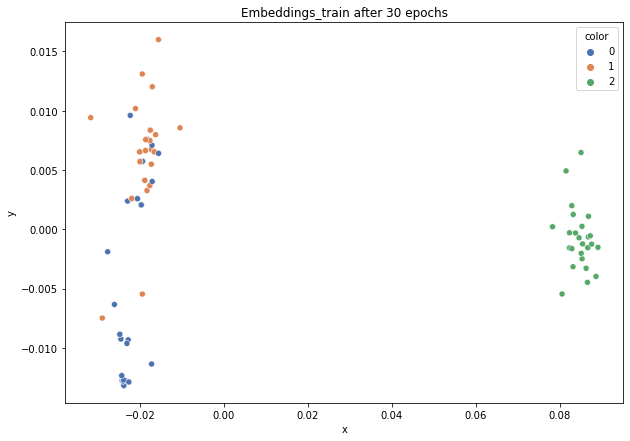

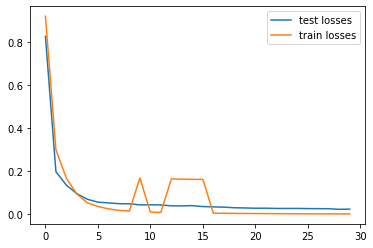

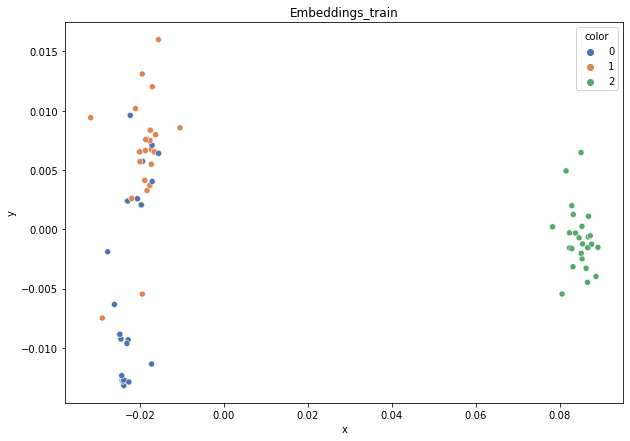

DT-f1-new-features: 0.818
DT-f1-old+new-features: 0.721
DT-f1-old-features: 0.897
DT-gmean-new-features: 0.805
DT-gmean-old+new-features: 0.703
DT-gmean-old-features: 0.892
KNN-f1-new-features: 0.76
KNN-f1-old+new-features: 0.659
KNN-f1-old-features: 0.594
KNN-gmean-new-features: 0.731
KNN-gmean-old+new-features: 0.619
KNN-gmean-old-features: 0.54
LDA-f1-new-features: 0.76
LDA-f1-old+new-features: 0.76
LDA-f1-old-features: 0.615
LDA-gmean-new-features: 0.731
LDA-gmean-old+new-features: 0.731
LDA-gmean-old-features: 0.605
QDA-f1-new-features: 0.708
QDA-f1-old+new-features: 0.393
QDA-f1-old-features: 0.739
QDA-gmean-new-features: 0.672
QDA-gmean-old+new-features: 0.075
QDA-gmean-old-features: 0.752
RF24-f1-new-features: 0.754
RF24-f1-old+new-features: 0.779
RF24-f1-old-features: 0.923
RF24-gmean-new-features: 0.733
RF24-gmean-old+new-features: 0.757
RF24-gmean-old-features: 0.921


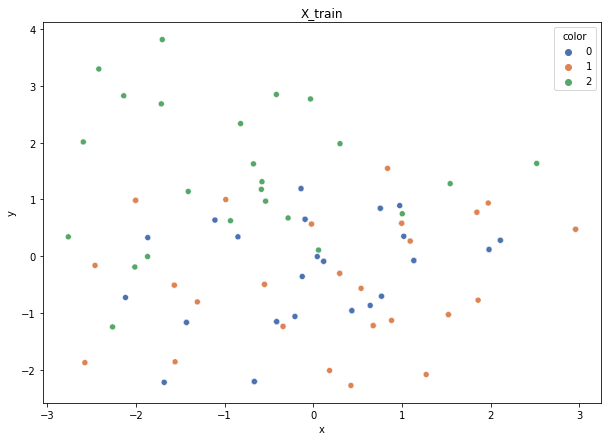

Class cardinalities: Counter({0: 52, 1: 52, 2: 24})
Weights: {0: 0.24000000000000005, 2: 0.52, 1: 0.24000000000000005}


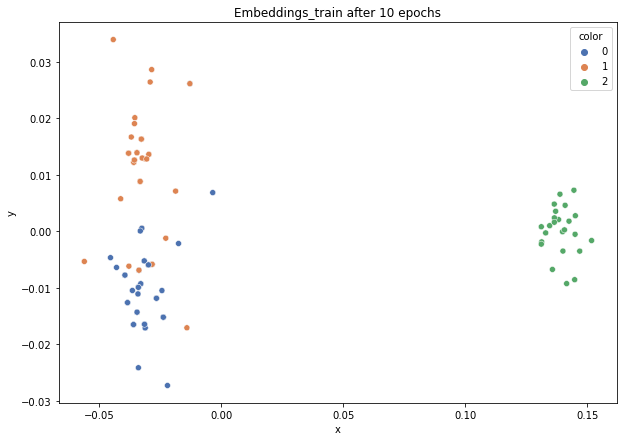

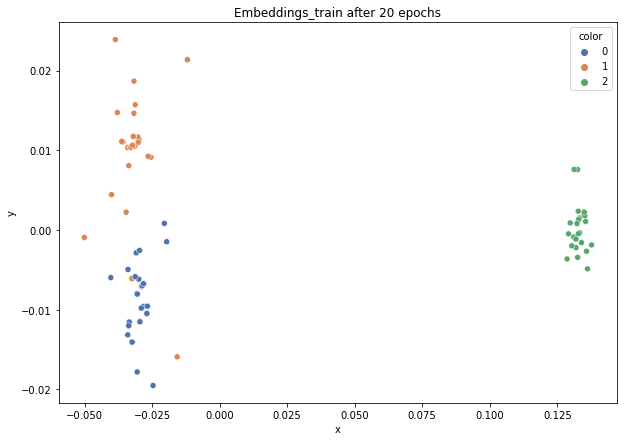

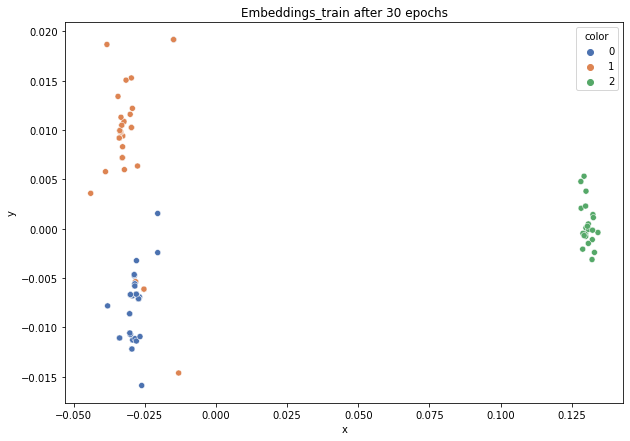

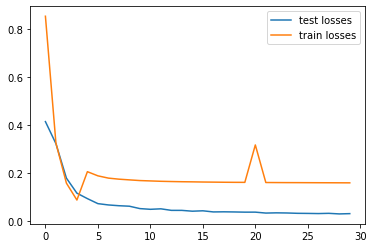

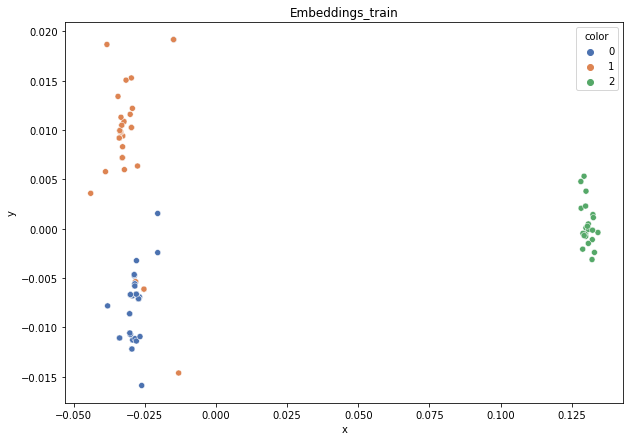

DT-f1-new-features: 0.438
DT-f1-old+new-features: 0.67
DT-f1-old-features: 0.722
DT-gmean-new-features: 0.372
DT-gmean-old+new-features: 0.641
DT-gmean-old-features: 0.684
KNN-f1-new-features: 0.714
KNN-f1-old+new-features: 0.589
KNN-f1-old-features: 0.555
KNN-gmean-new-features: 0.691
KNN-gmean-old+new-features: 0.548
KNN-gmean-old-features: 0.529
LDA-f1-new-features: 0.812
LDA-f1-old+new-features: 0.76
LDA-f1-old-features: 0.607
LDA-gmean-new-features: 0.8
LDA-gmean-old+new-features: 0.743
LDA-gmean-old-features: 0.591
QDA-f1-new-features: 0.596
QDA-f1-old+new-features: 0.356
QDA-f1-old-features: 0.663
QDA-gmean-new-features: 0.56
QDA-gmean-old+new-features: 0.071
QDA-gmean-old-features: 0.667
RF24-f1-new-features: 0.774
RF24-f1-old+new-features: 0.752
RF24-f1-old-features: 0.733
RF24-gmean-new-features: 0.751
RF24-gmean-old+new-features: 0.734
RF24-gmean-old-features: 0.711
new_vehicle


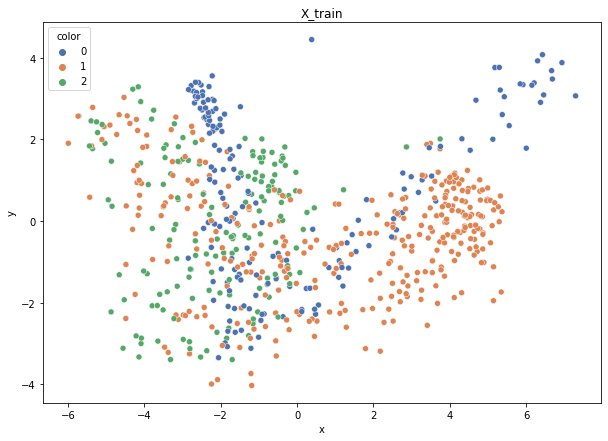

Class cardinalities: Counter({1: 343, 0: 174, 2: 159})
Weights: {2: 0.42063643091235864, 1: 0.19498889946083095, 0: 0.38437466962681044}


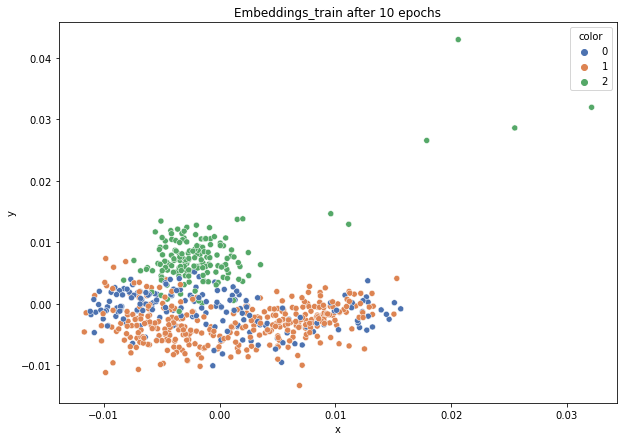

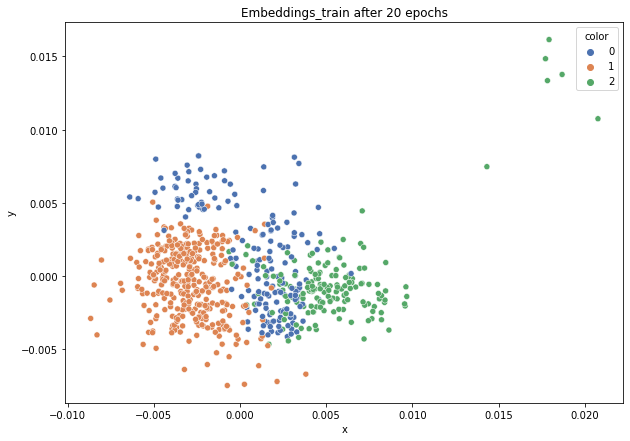

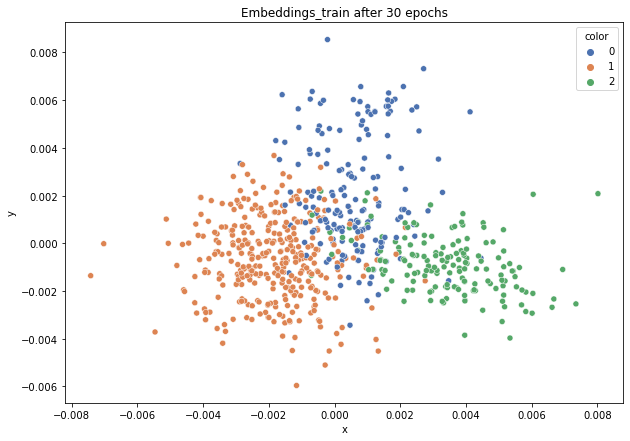

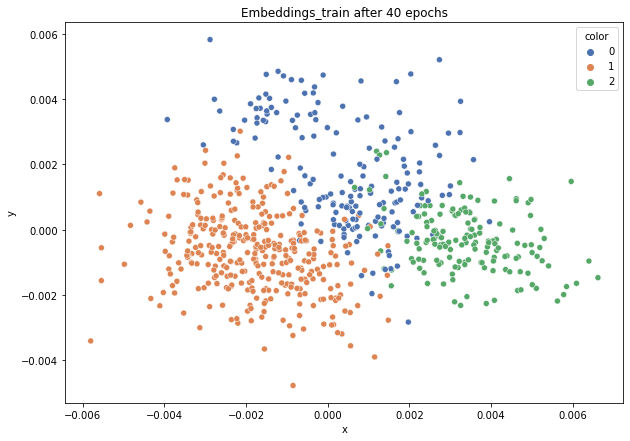

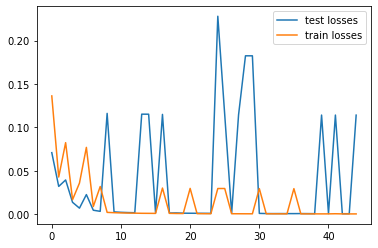

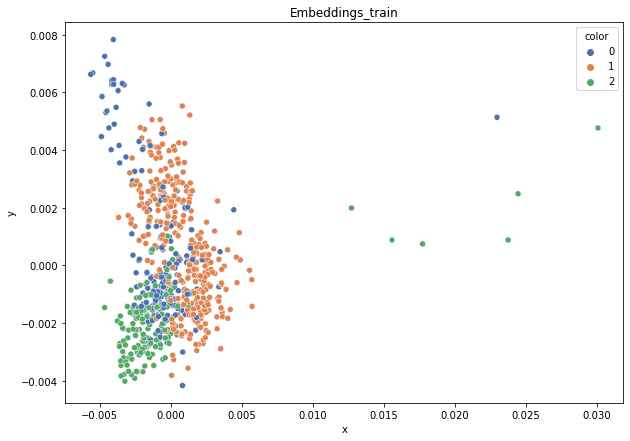

DT-f1-new-features: 0.76
DT-f1-old+new-features: 0.785
DT-f1-old-features: 0.901
DT-gmean-new-features: 0.772
DT-gmean-old+new-features: 0.806
DT-gmean-old-features: 0.908
KNN-f1-new-features: 0.821
KNN-f1-old+new-features: 0.889
KNN-f1-old-features: 0.889
KNN-gmean-new-features: 0.818
KNN-gmean-old+new-features: 0.895
KNN-gmean-old-features: 0.895
LDA-f1-new-features: 0.837
LDA-f1-old+new-features: 0.903
LDA-f1-old-features: 0.907
LDA-gmean-new-features: 0.842
LDA-gmean-old+new-features: 0.907
LDA-gmean-old-features: 0.921
QDA-f1-new-features: 0.827
QDA-f1-old+new-features: 0.927
QDA-f1-old-features: 0.932
QDA-gmean-new-features: 0.834
QDA-gmean-old+new-features: 0.928
QDA-gmean-old-features: 0.944
RF24-f1-new-features: 0.832
RF24-f1-old+new-features: 0.892
RF24-f1-old-features: 0.922
RF24-gmean-new-features: 0.83
RF24-gmean-old+new-features: 0.897
RF24-gmean-old-features: 0.932


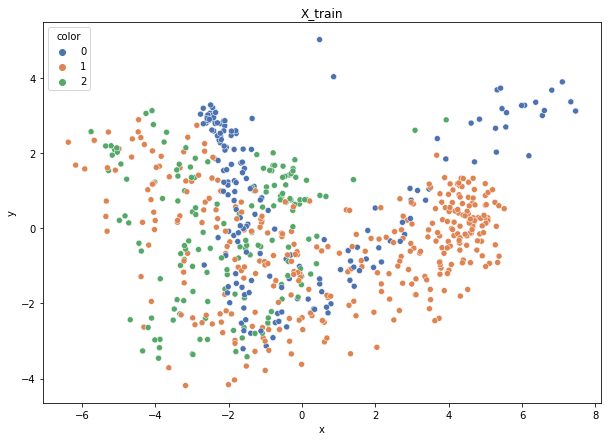

Class cardinalities: Counter({1: 343, 0: 175, 2: 159})
Weights: {2: 0.4215623617324616, 1: 0.19541812103633058, 0: 0.3830195172312079}


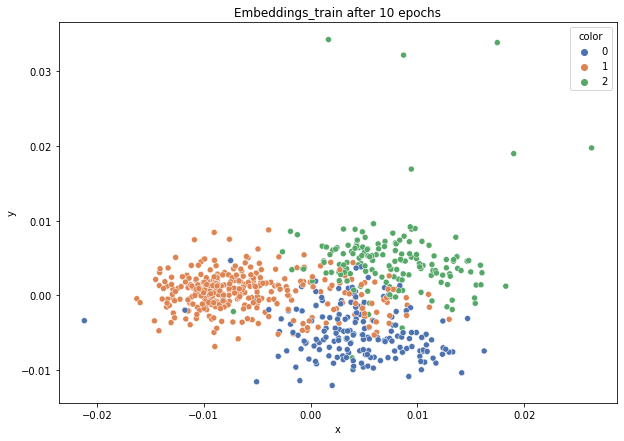

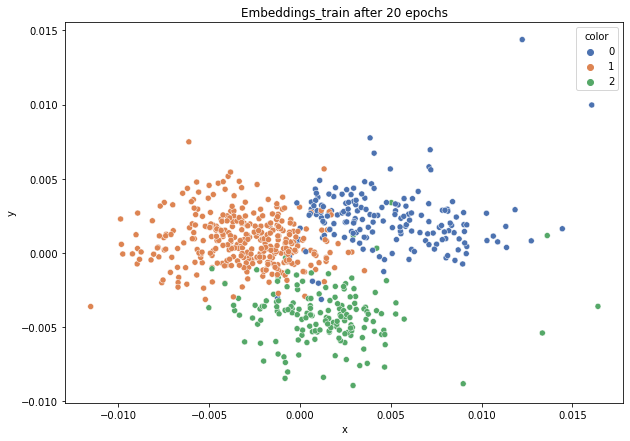

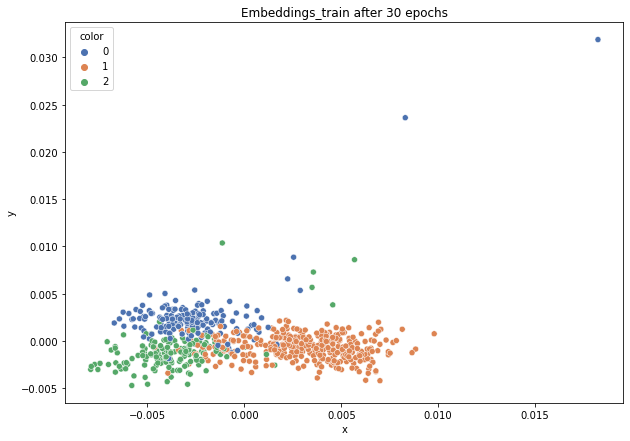

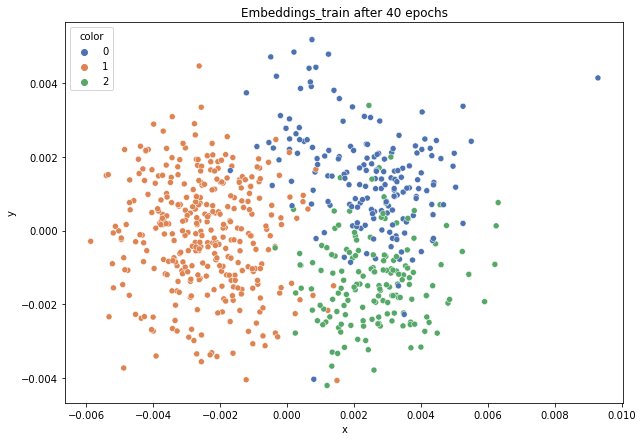

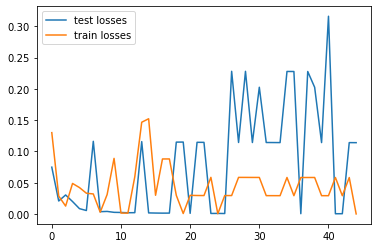

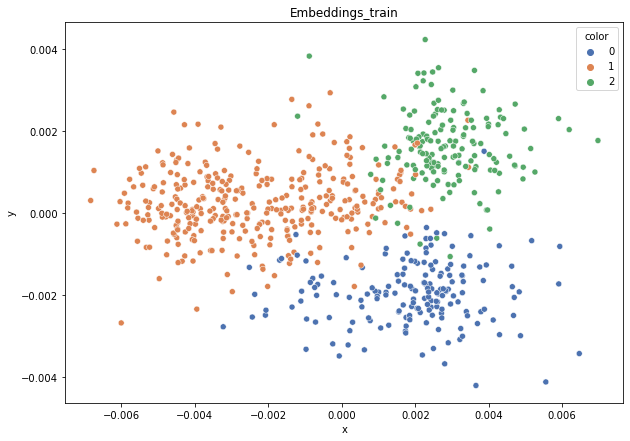

DT-f1-new-features: 0.689
DT-f1-old+new-features: 0.725
DT-f1-old-features: 0.906
DT-gmean-new-features: 0.705
DT-gmean-old+new-features: 0.737
DT-gmean-old-features: 0.904
KNN-f1-new-features: 0.829
KNN-f1-old+new-features: 0.9
KNN-f1-old-features: 0.9
KNN-gmean-new-features: 0.821
KNN-gmean-old+new-features: 0.908
KNN-gmean-old-features: 0.908
LDA-f1-new-features: 0.906
LDA-f1-old+new-features: 0.95
LDA-f1-old-features: 0.933
LDA-gmean-new-features: 0.911
LDA-gmean-old+new-features: 0.952
LDA-gmean-old-features: 0.94
QDA-f1-new-features: 0.859
QDA-f1-old+new-features: 0.949
QDA-f1-old-features: 0.988
QDA-gmean-new-features: 0.845
QDA-gmean-old+new-features: 0.939
QDA-gmean-old-features: 0.992
RF24-f1-new-features: 0.798
RF24-f1-old+new-features: 0.904
RF24-f1-old-features: 0.958
RF24-gmean-new-features: 0.791
RF24-gmean-old+new-features: 0.904
RF24-gmean-old-features: 0.968


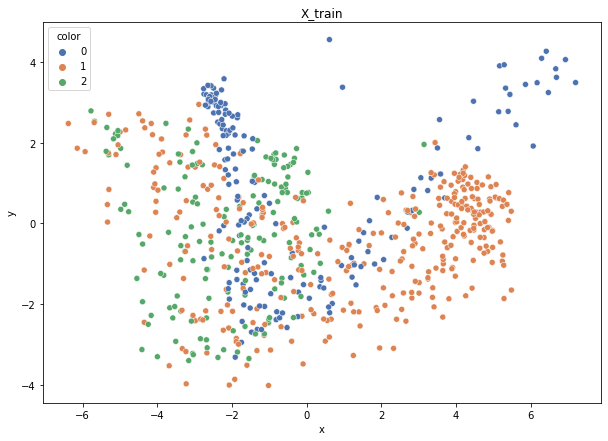

Class cardinalities: Counter({1: 343, 0: 175, 2: 159})
Weights: {2: 0.4215623617324616, 1: 0.19541812103633058, 0: 0.3830195172312079}


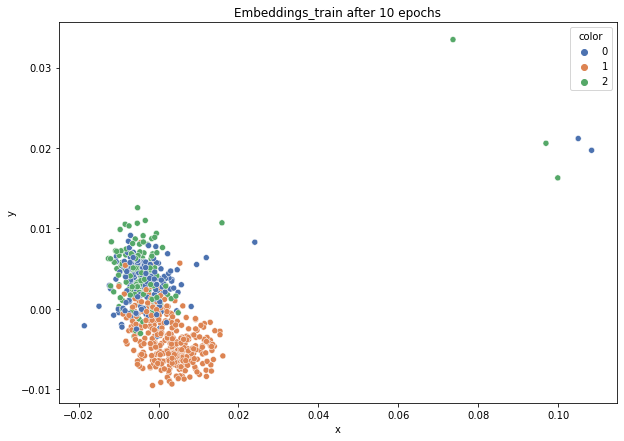

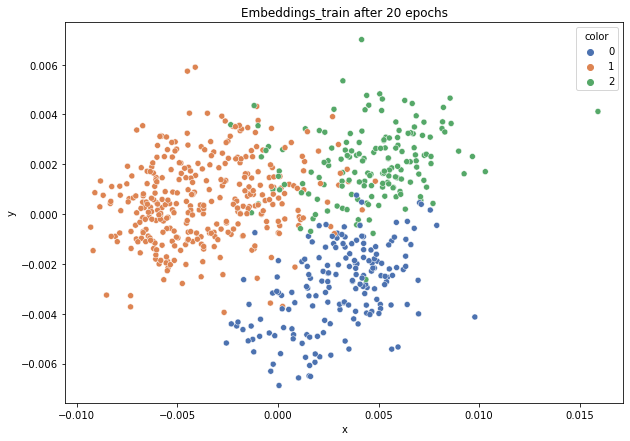

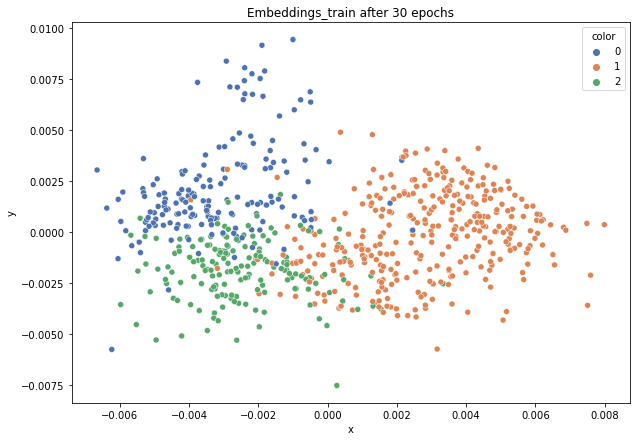

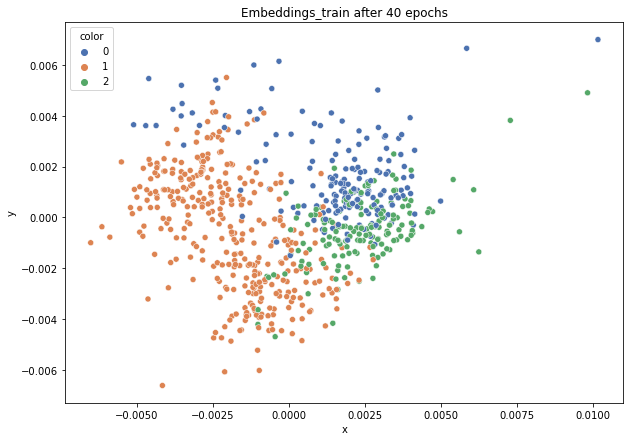

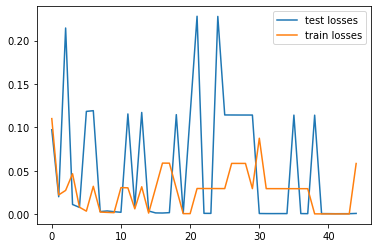

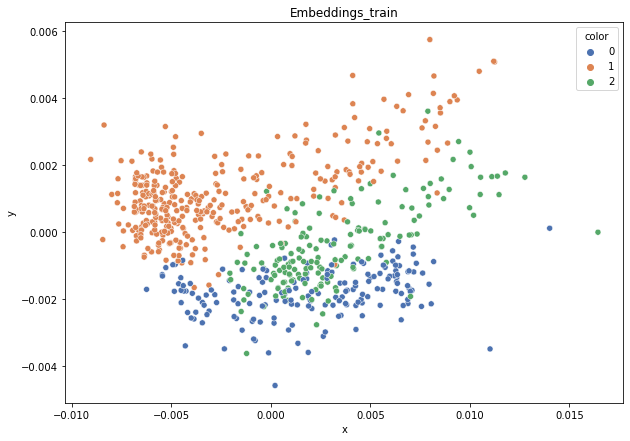

DT-f1-new-features: 0.682
DT-f1-old+new-features: 0.839
DT-f1-old-features: 0.89
DT-gmean-new-features: 0.67
DT-gmean-old+new-features: 0.844
DT-gmean-old-features: 0.895
KNN-f1-new-features: 0.797
KNN-f1-old+new-features: 0.899
KNN-f1-old-features: 0.899
KNN-gmean-new-features: 0.8
KNN-gmean-old+new-features: 0.897
KNN-gmean-old-features: 0.897
LDA-f1-new-features: 0.851
LDA-f1-old+new-features: 0.906
LDA-f1-old-features: 0.965
LDA-gmean-new-features: 0.842
LDA-gmean-old+new-features: 0.909
LDA-gmean-old-features: 0.964
QDA-f1-new-features: 0.841
QDA-f1-old+new-features: 0.964
QDA-f1-old-features: 0.976
QDA-gmean-new-features: 0.83
QDA-gmean-old+new-features: 0.956
QDA-gmean-old-features: 0.975
RF24-f1-new-features: 0.78
RF24-f1-old+new-features: 0.927
RF24-f1-old-features: 0.952
RF24-gmean-new-features: 0.772
RF24-gmean-old+new-features: 0.929
RF24-gmean-old-features: 0.955


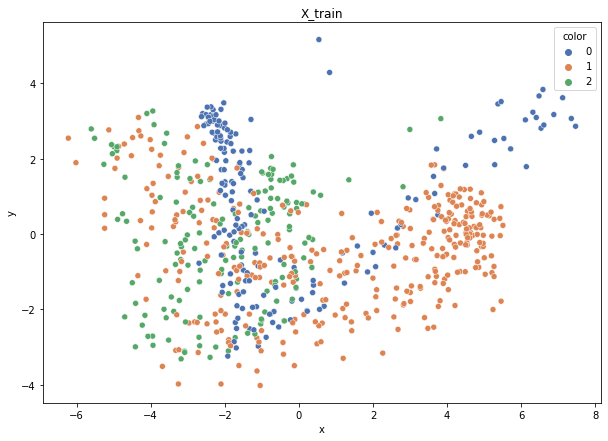

Class cardinalities: Counter({1: 344, 0: 174, 2: 159})
Weights: {2: 0.42087499472640594, 0: 0.3845926675948192, 1: 0.19453233767877484}


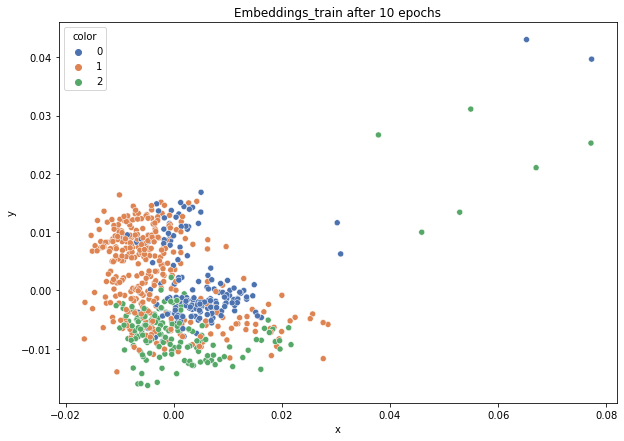

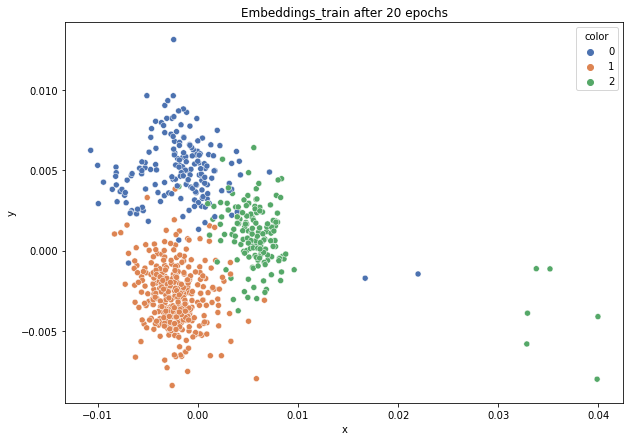

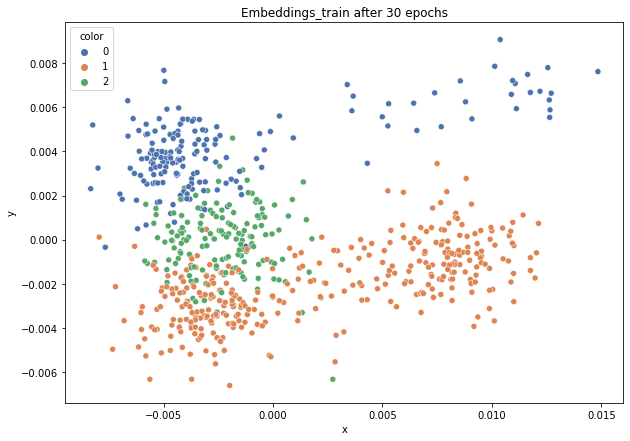

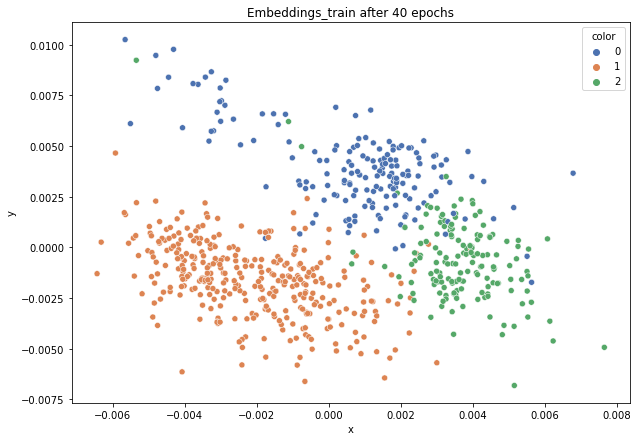

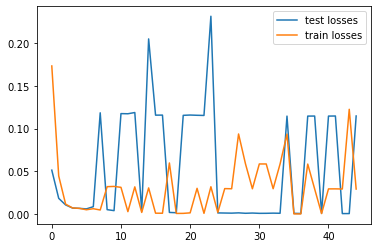

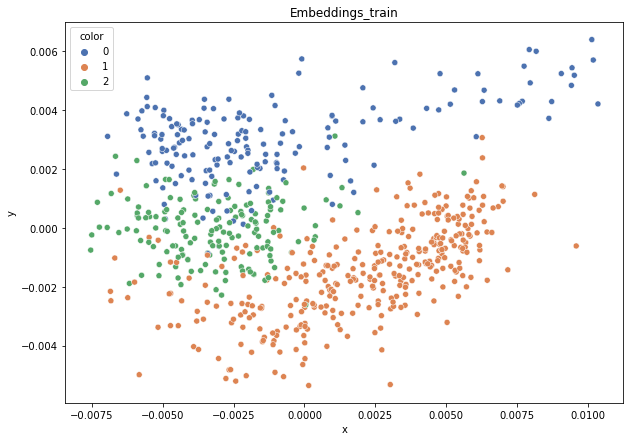

DT-f1-new-features: 0.722
DT-f1-old+new-features: 0.744
DT-f1-old-features: 0.909
DT-gmean-new-features: 0.72
DT-gmean-old+new-features: 0.741
DT-gmean-old-features: 0.916
KNN-f1-new-features: 0.85
KNN-f1-old+new-features: 0.937
KNN-f1-old-features: 0.937
KNN-gmean-new-features: 0.849
KNN-gmean-old+new-features: 0.927
KNN-gmean-old-features: 0.927
LDA-f1-new-features: 0.9
LDA-f1-old+new-features: 0.945
LDA-f1-old-features: 0.953
LDA-gmean-new-features: 0.9
LDA-gmean-old+new-features: 0.94
LDA-gmean-old-features: 0.957
QDA-f1-new-features: 0.85
QDA-f1-old+new-features: 0.974
QDA-f1-old-features: 0.988
QDA-gmean-new-features: 0.843
QDA-gmean-old+new-features: 0.972
QDA-gmean-old-features: 0.988
RF24-f1-new-features: 0.808
RF24-f1-old+new-features: 0.902
RF24-f1-old-features: 0.976
RF24-gmean-new-features: 0.799
RF24-gmean-old+new-features: 0.893
RF24-gmean-old-features: 0.977


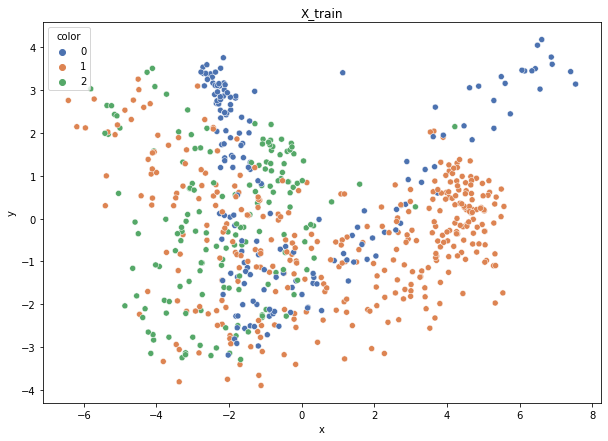

Class cardinalities: Counter({1: 343, 0: 174, 2: 160})
Weights: {2: 0.4191092821730032, 1: 0.19550287215067205, 0: 0.3853878456763248}


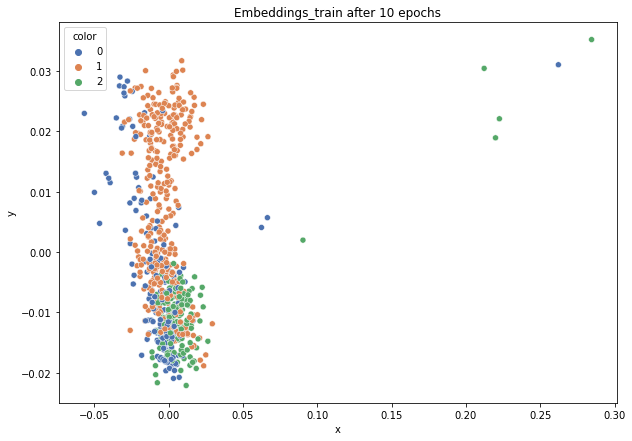

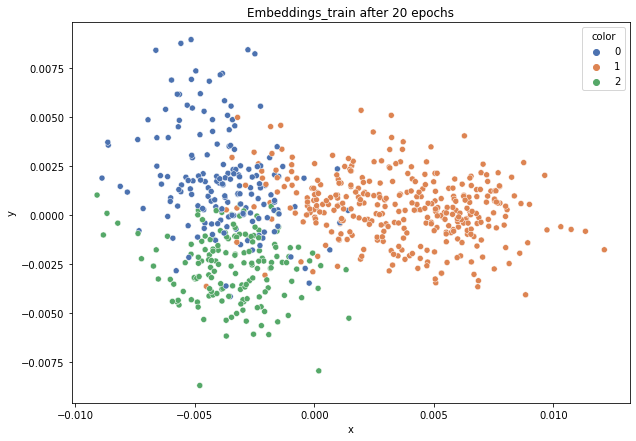

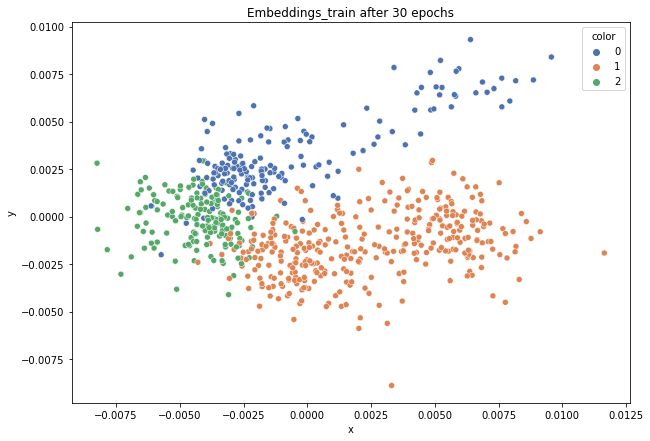

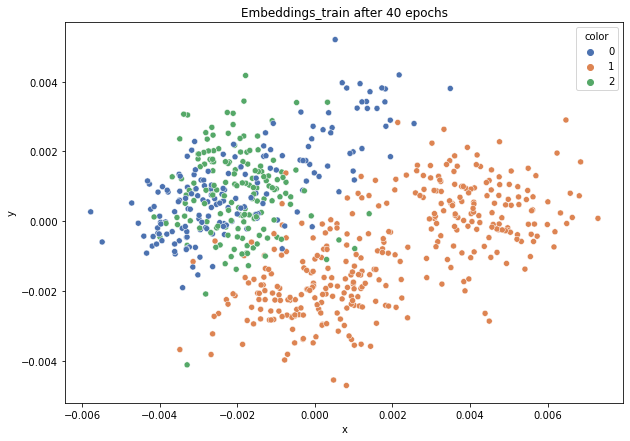

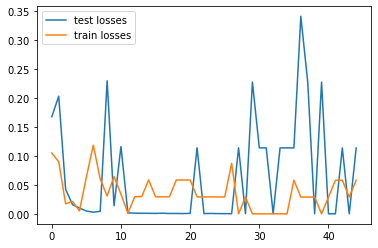

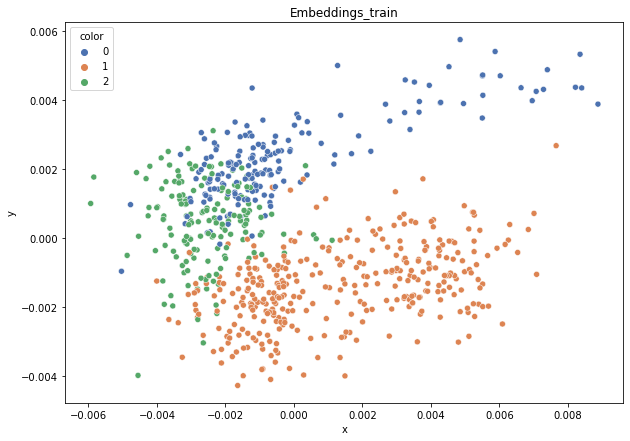

DT-f1-new-features: 0.722
DT-f1-old+new-features: 0.793
DT-f1-old-features: 0.877
DT-gmean-new-features: 0.728
DT-gmean-old+new-features: 0.795
DT-gmean-old-features: 0.87
KNN-f1-new-features: 0.795
KNN-f1-old+new-features: 0.937
KNN-f1-old-features: 0.937
KNN-gmean-new-features: 0.797
KNN-gmean-old+new-features: 0.935
KNN-gmean-old-features: 0.935
LDA-f1-new-features: 0.833
LDA-f1-old+new-features: 0.918
LDA-f1-old-features: 0.939
LDA-gmean-new-features: 0.822
LDA-gmean-old+new-features: 0.91
LDA-gmean-old-features: 0.941
QDA-f1-new-features: 0.851
QDA-f1-old+new-features: 0.951
QDA-f1-old-features: 0.964
QDA-gmean-new-features: 0.842
QDA-gmean-old+new-features: 0.947
QDA-gmean-old-features: 0.969
RF24-f1-new-features: 0.833
RF24-f1-old+new-features: 0.887
RF24-f1-old-features: 0.978
RF24-gmean-new-features: 0.824
RF24-gmean-old+new-features: 0.876
RF24-gmean-old-features: 0.981
new_yeast


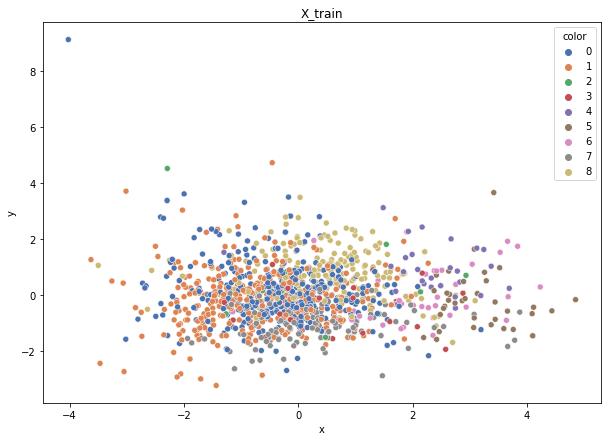

Class cardinalities: Counter({0: 370, 1: 343, 8: 195, 7: 135, 6: 40, 5: 36, 4: 28, 3: 24, 2: 16})
Weights: {8: 0.024325906642526016, 0: 0.012820410257547495, 1: 0.013829597070823827, 5: 0.1317653276470159, 4: 0.16941256411759187, 6: 0.11858879488231433, 3: 0.19764799147052386, 7: 0.03513742070587091, 2: 0.2964719872057858}


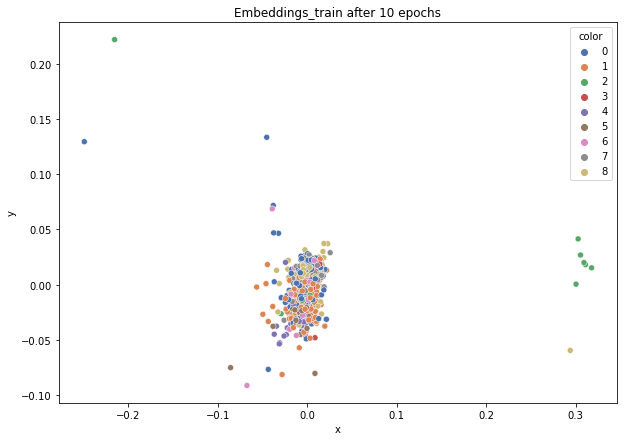

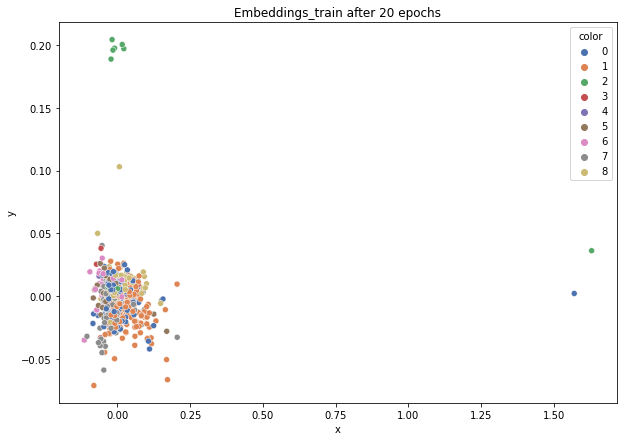

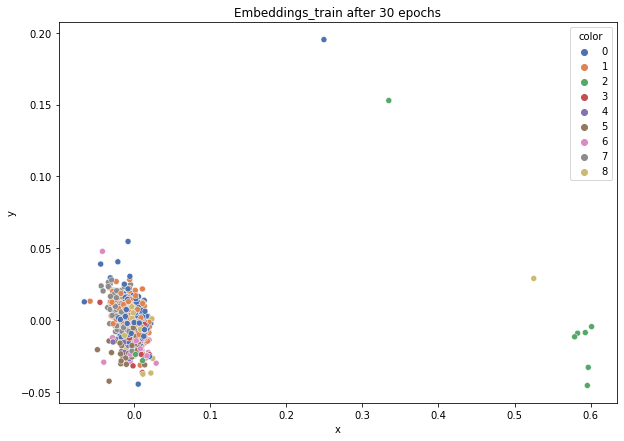

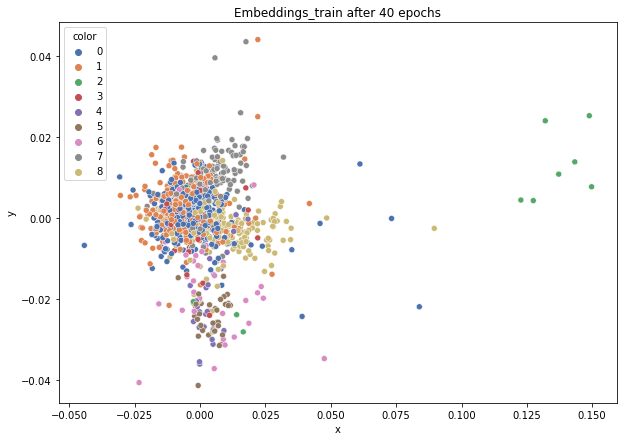

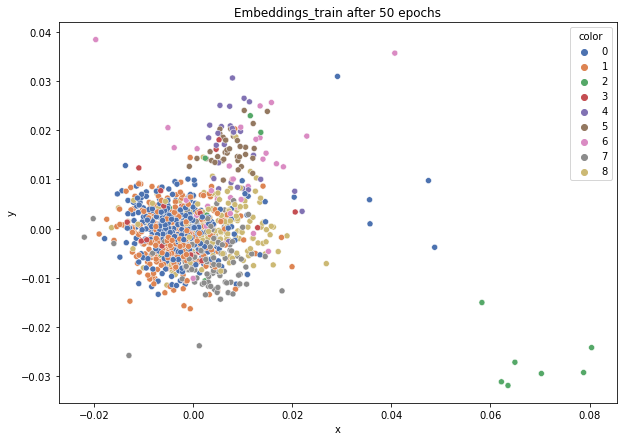

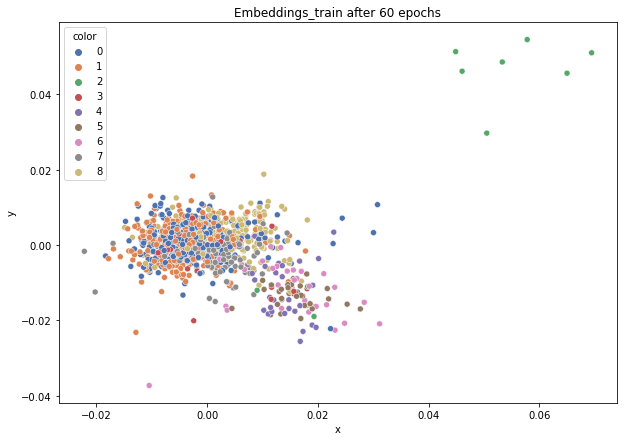

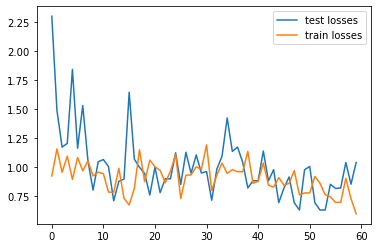

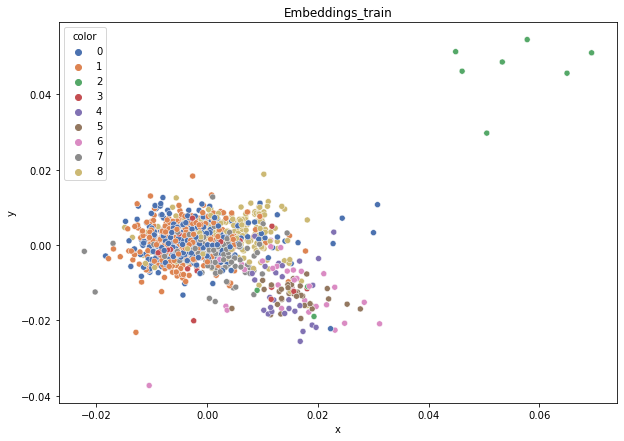

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/discriminant_analysis.py:715: UserWarning: Variables are collinear
  warnings.warn("Variables are collinear")
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/discriminant_analysis.py:715: UserWarning: Variables are collinear
  warnings.warn("Variables are collinear")


DT-f1-new-features: 0.328
DT-f1-old+new-features: 0.48
DT-f1-old-features: 0.494
DT-gmean-new-features: 0.186
DT-gmean-old+new-features: 0.263
DT-gmean-old-features: 0.271
KNN-f1-new-features: 0.485
KNN-f1-old+new-features: 0.545
KNN-f1-old-features: 0.545
KNN-gmean-new-features: 0.425
KNN-gmean-old+new-features: 0.51
KNN-gmean-old-features: 0.51
LDA-f1-new-features: 0.44
LDA-f1-old+new-features: 0.521
LDA-f1-old-features: 0.564
LDA-gmean-new-features: 0.242
LDA-gmean-old+new-features: 0.472
LDA-gmean-old-features: 0.308
QDA-f1-new-features: 0.455
QDA-f1-old+new-features: 0.224
QDA-f1-old-features: 0.171
QDA-gmean-new-features: 0.415
QDA-gmean-old+new-features: 0.054
QDA-gmean-old-features: 0.047
RF24-f1-new-features: 0.464
RF24-f1-old+new-features: 0.59
RF24-f1-old-features: 0.565
RF24-gmean-new-features: 0.258
RF24-gmean-old+new-features: 0.552
RF24-gmean-old-features: 0.313


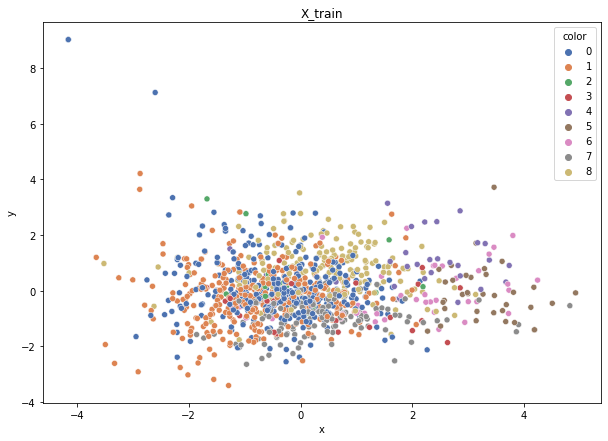

Class cardinalities: Counter({0: 371, 1: 343, 8: 195, 7: 134, 6: 41, 5: 35, 4: 28, 3: 24, 2: 16})
Weights: {1: 0.013814401543936261, 8: 0.02429917810035968, 0: 0.012771805200997676, 5: 0.13538113513057534, 6: 0.11556926169683263, 7: 0.035360744250523414, 3: 0.1974308220654224, 4: 0.16922641891321918, 2: 0.2961462330981336}


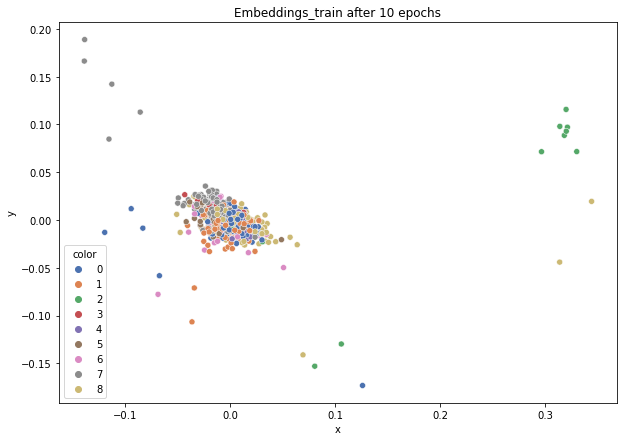

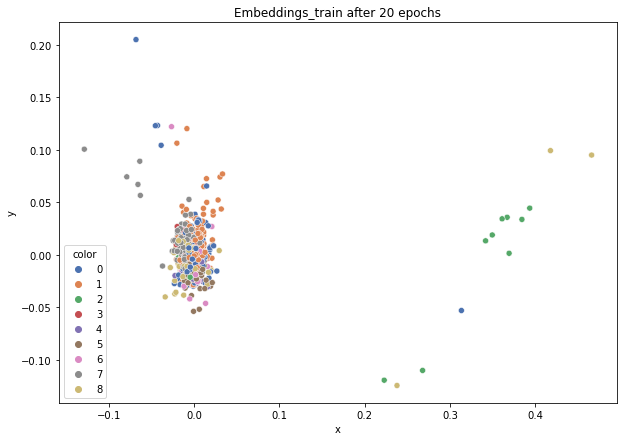

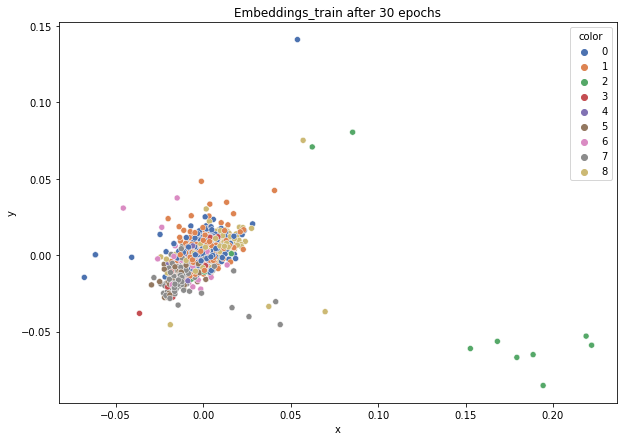

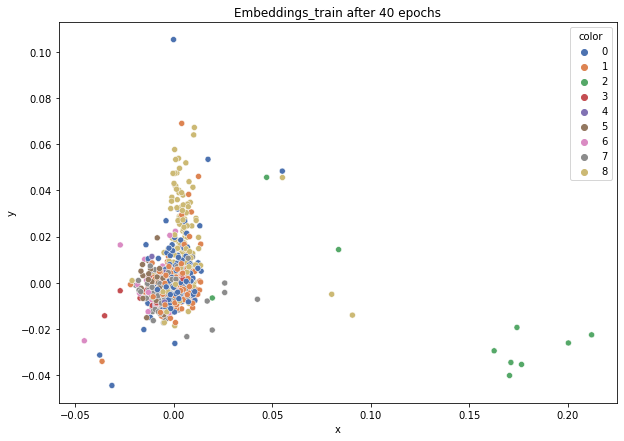

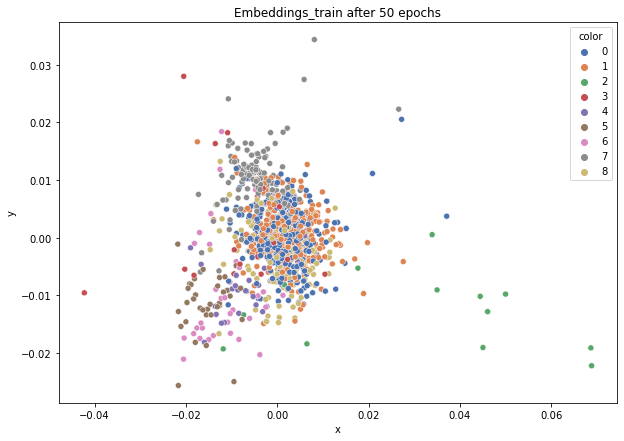

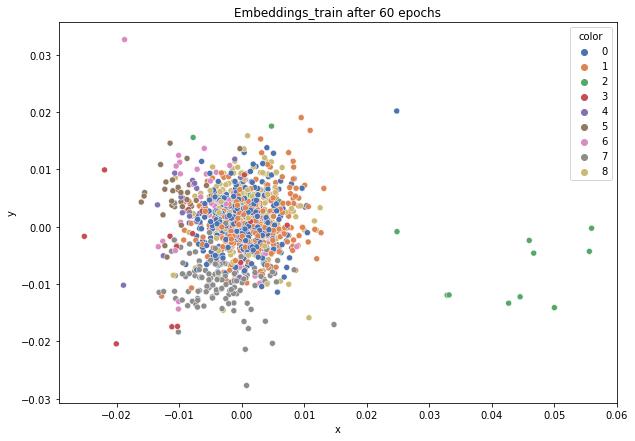

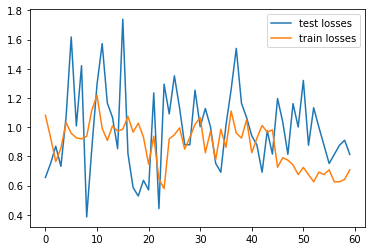

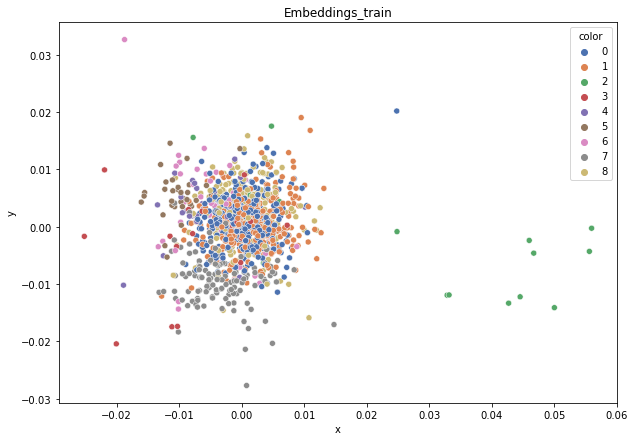

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/discriminant_analysis.py:715: UserWarning: Variables are collinear
  warnings.warn("Variables are collinear")
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/discriminant_analysis.py:715: UserWarning: Variables are collinear
  warnings.warn("Variables are collinear")


DT-f1-new-features: 0.34
DT-f1-old+new-features: 0.404
DT-f1-old-features: 0.451
DT-gmean-new-features: 0.188
DT-gmean-old+new-features: 0.397
DT-gmean-old-features: 0.26
KNN-f1-new-features: 0.44
KNN-f1-old+new-features: 0.494
KNN-f1-old-features: 0.494
KNN-gmean-new-features: 0.22
KNN-gmean-old+new-features: 0.268
KNN-gmean-old-features: 0.268
LDA-f1-new-features: 0.448
LDA-f1-old+new-features: 0.565
LDA-f1-old-features: 0.57
LDA-gmean-new-features: 0.234
LDA-gmean-old+new-features: 0.301
LDA-gmean-old-features: 0.307
QDA-f1-new-features: 0.367
QDA-f1-old+new-features: 0.314
QDA-f1-old-features: 0.1
QDA-gmean-new-features: 0.196
QDA-gmean-old+new-features: 0.111
QDA-gmean-old-features: 0.033
RF24-f1-new-features: 0.439
RF24-f1-old+new-features: 0.562
RF24-f1-old-features: 0.612
RF24-gmean-new-features: 0.239
RF24-gmean-old+new-features: 0.302
RF24-gmean-old-features: 0.332


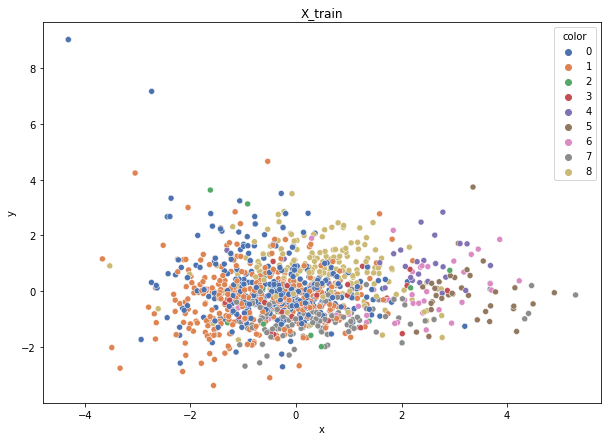

Class cardinalities: Counter({0: 371, 1: 343, 8: 195, 7: 134, 6: 41, 5: 35, 4: 28, 3: 24, 2: 16})
Weights: {8: 0.024299178100359677, 1: 0.01381440154393626, 0: 0.012771805200997674, 5: 0.13538113513057534, 4: 0.16922641891321916, 6: 0.11556926169683261, 7: 0.03536074425052341, 3: 0.19743082206542237, 2: 0.29614623309813354}


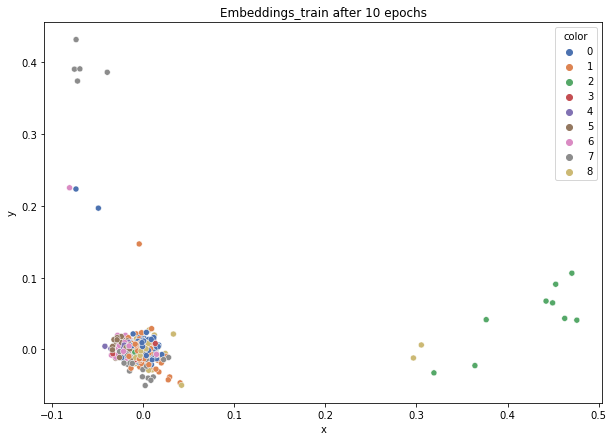

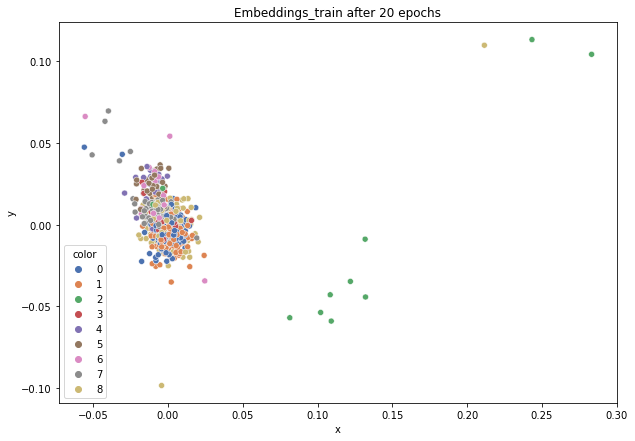

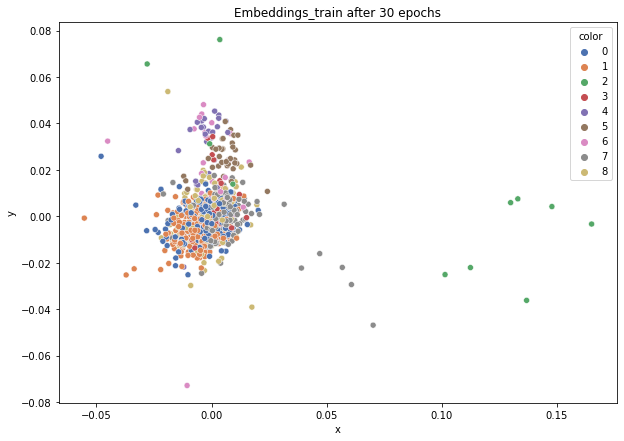

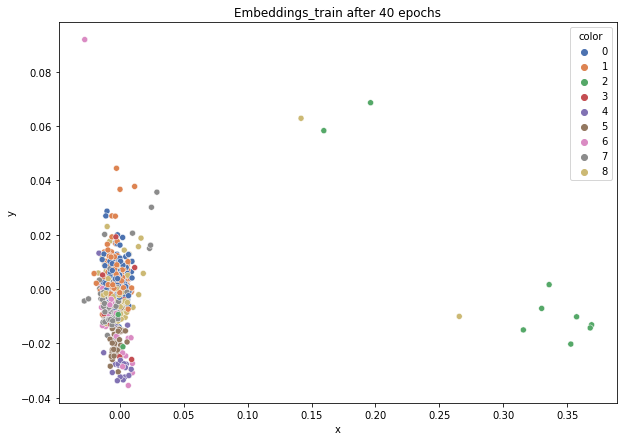

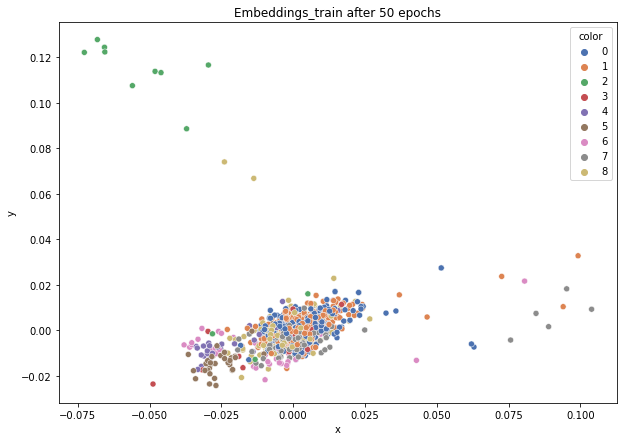

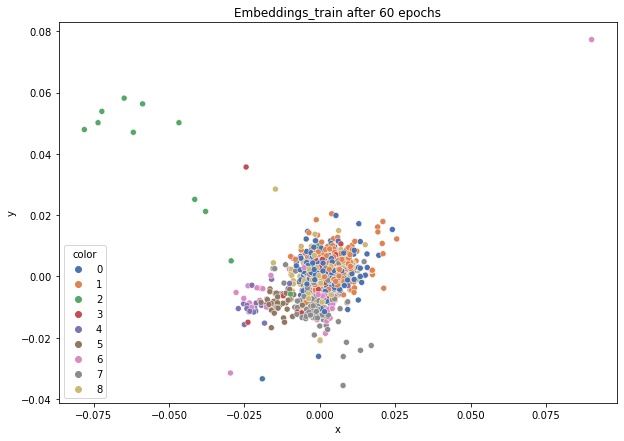

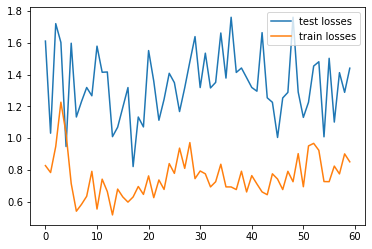

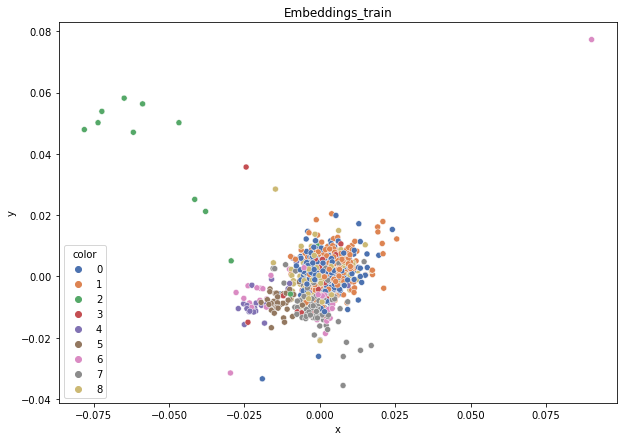

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/discriminant_analysis.py:715: UserWarning: Variables are collinear
  warnings.warn("Variables are collinear")
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/discriminant_analysis.py:715: UserWarning: Variables are collinear
  warnings.warn("Variables are collinear")


DT-f1-new-features: 0.258
DT-f1-old+new-features: 0.356
DT-f1-old-features: 0.407
DT-gmean-new-features: 0.154
DT-gmean-old+new-features: 0.204
DT-gmean-old-features: 0.401
KNN-f1-new-features: 0.367
KNN-f1-old+new-features: 0.451
KNN-f1-old-features: 0.451
KNN-gmean-new-features: 0.193
KNN-gmean-old+new-features: 0.422
KNN-gmean-old-features: 0.422
LDA-f1-new-features: 0.35
LDA-f1-old+new-features: 0.465
LDA-f1-old-features: 0.492
LDA-gmean-new-features: 0.183
LDA-gmean-old+new-features: 0.253
LDA-gmean-old-features: 0.267
QDA-f1-new-features: 0.347
QDA-f1-old+new-features: 0.228
QDA-f1-old-features: 0.262
QDA-gmean-new-features: 0.192
QDA-gmean-old+new-features: 0.123
QDA-gmean-old-features: 0.079
RF24-f1-new-features: 0.334
RF24-f1-old+new-features: 0.455
RF24-f1-old-features: 0.538
RF24-gmean-new-features: 0.181
RF24-gmean-old+new-features: 0.245
RF24-gmean-old-features: 0.474


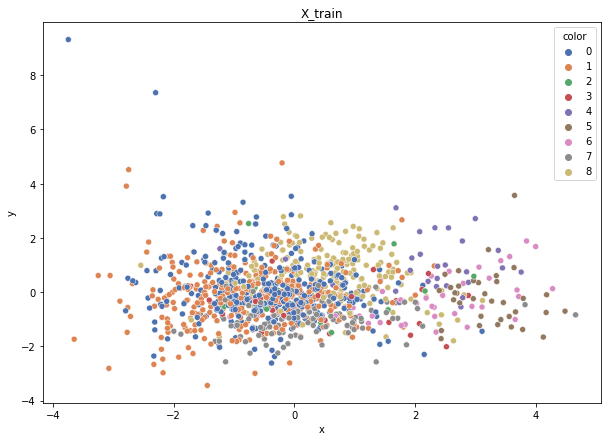

Class cardinalities: Counter({0: 370, 1: 344, 8: 195, 7: 134, 6: 41, 5: 35, 4: 28, 3: 24, 2: 16})
Weights: {8: 0.024299315142460837, 1: 0.013774321083662392, 0: 0.012806395818323955, 5: 0.13538189865085323, 4: 0.16922737331356652, 6: 0.11556991348243568, 7: 0.03536094367746166, 3: 0.1974319355324943, 2: 0.29614790329874147}


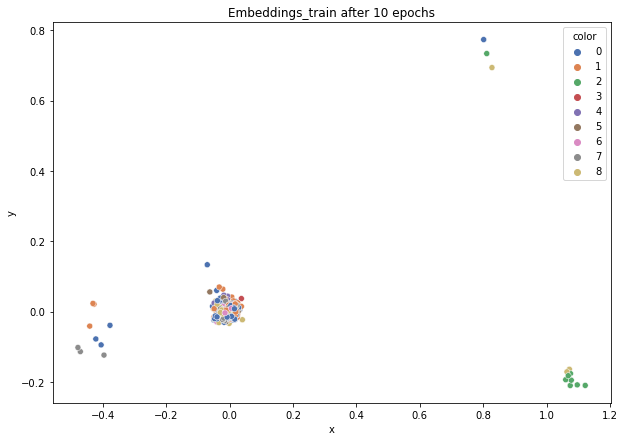

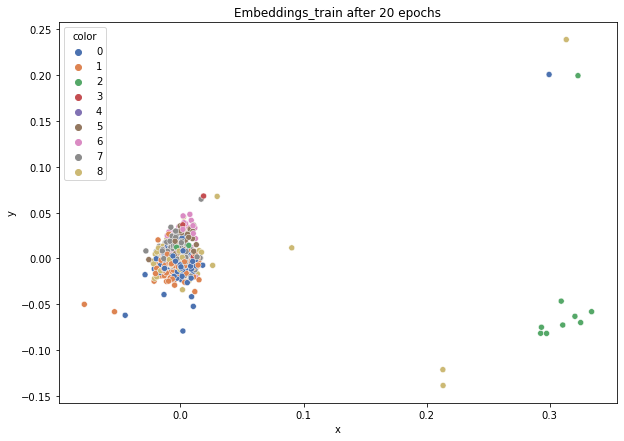

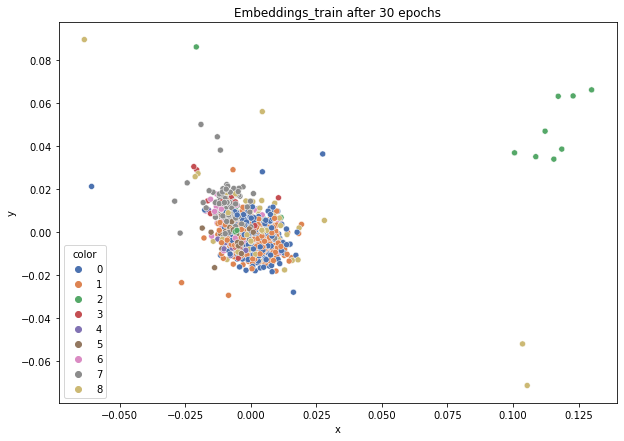

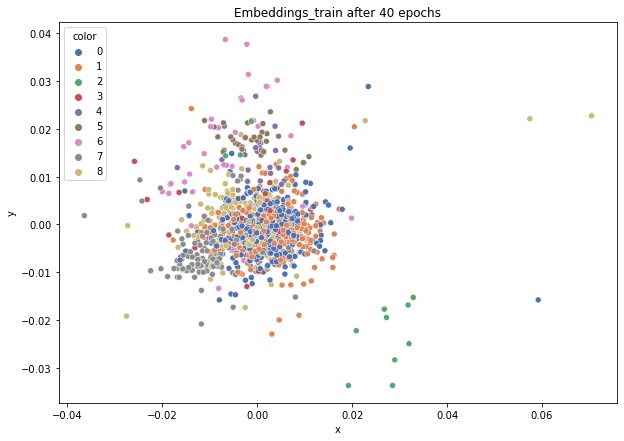

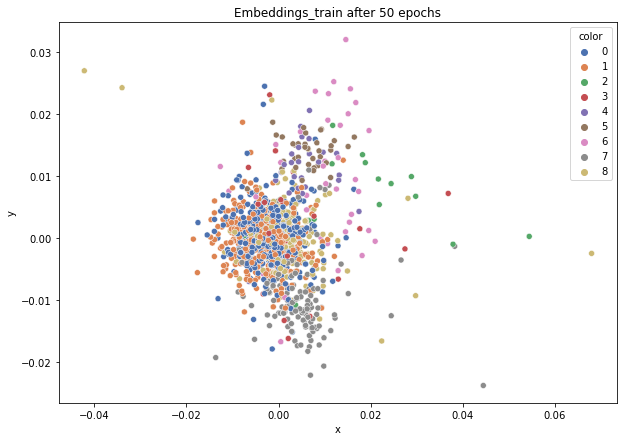

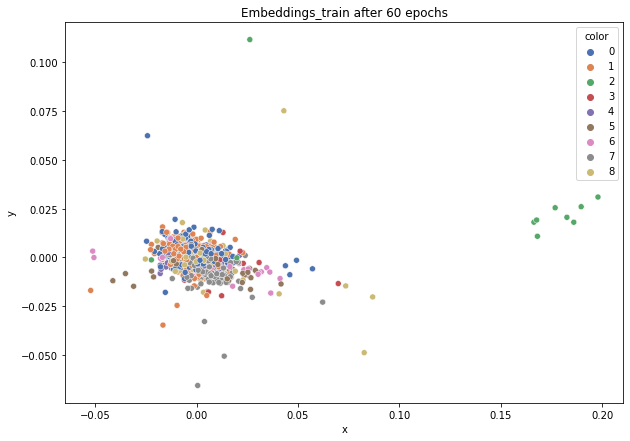

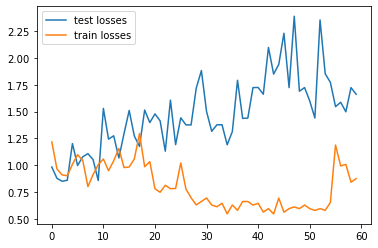

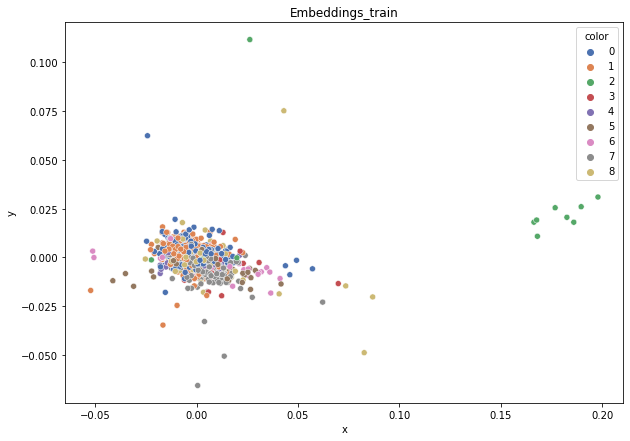

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/discriminant_analysis.py:715: UserWarning: Variables are collinear
  warnings.warn("Variables are collinear")
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/discriminant_analysis.py:715: UserWarning: Variables are collinear
  warnings.warn("Variables are collinear")


DT-f1-new-features: 0.26
DT-f1-old+new-features: 0.358
DT-f1-old-features: 0.437
DT-gmean-new-features: 0.151
DT-gmean-old+new-features: 0.332
DT-gmean-old-features: 0.247
KNN-f1-new-features: 0.395
KNN-f1-old+new-features: 0.492
KNN-f1-old-features: 0.492
KNN-gmean-new-features: 0.363
KNN-gmean-old+new-features: 0.439
KNN-gmean-old-features: 0.439
LDA-f1-new-features: 0.378
LDA-f1-old+new-features: 0.506
LDA-f1-old-features: 0.5
LDA-gmean-new-features: 0.202
LDA-gmean-old+new-features: 0.27
LDA-gmean-old-features: 0.26
QDA-f1-new-features: 0.347
QDA-f1-old+new-features: 0.148
QDA-f1-old-features: 0.106
QDA-gmean-new-features: 0.109
QDA-gmean-old+new-features: 0.056
QDA-gmean-old-features: 0.026
RF24-f1-new-features: 0.427
RF24-f1-old+new-features: 0.516
RF24-f1-old-features: 0.531
RF24-gmean-new-features: 0.227
RF24-gmean-old+new-features: 0.274
RF24-gmean-old-features: 0.277


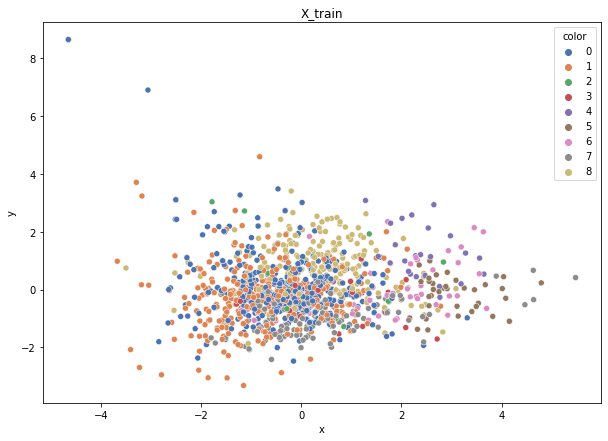

Class cardinalities: Counter({0: 370, 1: 343, 8: 196, 7: 135, 6: 41, 5: 35, 4: 28, 3: 24, 2: 16})
Weights: {8: 0.02418370057482606, 1: 0.013819257471329179, 0: 0.012810825169367322, 5: 0.13542872321902596, 4: 0.16928590402378244, 6: 0.11560988567477826, 7: 0.035111150464191915, 3: 0.1975002213610795, 2: 0.29625033204161927}


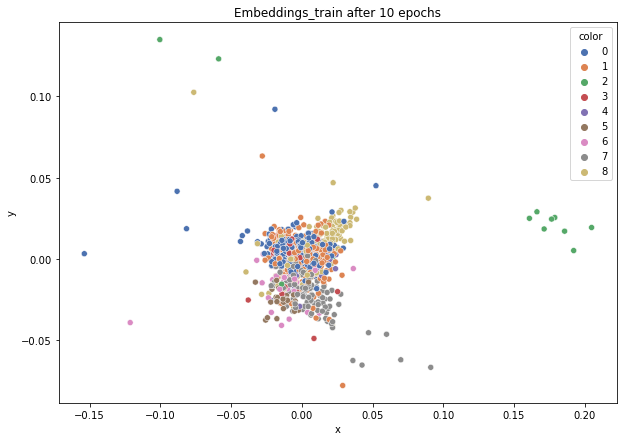

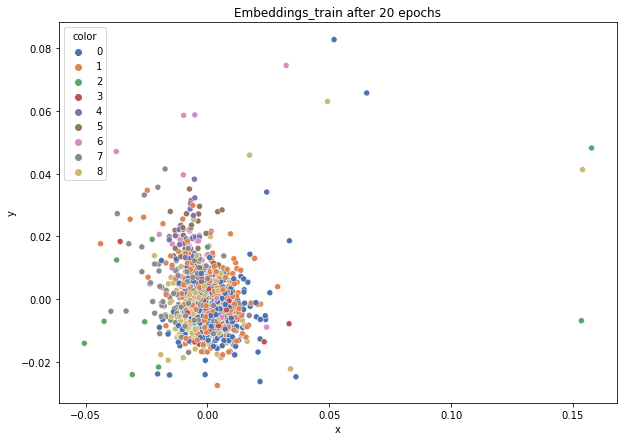

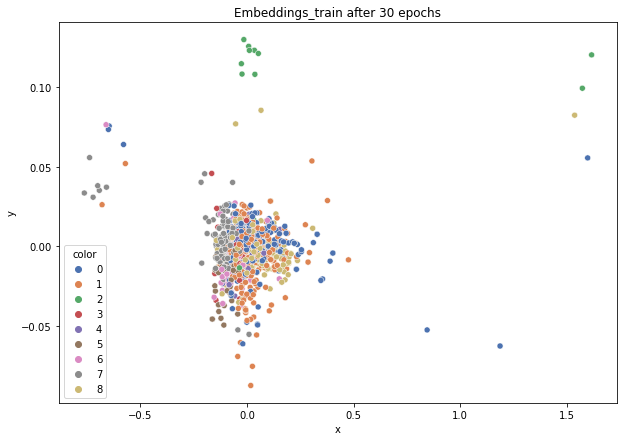

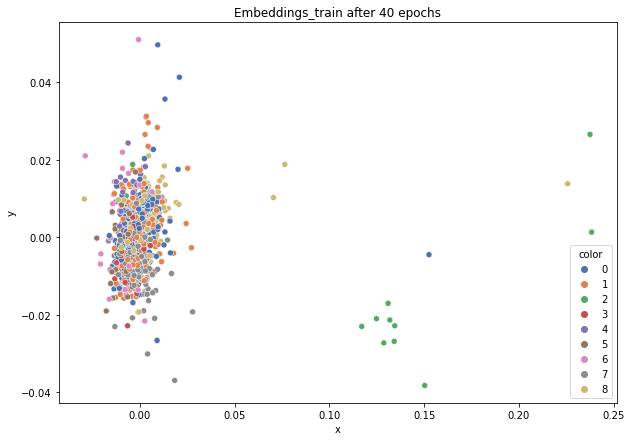

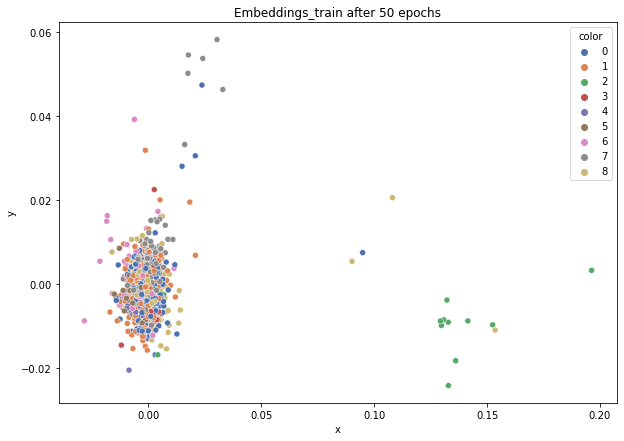

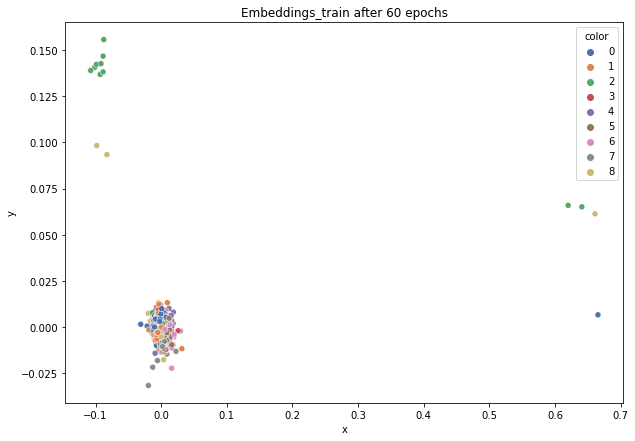

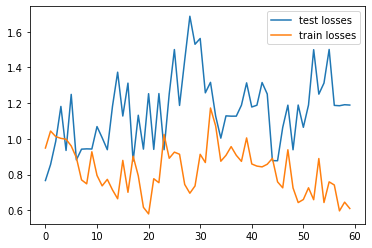

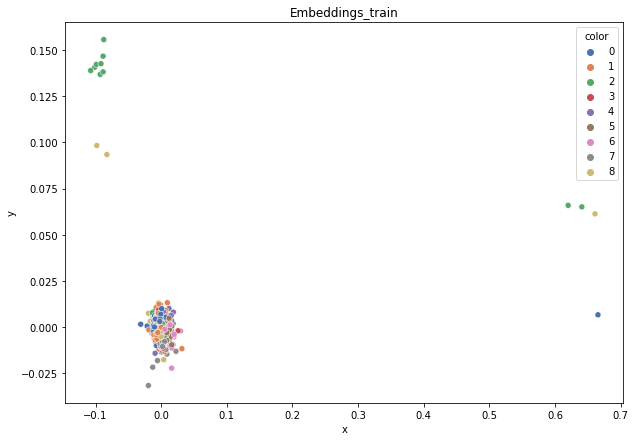

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/discriminant_analysis.py:715: UserWarning: Variables are collinear
  warnings.warn("Variables are collinear")
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/discriminant_analysis.py:715: UserWarning: Variables are collinear
  warnings.warn("Variables are collinear")


DT-f1-new-features: 0.284
DT-f1-old+new-features: 0.403
DT-f1-old-features: 0.423
DT-gmean-new-features: 0.168
DT-gmean-old+new-features: 0.382
DT-gmean-old-features: 0.236
KNN-f1-new-features: 0.376
KNN-f1-old+new-features: 0.452
KNN-f1-old-features: 0.452
KNN-gmean-new-features: 0.195
KNN-gmean-old+new-features: 0.403
KNN-gmean-old-features: 0.403
LDA-f1-new-features: 0.378
LDA-f1-old+new-features: 0.515
LDA-f1-old-features: 0.532
LDA-gmean-new-features: 0.203
LDA-gmean-old+new-features: 0.273
LDA-gmean-old-features: 0.274
QDA-f1-new-features: 0.319
QDA-f1-old+new-features: 0.25
QDA-f1-old-features: 0.118
QDA-gmean-new-features: 0.151
QDA-gmean-old+new-features: 0.098
QDA-gmean-old-features: 0.043
RF24-f1-new-features: 0.398
RF24-f1-old+new-features: 0.531
RF24-f1-old-features: 0.569
RF24-gmean-new-features: 0.215
RF24-gmean-old+new-features: 0.271
RF24-gmean-old-features: 0.295
1czysty-cut


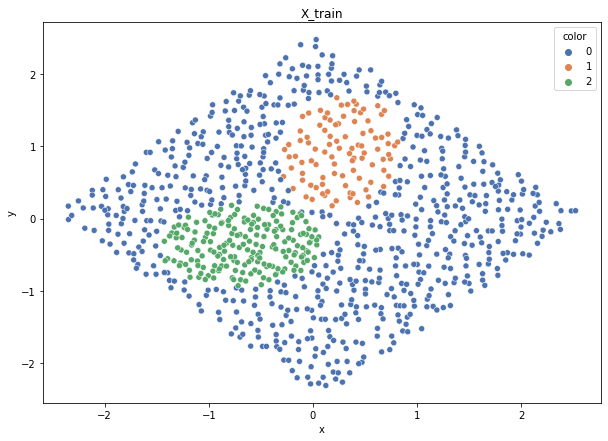

Class cardinalities: Counter({0: 672, 2: 192, 1: 96})
Weights: {1: 0.6086956521739131, 0: 0.08695652173913043, 2: 0.30434782608695654}


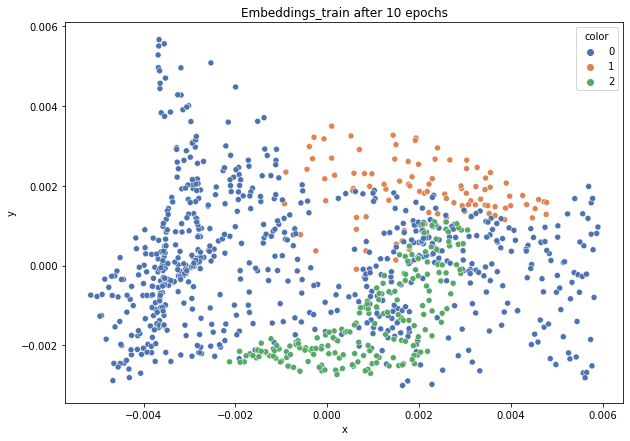

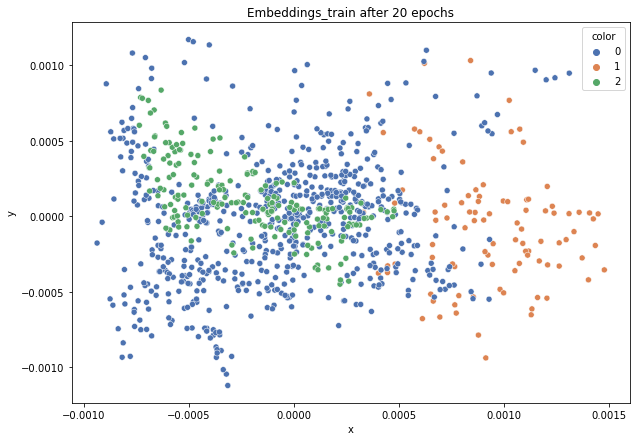

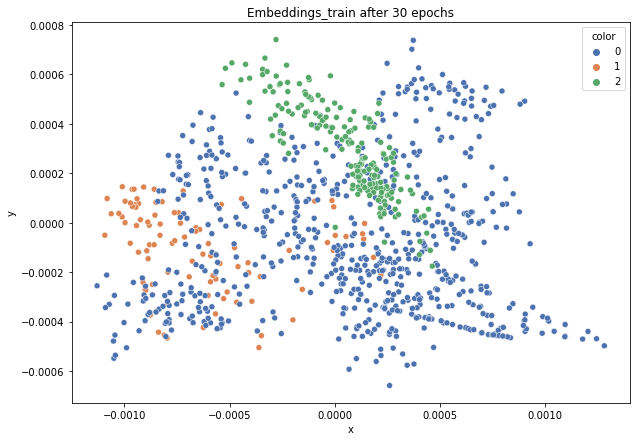

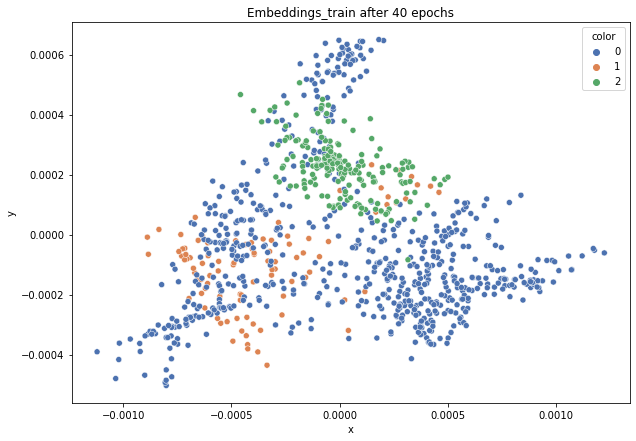

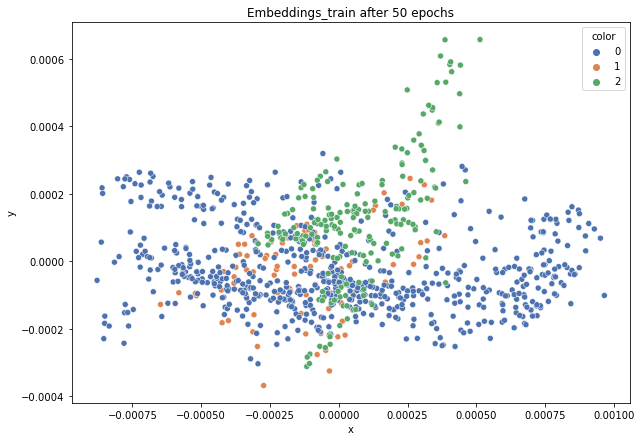

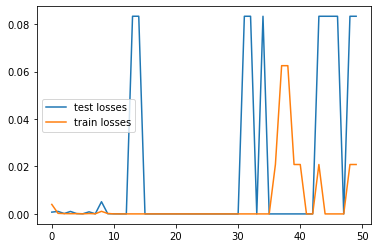

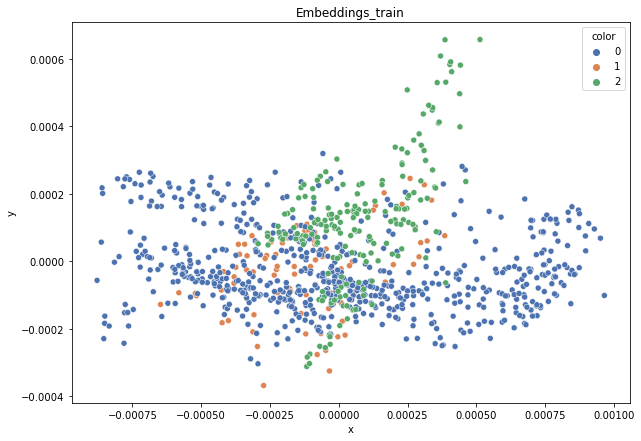

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/discriminant_analysis.py:715: UserWarning: Variables are collinear
  warnings.warn("Variables are collinear")
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/discriminant_analysis.py:715: UserWarning: Variables are collinear
  warnings.warn("Variables are collinear")


DT-f1-new-features: 0.888
DT-f1-old+new-features: 0.935
DT-f1-old-features: 0.901
DT-gmean-new-features: 0.915
DT-gmean-old+new-features: 0.956
DT-gmean-old-features: 0.889
KNN-f1-new-features: 0.927
KNN-f1-old+new-features: 0.937
KNN-f1-old-features: 0.937
KNN-gmean-new-features: 0.92
KNN-gmean-old+new-features: 0.941
KNN-gmean-old-features: 0.941
LDA-f1-new-features: 0.925
LDA-f1-old+new-features: 0.901
LDA-f1-old-features: 0.262
LDA-gmean-new-features: 0.964
LDA-gmean-old+new-features: 0.932
LDA-gmean-old-features: 0.01
QDA-f1-new-features: 0.946
QDA-f1-old+new-features: 0.937
QDA-f1-old-features: 0.805
QDA-gmean-new-features: 0.972
QDA-gmean-old+new-features: 0.953
QDA-gmean-old-features: 0.701
RF24-f1-new-features: 0.915
RF24-f1-old+new-features: 0.93
RF24-f1-old-features: 0.934
RF24-gmean-new-features: 0.933
RF24-gmean-old+new-features: 0.937
RF24-gmean-old-features: 0.939


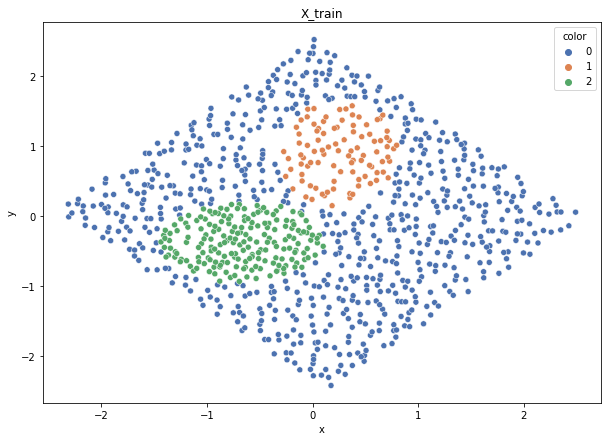

Class cardinalities: Counter({0: 672, 2: 192, 1: 96})
Weights: {1: 0.6086956521739131, 0: 0.08695652173913043, 2: 0.30434782608695654}


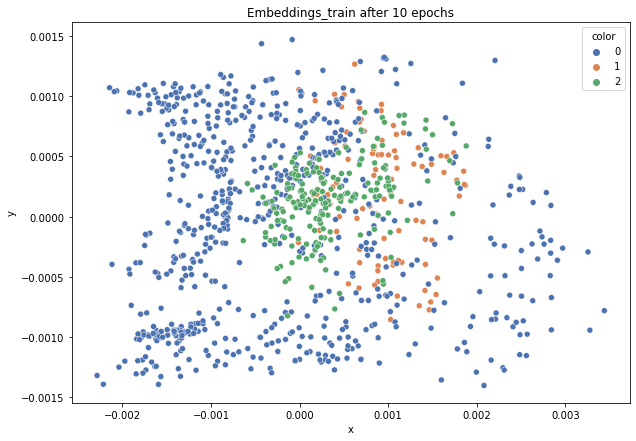

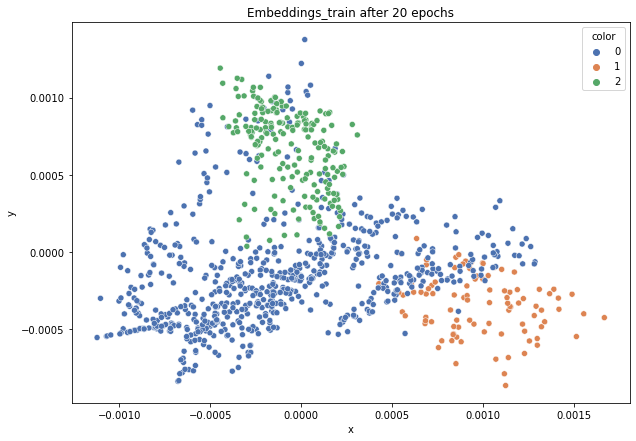

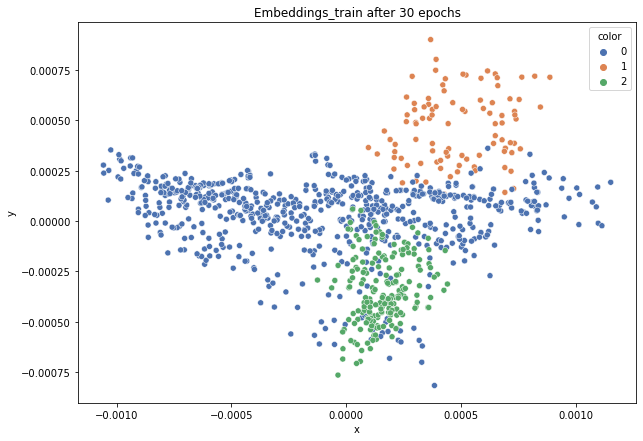

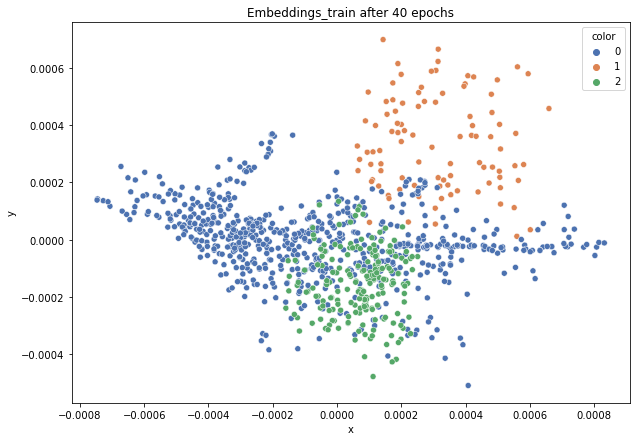

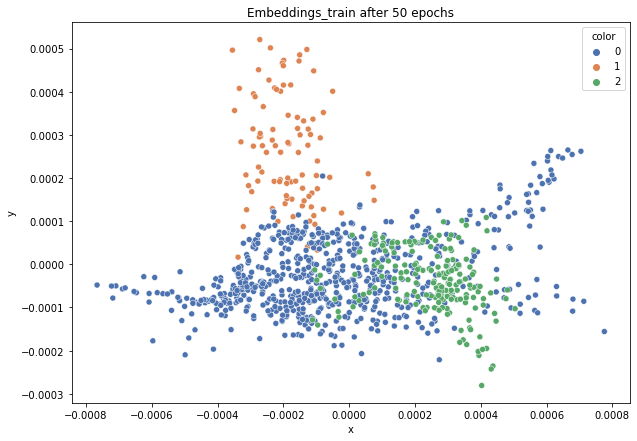

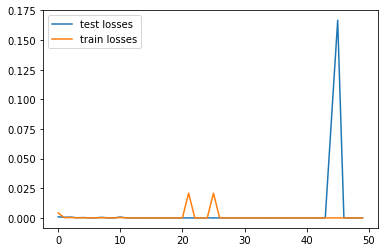

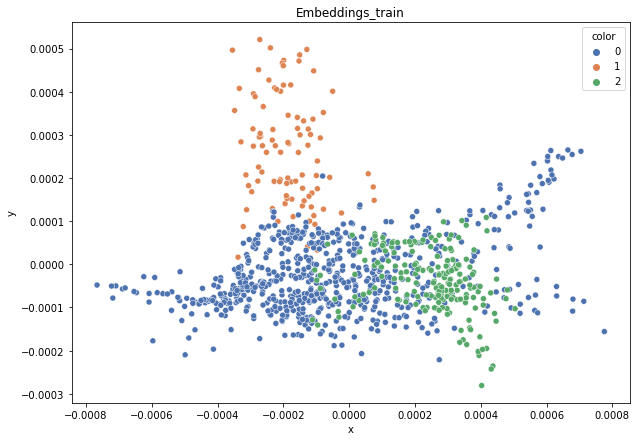

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/discriminant_analysis.py:715: UserWarning: Variables are collinear
  warnings.warn("Variables are collinear")
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/discriminant_analysis.py:715: UserWarning: Variables are collinear
  warnings.warn("Variables are collinear")


DT-f1-new-features: 0.891
DT-f1-old+new-features: 0.881
DT-f1-old-features: 0.929
DT-gmean-new-features: 0.879
DT-gmean-old+new-features: 0.885
DT-gmean-old-features: 0.928
KNN-f1-new-features: 0.877
KNN-f1-old+new-features: 0.945
KNN-f1-old-features: 0.945
KNN-gmean-new-features: 0.88
KNN-gmean-old+new-features: 0.934
KNN-gmean-old-features: 0.934
LDA-f1-new-features: 0.84
LDA-f1-old+new-features: 0.84
LDA-f1-old-features: 0.265
LDA-gmean-new-features: 0.795
LDA-gmean-old+new-features: 0.792
LDA-gmean-old-features: 0.01
QDA-f1-new-features: 0.899
QDA-f1-old+new-features: 0.929
QDA-f1-old-features: 0.817
QDA-gmean-new-features: 0.902
QDA-gmean-old+new-features: 0.928
QDA-gmean-old-features: 0.709
RF24-f1-new-features: 0.889
RF24-f1-old+new-features: 0.911
RF24-f1-old-features: 0.901
RF24-gmean-new-features: 0.853
RF24-gmean-old+new-features: 0.878
RF24-gmean-old-features: 0.906


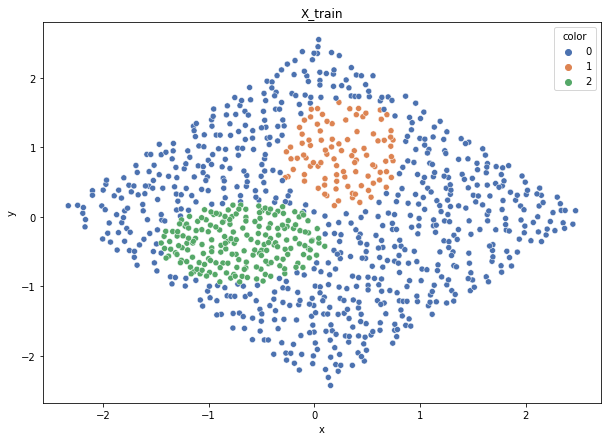

Class cardinalities: Counter({0: 672, 2: 192, 1: 96})
Weights: {1: 0.6086956521739131, 0: 0.08695652173913043, 2: 0.30434782608695654}


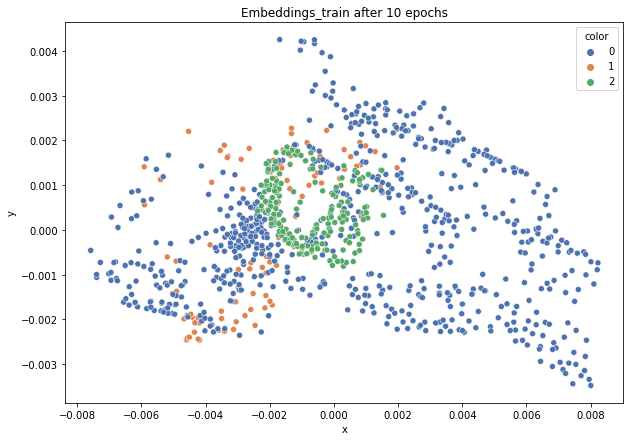

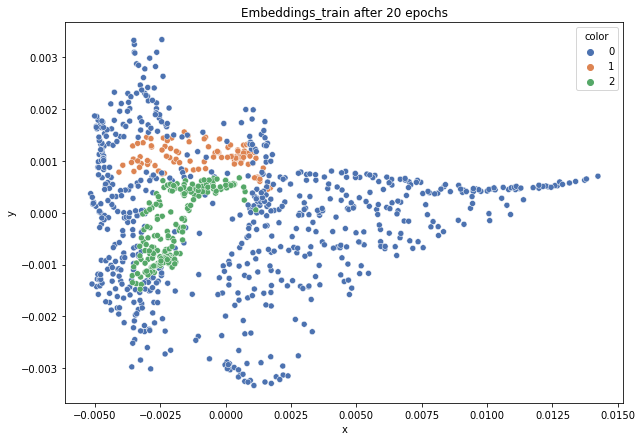

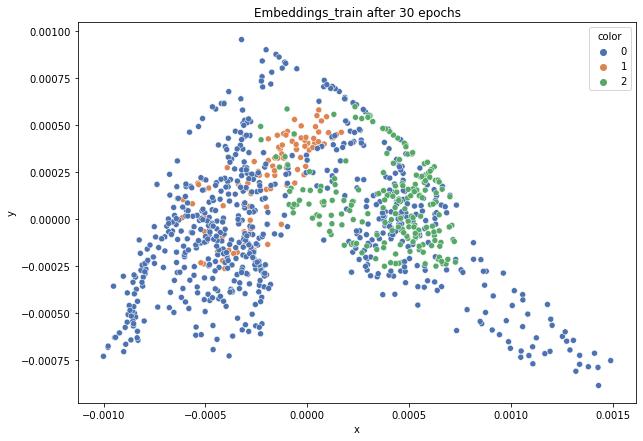

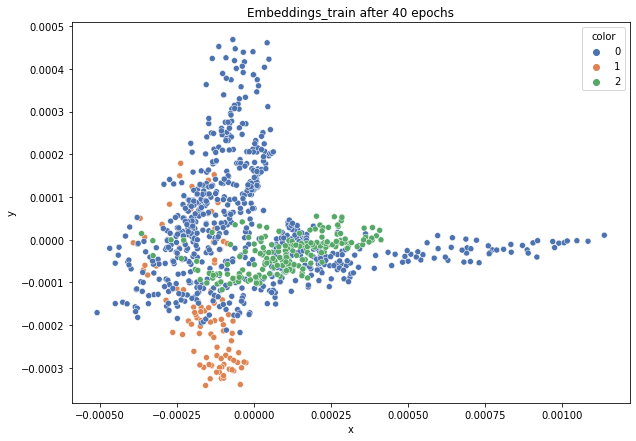

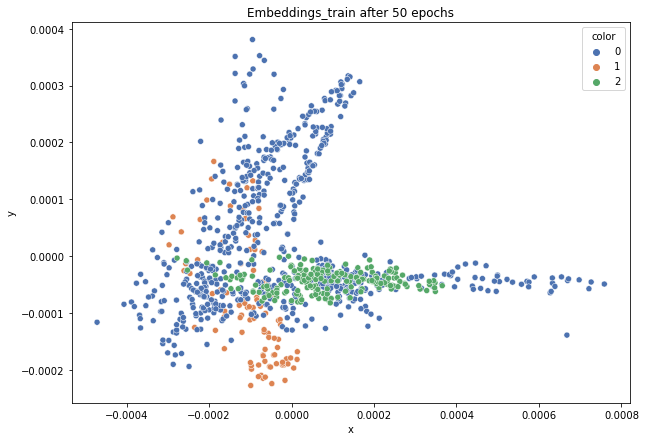

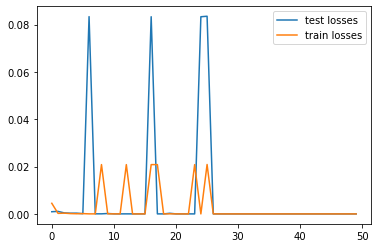

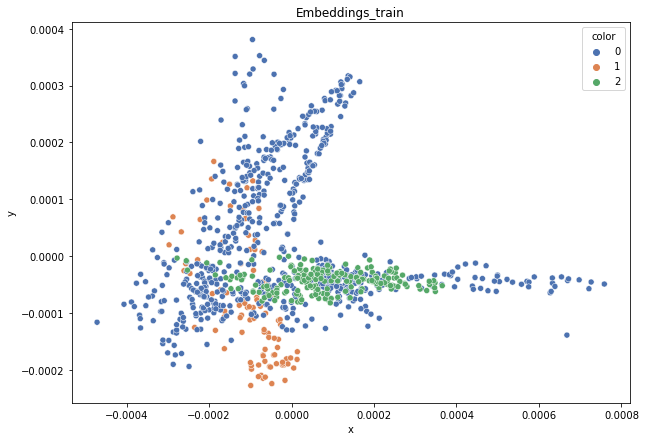

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/discriminant_analysis.py:715: UserWarning: Variables are collinear
  warnings.warn("Variables are collinear")
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/discriminant_analysis.py:715: UserWarning: Variables are collinear
  warnings.warn("Variables are collinear")


DT-f1-new-features: 0.772
DT-f1-old+new-features: 0.951
DT-f1-old-features: 0.942
DT-gmean-new-features: 0.782
DT-gmean-old+new-features: 0.949
DT-gmean-old-features: 0.934
KNN-f1-new-features: 0.914
KNN-f1-old+new-features: 0.957
KNN-f1-old-features: 0.957
KNN-gmean-new-features: 0.928
KNN-gmean-old+new-features: 0.933
KNN-gmean-old-features: 0.933
LDA-f1-new-features: 0.785
LDA-f1-old+new-features: 0.824
LDA-f1-old-features: 0.256
LDA-gmean-new-features: 0.765
LDA-gmean-old+new-features: 0.815
LDA-gmean-old-features: 0.01
QDA-f1-new-features: 0.939
QDA-f1-old+new-features: 0.969
QDA-f1-old-features: 0.856
QDA-gmean-new-features: 0.956
QDA-gmean-old+new-features: 0.99
QDA-gmean-old-features: 0.783
RF24-f1-new-features: 0.886
RF24-f1-old+new-features: 0.941
RF24-f1-old-features: 0.951
RF24-gmean-new-features: 0.898
RF24-gmean-old+new-features: 0.947
RF24-gmean-old-features: 0.949


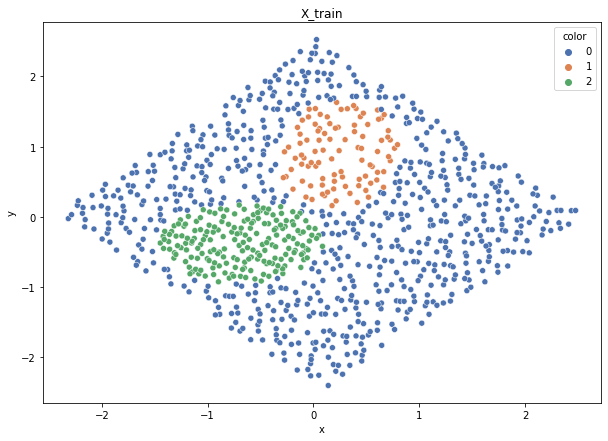

Class cardinalities: Counter({0: 672, 2: 192, 1: 96})
Weights: {1: 0.6086956521739131, 0: 0.08695652173913043, 2: 0.30434782608695654}


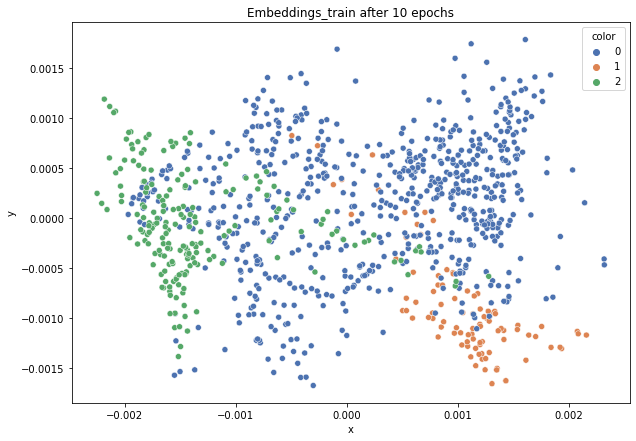

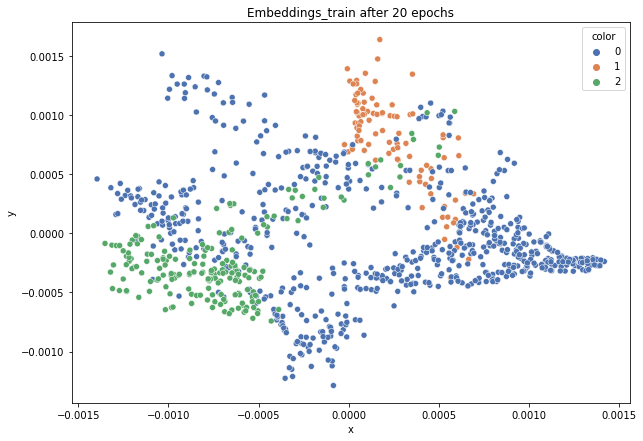

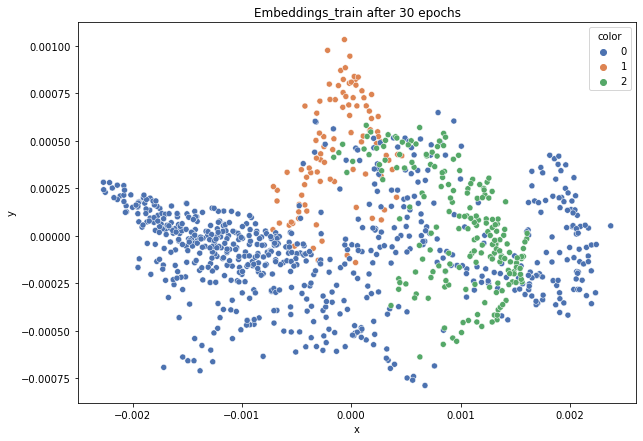

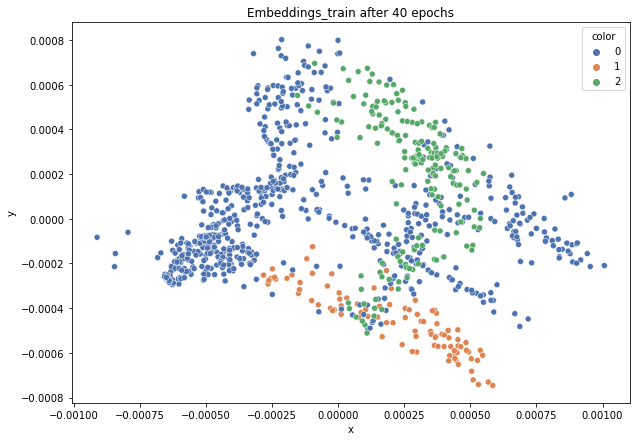

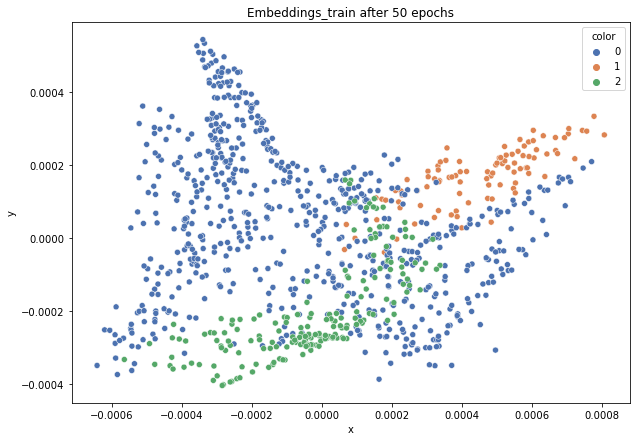

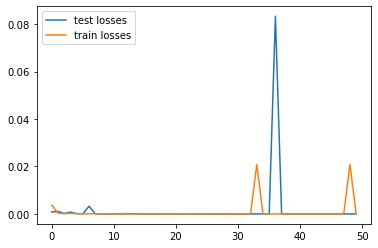

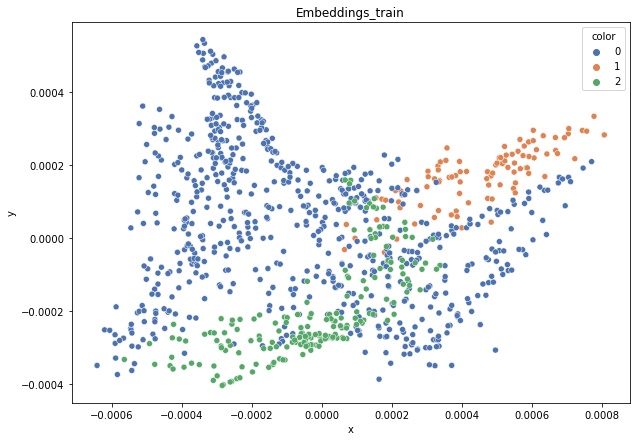

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/discriminant_analysis.py:715: UserWarning: Variables are collinear
  warnings.warn("Variables are collinear")
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/discriminant_analysis.py:715: UserWarning: Variables are collinear
  warnings.warn("Variables are collinear")


DT-f1-new-features: 0.921
DT-f1-old+new-features: 0.926
DT-f1-old-features: 0.932
DT-gmean-new-features: 0.936
DT-gmean-old+new-features: 0.949
DT-gmean-old-features: 0.959
KNN-f1-new-features: 0.931
KNN-f1-old+new-features: 0.931
KNN-f1-old-features: 0.931
KNN-gmean-new-features: 0.956
KNN-gmean-old+new-features: 0.957
KNN-gmean-old-features: 0.957
LDA-f1-new-features: 0.84
LDA-f1-old+new-features: 0.863
LDA-f1-old-features: 0.28
LDA-gmean-new-features: 0.87
LDA-gmean-old+new-features: 0.886
LDA-gmean-old-features: 0.034
QDA-f1-new-features: 0.931
QDA-f1-old+new-features: 0.945
QDA-f1-old-features: 0.864
QDA-gmean-new-features: 0.971
QDA-gmean-old+new-features: 0.98
QDA-gmean-old-features: 0.798
RF24-f1-new-features: 0.931
RF24-f1-old+new-features: 0.951
RF24-f1-old-features: 0.937
RF24-gmean-new-features: 0.944
RF24-gmean-old+new-features: 0.962
RF24-gmean-old-features: 0.963


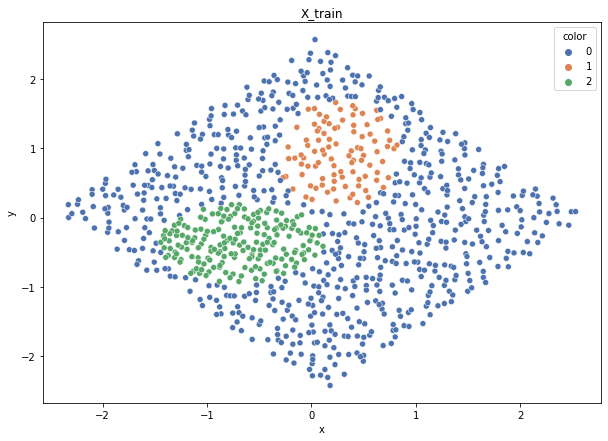

Class cardinalities: Counter({0: 672, 2: 192, 1: 96})
Weights: {1: 0.6086956521739131, 0: 0.08695652173913043, 2: 0.30434782608695654}


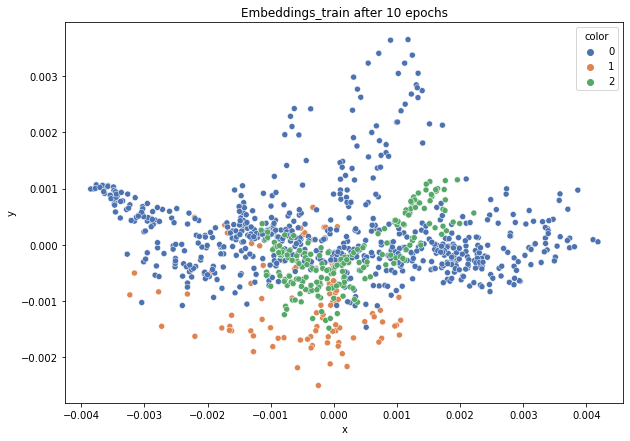

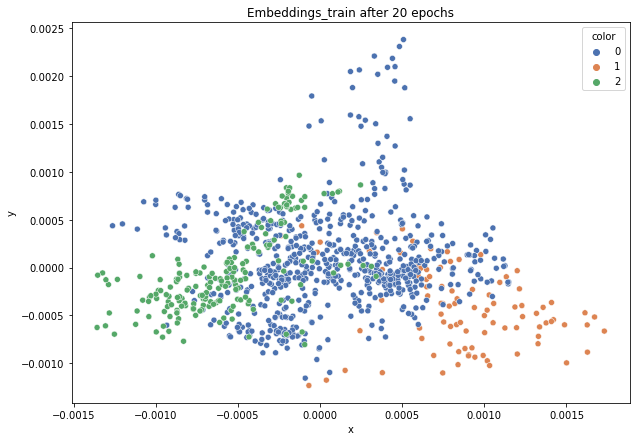

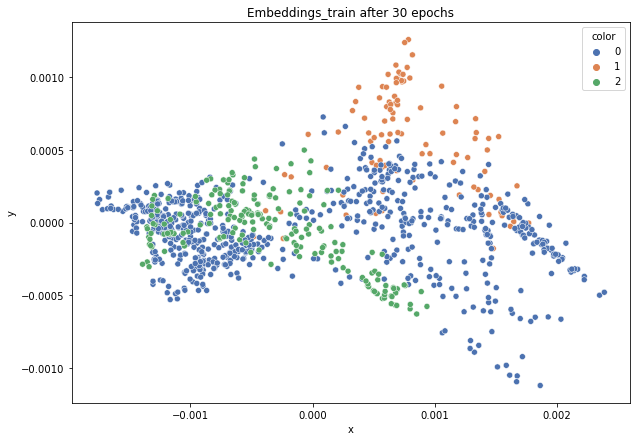

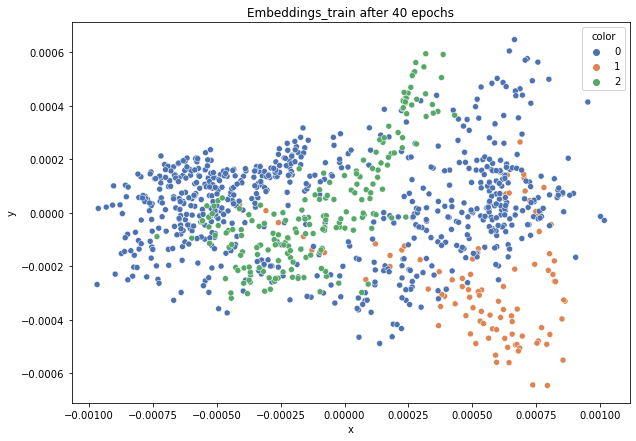

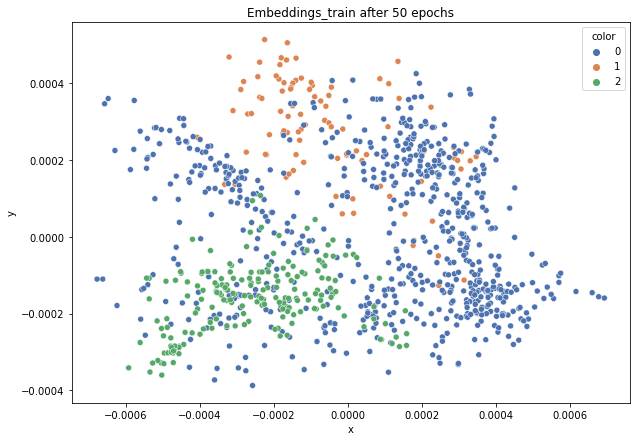

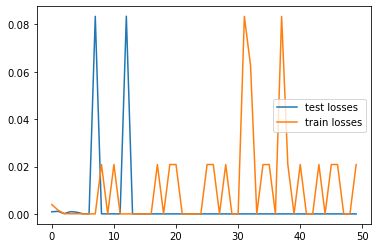

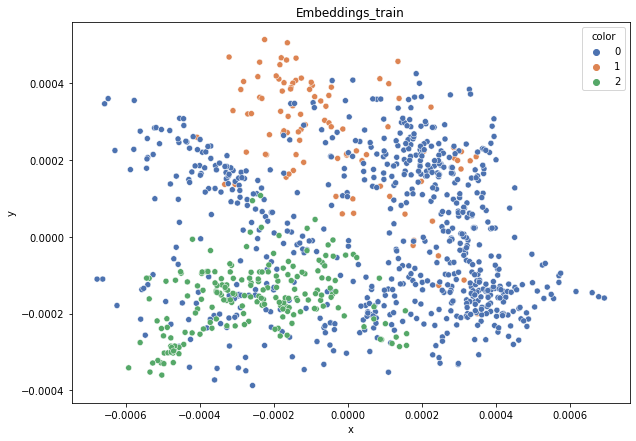

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/discriminant_analysis.py:715: UserWarning: Variables are collinear
  warnings.warn("Variables are collinear")
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/discriminant_analysis.py:715: UserWarning: Variables are collinear
  warnings.warn("Variables are collinear")


DT-f1-new-features: 0.883
DT-f1-old+new-features: 0.953
DT-f1-old-features: 0.973
DT-gmean-new-features: 0.88
DT-gmean-old+new-features: 0.95
DT-gmean-old-features: 0.973
KNN-f1-new-features: 0.934
KNN-f1-old+new-features: 0.958
KNN-f1-old-features: 0.958
KNN-gmean-new-features: 0.909
KNN-gmean-old+new-features: 0.955
KNN-gmean-old-features: 0.955
LDA-f1-new-features: 0.755
LDA-f1-old+new-features: 0.789
LDA-f1-old-features: 0.259
LDA-gmean-new-features: 0.722
LDA-gmean-old+new-features: 0.751
LDA-gmean-old-features: 0.01
QDA-f1-new-features: 0.861
QDA-f1-old+new-features: 0.947
QDA-f1-old-features: 0.728
QDA-gmean-new-features: 0.839
QDA-gmean-old+new-features: 0.92
QDA-gmean-old-features: 0.59
RF24-f1-new-features: 0.89
RF24-f1-old+new-features: 0.944
RF24-f1-old-features: 0.948
RF24-gmean-new-features: 0.864
RF24-gmean-old+new-features: 0.936
RF24-gmean-old-features: 0.936
2delikatne-cut


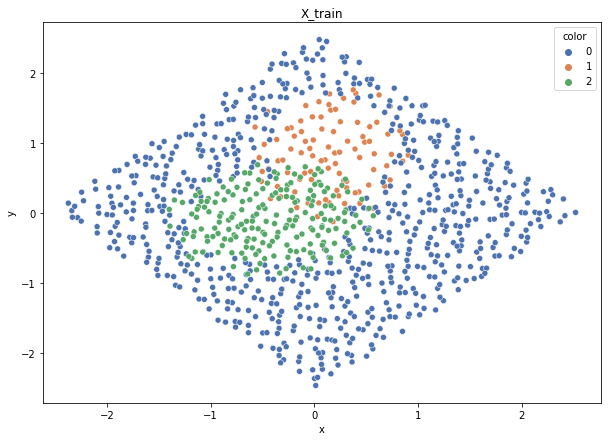

Class cardinalities: Counter({0: 672, 2: 192, 1: 96})
Weights: {1: 0.6086956521739131, 0: 0.08695652173913043, 2: 0.30434782608695654}


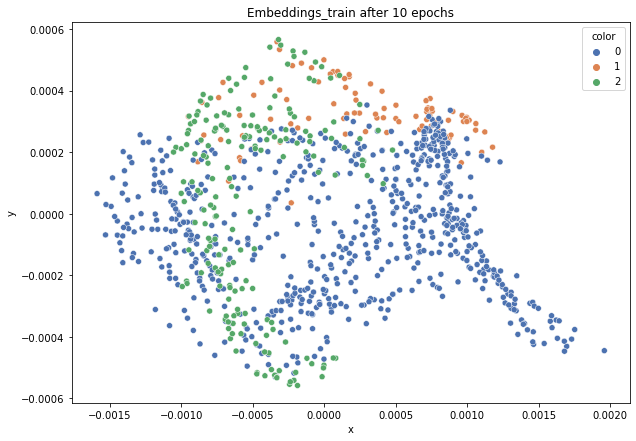

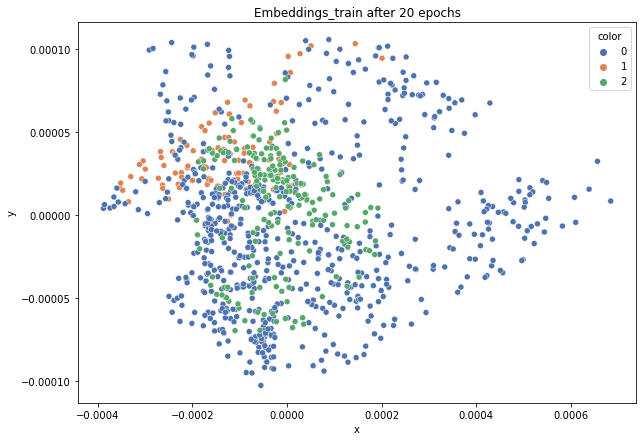

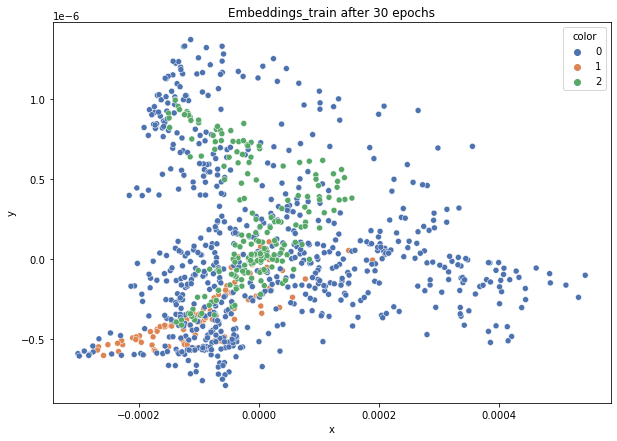

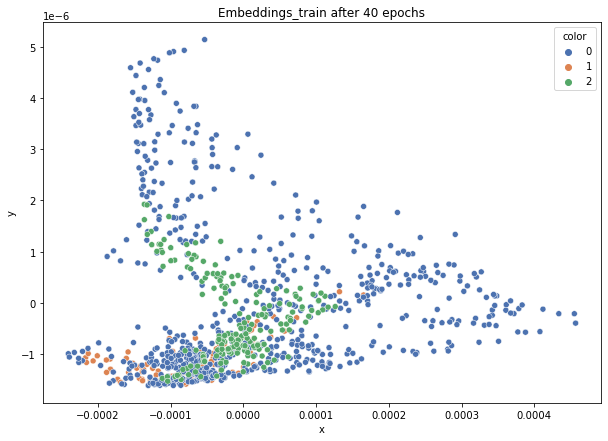

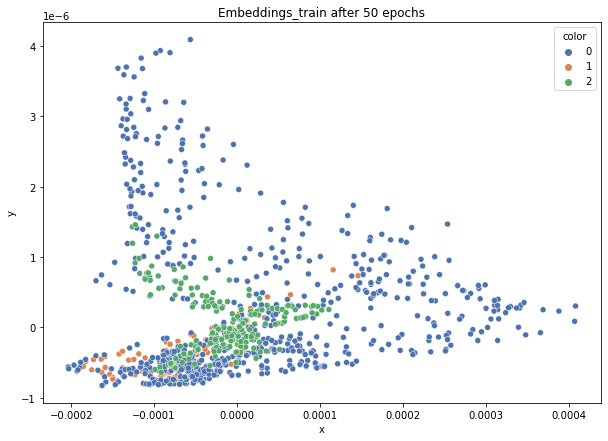

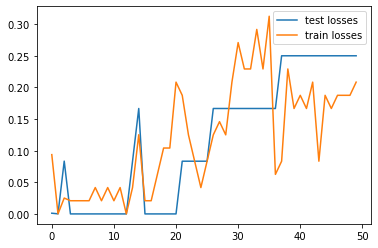

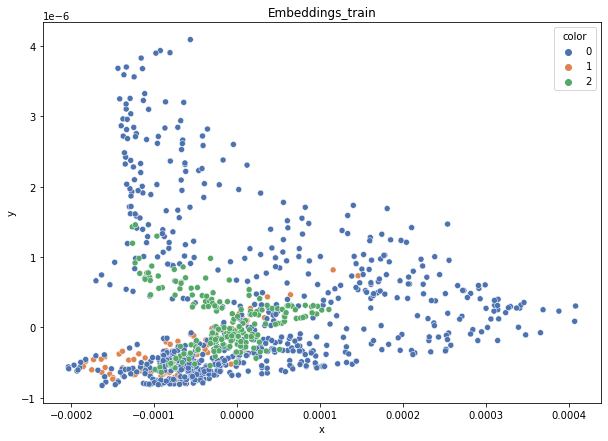

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/discriminant_analysis.py:715: UserWarning: Variables are collinear
  warnings.warn("Variables are collinear")


DT-f1-new-features: 0.532
DT-f1-old+new-features: 0.686
DT-f1-old-features: 0.69
DT-gmean-new-features: 0.557
DT-gmean-old+new-features: 0.677
DT-gmean-old-features: 0.674
KNN-f1-new-features: 0.567
KNN-f1-old+new-features: 0.693
KNN-f1-old-features: 0.693
KNN-gmean-new-features: 0.542
KNN-gmean-old+new-features: 0.674
KNN-gmean-old-features: 0.674
LDA-f1-new-features: 0.774
LDA-f1-old+new-features: 0.776
LDA-f1-old-features: 0.274
LDA-gmean-new-features: 0.802
LDA-gmean-old+new-features: 0.773
LDA-gmean-old-features: 0.01
QDA-f1-new-features: 0.723
QDA-f1-old+new-features: 0.742
QDA-f1-old-features: 0.615
QDA-gmean-new-features: 0.815
QDA-gmean-old+new-features: 0.826
QDA-gmean-old-features: 0.443
RF24-f1-new-features: 0.611
RF24-f1-old+new-features: 0.743
RF24-f1-old-features: 0.774
RF24-gmean-new-features: 0.603
RF24-gmean-old+new-features: 0.716
RF24-gmean-old-features: 0.76


/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/discriminant_analysis.py:715: UserWarning: Variables are collinear
  warnings.warn("Variables are collinear")


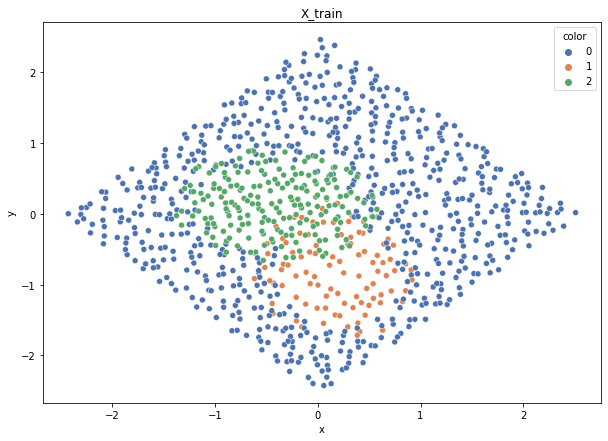

Class cardinalities: Counter({0: 672, 2: 192, 1: 96})
Weights: {1: 0.6086956521739131, 0: 0.08695652173913043, 2: 0.30434782608695654}


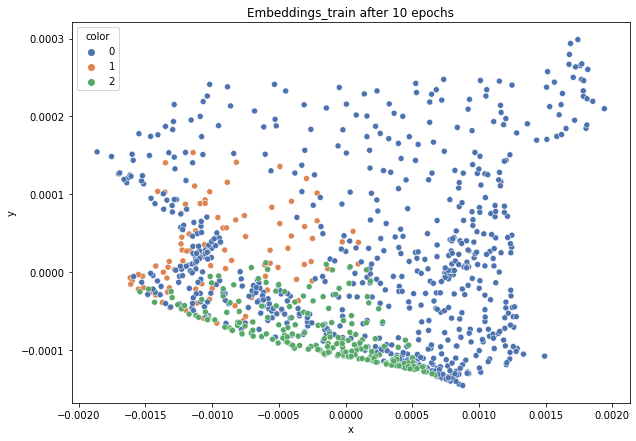

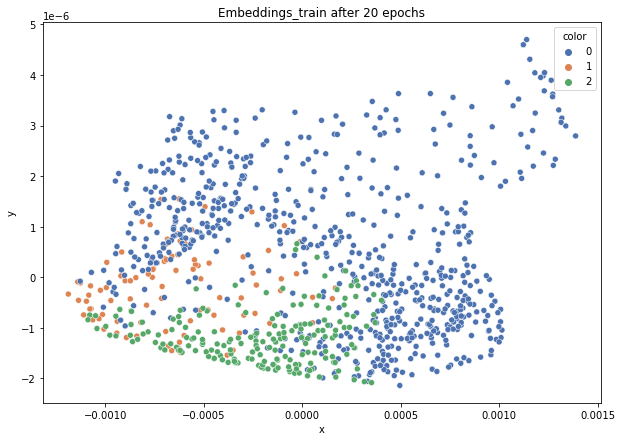

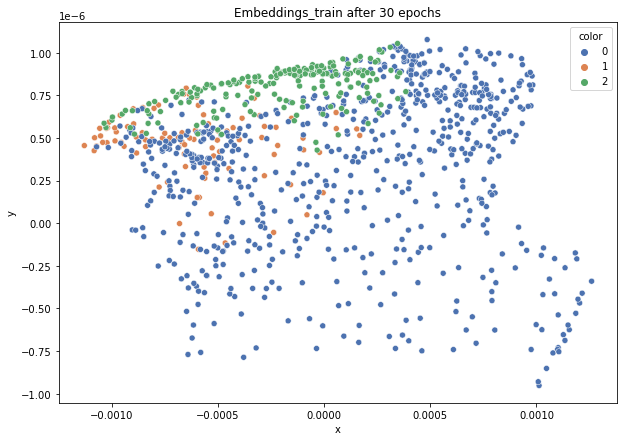

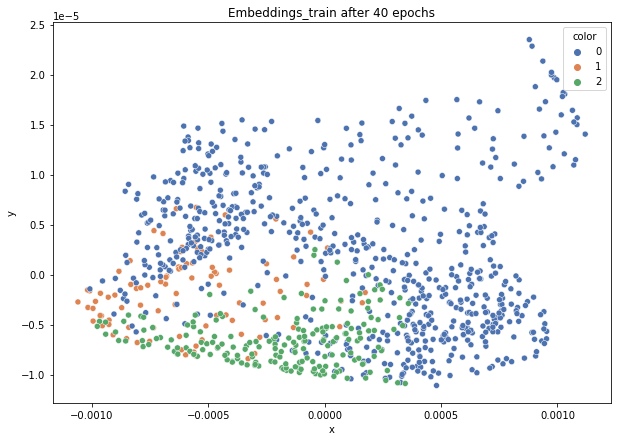

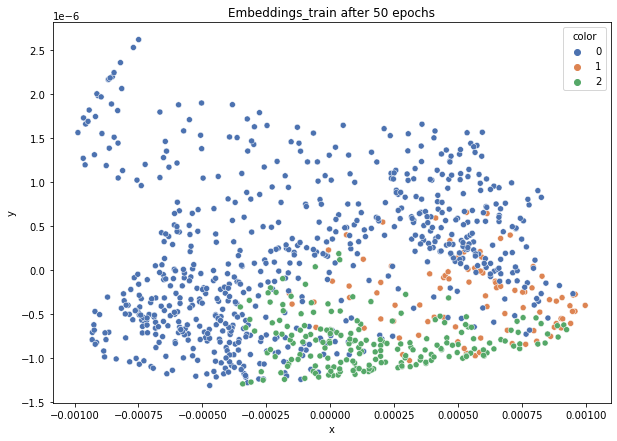

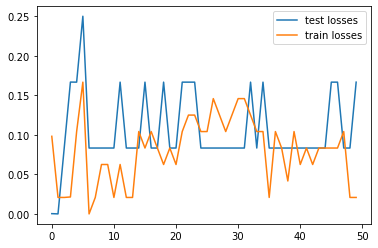

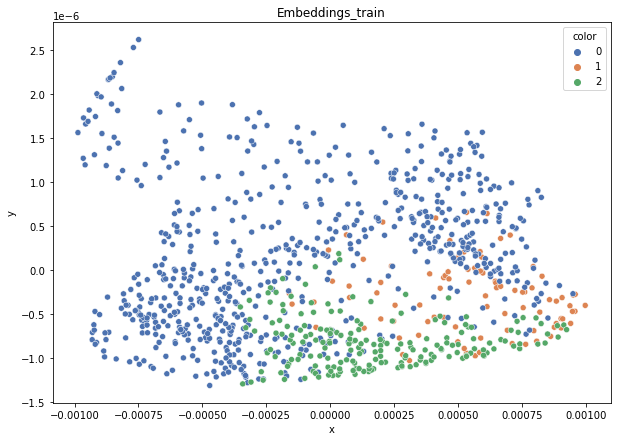

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/discriminant_analysis.py:715: UserWarning: Variables are collinear
  warnings.warn("Variables are collinear")


DT-f1-new-features: 0.498
DT-f1-old+new-features: 0.763
DT-f1-old-features: 0.763
DT-gmean-new-features: 0.428
DT-gmean-old+new-features: 0.778
DT-gmean-old-features: 0.787
KNN-f1-new-features: 0.477
KNN-f1-old+new-features: 0.742
KNN-f1-old-features: 0.742
KNN-gmean-new-features: 0.423
KNN-gmean-old+new-features: 0.727
KNN-gmean-old-features: 0.727
LDA-f1-new-features: 0.752
LDA-f1-old+new-features: 0.743
LDA-f1-old-features: 0.275
LDA-gmean-new-features: 0.791
LDA-gmean-old+new-features: 0.795
LDA-gmean-old-features: 0.01
QDA-f1-new-features: 0.744
QDA-f1-old+new-features: 0.751
QDA-f1-old-features: 0.646
QDA-gmean-new-features: 0.829
QDA-gmean-old+new-features: 0.831
QDA-gmean-old-features: 0.503
RF24-f1-new-features: 0.574
RF24-f1-old+new-features: 0.752
RF24-f1-old-features: 0.776
RF24-gmean-new-features: 0.55
RF24-gmean-old+new-features: 0.762
RF24-gmean-old-features: 0.776


/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/discriminant_analysis.py:715: UserWarning: Variables are collinear
  warnings.warn("Variables are collinear")


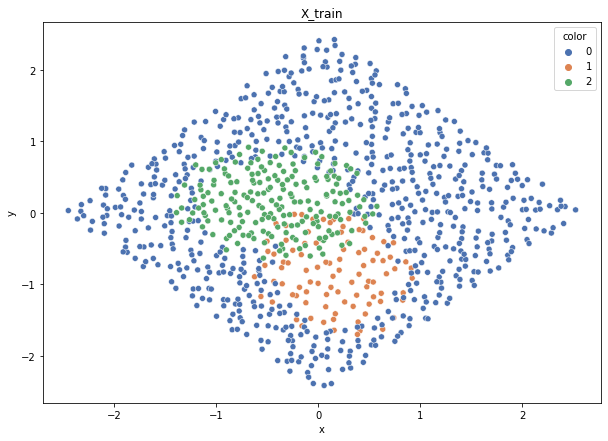

Class cardinalities: Counter({0: 672, 2: 192, 1: 96})
Weights: {1: 0.6086956521739131, 0: 0.08695652173913043, 2: 0.30434782608695654}


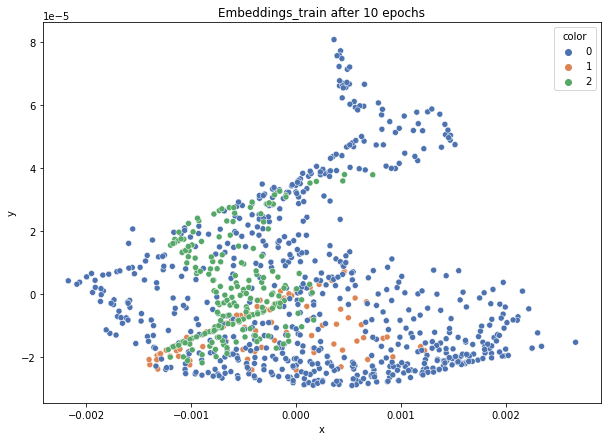

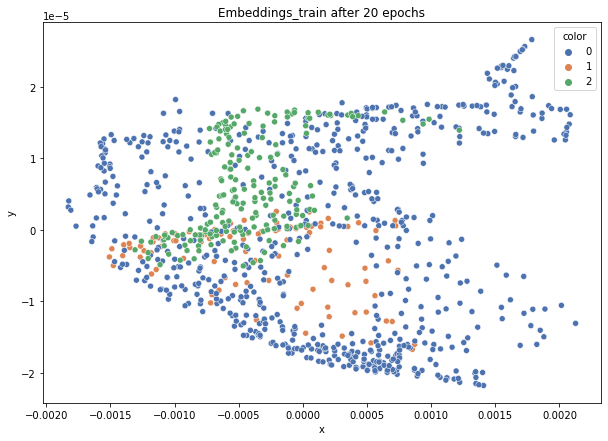

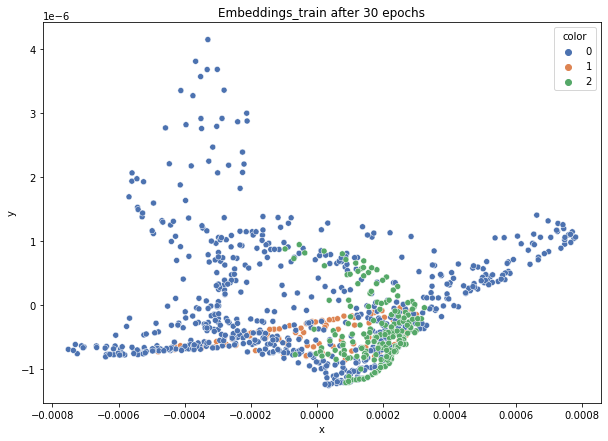

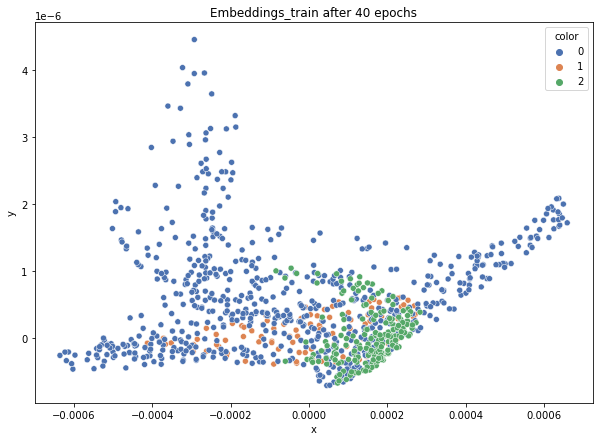

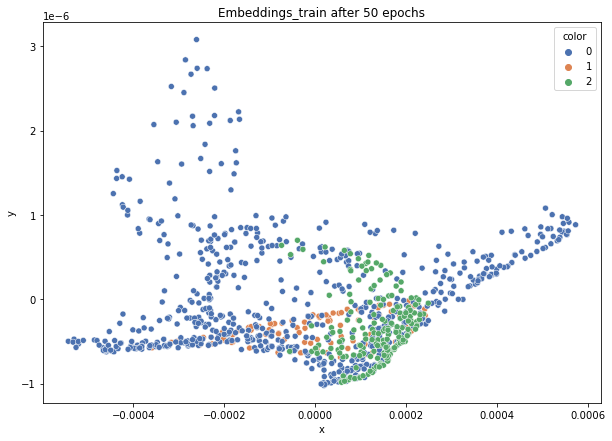

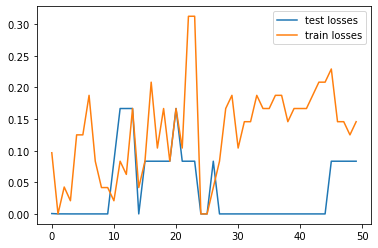

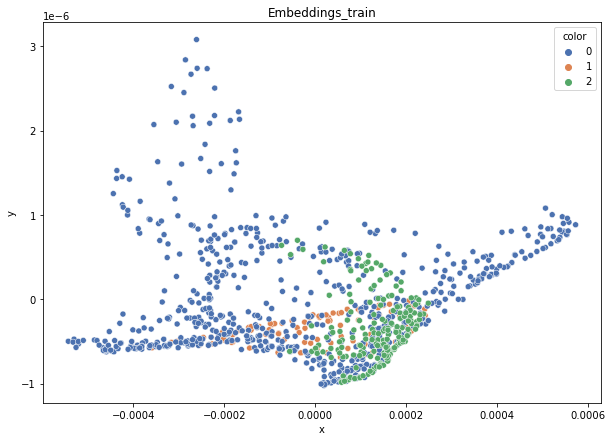

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/discriminant_analysis.py:715: UserWarning: Variables are collinear
  warnings.warn("Variables are collinear")


DT-f1-new-features: 0.537
DT-f1-old+new-features: 0.735
DT-f1-old-features: 0.712
DT-gmean-new-features: 0.544
DT-gmean-old+new-features: 0.741
DT-gmean-old-features: 0.727
KNN-f1-new-features: 0.518
KNN-f1-old+new-features: 0.666
KNN-f1-old-features: 0.666
KNN-gmean-new-features: 0.474
KNN-gmean-old+new-features: 0.636
KNN-gmean-old-features: 0.636
LDA-f1-new-features: 0.736
LDA-f1-old+new-features: 0.74
LDA-f1-old-features: 0.275
LDA-gmean-new-features: 0.727
LDA-gmean-old+new-features: 0.716
LDA-gmean-old-features: 0.01
QDA-f1-new-features: 0.752
QDA-f1-old+new-features: 0.749
QDA-f1-old-features: 0.657
QDA-gmean-new-features: 0.826
QDA-gmean-old+new-features: 0.821
QDA-gmean-old-features: 0.514
RF24-f1-new-features: 0.538
RF24-f1-old+new-features: 0.744
RF24-f1-old-features: 0.757
RF24-gmean-new-features: 0.526
RF24-gmean-old+new-features: 0.761
RF24-gmean-old-features: 0.754


/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/discriminant_analysis.py:715: UserWarning: Variables are collinear
  warnings.warn("Variables are collinear")


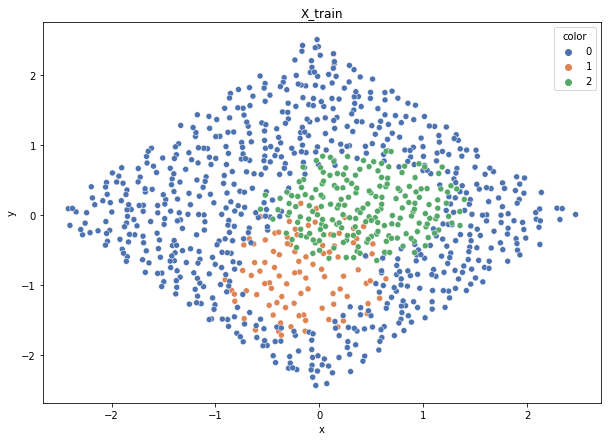

Class cardinalities: Counter({0: 672, 2: 192, 1: 96})
Weights: {1: 0.6086956521739131, 0: 0.08695652173913043, 2: 0.30434782608695654}


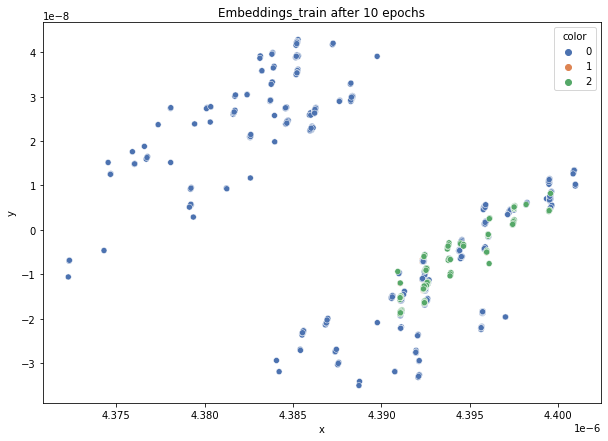

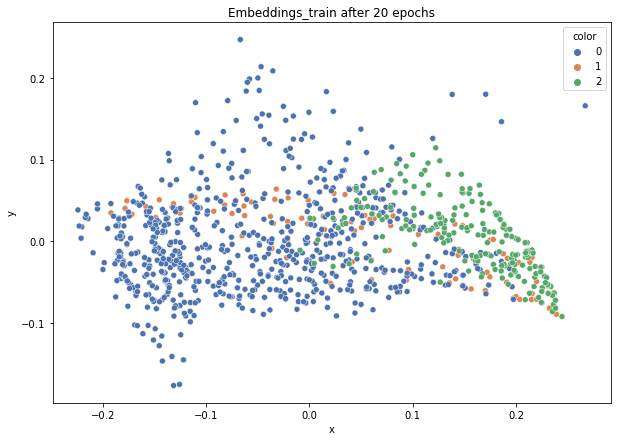

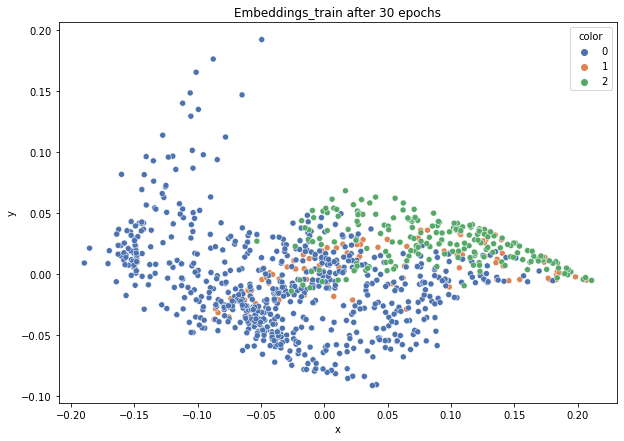

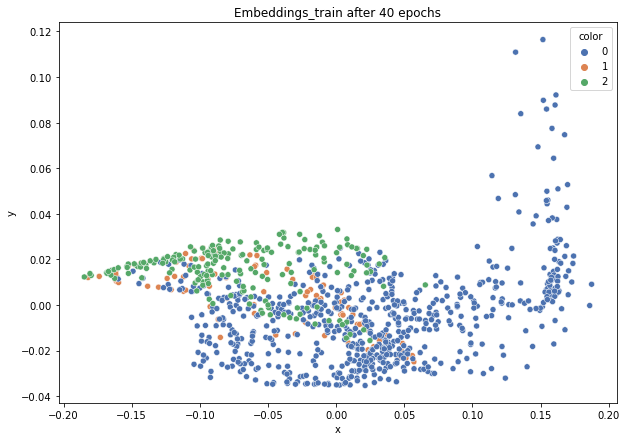

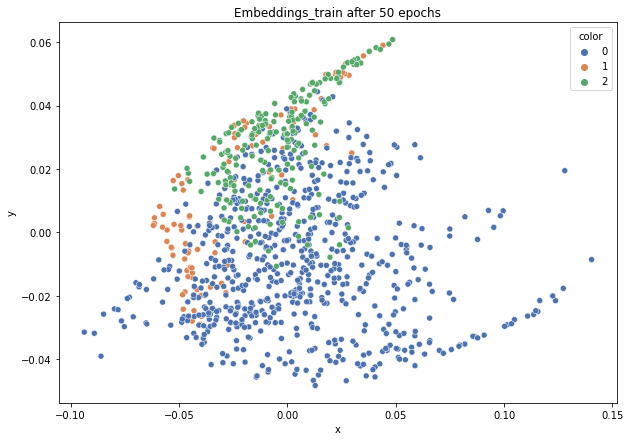

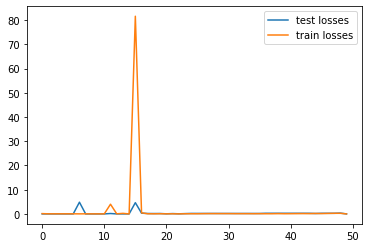

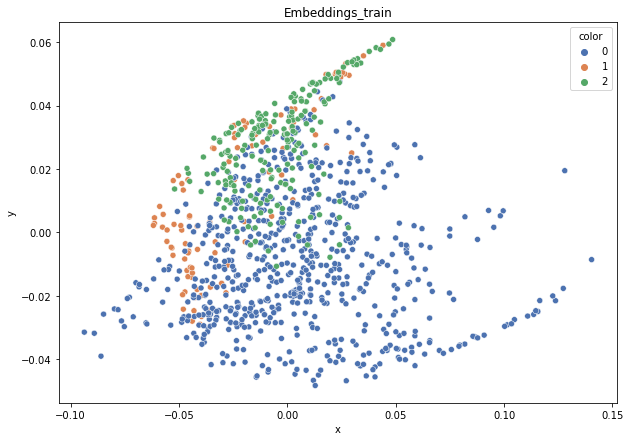

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/discriminant_analysis.py:715: UserWarning: Variables are collinear
  warnings.warn("Variables are collinear")
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/discriminant_analysis.py:715: UserWarning: Variables are collinear
  warnings.warn("Variables are collinear")


DT-f1-new-features: 0.716
DT-f1-old+new-features: 0.698
DT-f1-old-features: 0.712
DT-gmean-new-features: 0.732
DT-gmean-old+new-features: 0.701
DT-gmean-old-features: 0.724
KNN-f1-new-features: 0.684
KNN-f1-old+new-features: 0.73
KNN-f1-old-features: 0.73
KNN-gmean-new-features: 0.674
KNN-gmean-old+new-features: 0.735
KNN-gmean-old-features: 0.735
LDA-f1-new-features: 0.742
LDA-f1-old+new-features: 0.753
LDA-f1-old-features: 0.274
LDA-gmean-new-features: 0.739
LDA-gmean-old+new-features: 0.757
LDA-gmean-old-features: 0.01
QDA-f1-new-features: 0.736
QDA-f1-old+new-features: 0.726
QDA-f1-old-features: 0.668
QDA-gmean-new-features: 0.821
QDA-gmean-old+new-features: 0.81
QDA-gmean-old-features: 0.534
RF24-f1-new-features: 0.72
RF24-f1-old+new-features: 0.73
RF24-f1-old-features: 0.714
RF24-gmean-new-features: 0.726
RF24-gmean-old+new-features: 0.723
RF24-gmean-old-features: 0.712


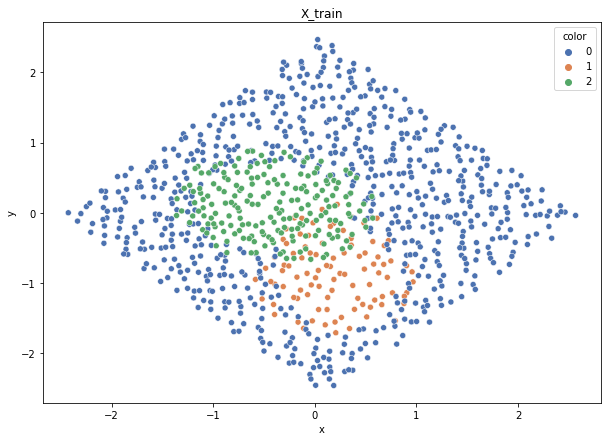

Class cardinalities: Counter({0: 672, 2: 192, 1: 96})
Weights: {1: 0.6086956521739131, 0: 0.08695652173913043, 2: 0.30434782608695654}


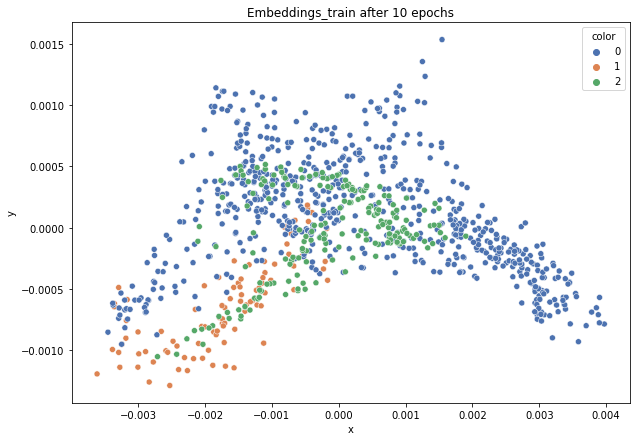

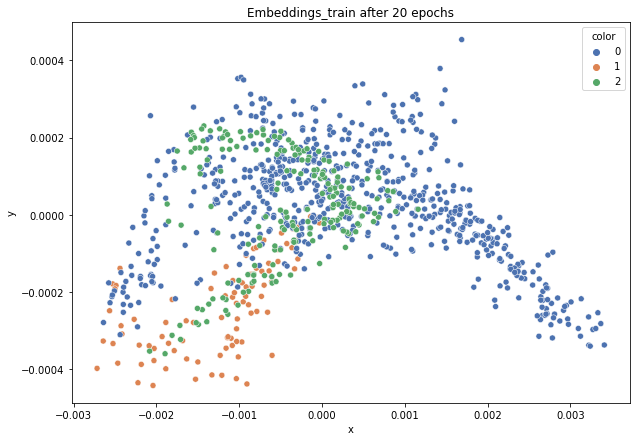

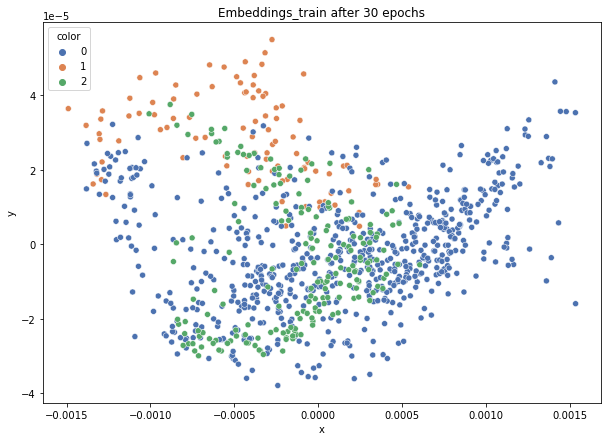

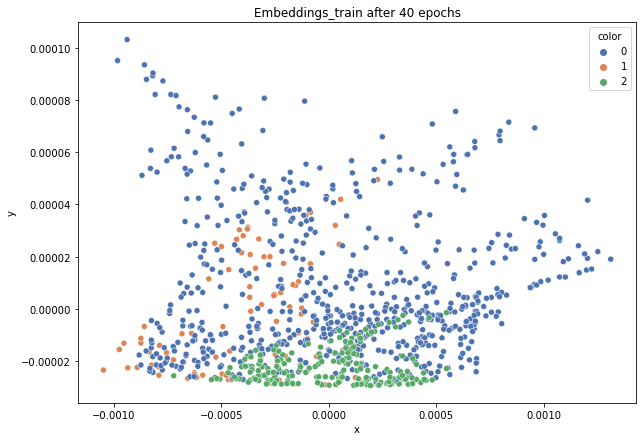

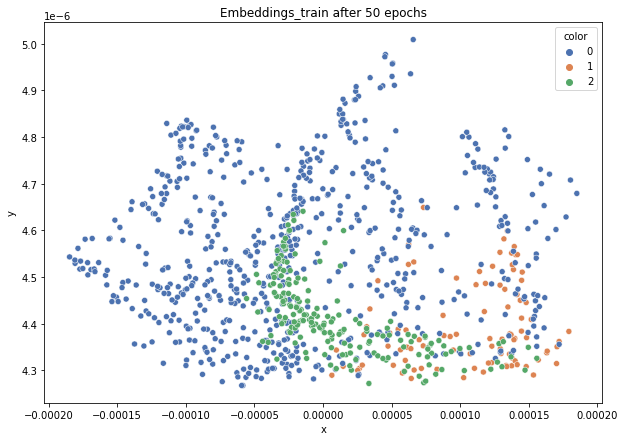

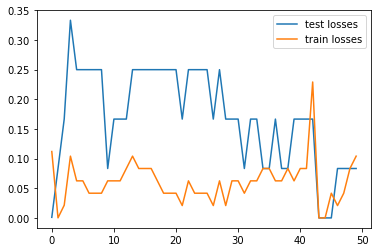

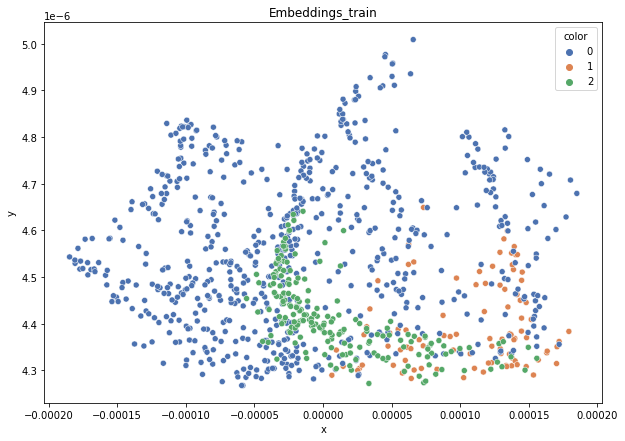

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/discriminant_analysis.py:715: UserWarning: Variables are collinear
  warnings.warn("Variables are collinear")


DT-f1-new-features: 0.589
DT-f1-old+new-features: 0.715
DT-f1-old-features: 0.744
DT-gmean-new-features: 0.641
DT-gmean-old+new-features: 0.732
DT-gmean-old-features: 0.774
KNN-f1-new-features: 0.569
KNN-f1-old+new-features: 0.669
KNN-f1-old-features: 0.669
KNN-gmean-new-features: 0.566
KNN-gmean-old+new-features: 0.62
KNN-gmean-old-features: 0.62
LDA-f1-new-features: 0.773
LDA-f1-old+new-features: 0.771
LDA-f1-old-features: 0.273
LDA-gmean-new-features: 0.787
LDA-gmean-old+new-features: 0.773
LDA-gmean-old-features: 0.01
QDA-f1-new-features: 0.735
QDA-f1-old+new-features: 0.766
QDA-f1-old-features: 0.709
QDA-gmean-new-features: 0.818
QDA-gmean-old+new-features: 0.848
QDA-gmean-old-features: 0.579
RF24-f1-new-features: 0.643
RF24-f1-old+new-features: 0.73
RF24-f1-old-features: 0.785
RF24-gmean-new-features: 0.724
RF24-gmean-old+new-features: 0.736
RF24-gmean-old-features: 0.783
3mocniej-cut


/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/discriminant_analysis.py:715: UserWarning: Variables are collinear
  warnings.warn("Variables are collinear")


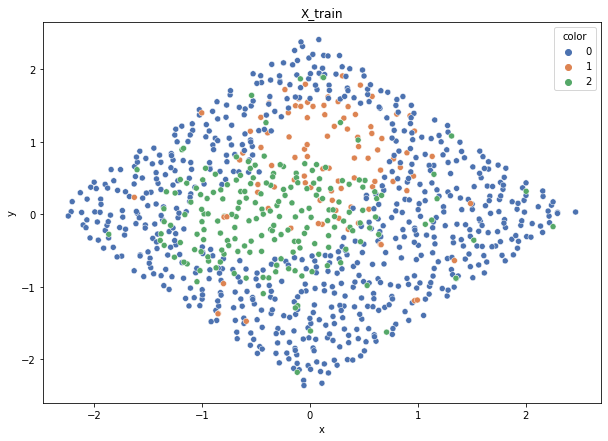

Class cardinalities: Counter({0: 672, 2: 192, 1: 96})
Weights: {1: 0.6086956521739131, 0: 0.08695652173913043, 2: 0.30434782608695654}


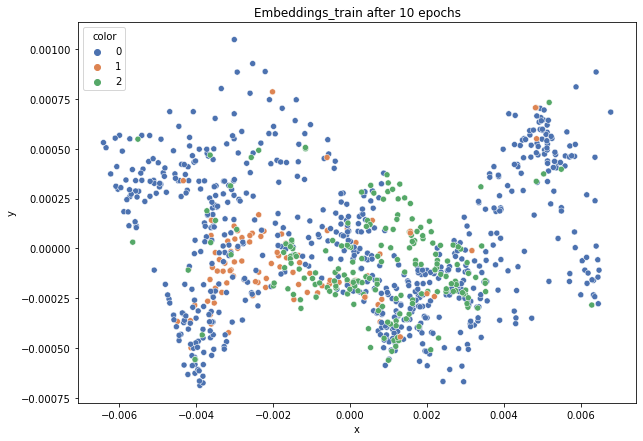

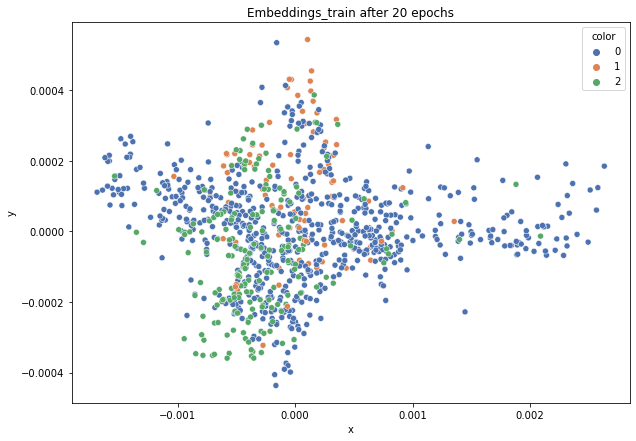

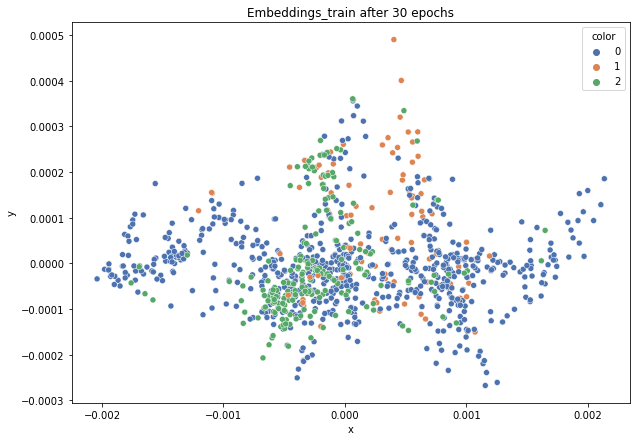

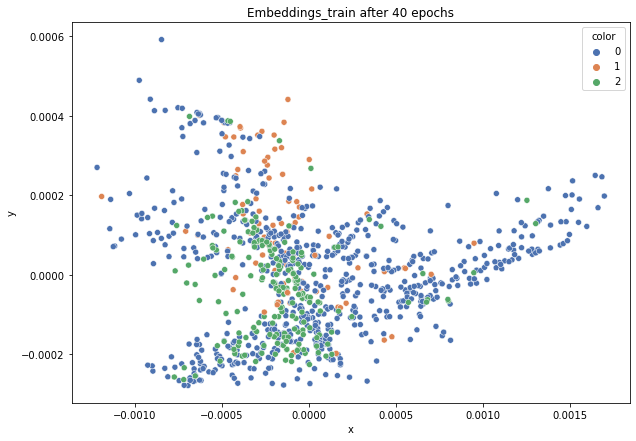

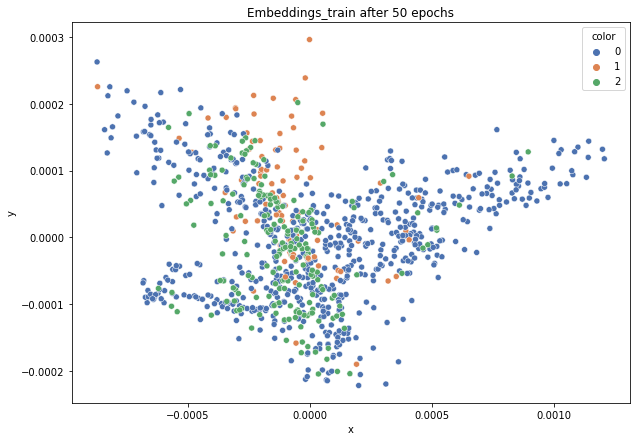

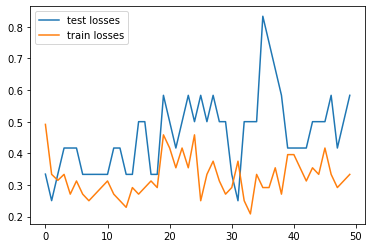

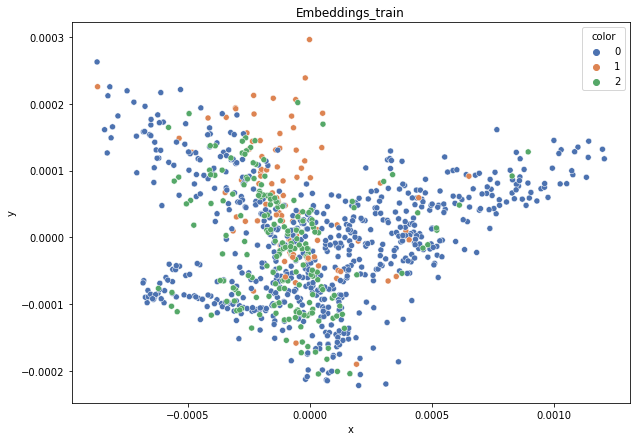

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/discriminant_analysis.py:715: UserWarning: Variables are collinear
  warnings.warn("Variables are collinear")
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/discriminant_analysis.py:715: UserWarning: Variables are collinear
  warnings.warn("Variables are collinear")


DT-f1-new-features: 0.449
DT-f1-old+new-features: 0.495
DT-f1-old-features: 0.522
DT-gmean-new-features: 0.455
DT-gmean-old+new-features: 0.468
DT-gmean-old-features: 0.524
KNN-f1-new-features: 0.457
KNN-f1-old+new-features: 0.537
KNN-f1-old-features: 0.537
KNN-gmean-new-features: 0.427
KNN-gmean-old+new-features: 0.502
KNN-gmean-old-features: 0.502
LDA-f1-new-features: 0.52
LDA-f1-old+new-features: 0.535
LDA-f1-old-features: 0.275
LDA-gmean-new-features: 0.426
LDA-gmean-old+new-features: 0.431
LDA-gmean-old-features: 0.01
QDA-f1-new-features: 0.513
QDA-f1-old+new-features: 0.531
QDA-f1-old-features: 0.275
QDA-gmean-new-features: 0.556
QDA-gmean-old+new-features: 0.602
QDA-gmean-old-features: 0.01
RF24-f1-new-features: 0.532
RF24-f1-old+new-features: 0.565
RF24-f1-old-features: 0.545
RF24-gmean-new-features: 0.467
RF24-gmean-old+new-features: 0.5
RF24-gmean-old-features: 0.493


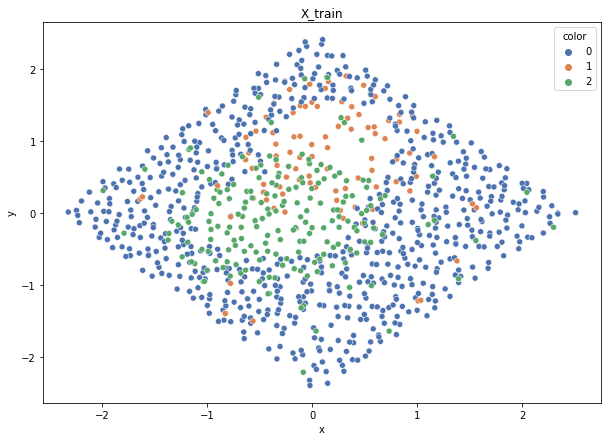

Class cardinalities: Counter({0: 672, 2: 192, 1: 96})
Weights: {1: 0.6086956521739131, 0: 0.08695652173913043, 2: 0.30434782608695654}


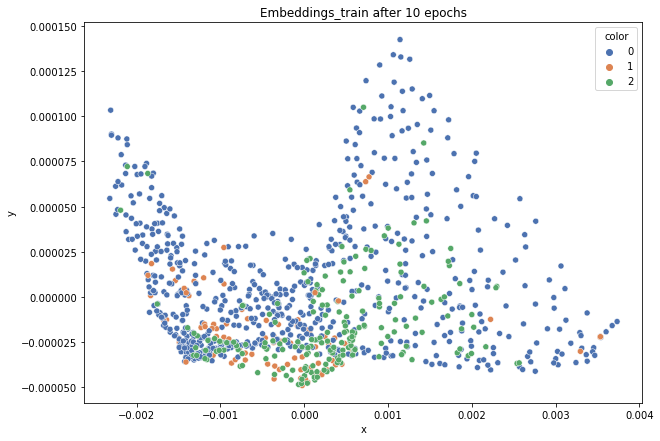

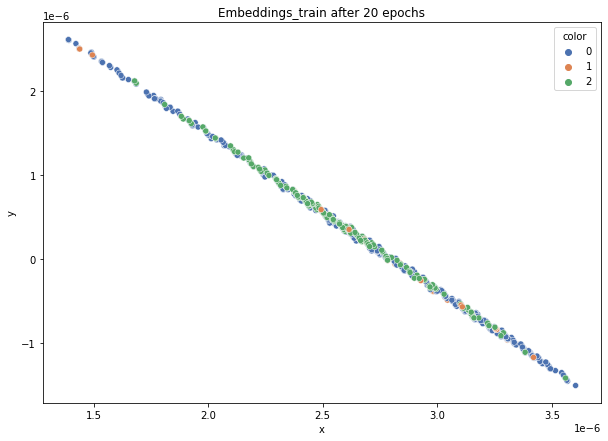

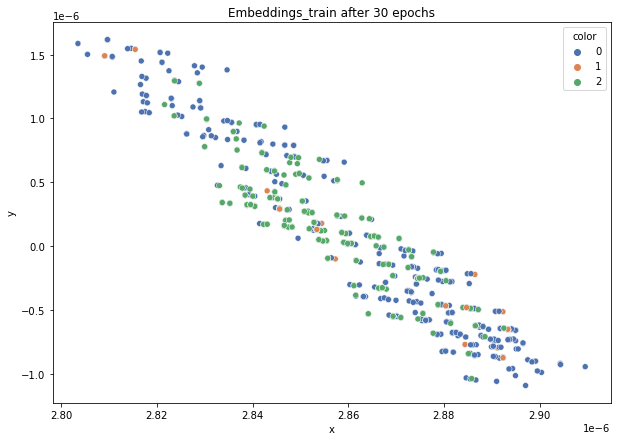

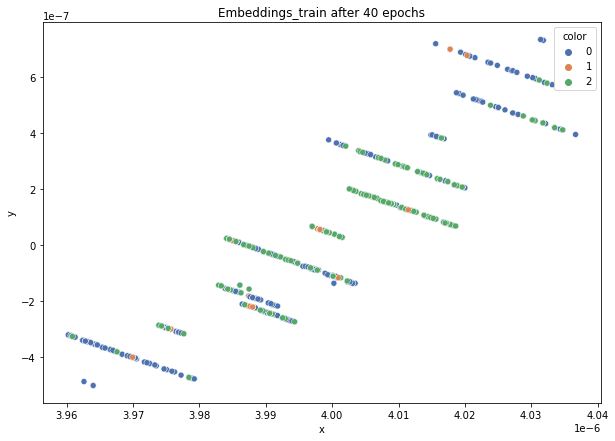

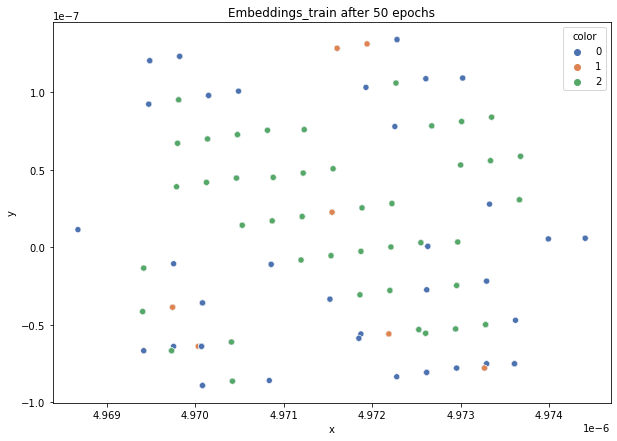

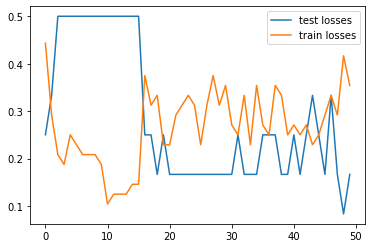

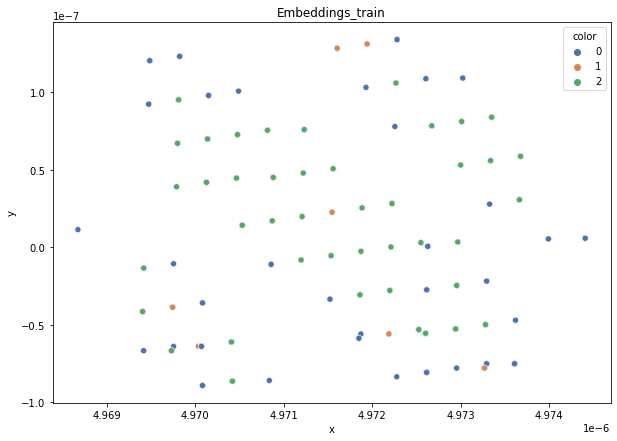

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/discriminant_analysis.py:715: UserWarning: Variables are collinear
  warnings.warn("Variables are collinear")
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/discriminant_analysis.py:715: UserWarning: Variables are collinear
  warnings.warn("Variables are collinear")
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/discriminant_analysis.py:740: RuntimeWarning: divide by zero encountered in power
  X2 = np.dot(Xm, R * (S ** (-0.5)))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/discriminant_analysis.py:740: RuntimeWarning: invalid value encountered in multiply
  X2 = np.dot(Xm, R * (S ** (-0.5)))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/discriminant_analysis.py:743: RuntimeWarning: divide by zero encountered in log
  u = np.asarray([np.sum(np.log(s)) for s in self.scalings_])


DT-f1-new-features: 0.275
DT-f1-old+new-features: 0.556
DT-f1-old-features: 0.531
DT-gmean-new-features: 0.01
DT-gmean-old+new-features: 0.581
DT-gmean-old-features: 0.547
KNN-f1-new-features: 0.325
KNN-f1-old+new-features: 0.536
KNN-f1-old-features: 0.536
KNN-gmean-new-features: 0.235
KNN-gmean-old+new-features: 0.479
KNN-gmean-old-features: 0.479
LDA-f1-new-features: 0.275
LDA-f1-old+new-features: 0.272
LDA-f1-old-features: 0.275
LDA-gmean-new-features: 0.01
LDA-gmean-old+new-features: 0.01
LDA-gmean-old-features: 0.01
QDA-f1-new-features: 0.275
QDA-f1-old+new-features: 0.327
QDA-f1-old-features: 0.275
QDA-gmean-new-features: 0.01
QDA-gmean-old+new-features: 0.37
QDA-gmean-old-features: 0.01
RF24-f1-new-features: 0.111
RF24-f1-old+new-features: 0.634
RF24-f1-old-features: 0.581
RF24-gmean-new-features: 0.01
RF24-gmean-old+new-features: 0.631
RF24-gmean-old-features: 0.551


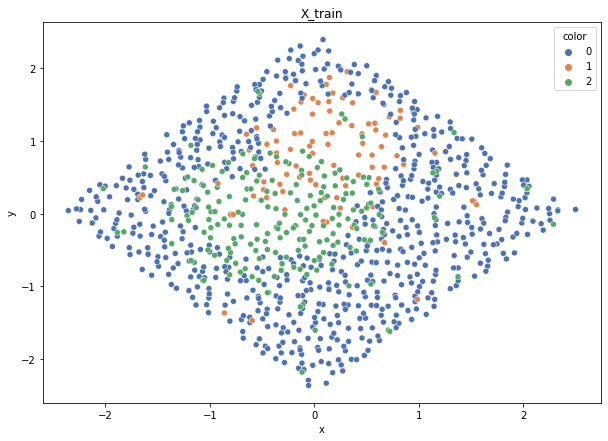

Class cardinalities: Counter({0: 672, 2: 192, 1: 96})
Weights: {1: 0.6086956521739131, 0: 0.08695652173913043, 2: 0.30434782608695654}


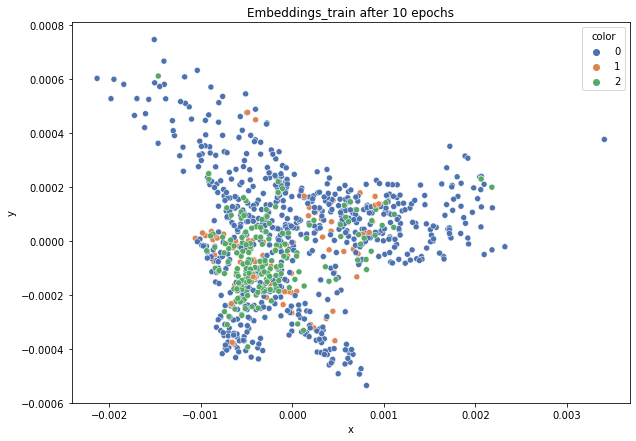

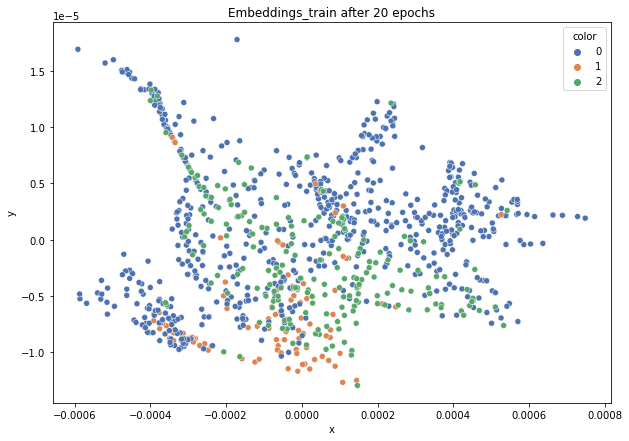

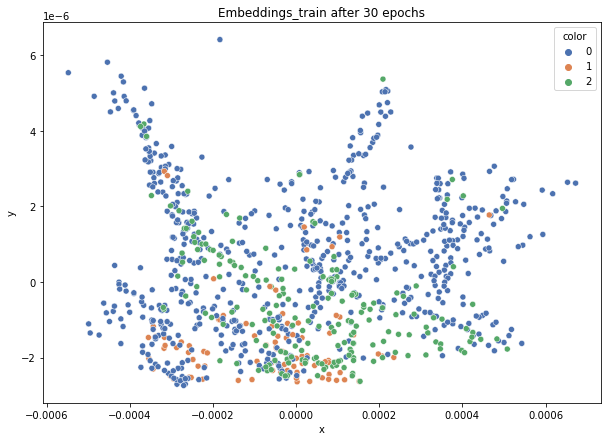

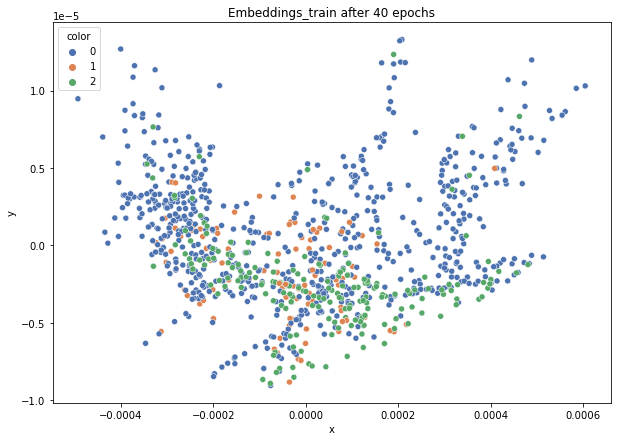

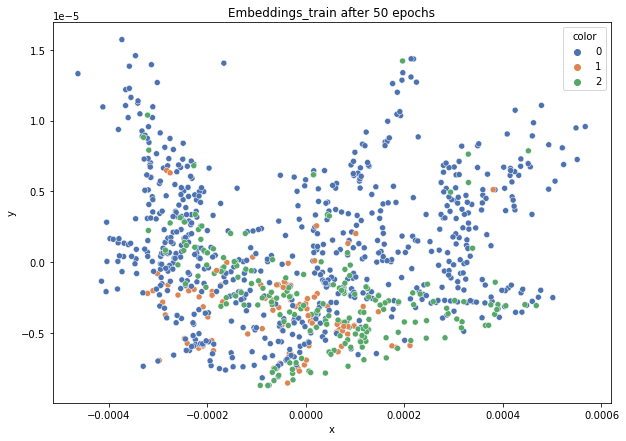

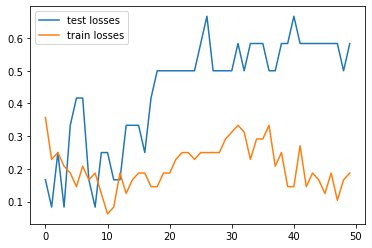

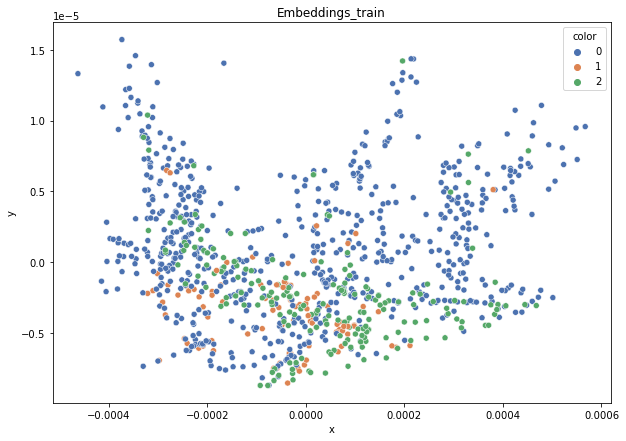

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/discriminant_analysis.py:715: UserWarning: Variables are collinear
  warnings.warn("Variables are collinear")


DT-f1-new-features: 0.452
DT-f1-old+new-features: 0.471
DT-f1-old-features: 0.442
DT-gmean-new-features: 0.435
DT-gmean-old+new-features: 0.463
DT-gmean-old-features: 0.43
KNN-f1-new-features: 0.483
KNN-f1-old+new-features: 0.438
KNN-f1-old-features: 0.438
KNN-gmean-new-features: 0.411
KNN-gmean-old+new-features: 0.373
KNN-gmean-old-features: 0.373
LDA-f1-new-features: 0.579
LDA-f1-old+new-features: 0.566
LDA-f1-old-features: 0.275
LDA-gmean-new-features: 0.507
LDA-gmean-old+new-features: 0.481
LDA-gmean-old-features: 0.01
QDA-f1-new-features: 0.522
QDA-f1-old+new-features: 0.565
QDA-f1-old-features: 0.275
QDA-gmean-new-features: 0.593
QDA-gmean-old+new-features: 0.613
QDA-gmean-old-features: 0.01
RF24-f1-new-features: 0.502
RF24-f1-old+new-features: 0.497
RF24-f1-old-features: 0.481
RF24-gmean-new-features: 0.41
RF24-gmean-old+new-features: 0.408
RF24-gmean-old-features: 0.396


/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/discriminant_analysis.py:715: UserWarning: Variables are collinear
  warnings.warn("Variables are collinear")


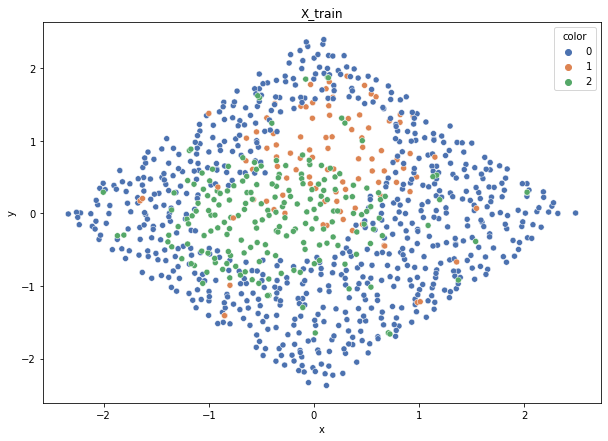

Class cardinalities: Counter({0: 672, 2: 192, 1: 96})
Weights: {1: 0.6086956521739131, 0: 0.08695652173913043, 2: 0.30434782608695654}


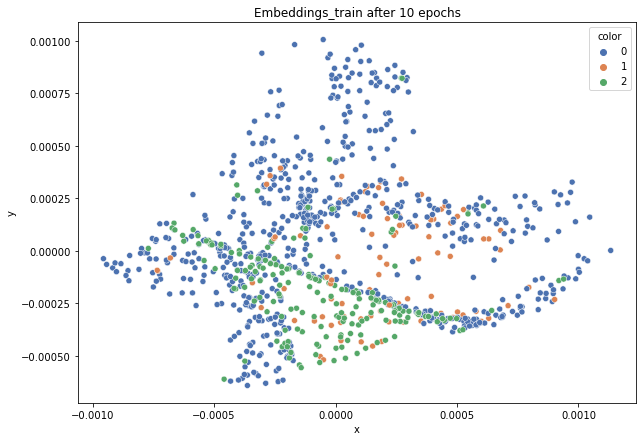

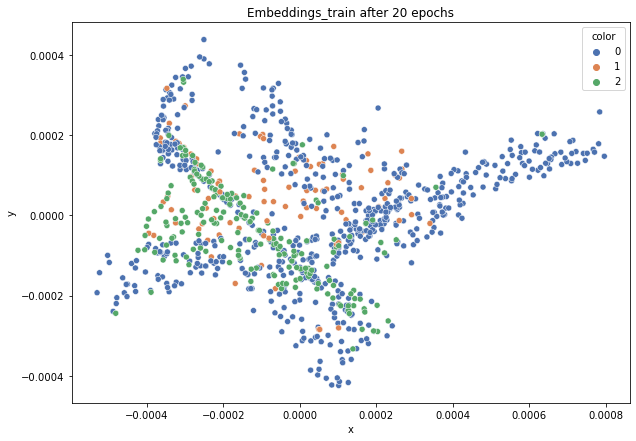

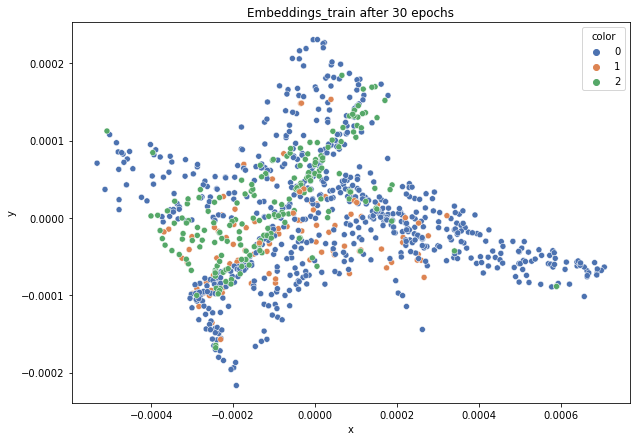

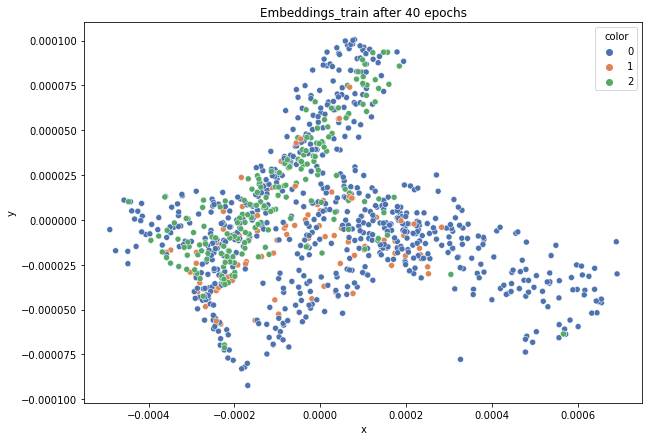

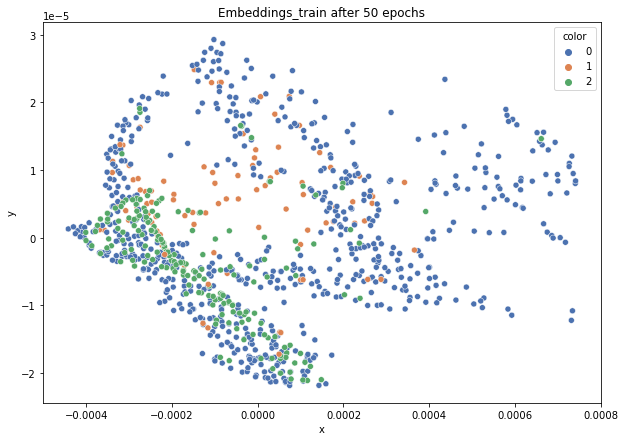

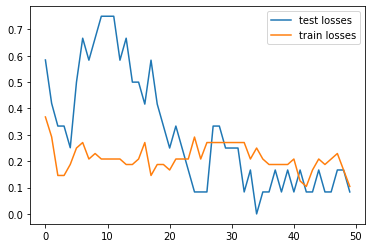

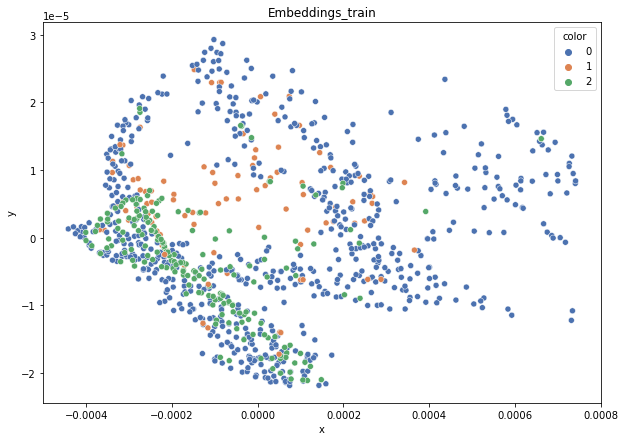

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/discriminant_analysis.py:715: UserWarning: Variables are collinear
  warnings.warn("Variables are collinear")


DT-f1-new-features: 0.44
DT-f1-old+new-features: 0.492
DT-f1-old-features: 0.477
DT-gmean-new-features: 0.381
DT-gmean-old+new-features: 0.485
DT-gmean-old-features: 0.473
KNN-f1-new-features: 0.524
KNN-f1-old+new-features: 0.51
KNN-f1-old-features: 0.51
KNN-gmean-new-features: 0.409
KNN-gmean-old+new-features: 0.464
KNN-gmean-old-features: 0.464
LDA-f1-new-features: 0.673
LDA-f1-old+new-features: 0.663
LDA-f1-old-features: 0.275
LDA-gmean-new-features: 0.632
LDA-gmean-old+new-features: 0.613
LDA-gmean-old-features: 0.01
QDA-f1-new-features: 0.574
QDA-f1-old+new-features: 0.548
QDA-f1-old-features: 0.275
QDA-gmean-new-features: 0.66
QDA-gmean-old+new-features: 0.635
QDA-gmean-old-features: 0.01
RF24-f1-new-features: 0.516
RF24-f1-old+new-features: 0.6
RF24-f1-old-features: 0.585
RF24-gmean-new-features: 0.358
RF24-gmean-old+new-features: 0.574
RF24-gmean-old-features: 0.584


/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/discriminant_analysis.py:715: UserWarning: Variables are collinear
  warnings.warn("Variables are collinear")


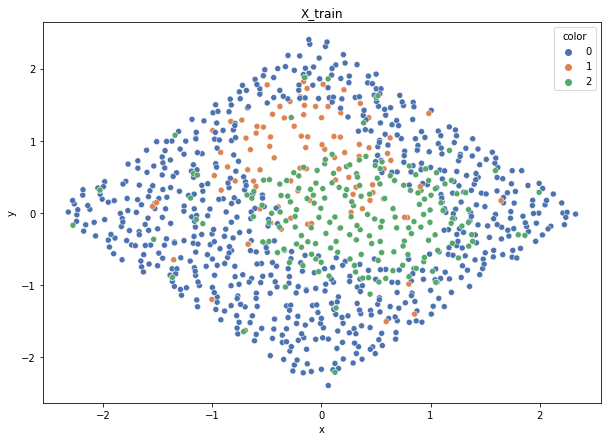

Class cardinalities: Counter({0: 672, 2: 192, 1: 96})
Weights: {1: 0.6086956521739131, 0: 0.08695652173913043, 2: 0.30434782608695654}


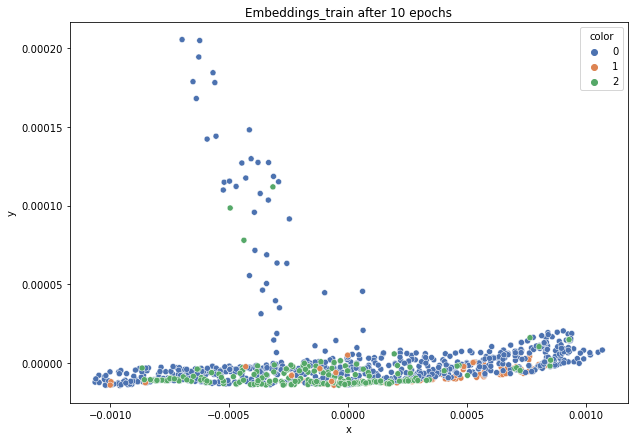

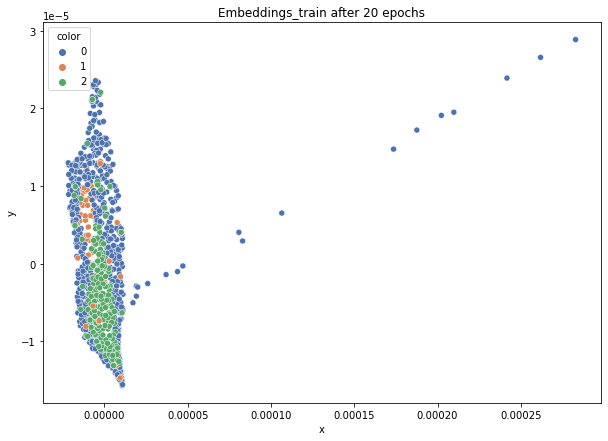

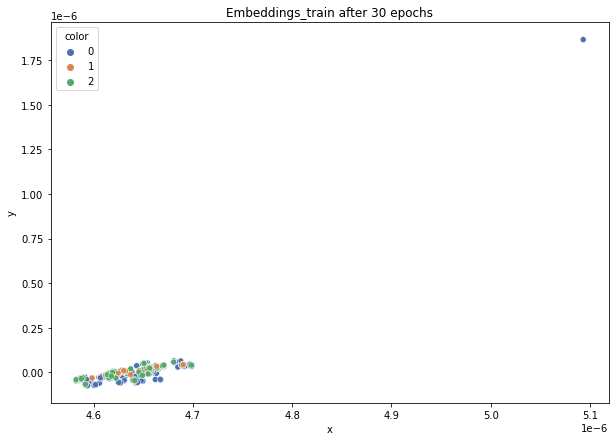

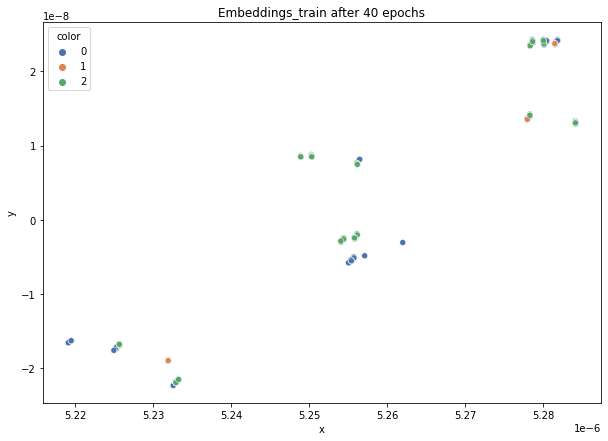

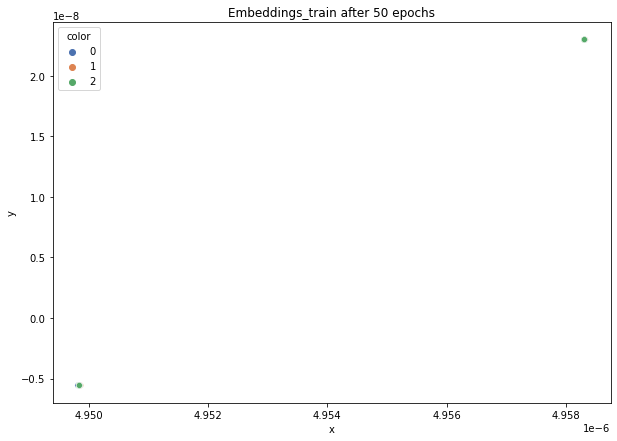

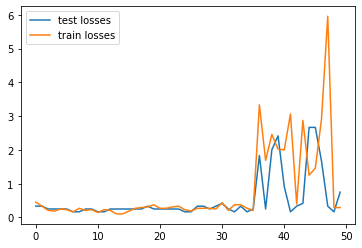

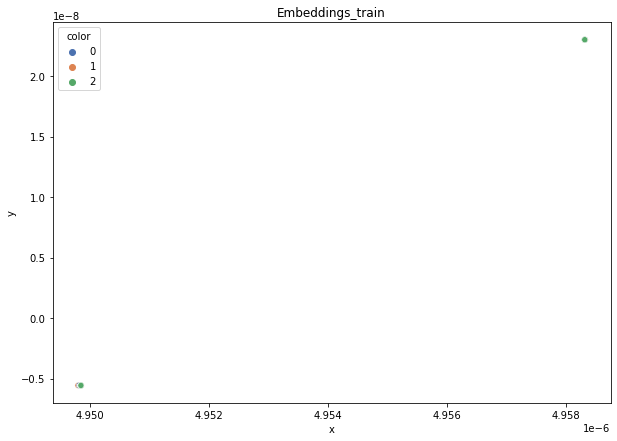

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/discriminant_analysis.py:715: UserWarning: Variables are collinear
  warnings.warn("Variables are collinear")
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/discriminant_analysis.py:740: RuntimeWarning: divide by zero encountered in power
  X2 = np.dot(Xm, R * (S ** (-0.5)))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/discriminant_analysis.py:740: RuntimeWarning: invalid value encountered in multiply
  X2 = np.dot(Xm, R * (S ** (-0.5)))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/discriminant_analysis.py:743: RuntimeWarning: divide by zero encountered in log
  u = np.asarray([np.sum(np.log(s)) for s in self.scalings_])
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/discriminant_analysis.py:715: UserWarning: Variables are collinear
  warnings.warn("Variables are collinear")
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-package

DT-f1-new-features: 0.275
DT-f1-old+new-features: 0.546
DT-f1-old-features: 0.552
DT-gmean-new-features: 0.01
DT-gmean-old+new-features: 0.515
DT-gmean-old-features: 0.536
KNN-f1-new-features: 0.275
KNN-f1-old+new-features: 0.522
KNN-f1-old-features: 0.522
KNN-gmean-new-features: 0.01
KNN-gmean-old+new-features: 0.471
KNN-gmean-old-features: 0.471
LDA-f1-new-features: 0.275
LDA-f1-old+new-features: 0.275
LDA-f1-old-features: 0.275
LDA-gmean-new-features: 0.01
LDA-gmean-old+new-features: 0.01
LDA-gmean-old-features: 0.01
QDA-f1-new-features: 0.275
QDA-f1-old+new-features: 0.275
QDA-f1-old-features: 0.275
QDA-gmean-new-features: 0.01
QDA-gmean-old+new-features: 0.01
QDA-gmean-old-features: 0.01
RF24-f1-new-features: 0.111
RF24-f1-old+new-features: 0.593
RF24-f1-old-features: 0.612
RF24-gmean-new-features: 0.01
RF24-gmean-old+new-features: 0.525
RF24-gmean-old-features: 0.574
4delikatne-bezover-cut


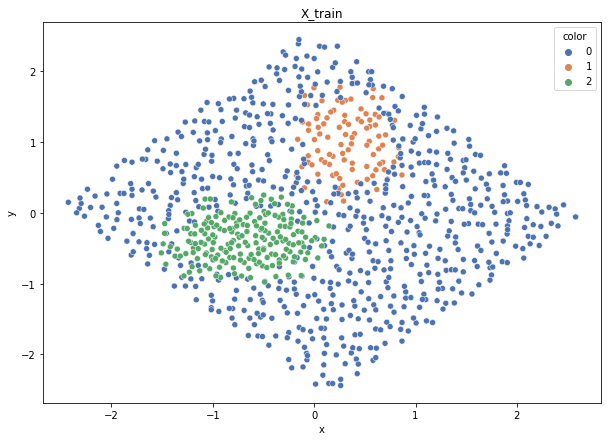

Class cardinalities: Counter({0: 672, 2: 192, 1: 96})
Weights: {1: 0.6086956521739131, 0: 0.08695652173913043, 2: 0.30434782608695654}


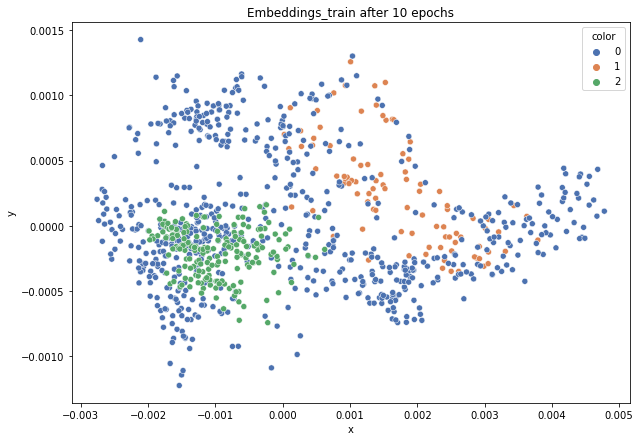

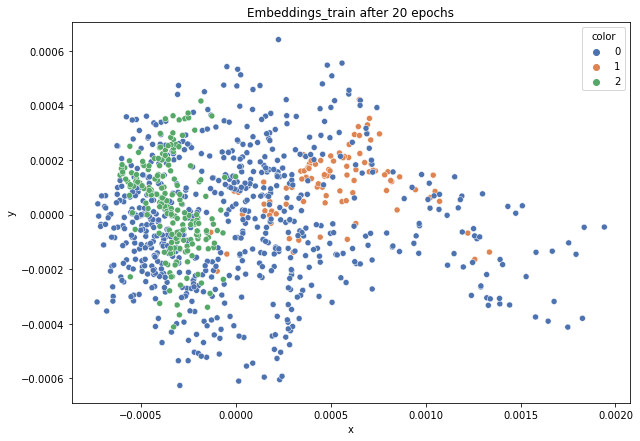

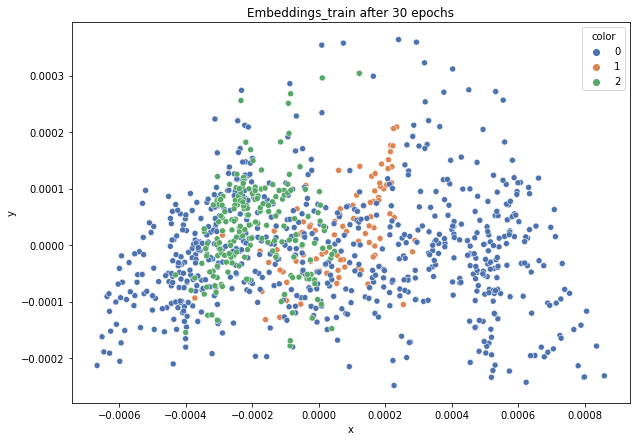

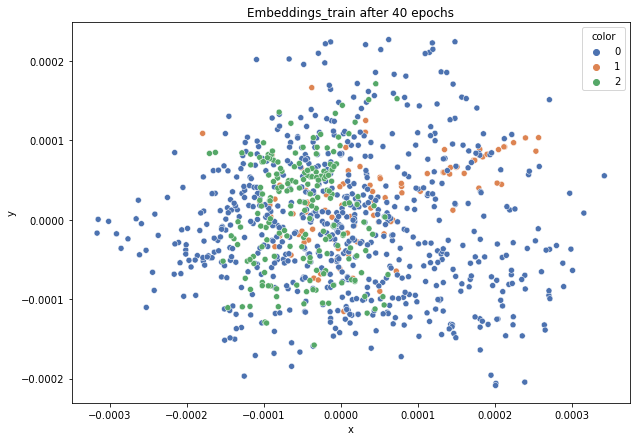

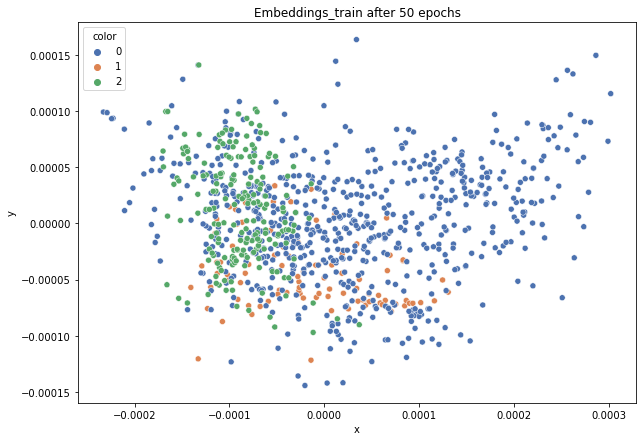

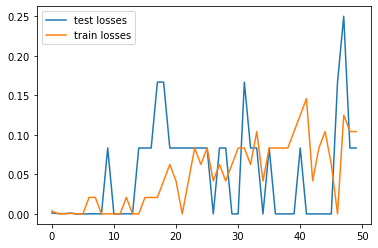

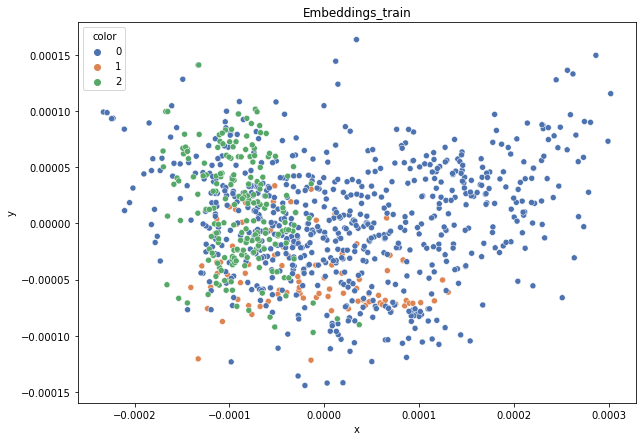

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/discriminant_analysis.py:715: UserWarning: Variables are collinear
  warnings.warn("Variables are collinear")
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/discriminant_analysis.py:715: UserWarning: Variables are collinear
  warnings.warn("Variables are collinear")


DT-f1-new-features: 0.686
DT-f1-old+new-features: 0.767
DT-f1-old-features: 0.809
DT-gmean-new-features: 0.682
DT-gmean-old+new-features: 0.759
DT-gmean-old-features: 0.814
KNN-f1-new-features: 0.688
KNN-f1-old+new-features: 0.772
KNN-f1-old-features: 0.772
KNN-gmean-new-features: 0.672
KNN-gmean-old+new-features: 0.746
KNN-gmean-old-features: 0.746
LDA-f1-new-features: 0.815
LDA-f1-old+new-features: 0.801
LDA-f1-old-features: 0.265
LDA-gmean-new-features: 0.799
LDA-gmean-old+new-features: 0.788
LDA-gmean-old-features: 0.026
QDA-f1-new-features: 0.819
QDA-f1-old+new-features: 0.798
QDA-f1-old-features: 0.739
QDA-gmean-new-features: 0.831
QDA-gmean-old+new-features: 0.816
QDA-gmean-old-features: 0.64
RF24-f1-new-features: 0.675
RF24-f1-old+new-features: 0.798
RF24-f1-old-features: 0.811
RF24-gmean-new-features: 0.632
RF24-gmean-old+new-features: 0.772
RF24-gmean-old-features: 0.811


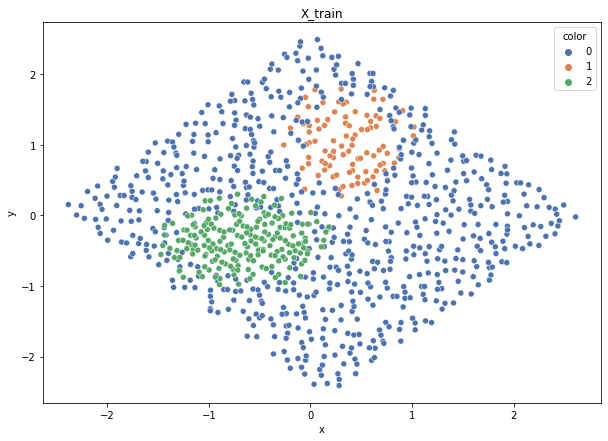

Class cardinalities: Counter({0: 672, 2: 192, 1: 96})
Weights: {1: 0.6086956521739131, 0: 0.08695652173913043, 2: 0.30434782608695654}


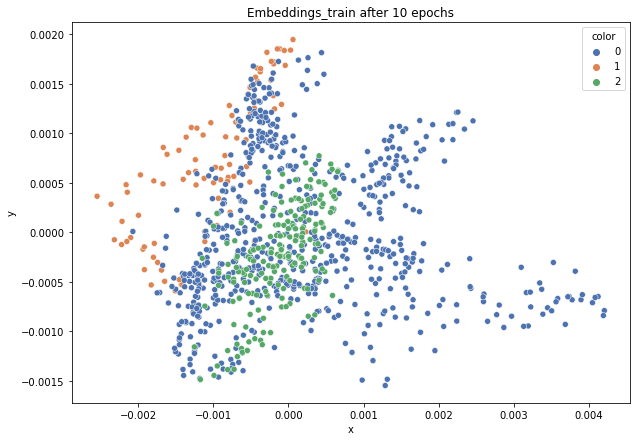

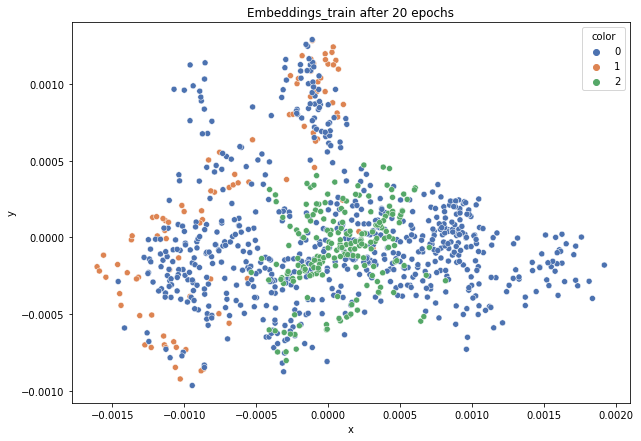

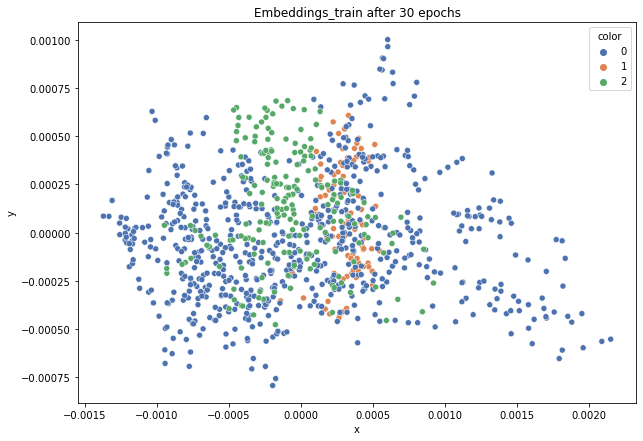

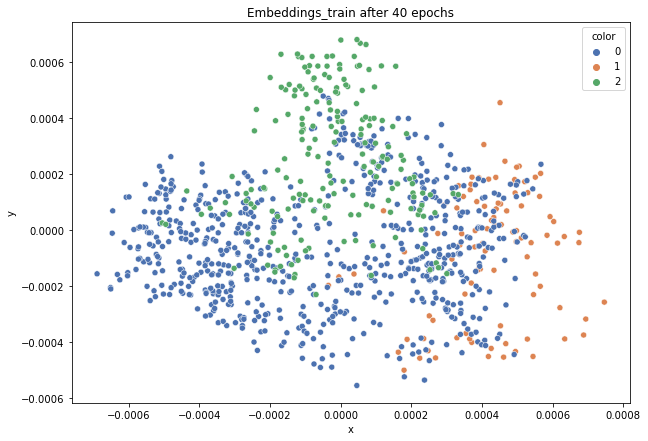

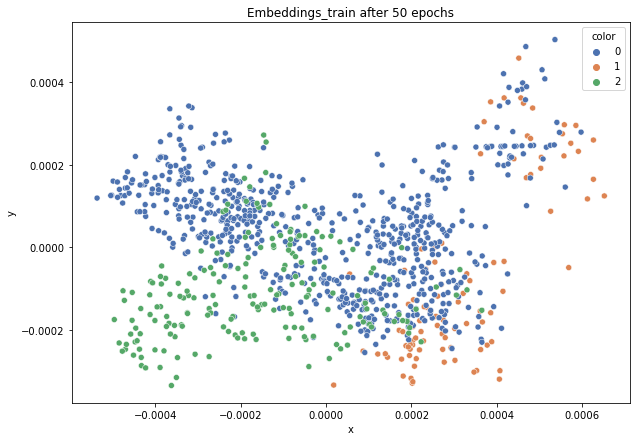

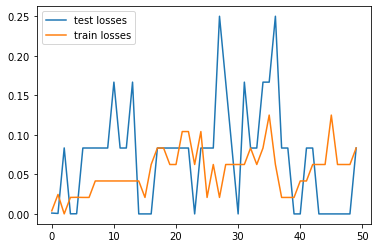

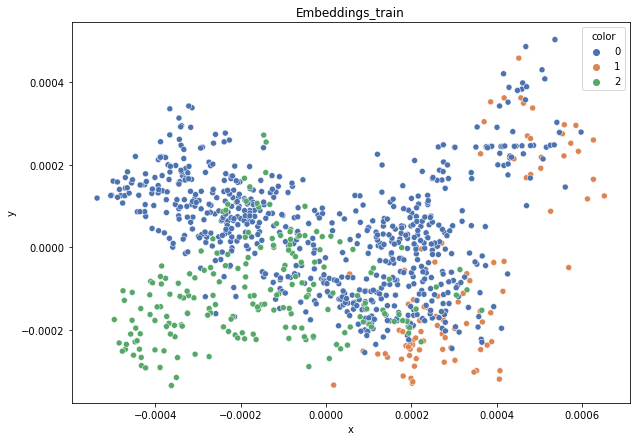

DT-f1-new-features: 0.701
DT-f1-old+new-features: 0.797
DT-f1-old-features: 0.761
DT-gmean-new-features: 0.688
DT-gmean-old+new-features: 0.803
DT-gmean-old-features: 0.769
KNN-f1-new-features: 0.739
KNN-f1-old+new-features: 0.767
KNN-f1-old-features: 0.767
KNN-gmean-new-features: 0.735
KNN-gmean-old+new-features: 0.776
KNN-gmean-old-features: 0.776
LDA-f1-new-features: 0.779
LDA-f1-old+new-features: 0.812
LDA-f1-old-features: 0.274
LDA-gmean-new-features: 0.731
LDA-gmean-old+new-features: 0.778
LDA-gmean-old-features: 0.027
QDA-f1-new-features: 0.783
QDA-f1-old+new-features: 0.819
QDA-f1-old-features: 0.843
QDA-gmean-new-features: 0.792
QDA-gmean-old+new-features: 0.851
QDA-gmean-old-features: 0.8
RF24-f1-new-features: 0.771
RF24-f1-old+new-features: 0.779
RF24-f1-old-features: 0.826
RF24-gmean-new-features: 0.748
RF24-gmean-old+new-features: 0.776
RF24-gmean-old-features: 0.845


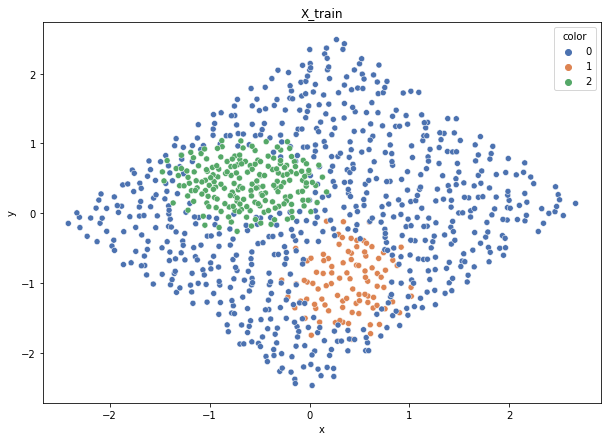

Class cardinalities: Counter({0: 672, 2: 192, 1: 96})
Weights: {1: 0.6086956521739131, 0: 0.08695652173913043, 2: 0.30434782608695654}


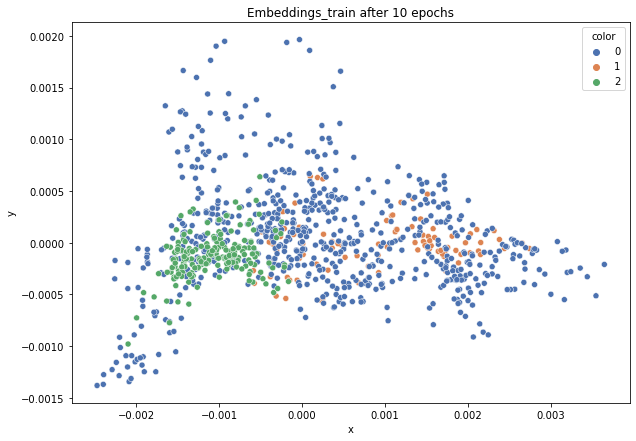

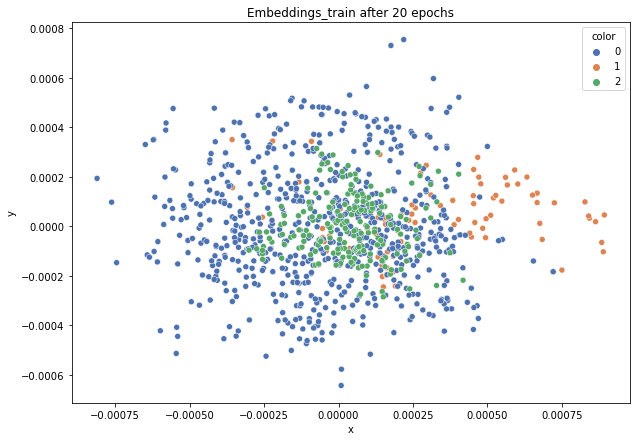

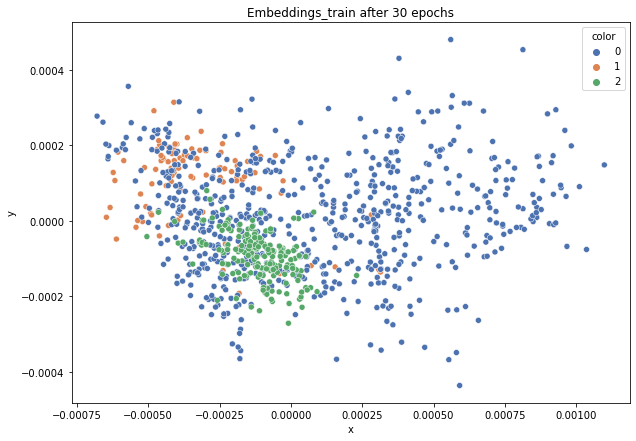

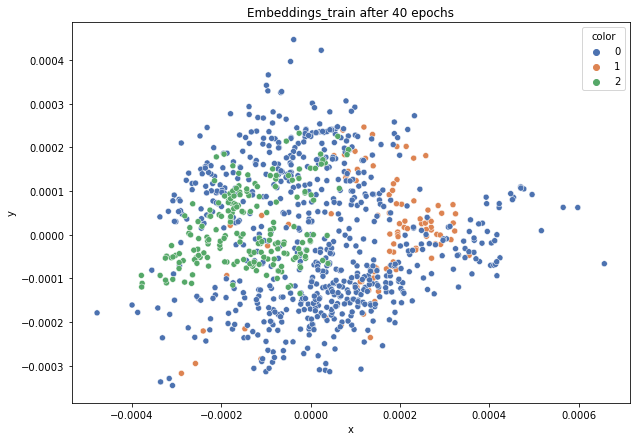

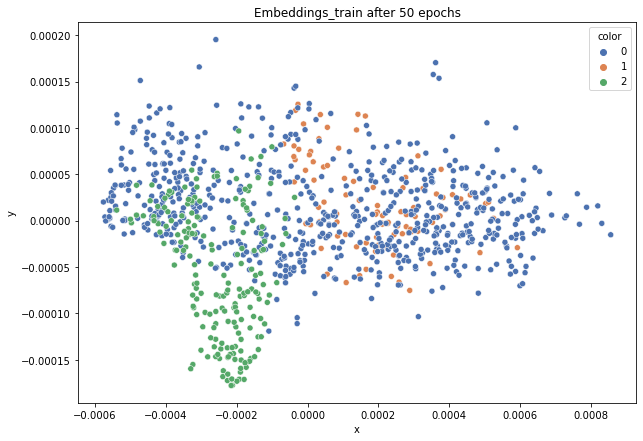

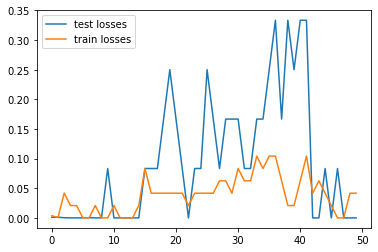

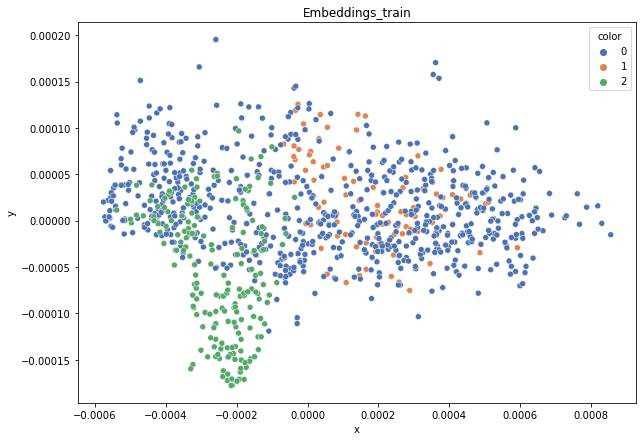

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/discriminant_analysis.py:715: UserWarning: Variables are collinear
  warnings.warn("Variables are collinear")
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/discriminant_analysis.py:715: UserWarning: Variables are collinear
  warnings.warn("Variables are collinear")


DT-f1-new-features: 0.757
DT-f1-old+new-features: 0.813
DT-f1-old-features: 0.785
DT-gmean-new-features: 0.746
DT-gmean-old+new-features: 0.794
DT-gmean-old-features: 0.785
KNN-f1-new-features: 0.749
KNN-f1-old+new-features: 0.766
KNN-f1-old-features: 0.766
KNN-gmean-new-features: 0.742
KNN-gmean-old+new-features: 0.744
KNN-gmean-old-features: 0.744
LDA-f1-new-features: 0.767
LDA-f1-old+new-features: 0.802
LDA-f1-old-features: 0.276
LDA-gmean-new-features: 0.712
LDA-gmean-old+new-features: 0.77
LDA-gmean-old-features: 0.027
QDA-f1-new-features: 0.789
QDA-f1-old+new-features: 0.835
QDA-f1-old-features: 0.718
QDA-gmean-new-features: 0.821
QDA-gmean-old+new-features: 0.839
QDA-gmean-old-features: 0.599
RF24-f1-new-features: 0.811
RF24-f1-old+new-features: 0.827
RF24-f1-old-features: 0.801
RF24-gmean-new-features: 0.759
RF24-gmean-old+new-features: 0.782
RF24-gmean-old-features: 0.78


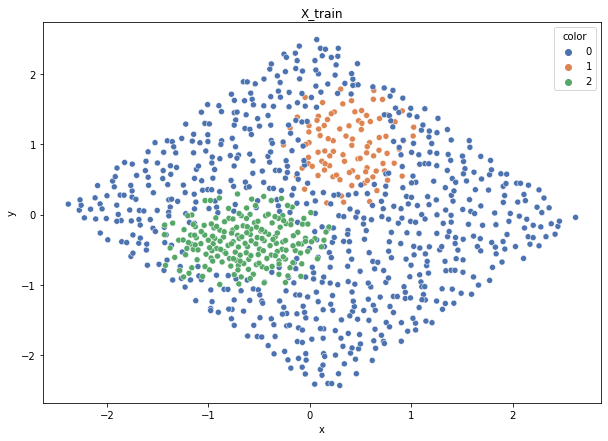

Class cardinalities: Counter({0: 672, 2: 192, 1: 96})
Weights: {1: 0.6086956521739131, 0: 0.08695652173913043, 2: 0.30434782608695654}


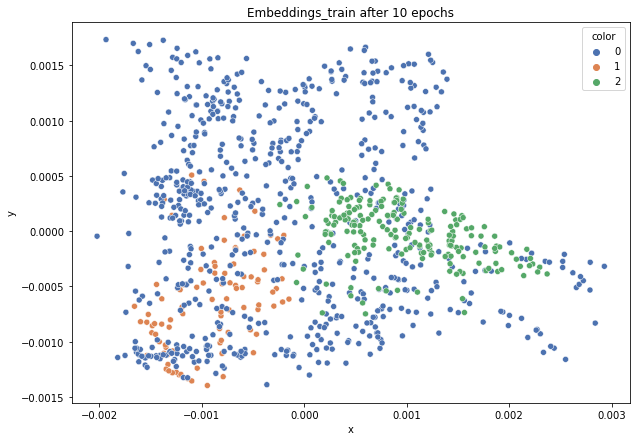

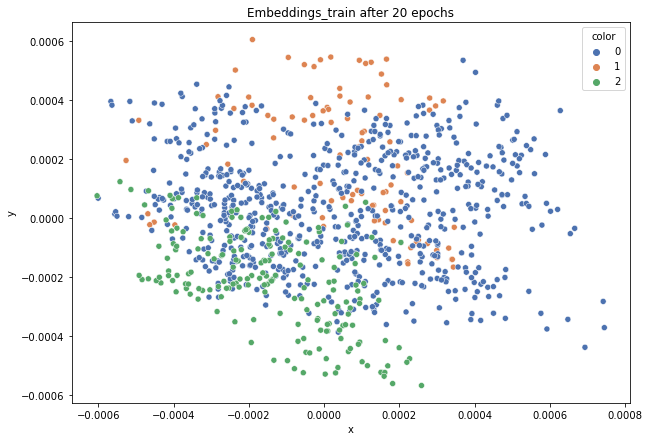

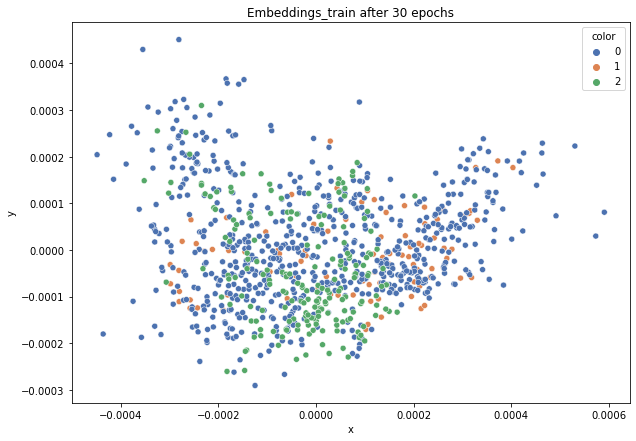

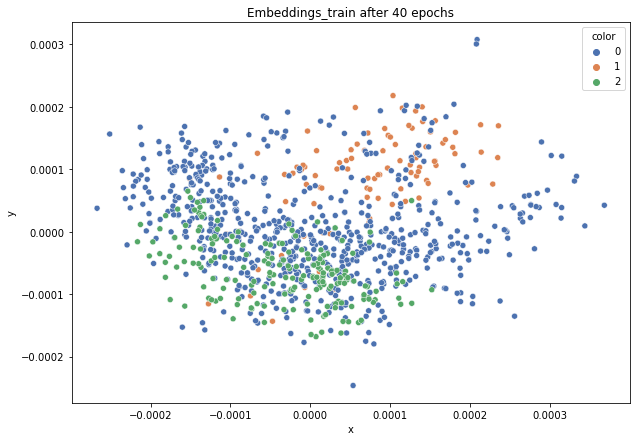

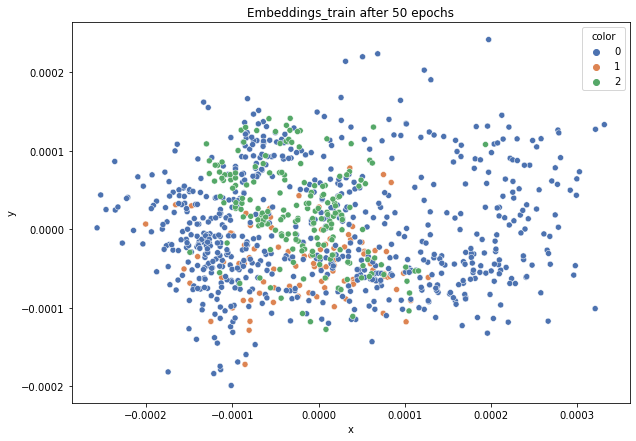

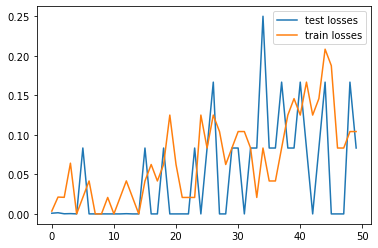

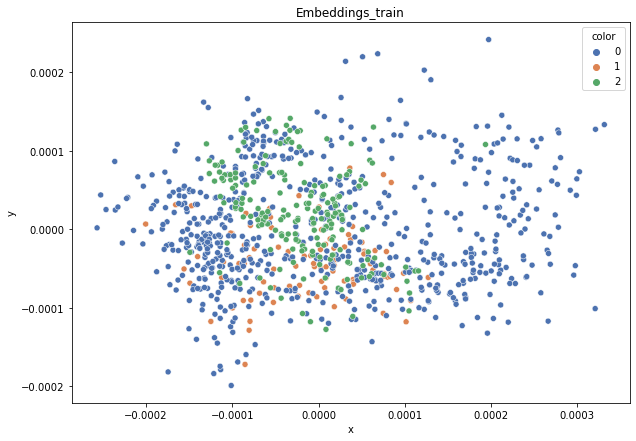

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/discriminant_analysis.py:715: UserWarning: Variables are collinear
  warnings.warn("Variables are collinear")


DT-f1-new-features: 0.667
DT-f1-old+new-features: 0.796
DT-f1-old-features: 0.805
DT-gmean-new-features: 0.7
DT-gmean-old+new-features: 0.832
DT-gmean-old-features: 0.831
KNN-f1-new-features: 0.712
KNN-f1-old+new-features: 0.747
KNN-f1-old-features: 0.747
KNN-gmean-new-features: 0.741
KNN-gmean-old+new-features: 0.749
KNN-gmean-old-features: 0.749
LDA-f1-new-features: 0.699
LDA-f1-old+new-features: 0.79
LDA-f1-old-features: 0.265
LDA-gmean-new-features: 0.655
LDA-gmean-old+new-features: 0.782
LDA-gmean-old-features: 0.01
QDA-f1-new-features: 0.778
QDA-f1-old+new-features: 0.824
QDA-f1-old-features: 0.828
QDA-gmean-new-features: 0.828
QDA-gmean-old+new-features: 0.897
QDA-gmean-old-features: 0.78
RF24-f1-new-features: 0.678
RF24-f1-old+new-features: 0.804
RF24-f1-old-features: 0.827
RF24-gmean-new-features: 0.685
RF24-gmean-old+new-features: 0.84
RF24-gmean-old-features: 0.871


/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/discriminant_analysis.py:715: UserWarning: Variables are collinear
  warnings.warn("Variables are collinear")


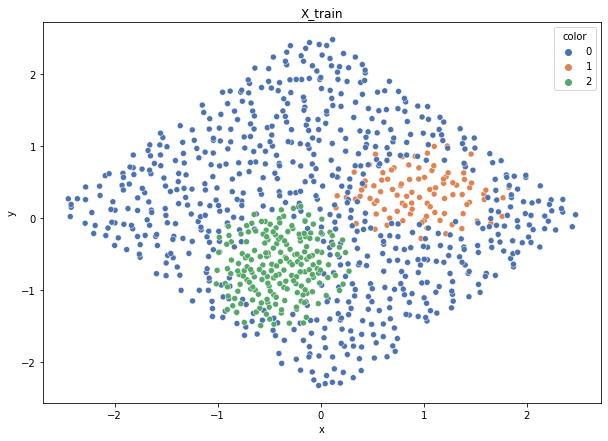

Class cardinalities: Counter({0: 672, 2: 192, 1: 96})
Weights: {1: 0.6086956521739131, 0: 0.08695652173913043, 2: 0.30434782608695654}


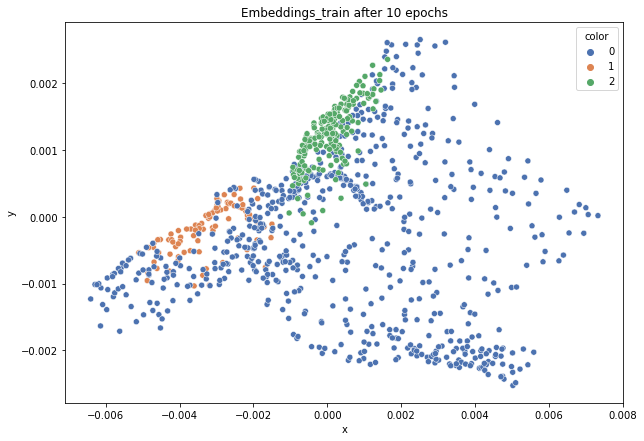

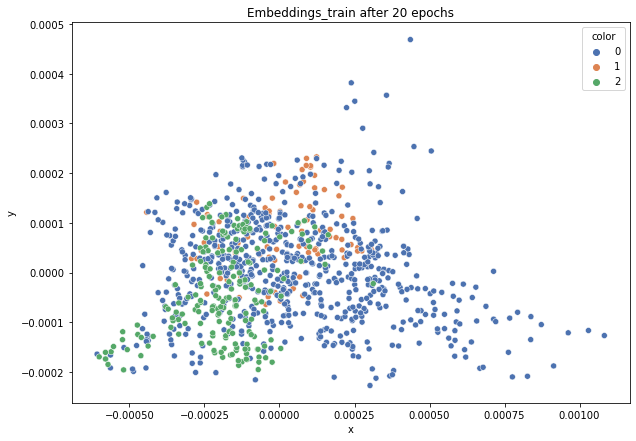

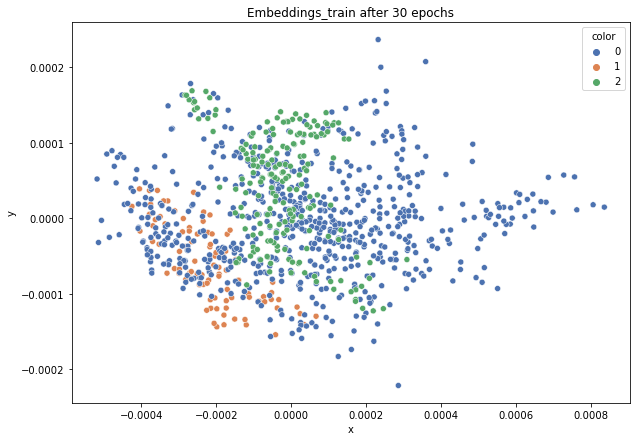

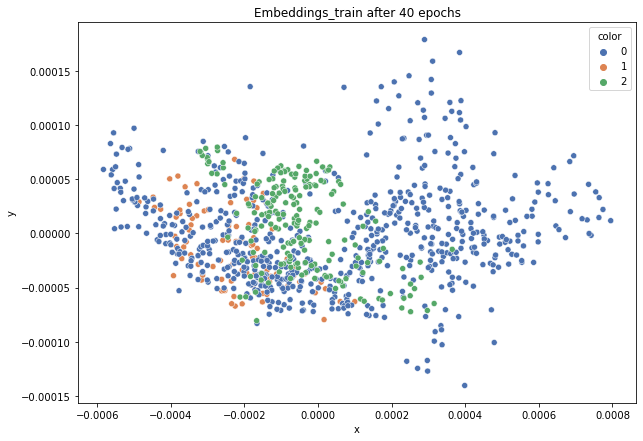

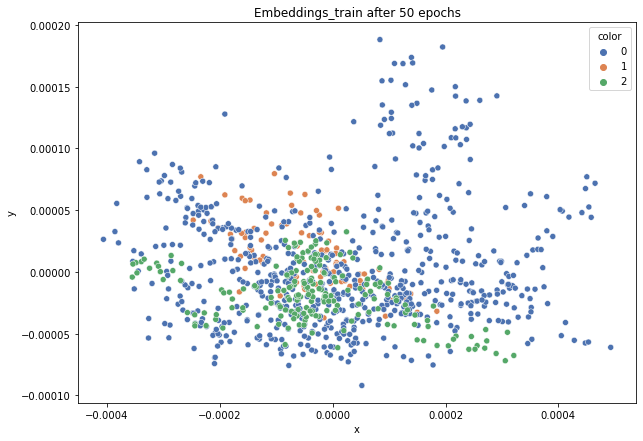

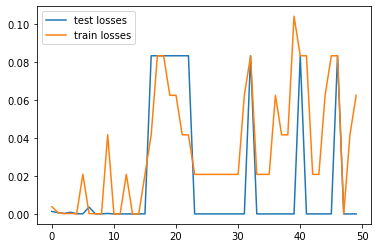

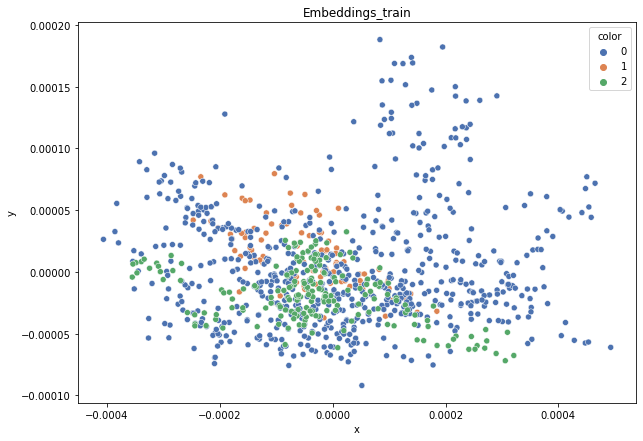

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/discriminant_analysis.py:715: UserWarning: Variables are collinear
  warnings.warn("Variables are collinear")
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/discriminant_analysis.py:715: UserWarning: Variables are collinear
  warnings.warn("Variables are collinear")


DT-f1-new-features: 0.686
DT-f1-old+new-features: 0.809
DT-f1-old-features: 0.821
DT-gmean-new-features: 0.711
DT-gmean-old+new-features: 0.837
DT-gmean-old-features: 0.866
KNN-f1-new-features: 0.591
KNN-f1-old+new-features: 0.786
KNN-f1-old-features: 0.786
KNN-gmean-new-features: 0.569
KNN-gmean-old+new-features: 0.788
KNN-gmean-old-features: 0.788
LDA-f1-new-features: 0.706
LDA-f1-old+new-features: 0.755
LDA-f1-old-features: 0.264
LDA-gmean-new-features: 0.699
LDA-gmean-old+new-features: 0.763
LDA-gmean-old-features: 0.026
QDA-f1-new-features: 0.844
QDA-f1-old+new-features: 0.834
QDA-f1-old-features: 0.841
QDA-gmean-new-features: 0.937
QDA-gmean-old+new-features: 0.912
QDA-gmean-old-features: 0.767
RF24-f1-new-features: 0.799
RF24-f1-old+new-features: 0.819
RF24-f1-old-features: 0.836
RF24-gmean-new-features: 0.832
RF24-gmean-old+new-features: 0.844
RF24-gmean-old-features: 0.87
balance-scale


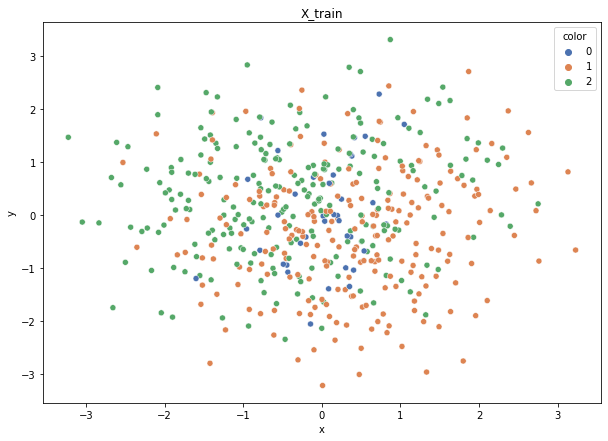

Class cardinalities: Counter({1: 231, 2: 230, 0: 39})
Weights: {0: 0.7471628063958148, 2: 0.1266928236932034, 1: 0.12614436991098174}


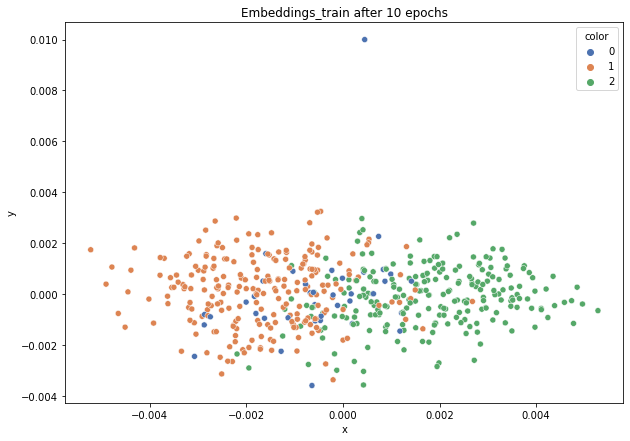

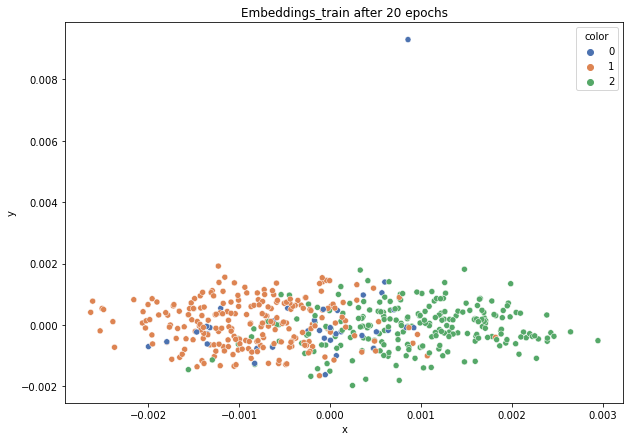

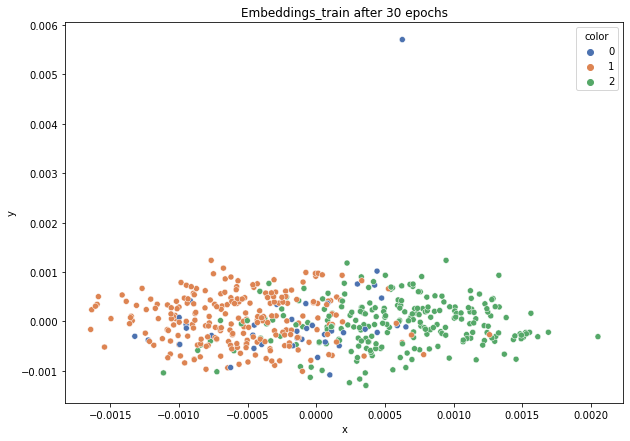

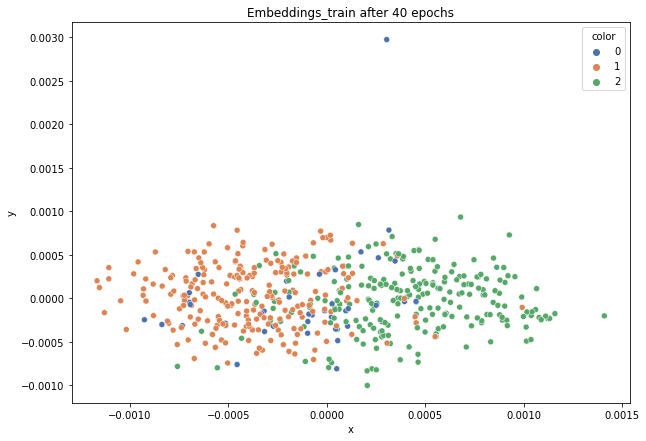

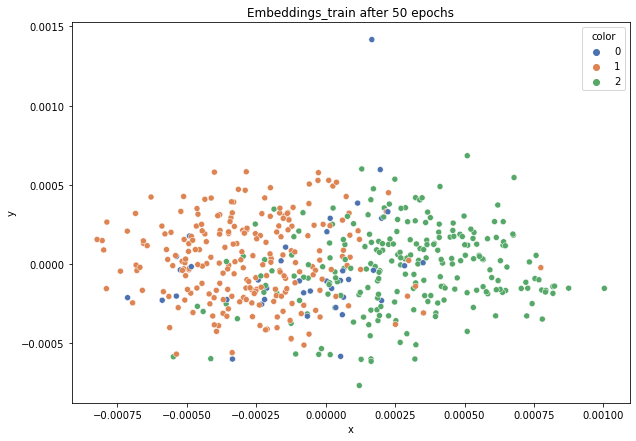

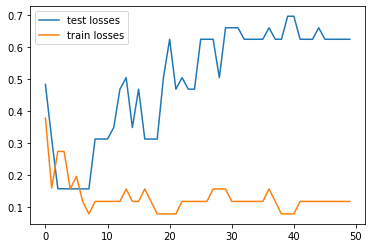

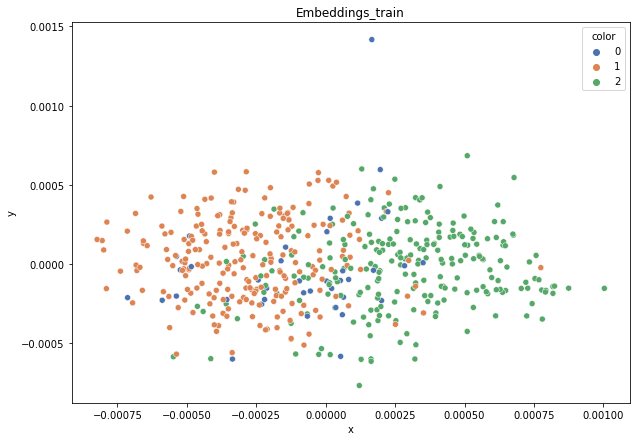

DT-f1-new-features: 0.486
DT-f1-old+new-features: 0.514
DT-f1-old-features: 0.568
DT-gmean-new-features: 0.358
DT-gmean-old+new-features: 0.373
DT-gmean-old-features: 0.088
KNN-f1-new-features: 0.507
KNN-f1-old+new-features: 0.568
KNN-f1-old-features: 0.568
KNN-gmean-new-features: 0.369
KNN-gmean-old+new-features: 0.09
KNN-gmean-old-features: 0.09
LDA-f1-new-features: 0.456
LDA-f1-old+new-features: 0.571
LDA-f1-old-features: 0.617
LDA-gmean-new-features: 0.08
LDA-gmean-old+new-features: 0.092
LDA-gmean-old-features: 0.098
QDA-f1-new-features: 0.504
QDA-f1-old+new-features: 0.672
QDA-f1-old-features: 0.936
QDA-gmean-new-features: 0.444
QDA-gmean-old+new-features: 0.588
QDA-gmean-old-features: 0.971
RF24-f1-new-features: 0.459
RF24-f1-old+new-features: 0.487
RF24-f1-old-features: 0.585
RF24-gmean-new-features: 0.08
RF24-gmean-old+new-features: 0.083
RF24-gmean-old-features: 0.092


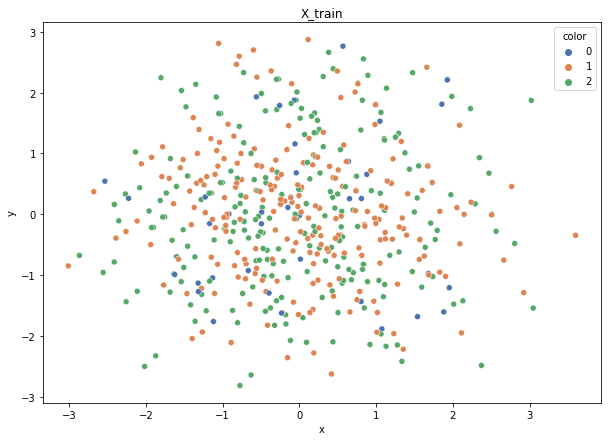

Class cardinalities: Counter({1: 231, 2: 230, 0: 39})
Weights: {0: 0.7471628063958148, 2: 0.1266928236932034, 1: 0.12614436991098174}


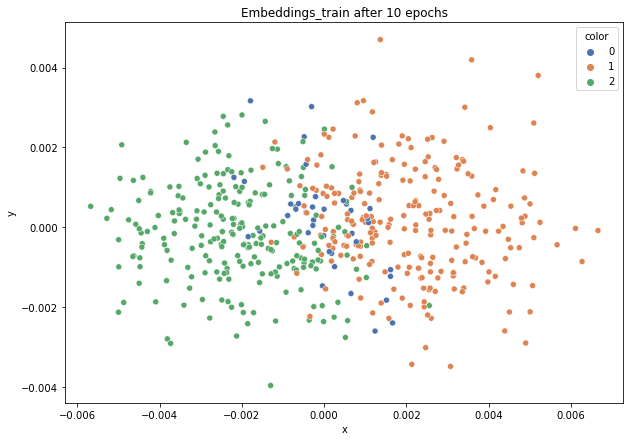

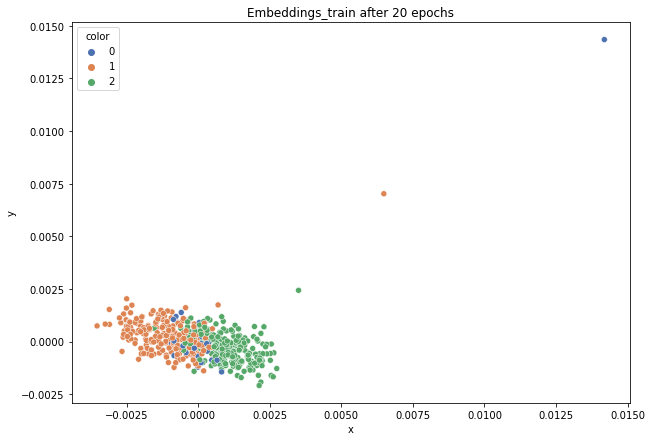

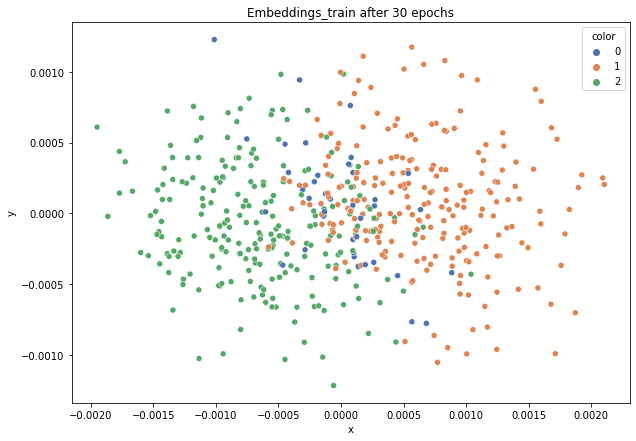

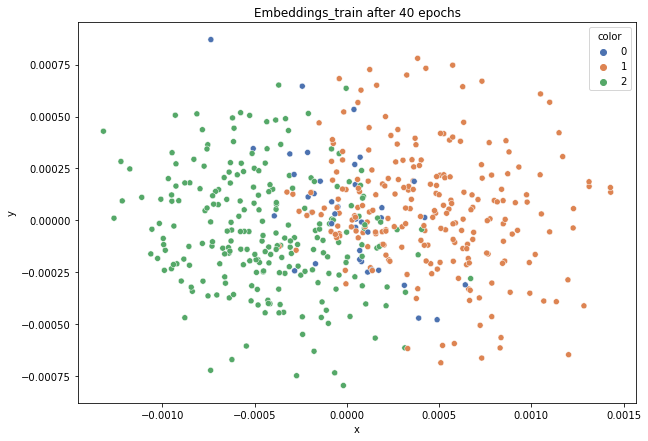

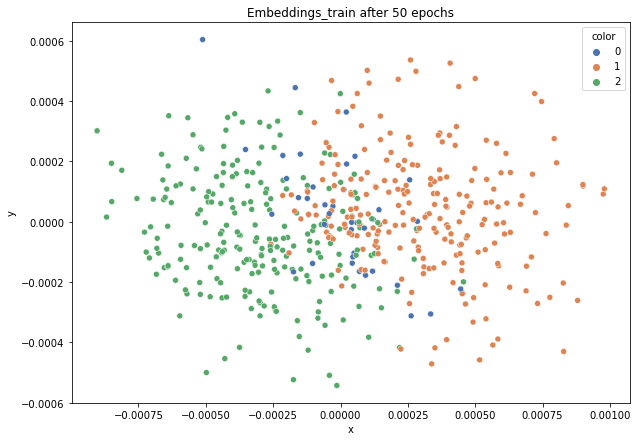

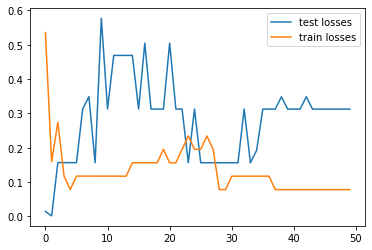

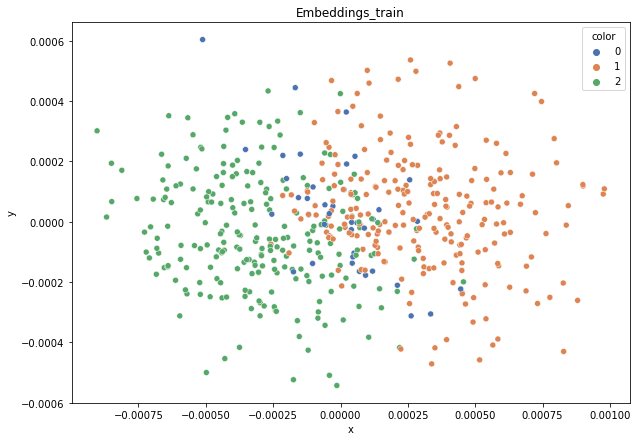

DT-f1-new-features: 0.434
DT-f1-old+new-features: 0.475
DT-f1-old-features: 0.638
DT-gmean-new-features: 0.073
DT-gmean-old+new-features: 0.078
DT-gmean-old-features: 0.585
KNN-f1-new-features: 0.464
KNN-f1-old+new-features: 0.557
KNN-f1-old-features: 0.545
KNN-gmean-new-features: 0.079
KNN-gmean-old+new-features: 0.089
KNN-gmean-old-features: 0.088
LDA-f1-new-features: 0.524
LDA-f1-old+new-features: 0.579
LDA-f1-old-features: 0.601
LDA-gmean-new-features: 0.087
LDA-gmean-old+new-features: 0.093
LDA-gmean-old-features: 0.096
QDA-f1-new-features: 0.578
QDA-f1-old+new-features: 0.627
QDA-f1-old-features: 0.845
QDA-gmean-new-features: 0.406
QDA-gmean-old+new-features: 0.428
QDA-gmean-old-features: 0.908
RF24-f1-new-features: 0.541
RF24-f1-old+new-features: 0.549
RF24-f1-old-features: 0.591
RF24-gmean-new-features: 0.089
RF24-gmean-old+new-features: 0.09
RF24-gmean-old-features: 0.092


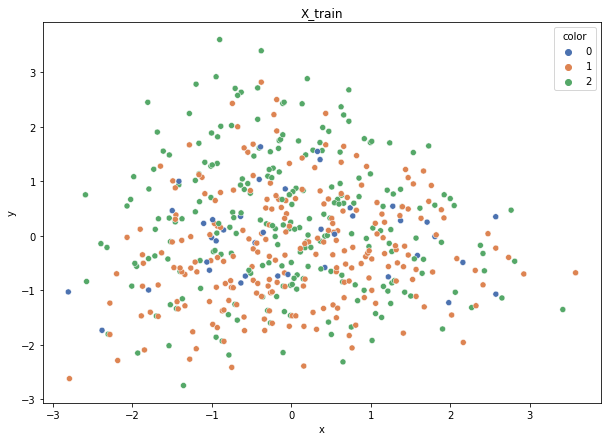

Class cardinalities: Counter({2: 231, 1: 230, 0: 39})
Weights: {2: 0.12614436991098174, 1: 0.1266928236932034, 0: 0.7471628063958148}


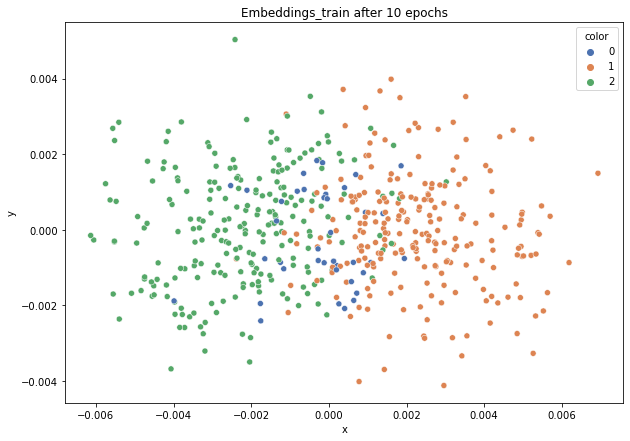

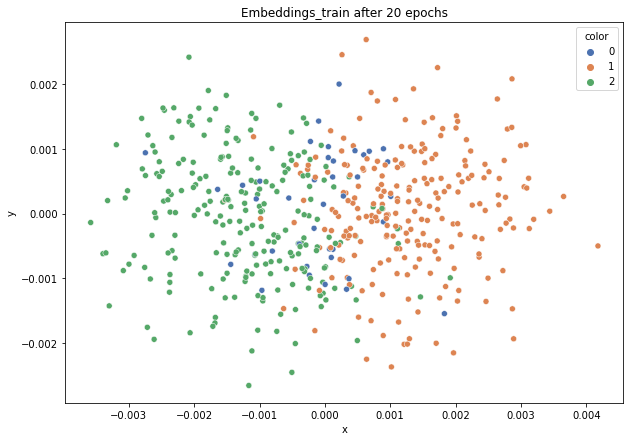

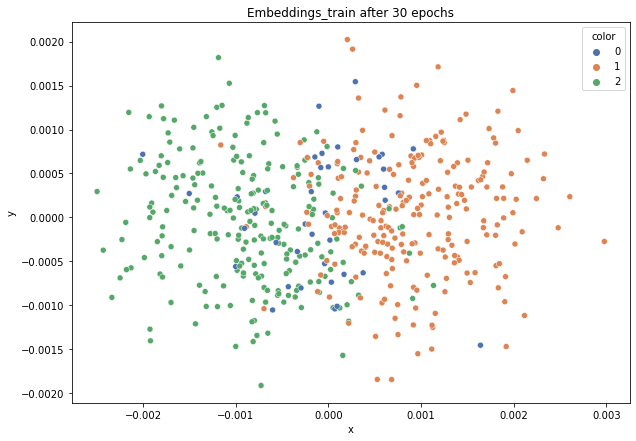

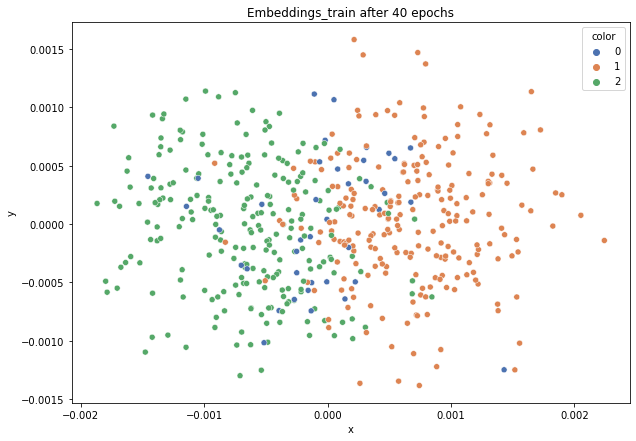

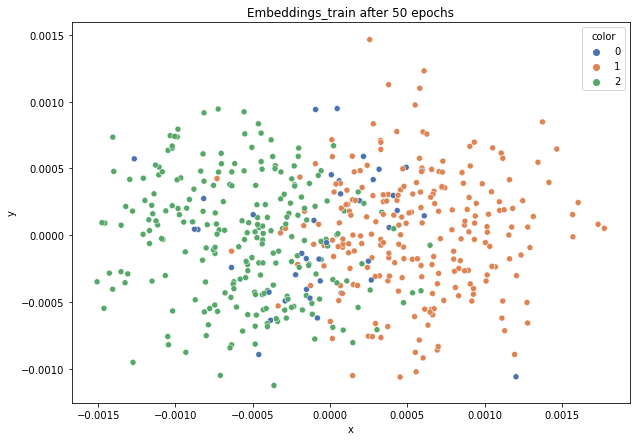

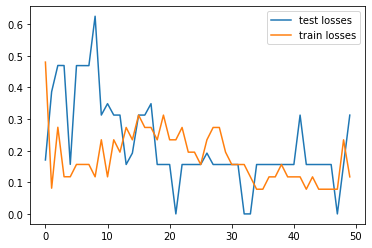

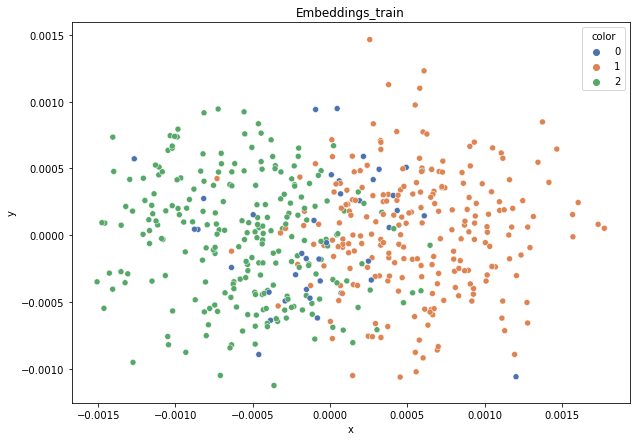

DT-f1-new-features: 0.518
DT-f1-old+new-features: 0.523
DT-f1-old-features: 0.655
DT-gmean-new-features: 0.451
DT-gmean-old+new-features: 0.453
DT-gmean-old-features: 0.597
KNN-f1-new-features: 0.469
KNN-f1-old+new-features: 0.578
KNN-f1-old-features: 0.566
KNN-gmean-new-features: 0.079
KNN-gmean-old+new-features: 0.092
KNN-gmean-old-features: 0.09
LDA-f1-new-features: 0.467
LDA-f1-old+new-features: 0.583
LDA-f1-old-features: 0.6
LDA-gmean-new-features: 0.08
LDA-gmean-old+new-features: 0.408
LDA-gmean-old-features: 0.096
QDA-f1-new-features: 0.528
QDA-f1-old+new-features: 0.622
QDA-f1-old-features: 0.836
QDA-gmean-new-features: 0.459
QDA-gmean-old+new-features: 0.514
QDA-gmean-old-features: 0.923
RF24-f1-new-features: 0.455
RF24-f1-old+new-features: 0.477
RF24-f1-old-features: 0.602
RF24-gmean-new-features: 0.079
RF24-gmean-old+new-features: 0.082
RF24-gmean-old-features: 0.093


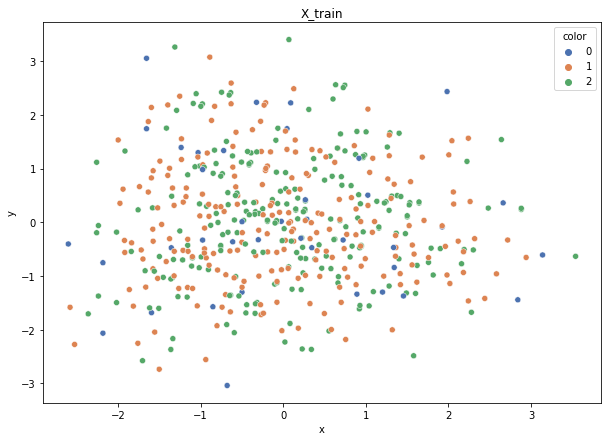

Class cardinalities: Counter({2: 231, 1: 230, 0: 39})
Weights: {0: 0.7471628063958148, 2: 0.12614436991098174, 1: 0.1266928236932034}


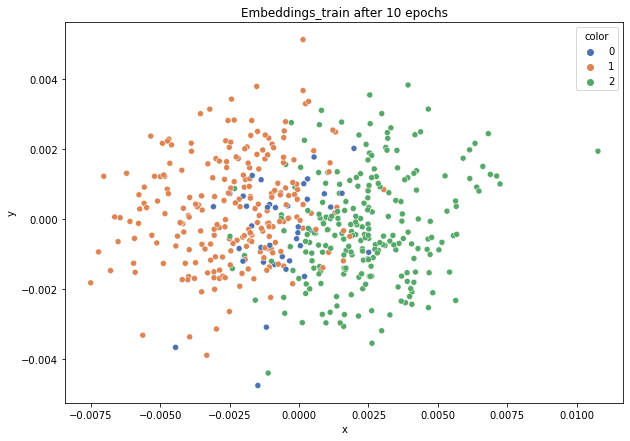

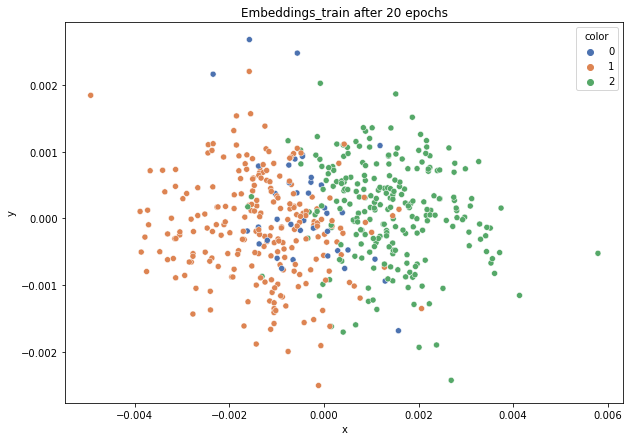

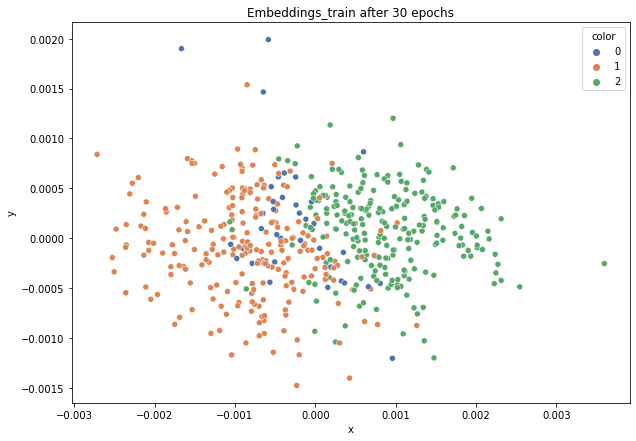

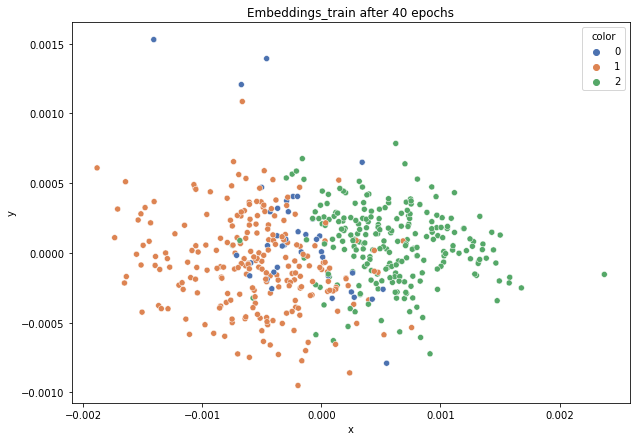

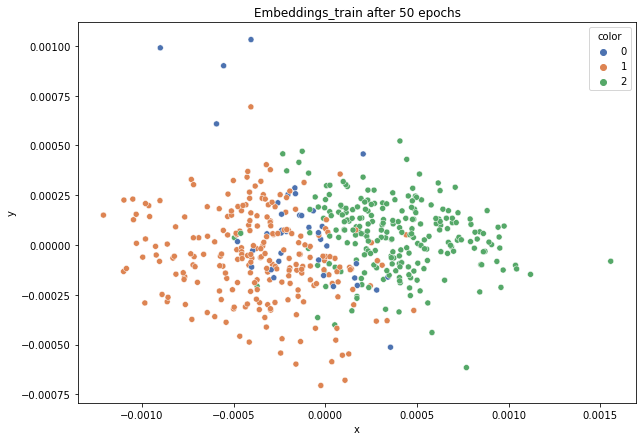

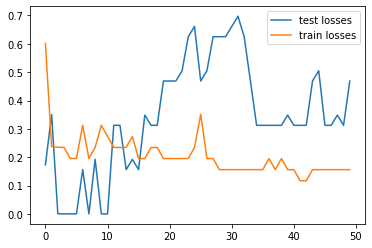

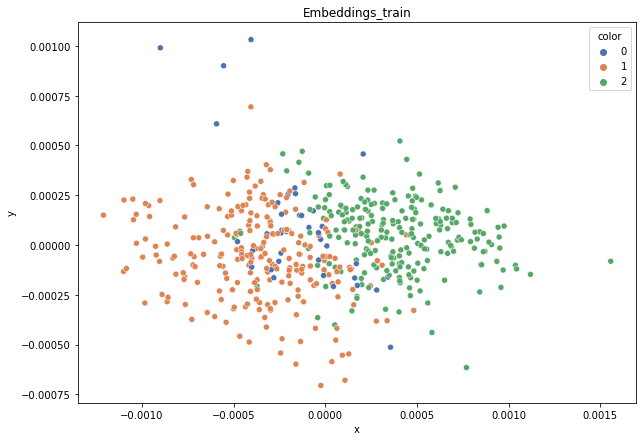

DT-f1-new-features: 0.523
DT-f1-old+new-features: 0.519
DT-f1-old-features: 0.582
DT-gmean-new-features: 0.534
DT-gmean-old+new-features: 0.499
DT-gmean-old-features: 0.397
KNN-f1-new-features: 0.503
KNN-f1-old+new-features: 0.553
KNN-f1-old-features: 0.562
KNN-gmean-new-features: 0.367
KNN-gmean-old+new-features: 0.088
KNN-gmean-old-features: 0.089
LDA-f1-new-features: 0.503
LDA-f1-old+new-features: 0.612
LDA-f1-old-features: 0.6
LDA-gmean-new-features: 0.367
LDA-gmean-old+new-features: 0.422
LDA-gmean-old-features: 0.096
QDA-f1-new-features: 0.487
QDA-f1-old+new-features: 0.712
QDA-f1-old-features: 0.809
QDA-gmean-new-features: 0.358
QDA-gmean-old+new-features: 0.618
QDA-gmean-old-features: 0.862
RF24-f1-new-features: 0.527
RF24-f1-old+new-features: 0.598
RF24-f1-old-features: 0.603
RF24-gmean-new-features: 0.379
RF24-gmean-old+new-features: 0.492
RF24-gmean-old-features: 0.094


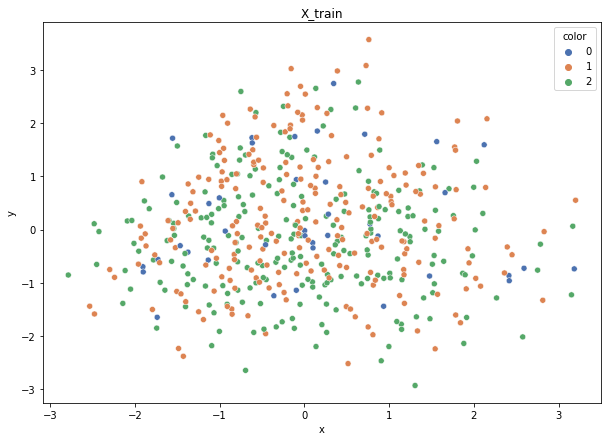

Class cardinalities: Counter({2: 230, 1: 230, 0: 40})
Weights: {0: 0.7419354838709677, 2: 0.12903225806451613, 1: 0.12903225806451613}


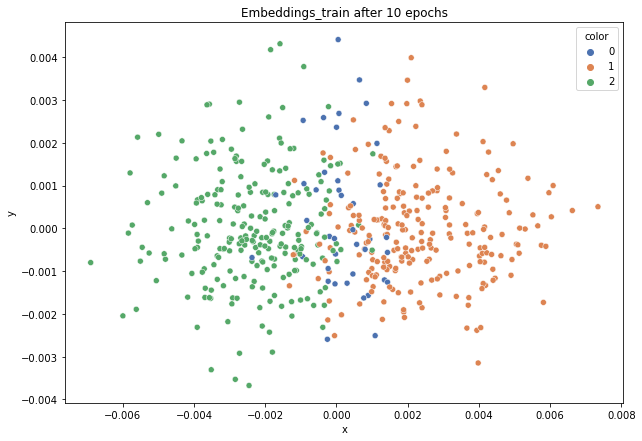

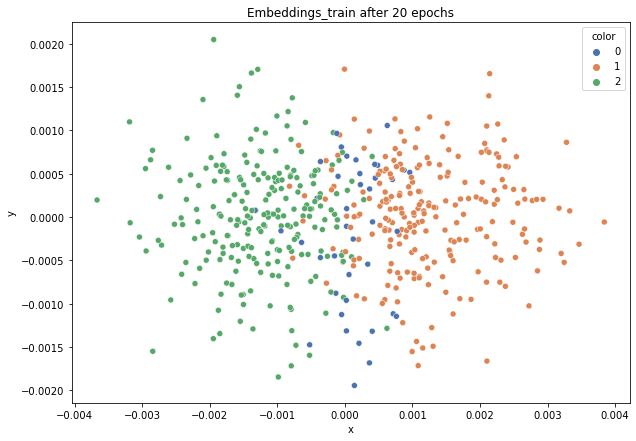

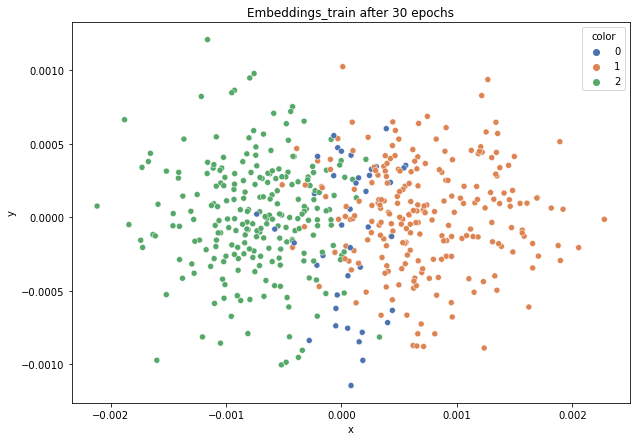

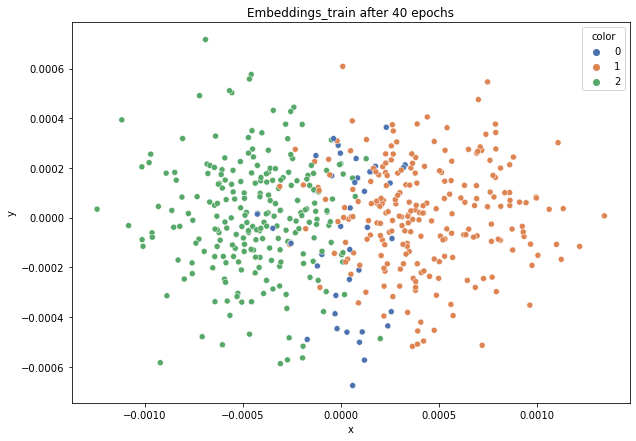

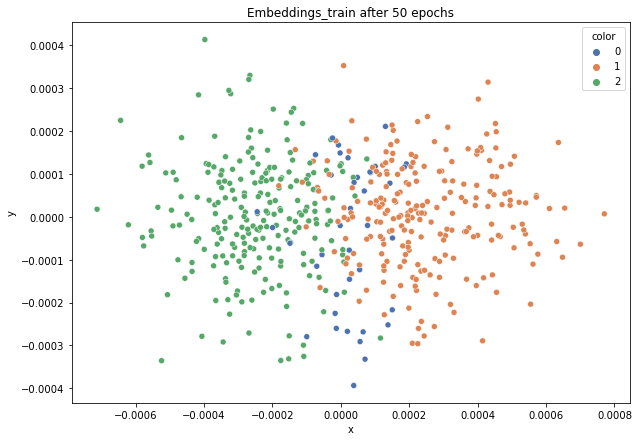

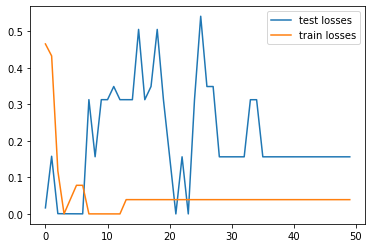

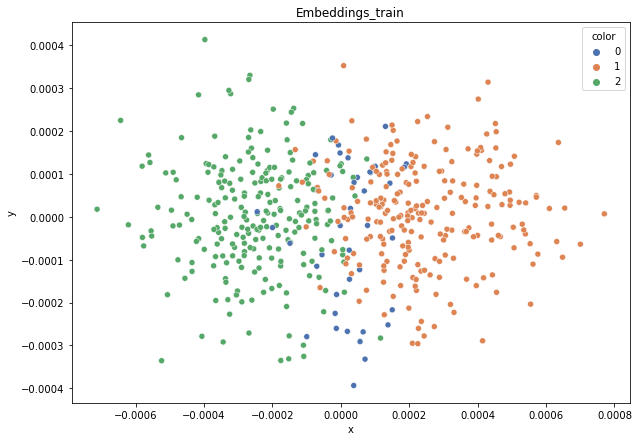

DT-f1-new-features: 0.564
DT-f1-old+new-features: 0.575
DT-f1-old-features: 0.582
DT-gmean-new-features: 0.496
DT-gmean-old+new-features: 0.504
DT-gmean-old-features: 0.415
KNN-f1-new-features: 0.626
KNN-f1-old+new-features: 0.567
KNN-f1-old-features: 0.563
KNN-gmean-new-features: 0.59
KNN-gmean-old+new-features: 0.09
KNN-gmean-old-features: 0.089
LDA-f1-new-features: 0.615
LDA-f1-old+new-features: 0.729
LDA-f1-old-features: 0.62
LDA-gmean-new-features: 0.519
LDA-gmean-old+new-features: 0.648
LDA-gmean-old-features: 0.098
QDA-f1-new-features: 0.588
QDA-f1-old+new-features: 0.725
QDA-f1-old-features: 0.859
QDA-gmean-new-features: 0.511
QDA-gmean-old+new-features: 0.641
QDA-gmean-old-features: 0.917
RF24-f1-new-features: 0.639
RF24-f1-old+new-features: 0.577
RF24-f1-old-features: 0.587
RF24-gmean-new-features: 0.59
RF24-gmean-old+new-features: 0.415
RF24-gmean-old-features: 0.091
cleveland


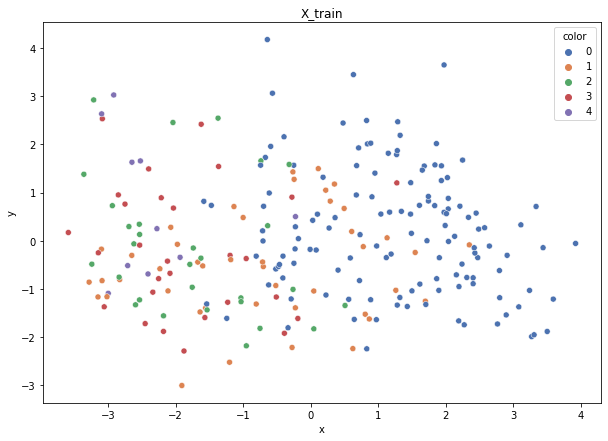

Class cardinalities: Counter({0: 131, 1: 44, 2: 29, 3: 28, 4: 10})
Weights: {0: 0.03806176471590889, 2: 0.1719341785442781, 1: 0.11332025404054694, 3: 0.17807468492085946, 4: 0.4986091177784065}


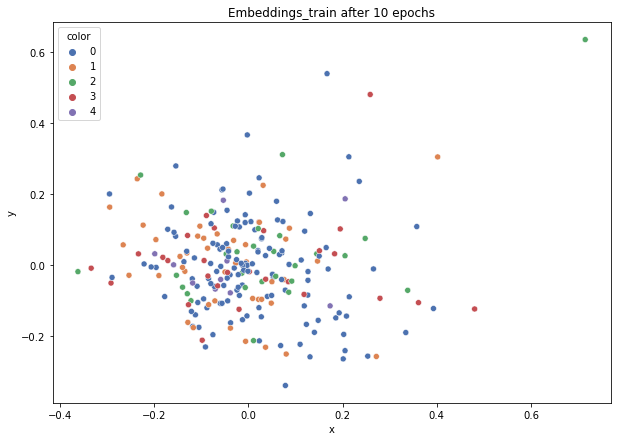

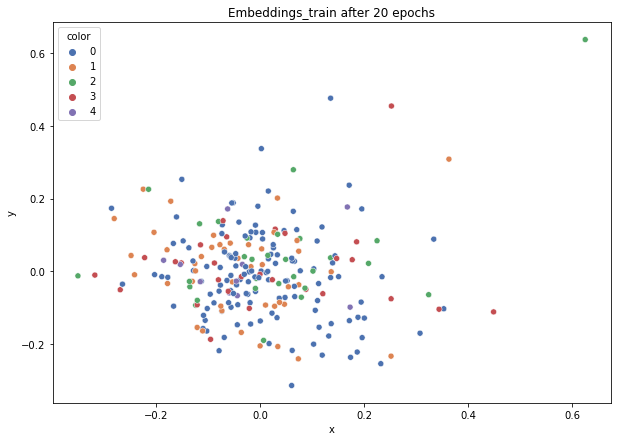

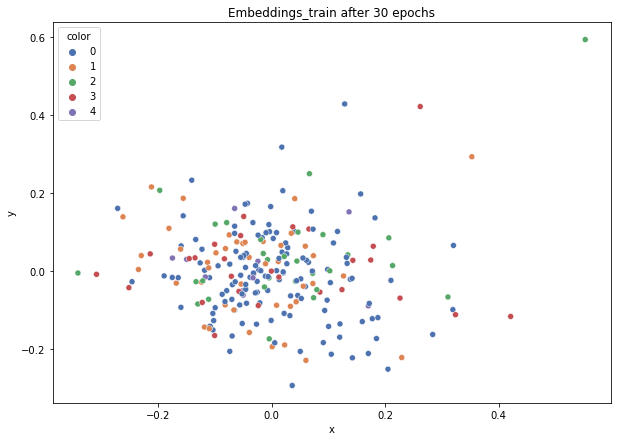

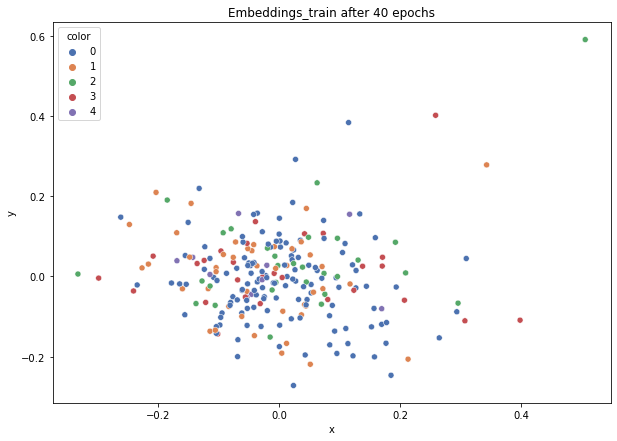

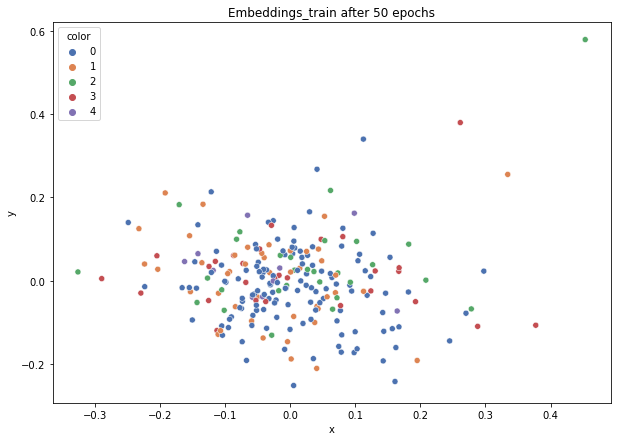

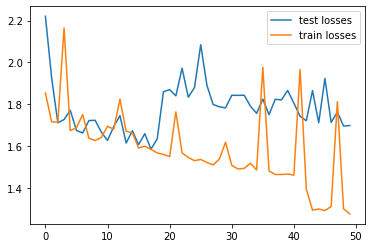

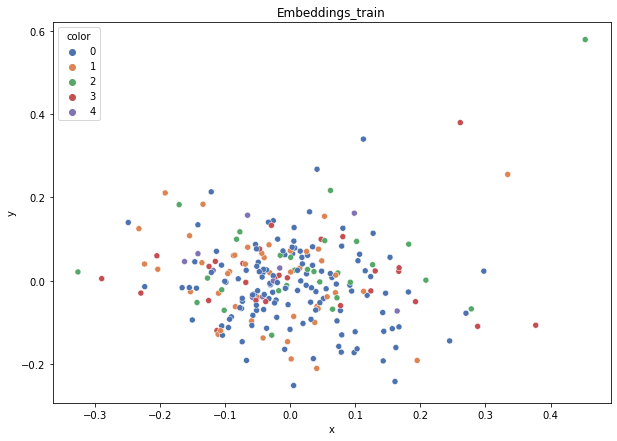

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/discriminant_analysis.py:715: UserWarning: Variables are collinear
  warnings.warn("Variables are collinear")
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/discriminant_analysis.py:715: UserWarning: Variables are collinear
  warnings.warn("Variables are collinear")


DT-f1-new-features: 0.227
DT-f1-old+new-features: 0.212
DT-f1-old-features: 0.266
DT-gmean-new-features: 0.031
DT-gmean-old+new-features: 0.03
DT-gmean-old-features: 0.098
KNN-f1-new-features: 0.337
KNN-f1-old+new-features: 0.275
KNN-f1-old-features: 0.275
KNN-gmean-new-features: 0.113
KNN-gmean-old+new-features: 0.089
KNN-gmean-old-features: 0.089
LDA-f1-new-features: 0.306
LDA-f1-old+new-features: 0.314
LDA-f1-old-features: 0.365
LDA-gmean-new-features: 0.092
LDA-gmean-old+new-features: 0.087
LDA-gmean-old-features: 0.111
QDA-f1-new-features: 0.303
QDA-f1-old+new-features: 0.205
QDA-f1-old-features: 0.392
QDA-gmean-new-features: 0.092
QDA-gmean-old+new-features: 0.012
QDA-gmean-old-features: 0.132
RF24-f1-new-features: 0.262
RF24-f1-old+new-features: 0.363
RF24-f1-old-features: 0.316
RF24-gmean-new-features: 0.034
RF24-gmean-old+new-features: 0.114
RF24-gmean-old-features: 0.092


/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/discriminant_analysis.py:715: UserWarning: Variables are collinear
  warnings.warn("Variables are collinear")


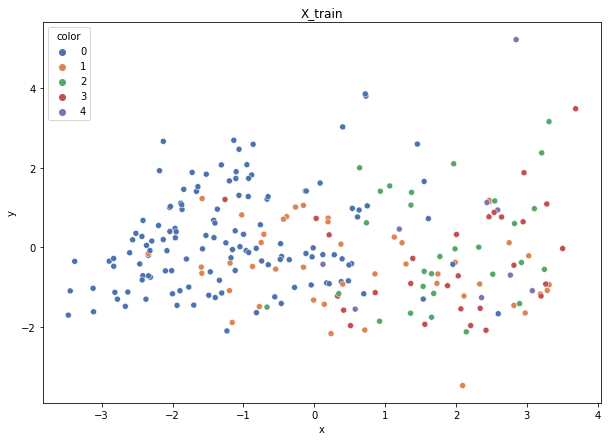

Class cardinalities: Counter({0: 131, 1: 44, 2: 29, 3: 28, 4: 10})
Weights: {0: 0.03806176471590889, 2: 0.1719341785442781, 1: 0.11332025404054694, 3: 0.17807468492085946, 4: 0.4986091177784065}


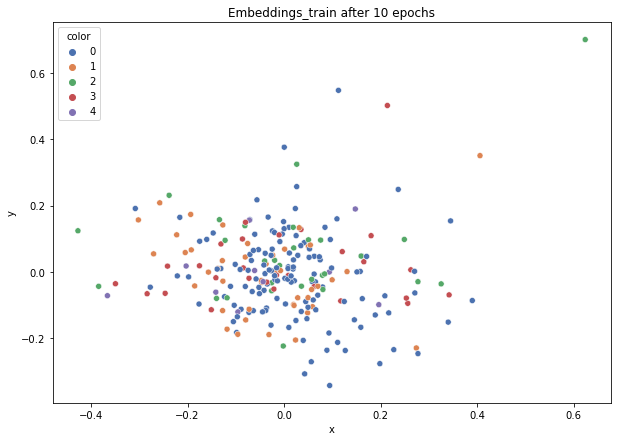

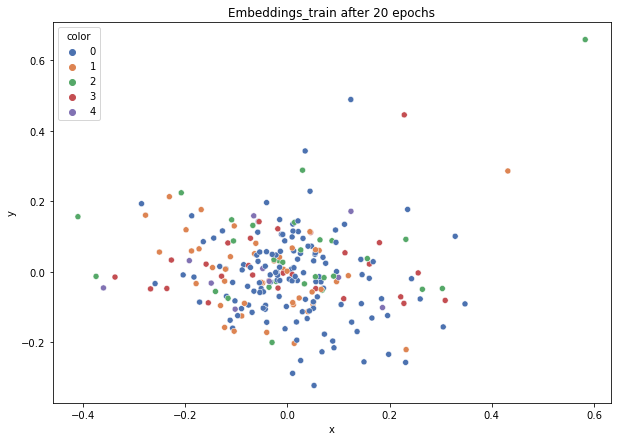

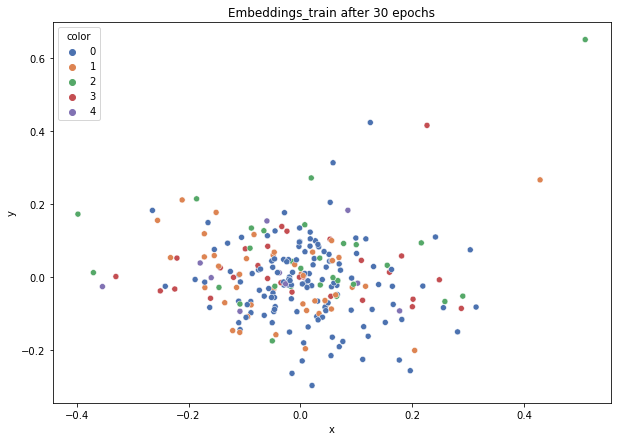

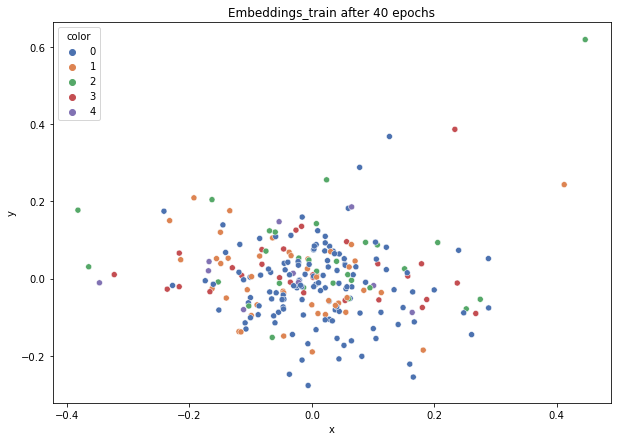

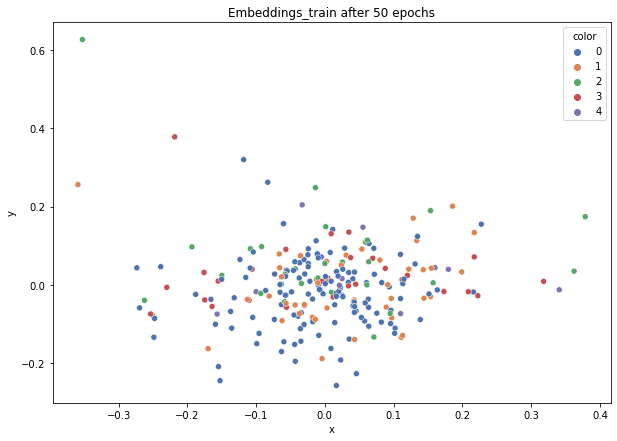

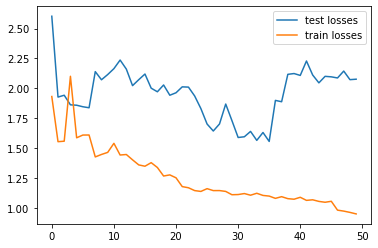

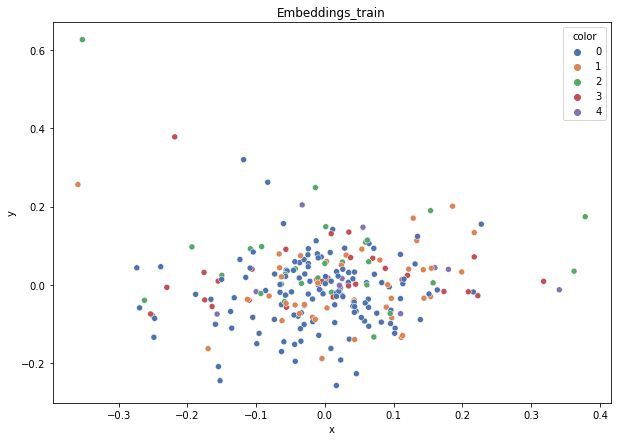

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/discriminant_analysis.py:715: UserWarning: Variables are collinear
  warnings.warn("Variables are collinear")
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/discriminant_analysis.py:715: UserWarning: Variables are collinear
  warnings.warn("Variables are collinear")
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/discriminant_analysis.py:715: UserWarning: Variables are collinear
  warnings.warn("Variables are collinear")


DT-f1-new-features: 0.29
DT-f1-old+new-features: 0.22
DT-f1-old-features: 0.281
DT-gmean-new-features: 0.104
DT-gmean-old+new-features: 0.03
DT-gmean-old-features: 0.101
KNN-f1-new-features: 0.351
KNN-f1-old+new-features: 0.356
KNN-f1-old-features: 0.356
KNN-gmean-new-features: 0.309
KNN-gmean-old+new-features: 0.122
KNN-gmean-old-features: 0.122
LDA-f1-new-features: 0.311
LDA-f1-old+new-features: 0.434
LDA-f1-old-features: 0.355
LDA-gmean-new-features: 0.092
LDA-gmean-old+new-features: 0.392
LDA-gmean-old-features: 0.108
QDA-f1-new-features: 0.367
QDA-f1-old+new-features: 0.217
QDA-f1-old-features: 0.39
QDA-gmean-new-features: 0.122
QDA-gmean-old+new-features: 0.012
QDA-gmean-old-features: 0.136
RF24-f1-new-features: 0.42
RF24-f1-old+new-features: 0.306
RF24-f1-old-features: 0.307
RF24-gmean-new-features: 0.342
RF24-gmean-old+new-features: 0.094
RF24-gmean-old-features: 0.093


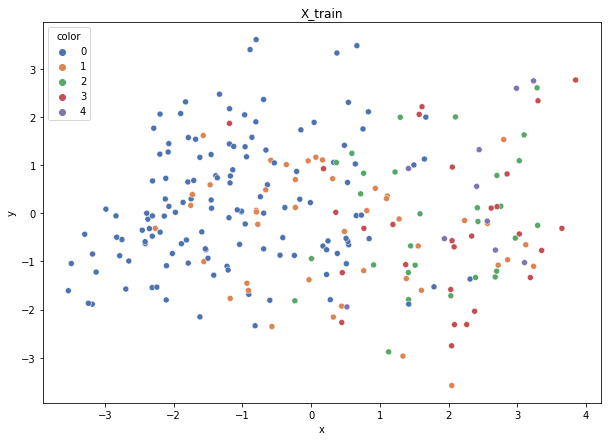

Class cardinalities: Counter({0: 131, 1: 44, 2: 29, 3: 28, 4: 10})
Weights: {0: 0.03806176471590889, 3: 0.17807468492085946, 1: 0.11332025404054694, 2: 0.1719341785442781, 4: 0.4986091177784065}


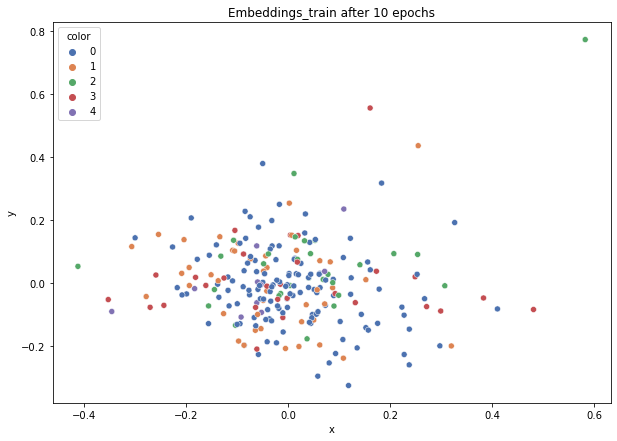

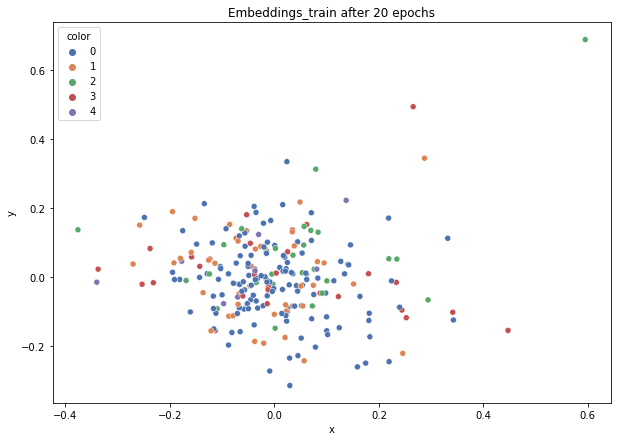

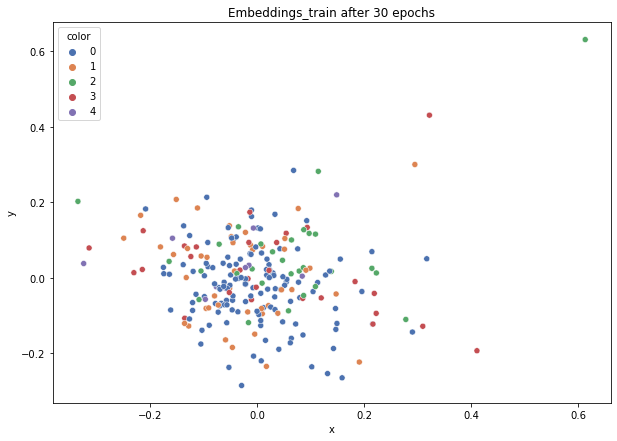

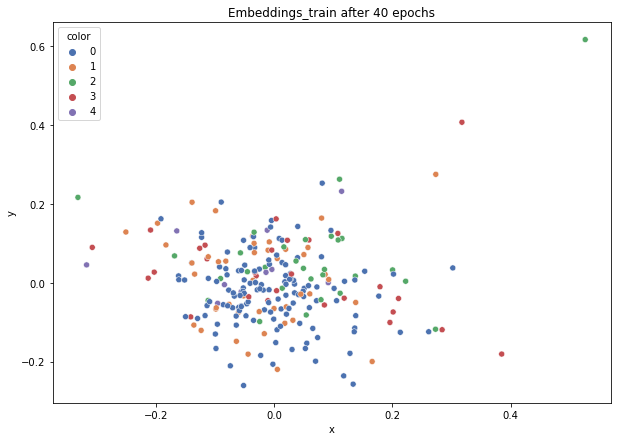

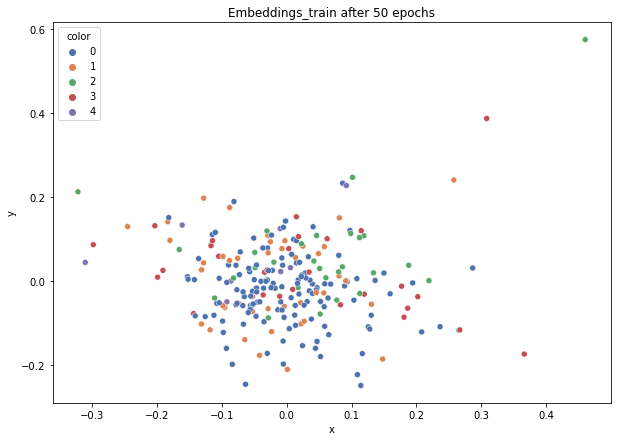

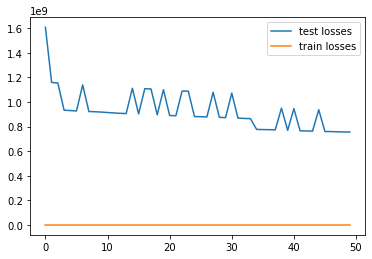

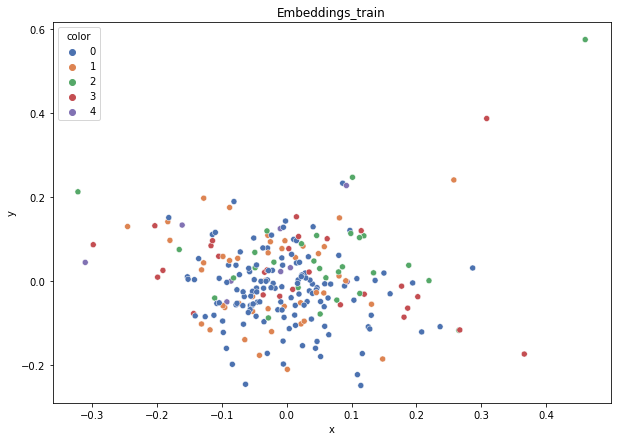

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/discriminant_analysis.py:715: UserWarning: Variables are collinear
  warnings.warn("Variables are collinear")
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/discriminant_analysis.py:715: UserWarning: Variables are collinear
  warnings.warn("Variables are collinear")
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/discriminant_analysis.py:715: UserWarning: Variables are collinear
  warnings.warn("Variables are collinear")


DT-f1-new-features: 0.316
DT-f1-old+new-features: 0.363
DT-f1-old-features: 0.368
DT-gmean-new-features: 0.298
DT-gmean-old+new-features: 0.301
DT-gmean-old-features: 0.128
KNN-f1-new-features: 0.292
KNN-f1-old+new-features: 0.315
KNN-f1-old-features: 0.325
KNN-gmean-new-features: 0.097
KNN-gmean-old+new-features: 0.108
KNN-gmean-old-features: 0.109
LDA-f1-new-features: 0.316
LDA-f1-old+new-features: 0.293
LDA-f1-old-features: 0.261
LDA-gmean-new-features: 0.104
LDA-gmean-old+new-features: 0.219
LDA-gmean-old-features: 0.034
QDA-f1-new-features: 0.322
QDA-f1-old+new-features: 0.218
QDA-f1-old-features: 0.345
QDA-gmean-new-features: 0.106
QDA-gmean-old+new-features: 0.013
QDA-gmean-old-features: 0.12
RF24-f1-new-features: 0.363
RF24-f1-old+new-features: 0.454
RF24-f1-old-features: 0.315
RF24-gmean-new-features: 0.314
RF24-gmean-old+new-features: 0.368
RF24-gmean-old-features: 0.1


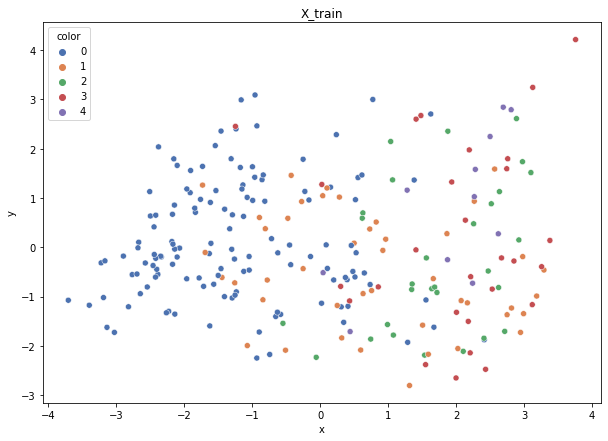

Class cardinalities: Counter({0: 131, 1: 44, 2: 29, 3: 28, 4: 11})
Weights: {0: 0.03986894846317969, 2: 0.18009766374746689, 1: 0.11870073292446681, 3: 0.18652972316701927, 4: 0.47480293169786725}


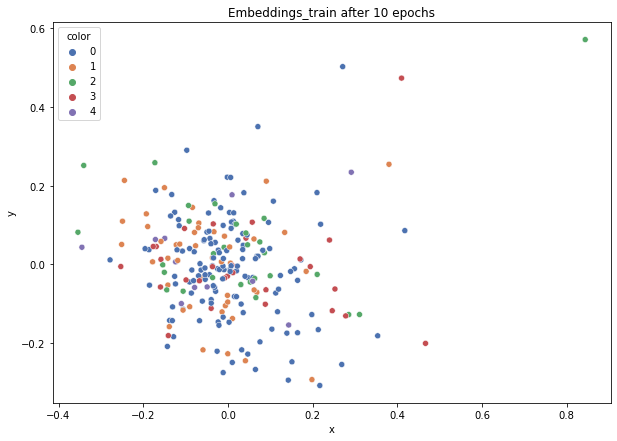

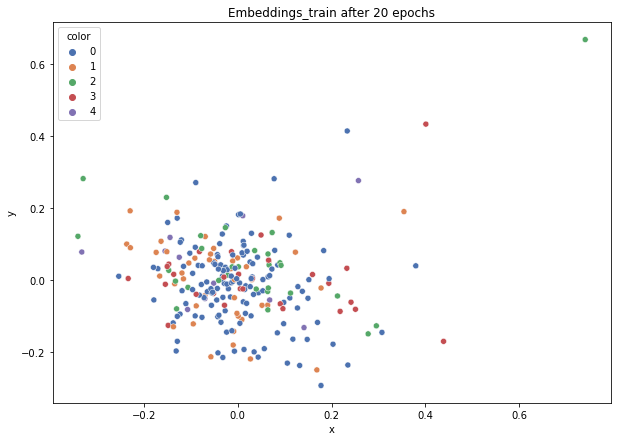

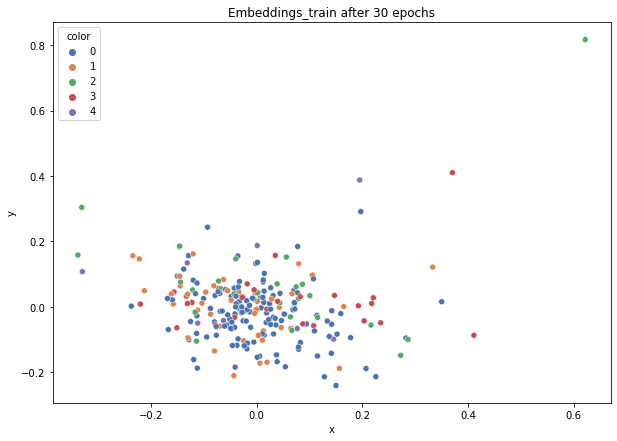

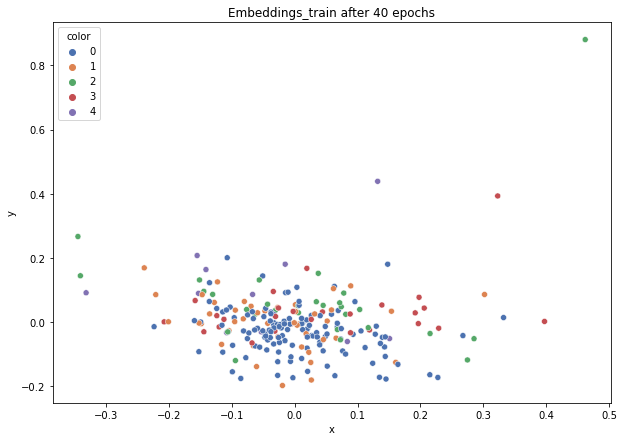

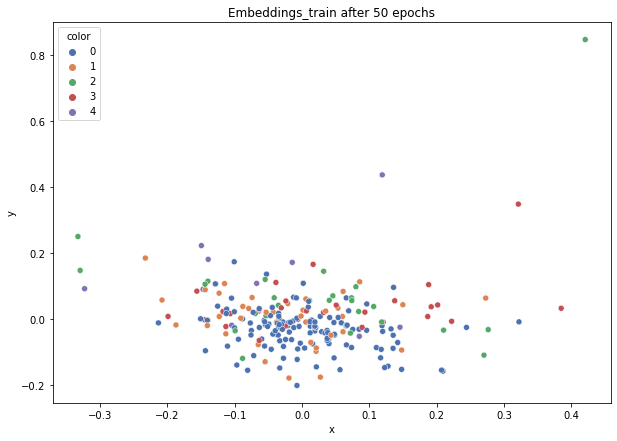

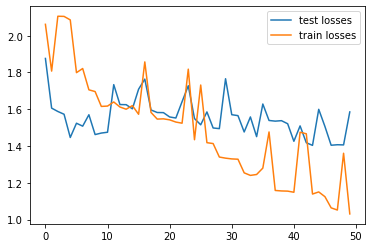

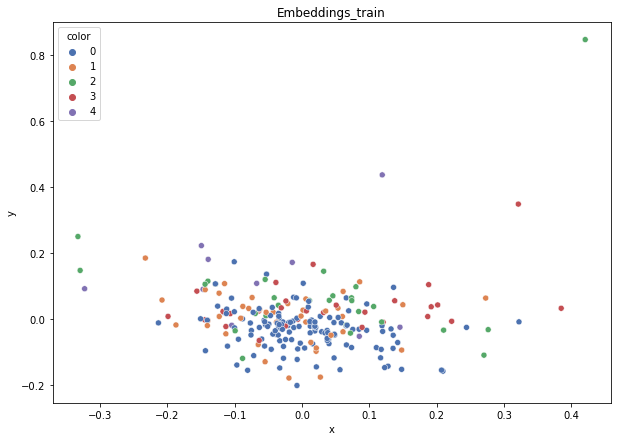

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/discriminant_analysis.py:715: UserWarning: Variables are collinear
  warnings.warn("Variables are collinear")
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/discriminant_analysis.py:715: UserWarning: Variables are collinear
  warnings.warn("Variables are collinear")
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/discriminant_analysis.py:715: UserWarning: Variables are collinear
  warnings.warn("Variables are collinear")


DT-f1-new-features: 0.186
DT-f1-old+new-features: 0.274
DT-f1-old-features: 0.305
DT-gmean-new-features: 0.073
DT-gmean-old+new-features: 0.094
DT-gmean-old-features: 0.112
KNN-f1-new-features: 0.186
KNN-f1-old+new-features: 0.254
KNN-f1-old-features: 0.254
KNN-gmean-new-features: 0.011
KNN-gmean-old+new-features: 0.036
KNN-gmean-old-features: 0.036
LDA-f1-new-features: 0.262
LDA-f1-old+new-features: 0.262
LDA-f1-old-features: 0.287
LDA-gmean-new-features: 0.034
LDA-gmean-old+new-features: 0.079
LDA-gmean-old-features: 0.086
QDA-f1-new-features: 0.321
QDA-f1-old+new-features: 0.172
QDA-f1-old-features: 0.254
QDA-gmean-new-features: 0.105
QDA-gmean-old+new-features: 0.01
QDA-gmean-old-features: 0.032
RF24-f1-new-features: 0.244
RF24-f1-old+new-features: 0.27
RF24-f1-old-features: 0.309
RF24-gmean-new-features: 0.034
RF24-gmean-old+new-features: 0.034
RF24-gmean-old-features: 0.098


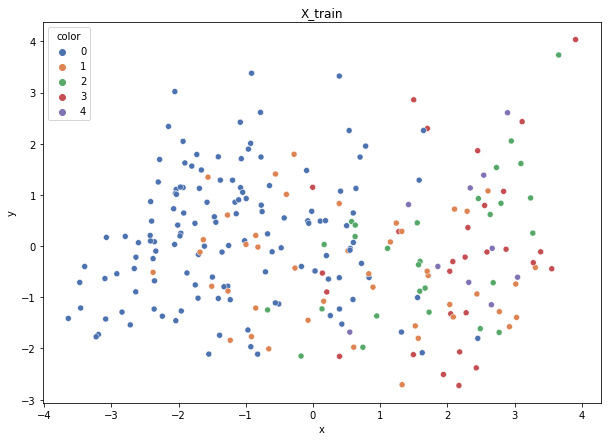

Class cardinalities: Counter({0: 132, 1: 44, 2: 28, 3: 28, 4: 11})
Weights: {2: 0.18539325842696627, 1: 0.11797752808988764, 0: 0.03932584269662921, 3: 0.18539325842696627, 4: 0.47191011235955055}


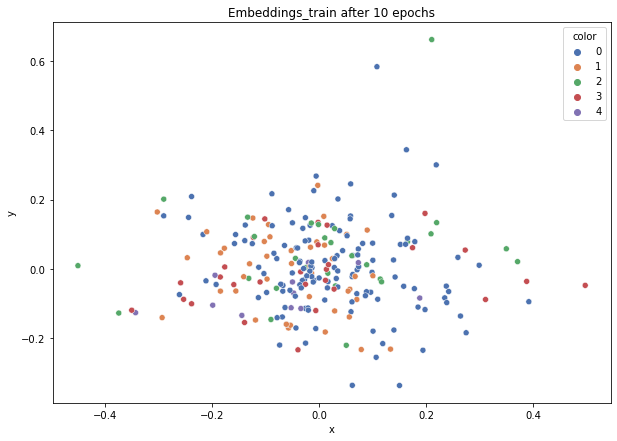

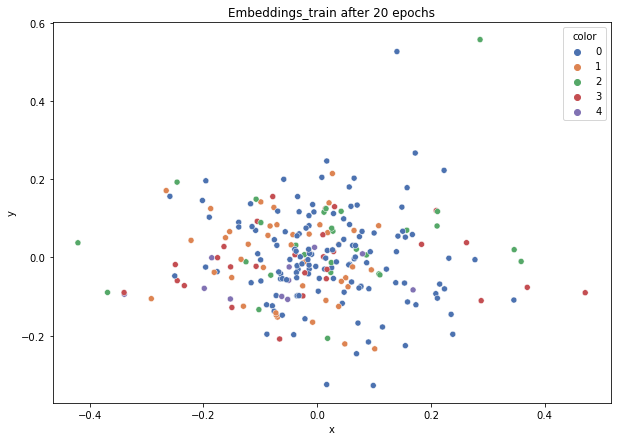

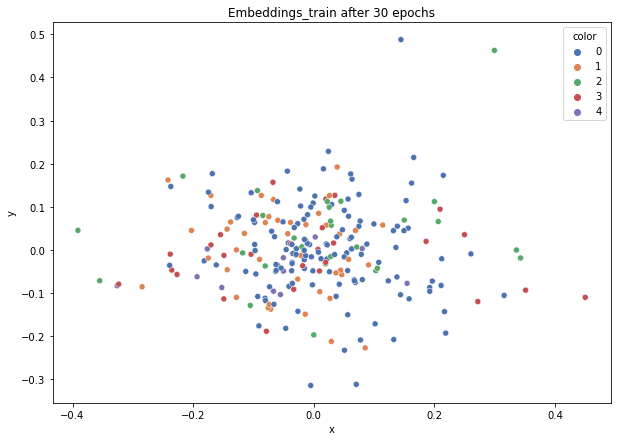

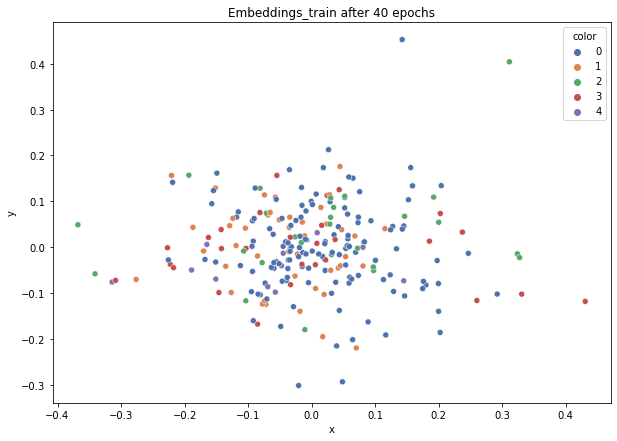

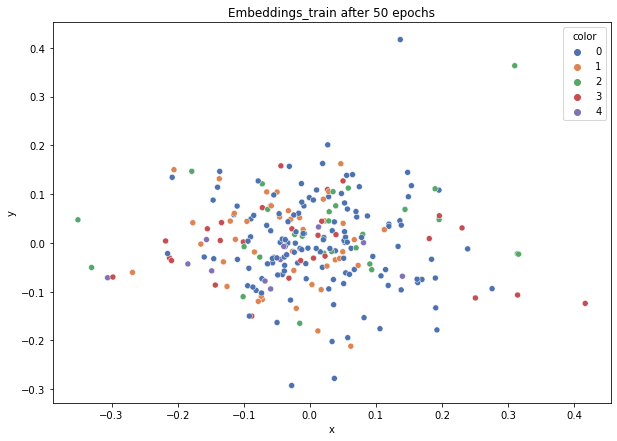

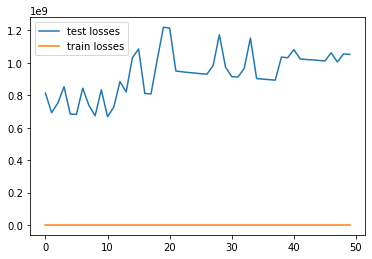

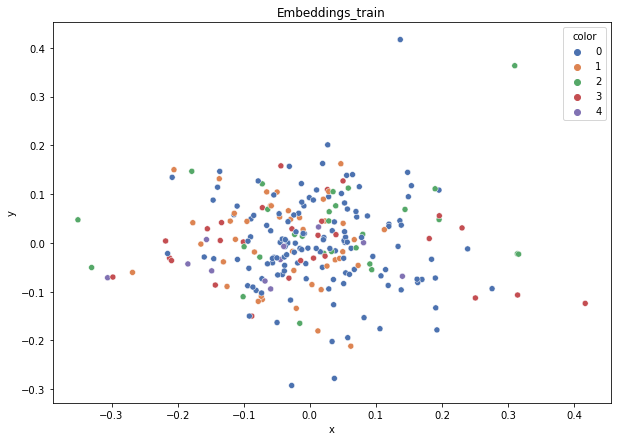

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/discriminant_analysis.py:715: UserWarning: Variables are collinear
  warnings.warn("Variables are collinear")
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/discriminant_analysis.py:715: UserWarning: Variables are collinear
  warnings.warn("Variables are collinear")


DT-f1-new-features: 0.222
DT-f1-old+new-features: 0.433
DT-f1-old-features: 0.227
DT-gmean-new-features: 0.035
DT-gmean-old+new-features: 0.455
DT-gmean-old-features: 0.03
KNN-f1-new-features: 0.383
KNN-f1-old+new-features: 0.302
KNN-f1-old-features: 0.275
KNN-gmean-new-features: 0.121
KNN-gmean-old+new-features: 0.04
KNN-gmean-old-features: 0.035
LDA-f1-new-features: 0.298
LDA-f1-old+new-features: 0.357
LDA-f1-old-features: 0.415
LDA-gmean-new-features: 0.096
LDA-gmean-old+new-features: 0.117
LDA-gmean-old-features: 0.363
QDA-f1-new-features: 0.267
QDA-f1-old+new-features: 0.213
QDA-f1-old-features: 0.268
QDA-gmean-new-features: 0.083
QDA-gmean-old+new-features: 0.012
QDA-gmean-old-features: 0.037
RF24-f1-new-features: 0.321
RF24-f1-old+new-features: 0.228
RF24-f1-old-features: 0.497
RF24-gmean-new-features: 0.098
RF24-gmean-old+new-features: 0.029
RF24-gmean-old-features: 0.452
cleveland_v2


/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/discriminant_analysis.py:715: UserWarning: Variables are collinear
  warnings.warn("Variables are collinear")


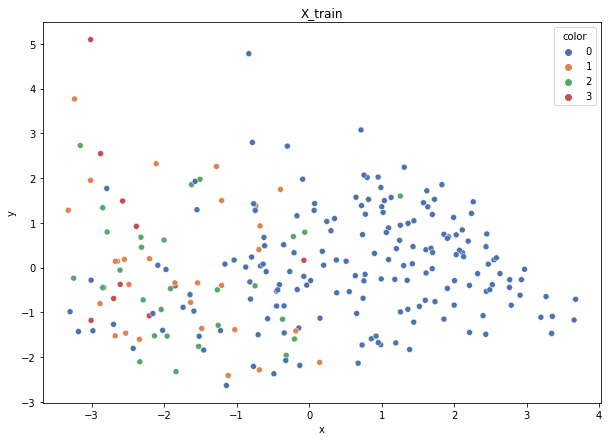

Class cardinalities: Counter({0: 175, 1: 29, 2: 28, 3: 10})
Weights: {0: 0.032483898067768135, 1: 0.19602352282273874, 2: 0.20302436292355083, 3: 0.5684682161859423}


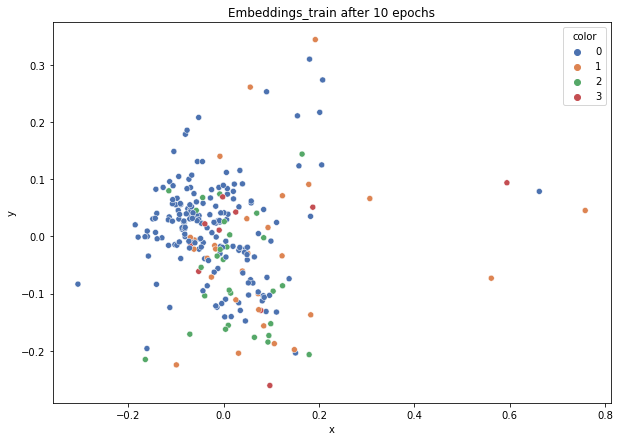

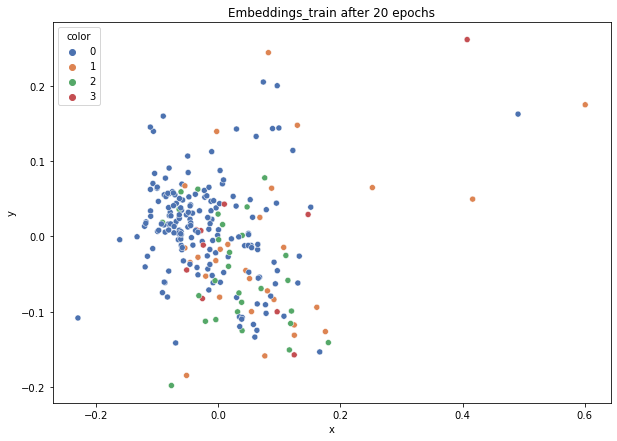

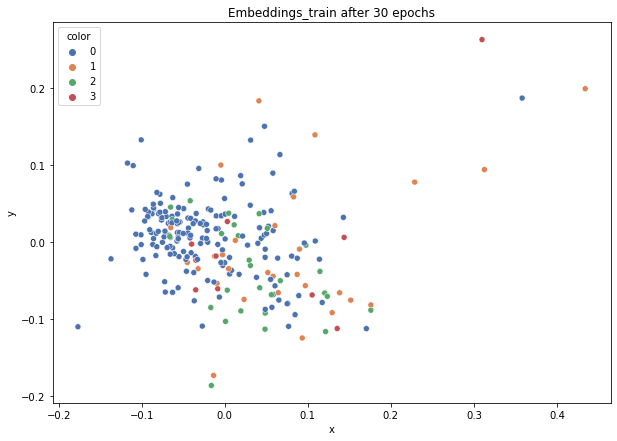

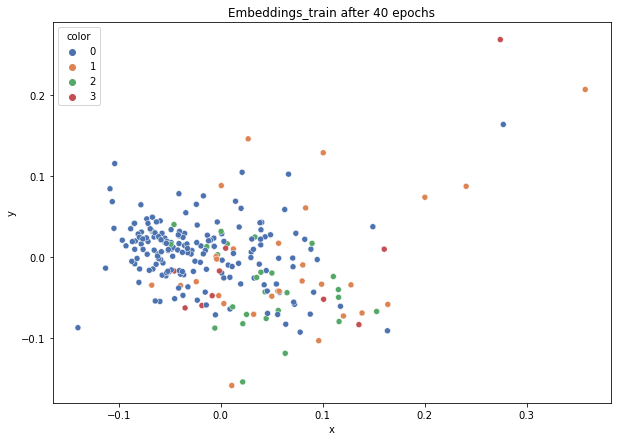

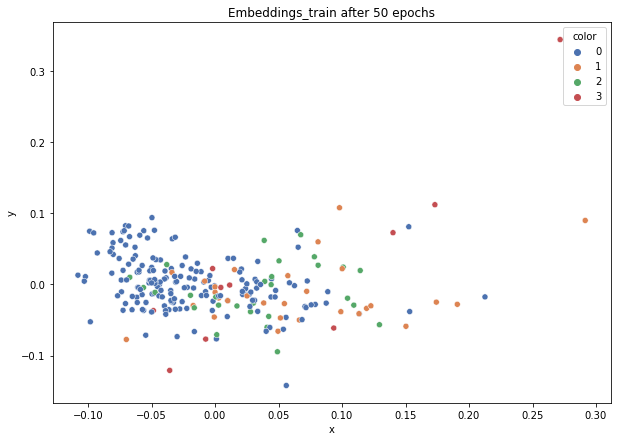

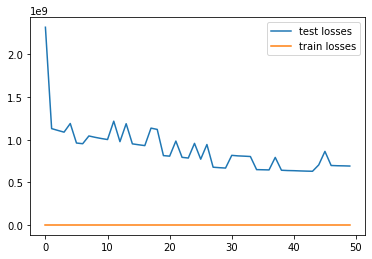

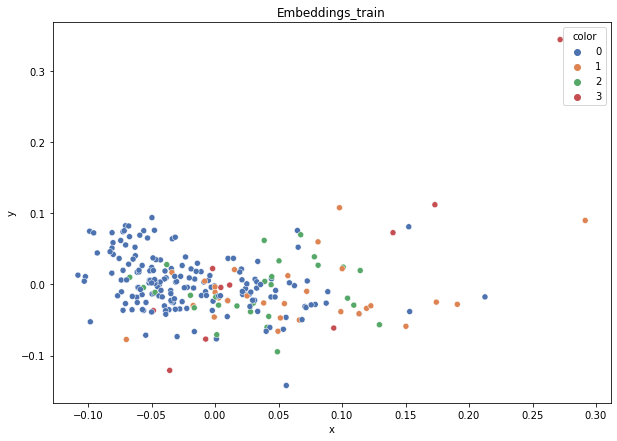

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/discriminant_analysis.py:715: UserWarning: Variables are collinear
  warnings.warn("Variables are collinear")
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/discriminant_analysis.py:715: UserWarning: Variables are collinear
  warnings.warn("Variables are collinear")


DT-f1-new-features: 0.248
DT-f1-old+new-features: 0.354
DT-f1-old-features: 0.358
DT-gmean-new-features: 0.021
DT-gmean-old+new-features: 0.277
DT-gmean-old-features: 0.099
KNN-f1-new-features: 0.393
KNN-f1-old+new-features: 0.232
KNN-f1-old-features: 0.238
KNN-gmean-new-features: 0.279
KNN-gmean-old+new-features: 0.018
KNN-gmean-old-features: 0.018
LDA-f1-new-features: 0.447
LDA-f1-old+new-features: 0.47
LDA-f1-old-features: 0.376
LDA-gmean-new-features: 0.336
LDA-gmean-old+new-features: 0.369
LDA-gmean-old-features: 0.028
QDA-f1-new-features: 0.289
QDA-f1-old+new-features: 0.21
QDA-f1-old-features: 0.394
QDA-gmean-new-features: 0.022
QDA-gmean-old+new-features: 0.006
QDA-gmean-old-features: 0.093
RF24-f1-new-features: 0.346
RF24-f1-old+new-features: 0.342
RF24-f1-old-features: 0.459
RF24-gmean-new-features: 0.078
RF24-gmean-old+new-features: 0.079
RF24-gmean-old-features: 0.121


/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/discriminant_analysis.py:715: UserWarning: Variables are collinear
  warnings.warn("Variables are collinear")


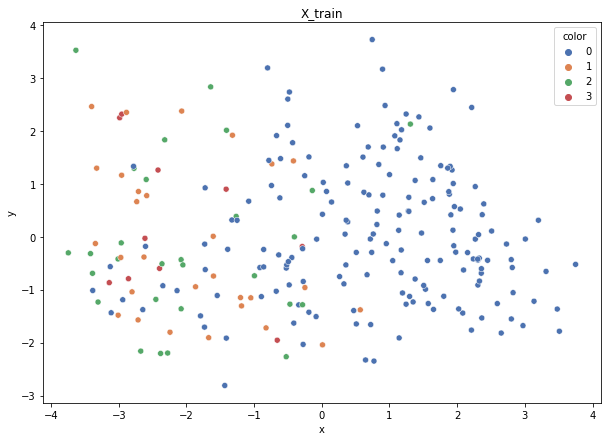

Class cardinalities: Counter({0: 175, 1: 29, 2: 28, 3: 10})
Weights: {0: 0.032483898067768135, 1: 0.19602352282273874, 2: 0.20302436292355083, 3: 0.5684682161859423}


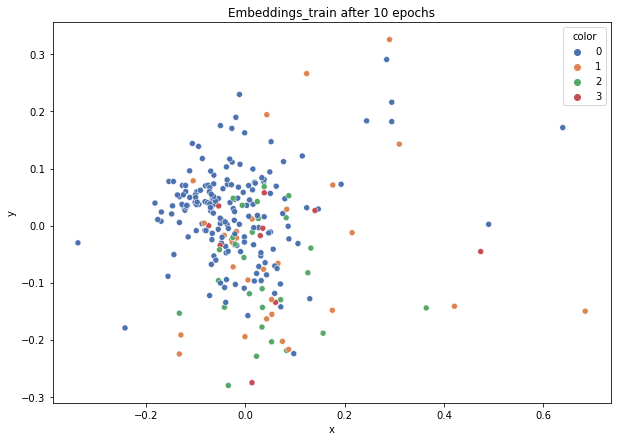

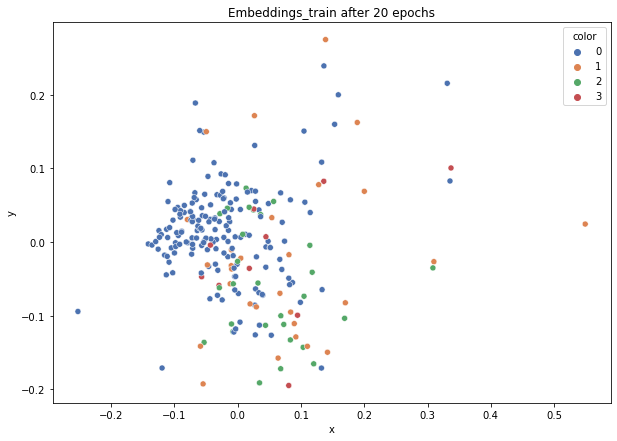

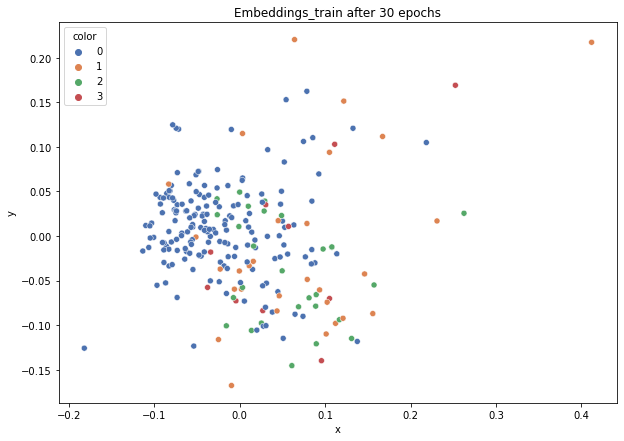

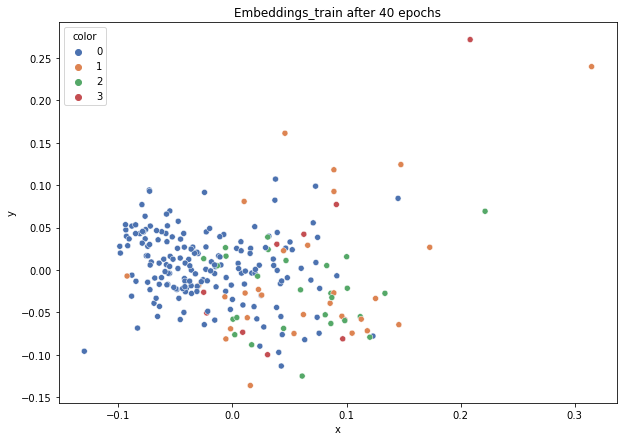

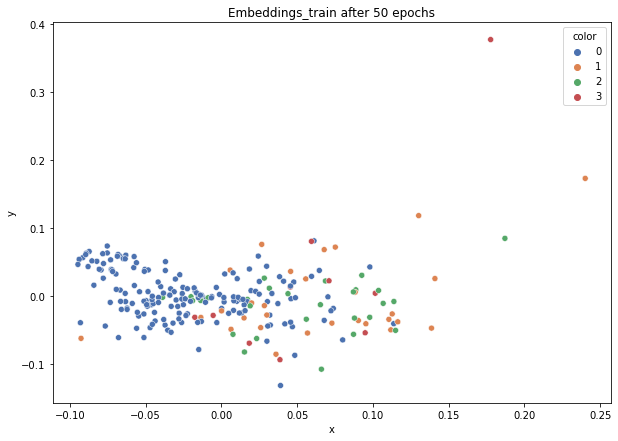

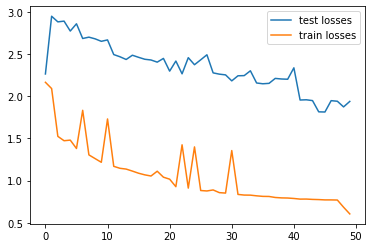

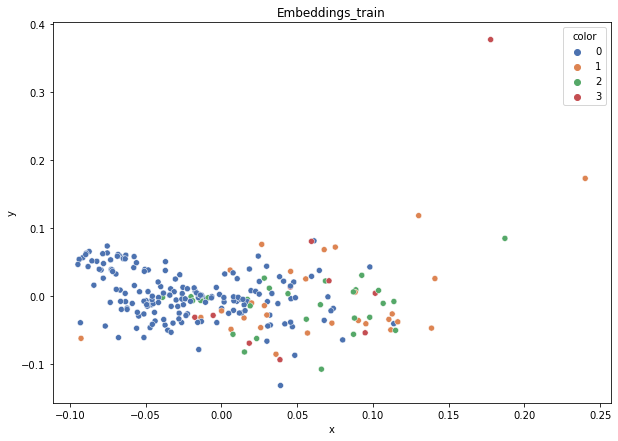

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/discriminant_analysis.py:715: UserWarning: Variables are collinear
  warnings.warn("Variables are collinear")
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/discriminant_analysis.py:715: UserWarning: Variables are collinear
  warnings.warn("Variables are collinear")
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/discriminant_analysis.py:715: UserWarning: Variables are collinear
  warnings.warn("Variables are collinear")


DT-f1-new-features: 0.214
DT-f1-old+new-features: 0.22
DT-f1-old-features: 0.484
DT-gmean-new-features: 0.018
DT-gmean-old+new-features: 0.018
DT-gmean-old-features: 0.546
KNN-f1-new-features: 0.318
KNN-f1-old+new-features: 0.361
KNN-f1-old-features: 0.39
KNN-gmean-new-features: 0.082
KNN-gmean-old+new-features: 0.099
KNN-gmean-old-features: 0.11
LDA-f1-new-features: 0.379
LDA-f1-old+new-features: 0.442
LDA-f1-old-features: 0.344
LDA-gmean-new-features: 0.279
LDA-gmean-old+new-features: 0.389
LDA-gmean-old-features: 0.085
QDA-f1-new-features: 0.254
QDA-f1-old+new-features: 0.21
QDA-f1-old-features: 0.399
QDA-gmean-new-features: 0.019
QDA-gmean-old+new-features: 0.006
QDA-gmean-old-features: 0.11
RF24-f1-new-features: 0.233
RF24-f1-old+new-features: 0.311
RF24-f1-old-features: 0.346
RF24-gmean-new-features: 0.019
RF24-gmean-old+new-features: 0.066
RF24-gmean-old-features: 0.085


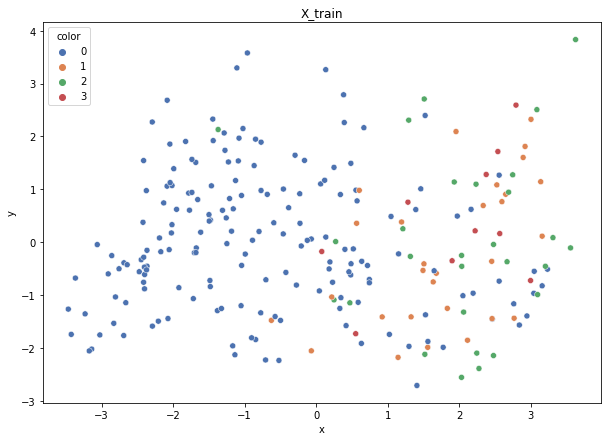

Class cardinalities: Counter({0: 175, 1: 29, 2: 28, 3: 10})
Weights: {0: 0.032483898067768135, 1: 0.19602352282273874, 2: 0.20302436292355083, 3: 0.5684682161859423}


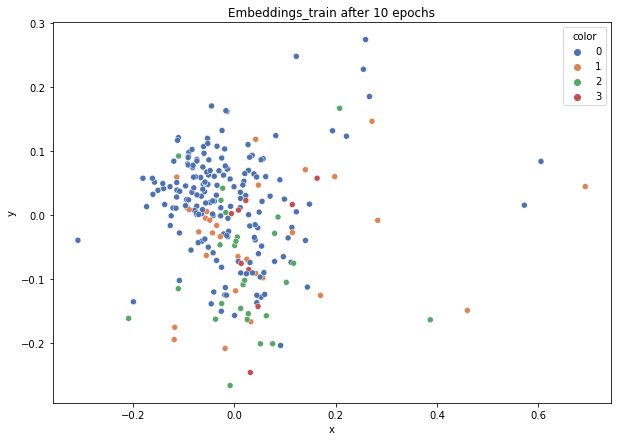

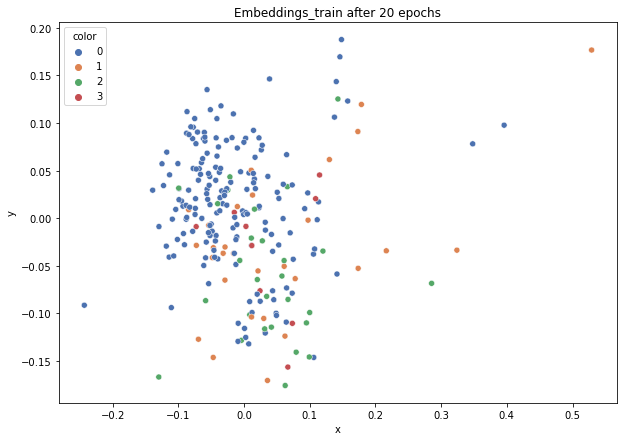

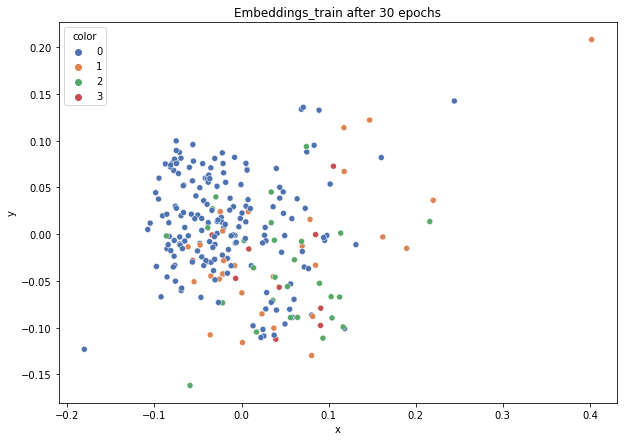

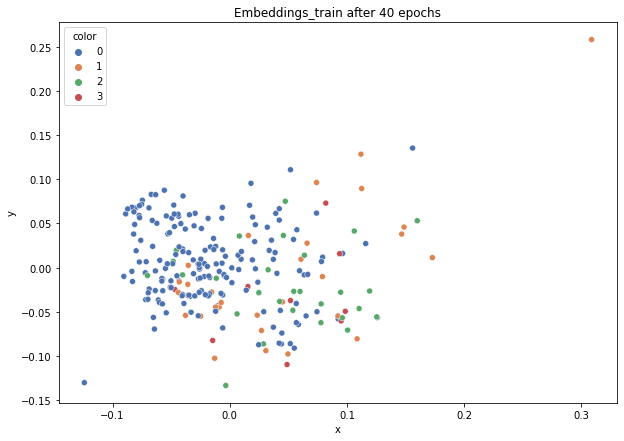

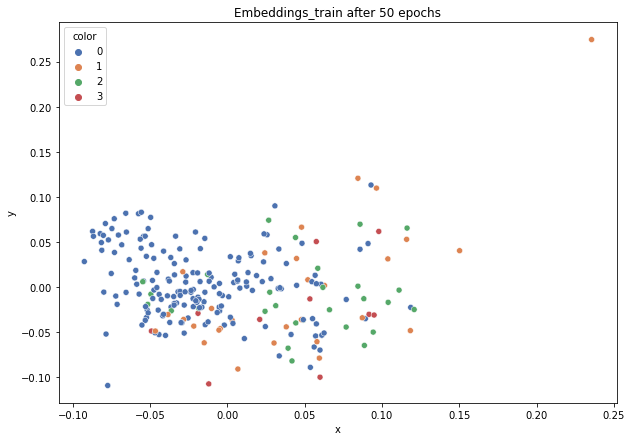

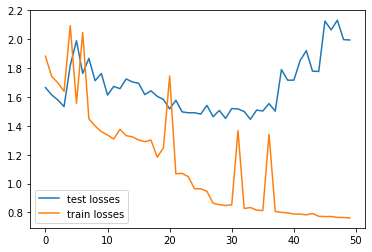

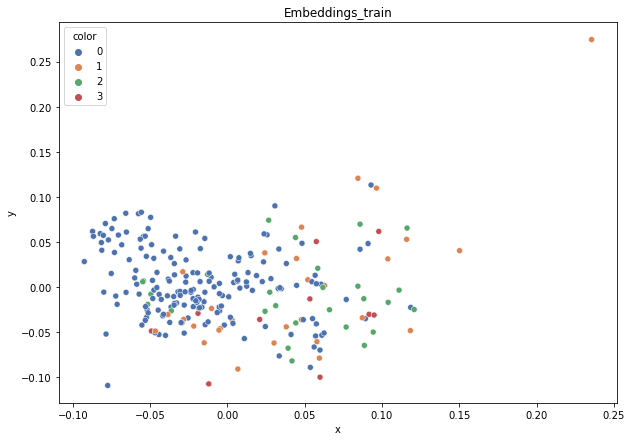

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/discriminant_analysis.py:715: UserWarning: Variables are collinear
  warnings.warn("Variables are collinear")
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/discriminant_analysis.py:715: UserWarning: Variables are collinear
  warnings.warn("Variables are collinear")


DT-f1-new-features: 0.274
DT-f1-old+new-features: 0.338
DT-f1-old-features: 0.295
DT-gmean-new-features: 0.063
DT-gmean-old+new-features: 0.09
DT-gmean-old-features: 0.075
KNN-f1-new-features: 0.385
KNN-f1-old+new-features: 0.356
KNN-f1-old-features: 0.356
KNN-gmean-new-features: 0.087
KNN-gmean-old+new-features: 0.079
KNN-gmean-old-features: 0.079
LDA-f1-new-features: 0.308
LDA-f1-old+new-features: 0.374
LDA-f1-old-features: 0.377
LDA-gmean-new-features: 0.066
LDA-gmean-old+new-features: 0.087
LDA-gmean-old-features: 0.098
QDA-f1-new-features: 0.211
QDA-f1-old+new-features: 0.21
QDA-f1-old-features: 0.351
QDA-gmean-new-features: 0.006
QDA-gmean-old+new-features: 0.006
QDA-gmean-old-features: 0.079
RF24-f1-new-features: 0.311
RF24-f1-old+new-features: 0.268
RF24-f1-old-features: 0.257
RF24-gmean-new-features: 0.023
RF24-gmean-old+new-features: 0.019
RF24-gmean-old-features: 0.019


/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/discriminant_analysis.py:715: UserWarning: Variables are collinear
  warnings.warn("Variables are collinear")


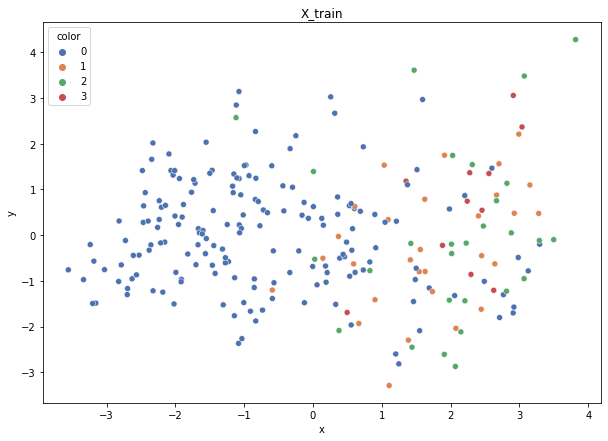

Class cardinalities: Counter({0: 175, 1: 29, 2: 28, 3: 11})
Weights: {1: 0.20670586024536255, 0: 0.03425411398351722, 2: 0.21408821239698264, 3: 0.5449518133741377}


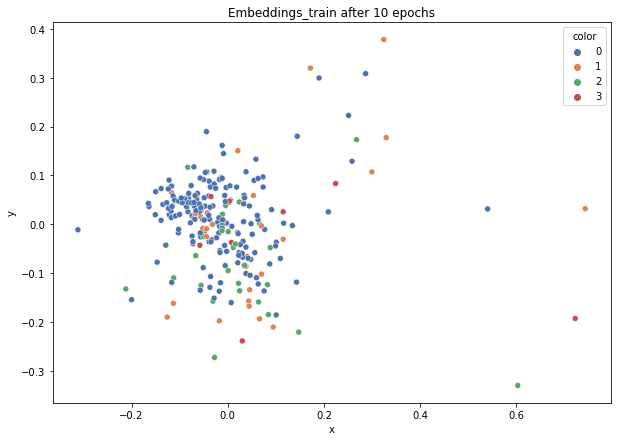

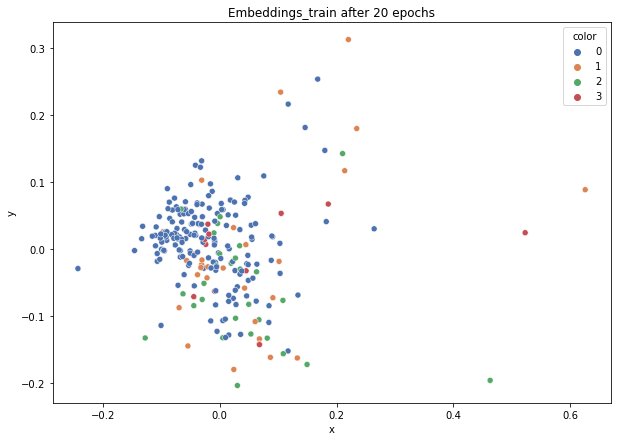

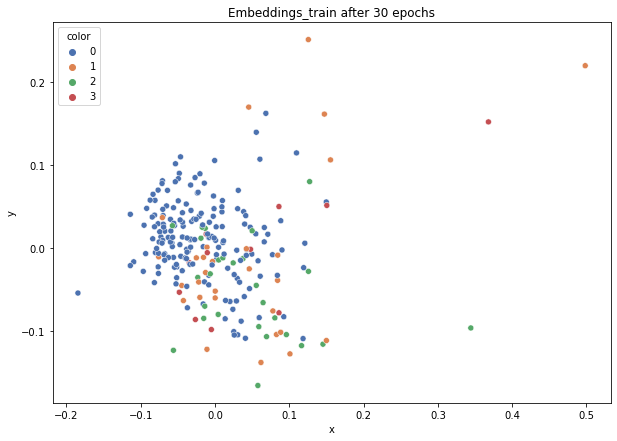

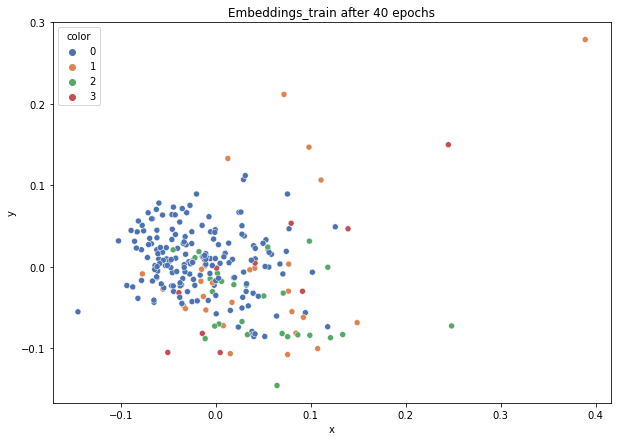

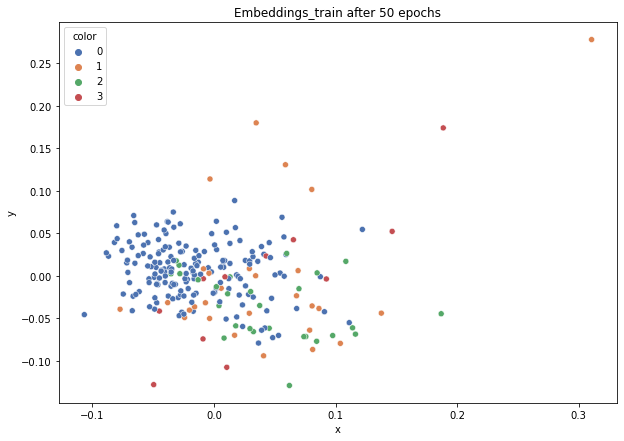

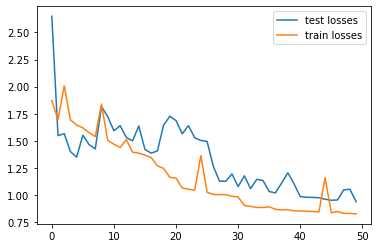

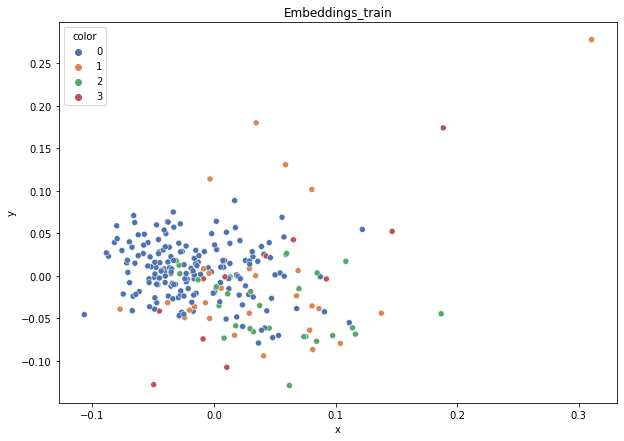

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/discriminant_analysis.py:715: UserWarning: Variables are collinear
  warnings.warn("Variables are collinear")
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/discriminant_analysis.py:715: UserWarning: Variables are collinear
  warnings.warn("Variables are collinear")


DT-f1-new-features: 0.345
DT-f1-old+new-features: 0.304
DT-f1-old-features: 0.238
DT-gmean-new-features: 0.084
DT-gmean-old+new-features: 0.074
DT-gmean-old-features: 0.018
KNN-f1-new-features: 0.437
KNN-f1-old+new-features: 0.283
KNN-f1-old-features: 0.283
KNN-gmean-new-features: 0.114
KNN-gmean-old+new-features: 0.022
KNN-gmean-old-features: 0.022
LDA-f1-new-features: 0.389
LDA-f1-old+new-features: 0.316
LDA-f1-old-features: 0.301
LDA-gmean-new-features: 0.094
LDA-gmean-old+new-features: 0.066
LDA-gmean-old-features: 0.023
QDA-f1-new-features: 0.257
QDA-f1-old+new-features: 0.212
QDA-f1-old-features: 0.413
QDA-gmean-new-features: 0.019
QDA-gmean-old+new-features: 0.006
QDA-gmean-old-features: 0.095
RF24-f1-new-features: 0.322
RF24-f1-old+new-features: 0.367
RF24-f1-old-features: 0.428
RF24-gmean-new-features: 0.023
RF24-gmean-old+new-features: 0.079
RF24-gmean-old-features: 0.104


/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/discriminant_analysis.py:715: UserWarning: Variables are collinear
  warnings.warn("Variables are collinear")


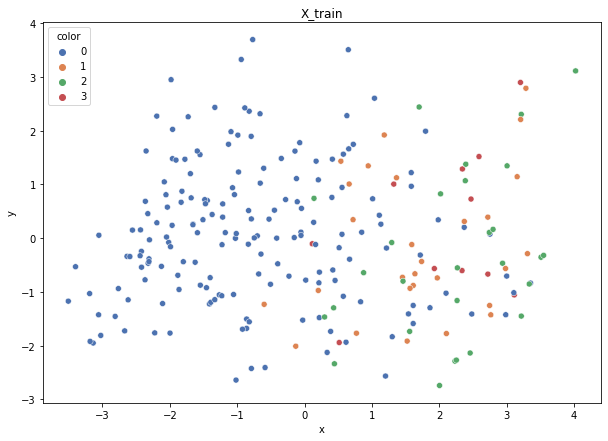

Class cardinalities: Counter({0: 176, 1: 28, 2: 28, 3: 11})
Weights: {0: 0.03381642512077295, 1: 0.21256038647342995, 2: 0.21256038647342995, 3: 0.5410628019323672}


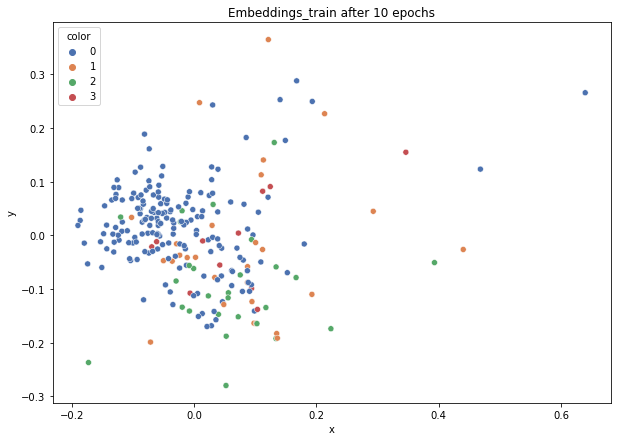

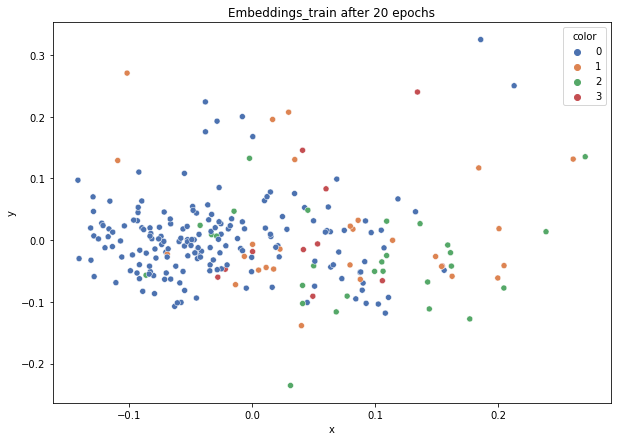

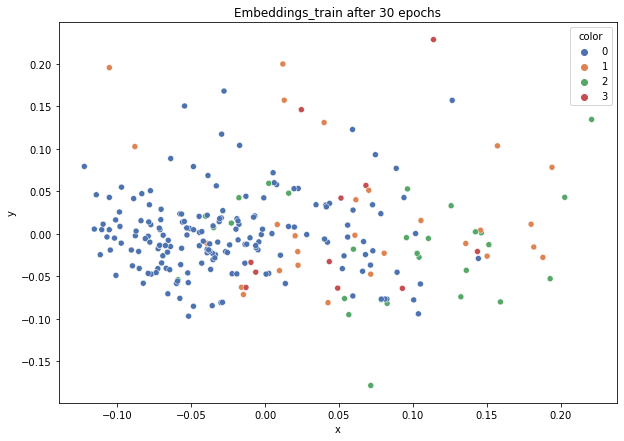

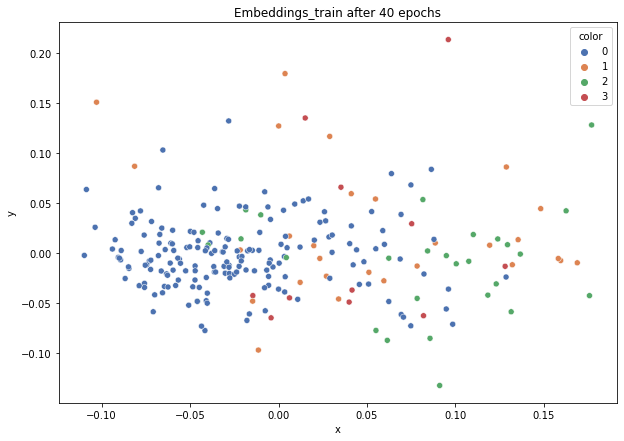

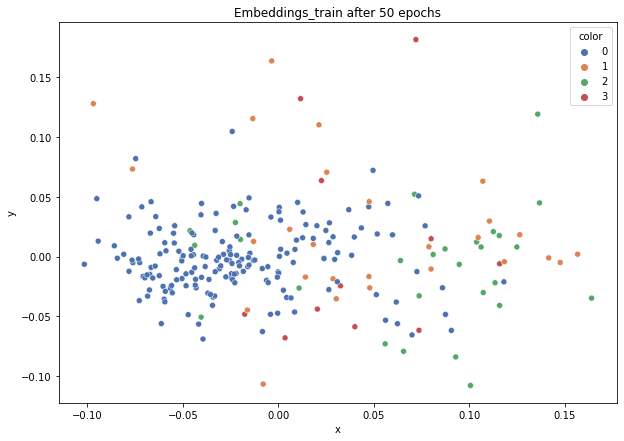

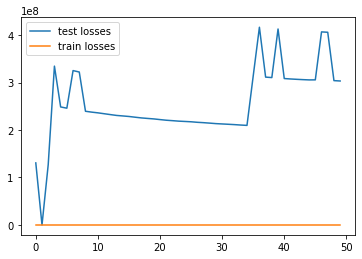

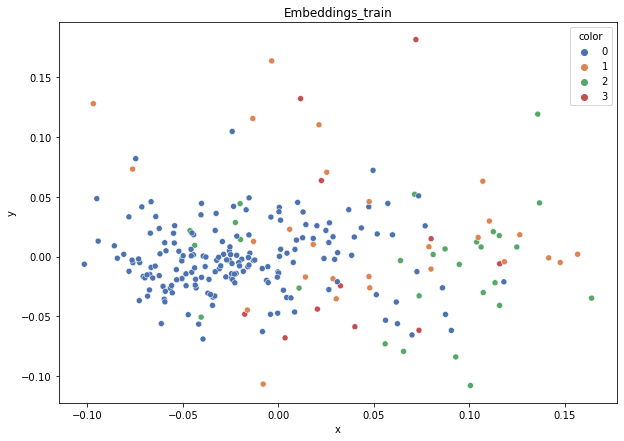

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/discriminant_analysis.py:715: UserWarning: Variables are collinear
  warnings.warn("Variables are collinear")
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/discriminant_analysis.py:715: UserWarning: Variables are collinear
  warnings.warn("Variables are collinear")
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/discriminant_analysis.py:715: UserWarning: Variables are collinear
  warnings.warn("Variables are collinear")


DT-f1-new-features: 0.266
DT-f1-old+new-features: 0.278
DT-f1-old-features: 0.335
DT-gmean-new-features: 0.075
DT-gmean-old+new-features: 0.07
DT-gmean-old-features: 0.092
KNN-f1-new-features: 0.367
KNN-f1-old+new-features: 0.37
KNN-f1-old-features: 0.37
KNN-gmean-new-features: 0.096
KNN-gmean-old+new-features: 0.096
KNN-gmean-old-features: 0.096
LDA-f1-new-features: 0.309
LDA-f1-old+new-features: 0.342
LDA-f1-old-features: 0.467
LDA-gmean-new-features: 0.086
LDA-gmean-old+new-features: 0.081
LDA-gmean-old-features: 0.463
QDA-f1-new-features: 0.407
QDA-f1-old+new-features: 0.209
QDA-f1-old-features: 0.301
QDA-gmean-new-features: 0.106
QDA-gmean-old+new-features: 0.006
QDA-gmean-old-features: 0.074
RF24-f1-new-features: 0.286
RF24-f1-old+new-features: 0.254
RF24-f1-old-features: 0.29
RF24-gmean-new-features: 0.063
RF24-gmean-old+new-features: 0.018
RF24-gmean-old-features: 0.022
glass


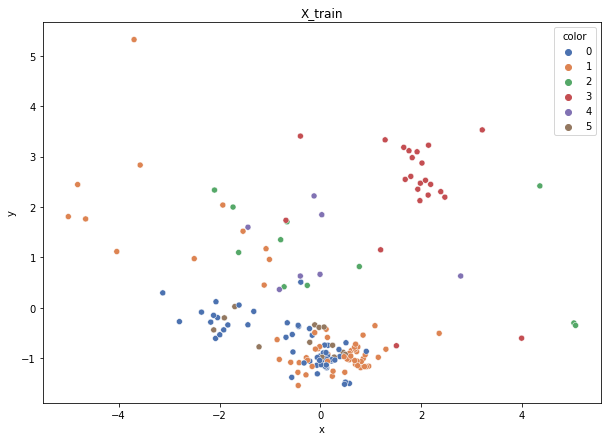

Class cardinalities: Counter({1: 61, 0: 56, 3: 23, 5: 13, 2: 11, 4: 7})
Weights: {0: 0.04597401674853029, 1: 0.042205654719962245, 3: 0.1119367364312042, 5: 0.1980419183013613, 2: 0.2340495398106997, 4: 0.36779213398824234}


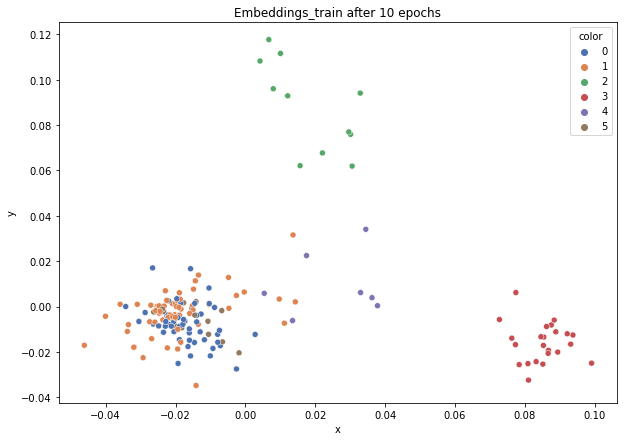

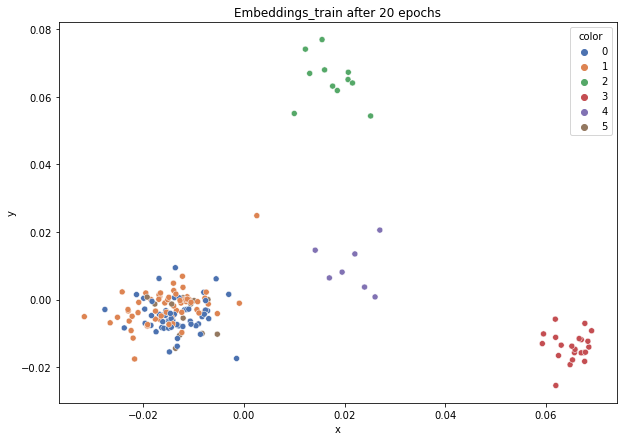

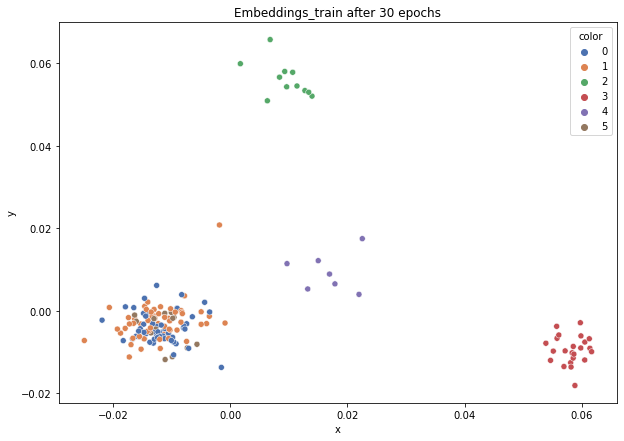

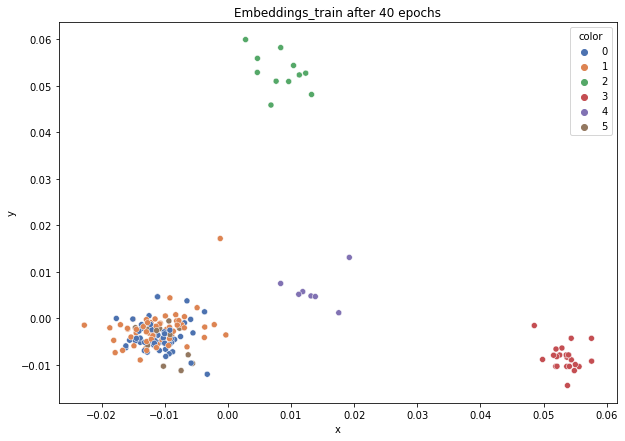

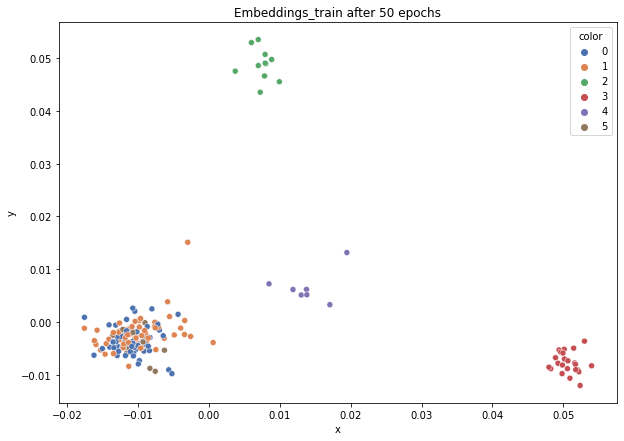

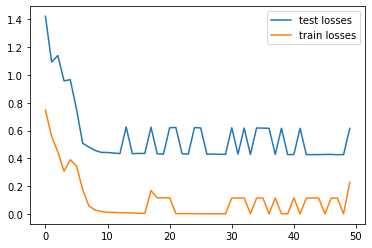

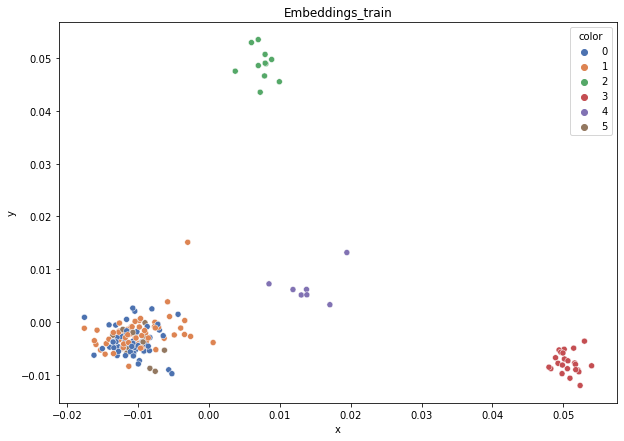

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/discriminant_analysis.py:715: UserWarning: Variables are collinear
  warnings.warn("Variables are collinear")
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/discriminant_analysis.py:715: UserWarning: Variables are collinear
  warnings.warn("Variables are collinear")
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/discriminant_analysis.py:715: UserWarning: Variables are collinear
  warnings.warn("Variables are collinear")


DT-f1-new-features: 0.468
DT-f1-old+new-features: 0.474
DT-f1-old-features: 0.711
DT-gmean-new-features: 0.188
DT-gmean-old+new-features: 0.183
DT-gmean-old-features: 0.742
KNN-f1-new-features: 0.689
KNN-f1-old+new-features: 0.747
KNN-f1-old-features: 0.747
KNN-gmean-new-features: 0.676
KNN-gmean-old+new-features: 0.701
KNN-gmean-old-features: 0.701
LDA-f1-new-features: 0.728
LDA-f1-old+new-features: 0.689
LDA-f1-old-features: 0.551
LDA-gmean-new-features: 0.707
LDA-gmean-old+new-features: 0.676
LDA-gmean-old-features: 0.088
QDA-f1-new-features: 0.321
QDA-f1-old+new-features: 0.307
QDA-f1-old-features: 0.388
QDA-gmean-new-features: 0.026
QDA-gmean-old+new-features: 0.025
QDA-gmean-old-features: 0.065
RF24-f1-new-features: 0.684
RF24-f1-old+new-features: 0.696
RF24-f1-old-features: 0.786
RF24-gmean-new-features: 0.656
RF24-gmean-old+new-features: 0.669
RF24-gmean-old-features: 0.742


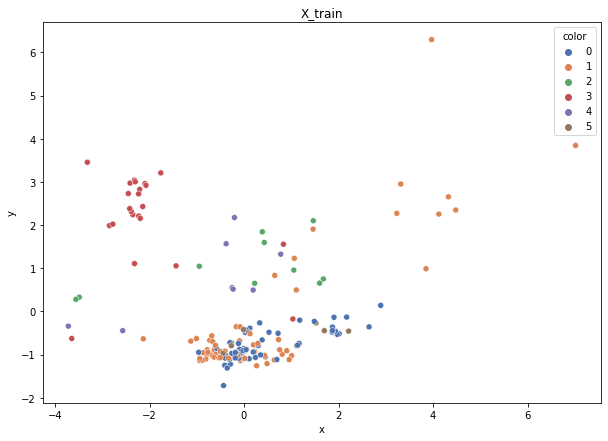

Class cardinalities: Counter({1: 60, 0: 56, 3: 24, 5: 13, 2: 10, 4: 8})
Weights: {5: 0.2034390893678857, 4: 0.33058852022281426, 1: 0.0440784693630419, 0: 0.047226931460402036, 3: 0.11019617340760475, 2: 0.2644708161782514}


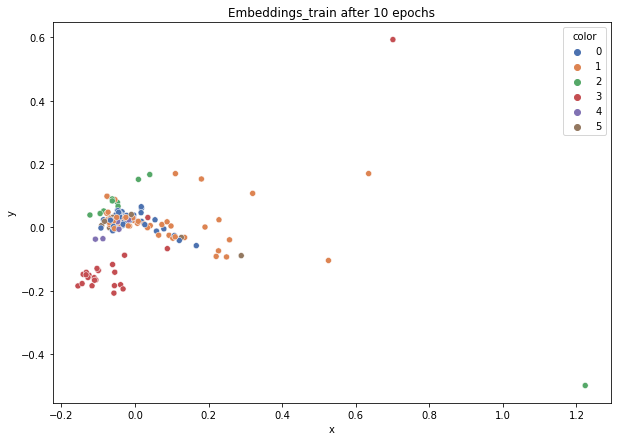

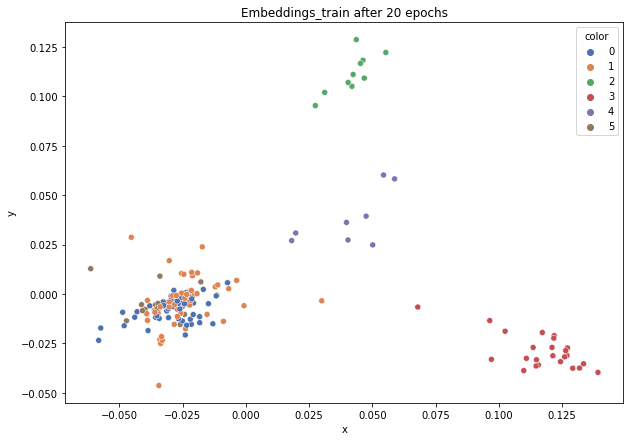

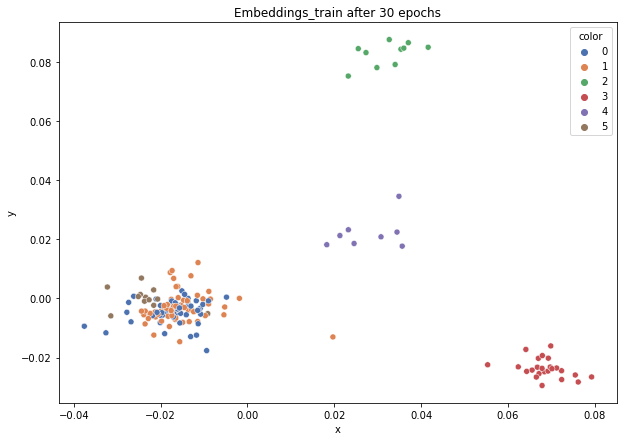

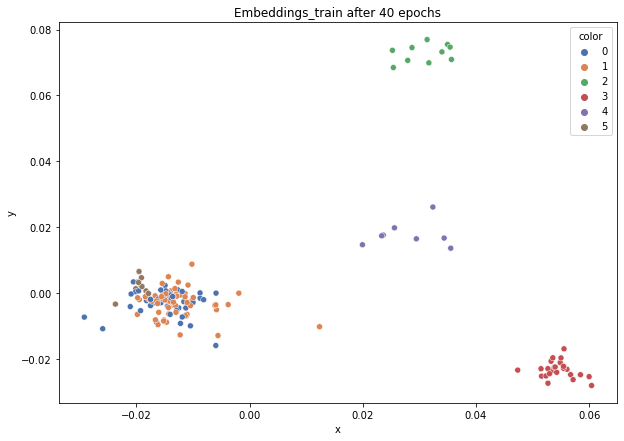

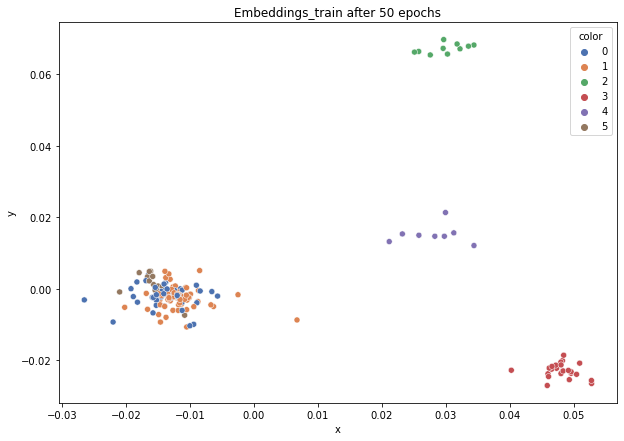

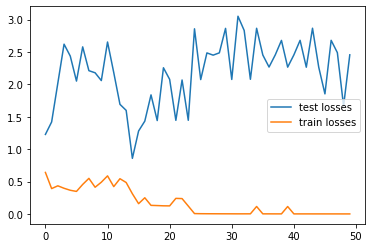

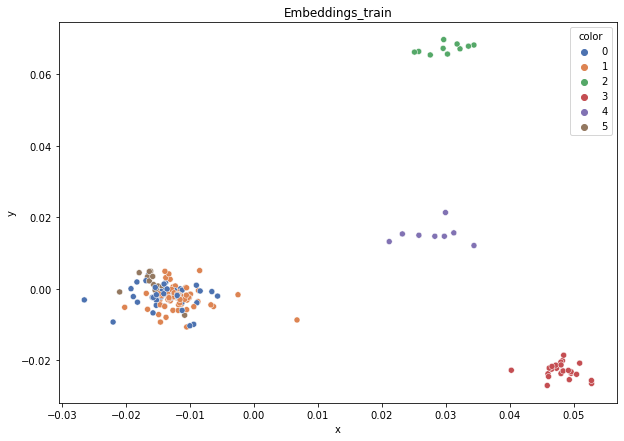

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/discriminant_analysis.py:715: UserWarning: Variables are collinear
  warnings.warn("Variables are collinear")
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/discriminant_analysis.py:715: UserWarning: Variables are collinear
  warnings.warn("Variables are collinear")
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/discriminant_analysis.py:715: UserWarning: Variables are collinear
  warnings.warn("Variables are collinear")


DT-f1-new-features: 0.347
DT-f1-old+new-features: 0.283
DT-f1-old-features: 0.53
DT-gmean-new-features: 0.061
DT-gmean-old+new-features: 0.057
DT-gmean-old-features: 0.232
KNN-f1-new-features: 0.527
KNN-f1-old+new-features: 0.568
KNN-f1-old-features: 0.568
KNN-gmean-new-features: 0.214
KNN-gmean-old+new-features: 0.557
KNN-gmean-old-features: 0.557
LDA-f1-new-features: 0.547
LDA-f1-old+new-features: 0.576
LDA-f1-old-features: 0.425
LDA-gmean-new-features: 0.236
LDA-gmean-old+new-features: 0.249
LDA-gmean-old-features: 0.072
QDA-f1-new-features: 0.35
QDA-f1-old+new-features: 0.363
QDA-f1-old-features: 0.369
QDA-gmean-new-features: 0.027
QDA-gmean-old+new-features: 0.027
QDA-gmean-old-features: 0.06
RF24-f1-new-features: 0.529
RF24-f1-old+new-features: 0.578
RF24-f1-old-features: 0.652
RF24-gmean-new-features: 0.181
RF24-gmean-old+new-features: 0.231
RF24-gmean-old-features: 0.279


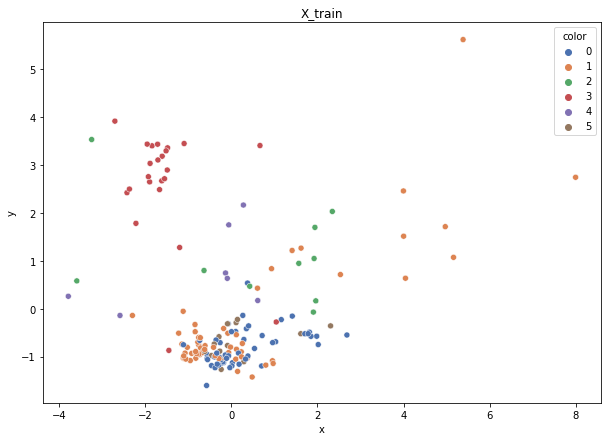

Class cardinalities: Counter({1: 61, 0: 56, 3: 23, 5: 14, 2: 10, 4: 7})
Weights: {0: 0.04555224384573926, 5: 0.18220897538295705, 4: 0.3644179507659141, 1: 0.04181845336658031, 3: 0.11090981110266952, 2: 0.2550925655361399}


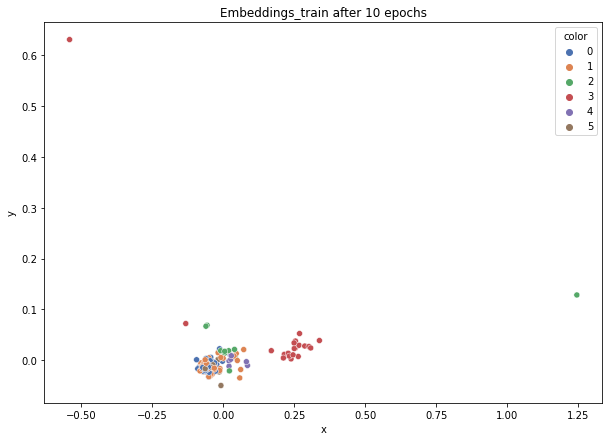

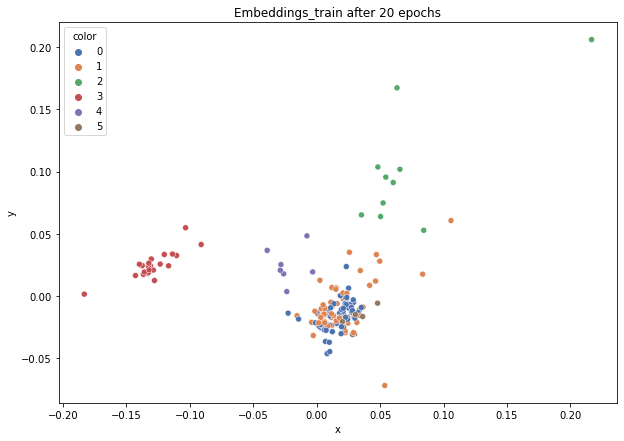

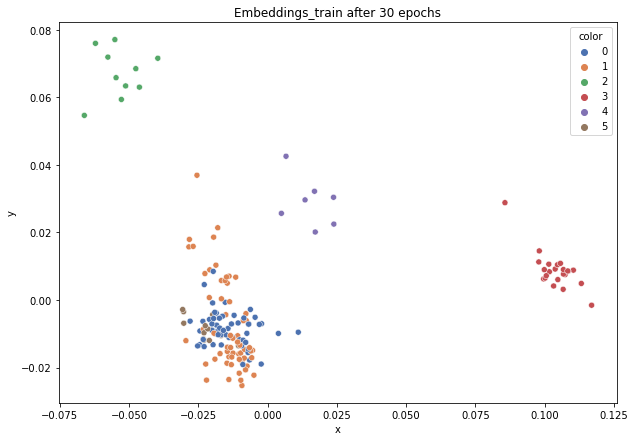

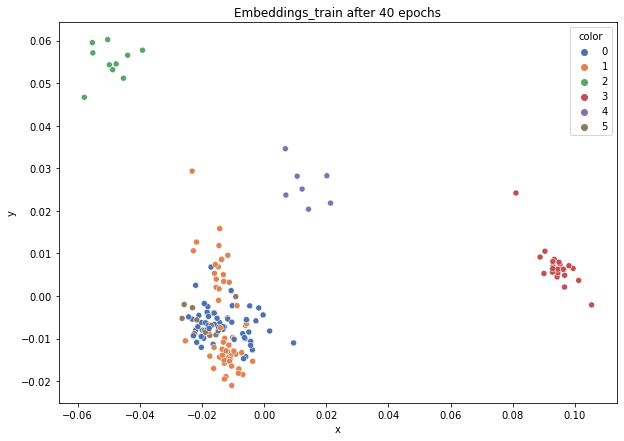

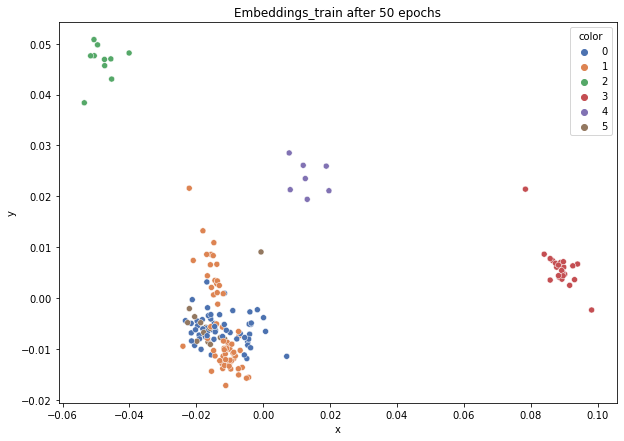

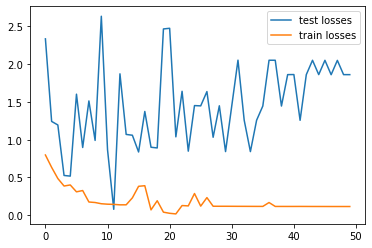

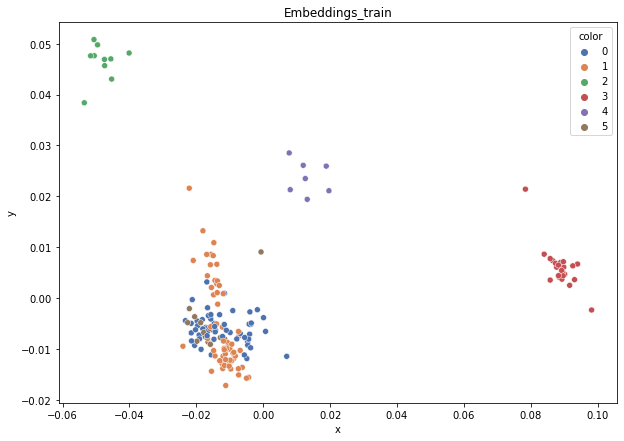

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/discriminant_analysis.py:715: UserWarning: Variables are collinear
  warnings.warn("Variables are collinear")
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/discriminant_analysis.py:715: UserWarning: Variables are collinear
  warnings.warn("Variables are collinear")
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/discriminant_analysis.py:715: UserWarning: Variables are collinear
  warnings.warn("Variables are collinear")


DT-f1-new-features: 0.531
DT-f1-old+new-features: 0.525
DT-f1-old-features: 0.607
DT-gmean-new-features: 0.204
DT-gmean-old+new-features: 0.214
DT-gmean-old-features: 0.25
KNN-f1-new-features: 0.589
KNN-f1-old+new-features: 0.661
KNN-f1-old-features: 0.661
KNN-gmean-new-features: 0.24
KNN-gmean-old+new-features: 0.246
KNN-gmean-old-features: 0.246
LDA-f1-new-features: 0.54
LDA-f1-old+new-features: 0.576
LDA-f1-old-features: 0.575
LDA-gmean-new-features: 0.534
LDA-gmean-old+new-features: 0.574
LDA-gmean-old-features: 0.233
QDA-f1-new-features: 0.339
QDA-f1-old+new-features: 0.37
QDA-f1-old-features: 0.587
QDA-gmean-new-features: 0.027
QDA-gmean-old+new-features: 0.028
QDA-gmean-old-features: 0.526
RF24-f1-new-features: 0.605
RF24-f1-old+new-features: 0.628
RF24-f1-old-features: 0.731
RF24-gmean-new-features: 0.599
RF24-gmean-old+new-features: 0.589
RF24-gmean-old-features: 0.281


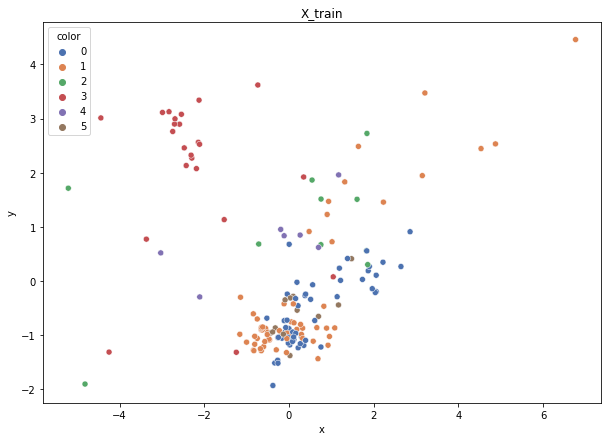

Class cardinalities: Counter({1: 61, 0: 56, 3: 23, 5: 14, 2: 10, 4: 7})
Weights: {0: 0.04555224384573926, 5: 0.18220897538295705, 4: 0.3644179507659141, 1: 0.04181845336658031, 3: 0.11090981110266952, 2: 0.2550925655361399}


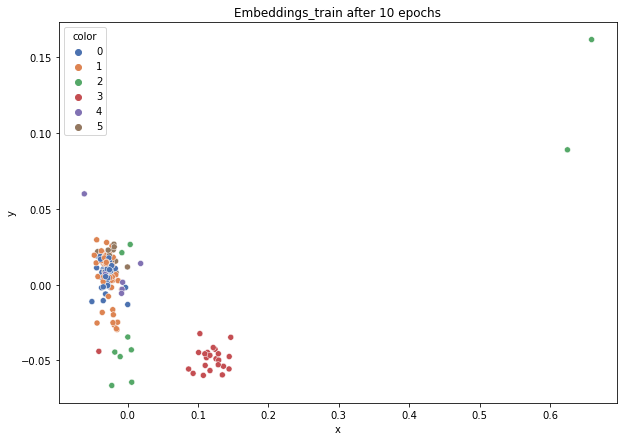

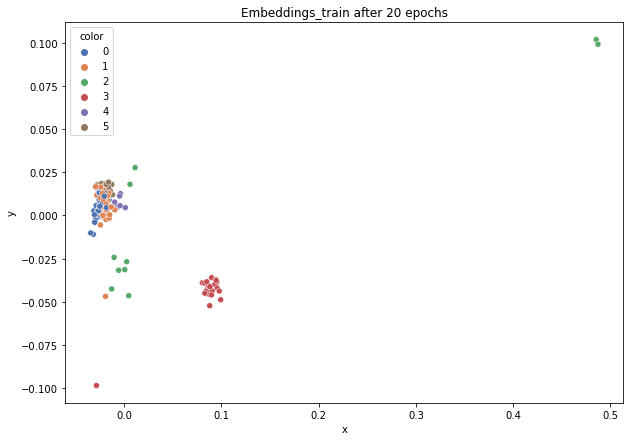

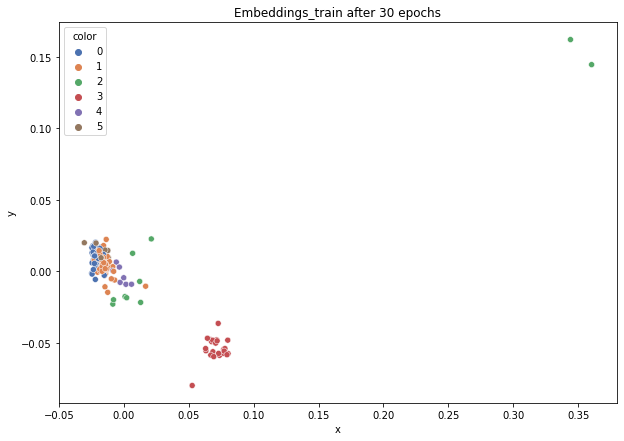

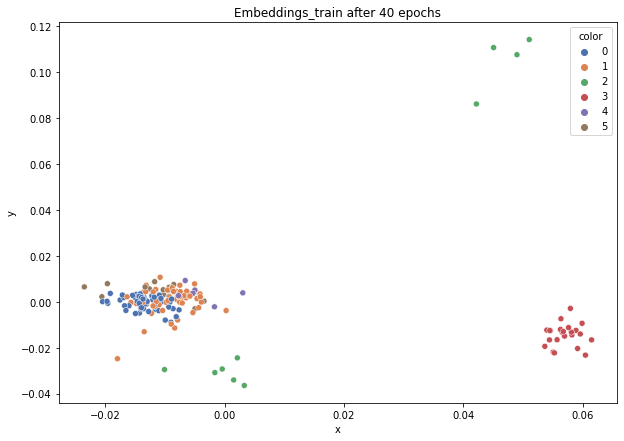

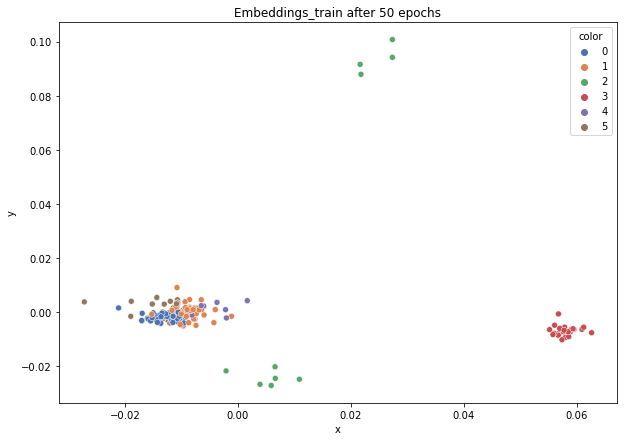

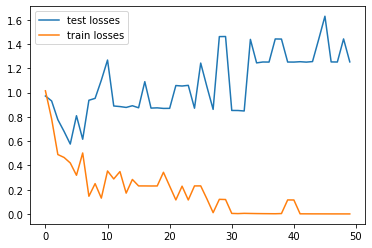

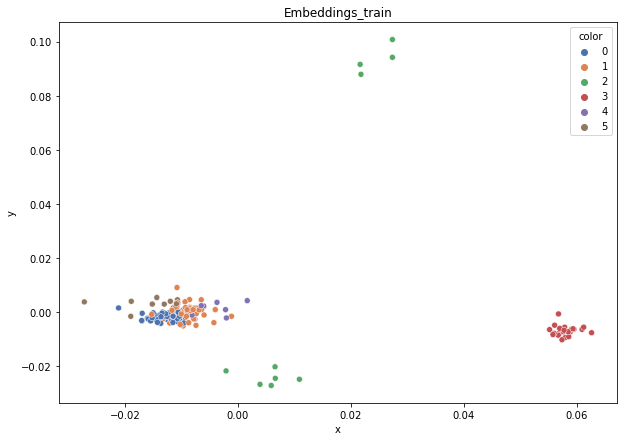

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/discriminant_analysis.py:715: UserWarning: Variables are collinear
  warnings.warn("Variables are collinear")
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/discriminant_analysis.py:715: UserWarning: Variables are collinear
  warnings.warn("Variables are collinear")
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/discriminant_analysis.py:715: UserWarning: Variables are collinear
  warnings.warn("Variables are collinear")


DT-f1-new-features: 0.532
DT-f1-old+new-features: 0.626
DT-f1-old-features: 0.646
DT-gmean-new-features: 0.514
DT-gmean-old+new-features: 0.595
DT-gmean-old-features: 0.681
KNN-f1-new-features: 0.601
KNN-f1-old+new-features: 0.641
KNN-f1-old-features: 0.641
KNN-gmean-new-features: 0.567
KNN-gmean-old+new-features: 0.587
KNN-gmean-old-features: 0.587
LDA-f1-new-features: 0.582
LDA-f1-old+new-features: 0.534
LDA-f1-old-features: 0.517
LDA-gmean-new-features: 0.563
LDA-gmean-old+new-features: 0.501
LDA-gmean-old-features: 0.196
QDA-f1-new-features: 0.36
QDA-f1-old+new-features: 0.266
QDA-f1-old-features: 0.571
QDA-gmean-new-features: 0.027
QDA-gmean-old+new-features: 0.023
QDA-gmean-old-features: 0.219
RF24-f1-new-features: 0.453
RF24-f1-old+new-features: 0.527
RF24-f1-old-features: 0.776
RF24-gmean-new-features: 0.192
RF24-gmean-old+new-features: 0.542
RF24-gmean-old-features: 0.748


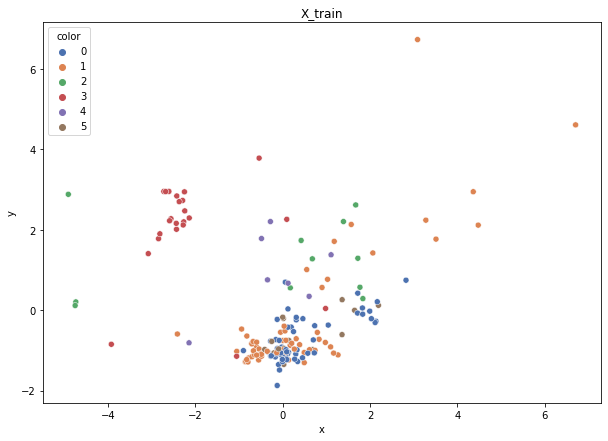

Class cardinalities: Counter({1: 61, 0: 56, 3: 23, 5: 14, 2: 11, 4: 7})
Weights: {0: 0.04663368999308034, 5: 0.18653475997232136, 4: 0.3730695199446427, 1: 0.04281125638709015, 3: 0.11354289737445648, 2: 0.237407876328409}


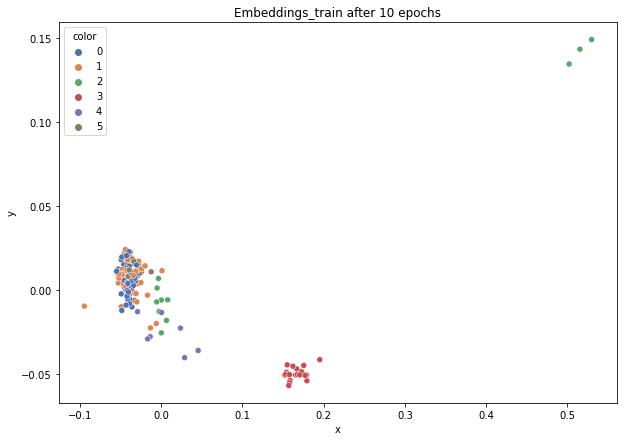

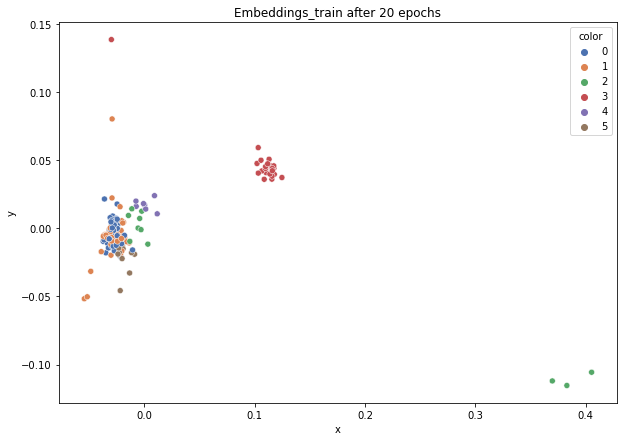

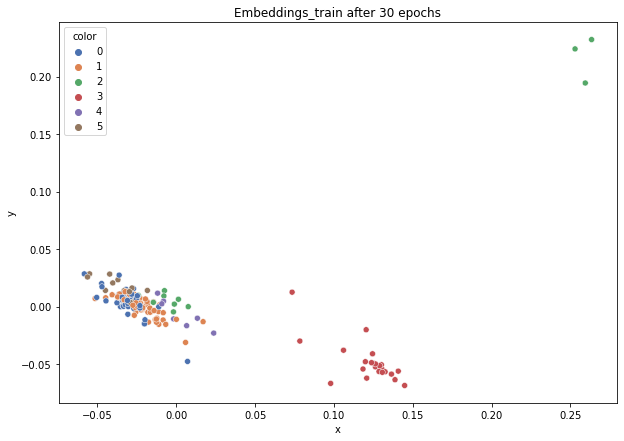

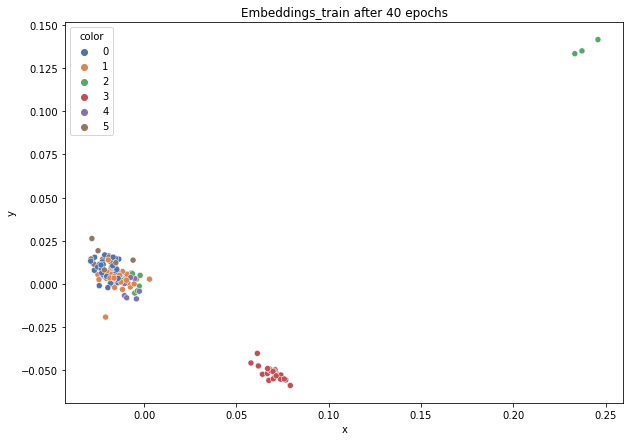

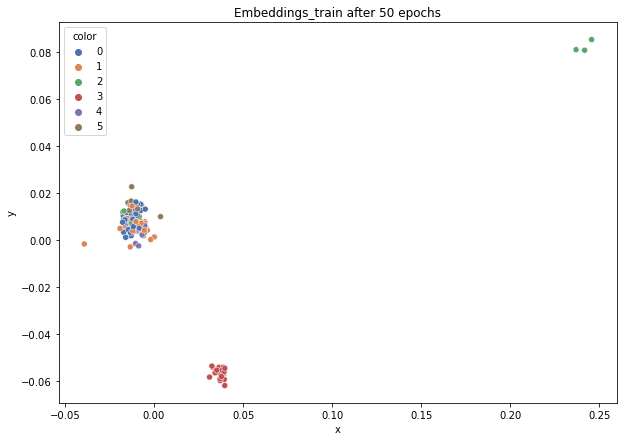

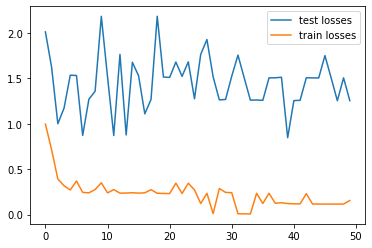

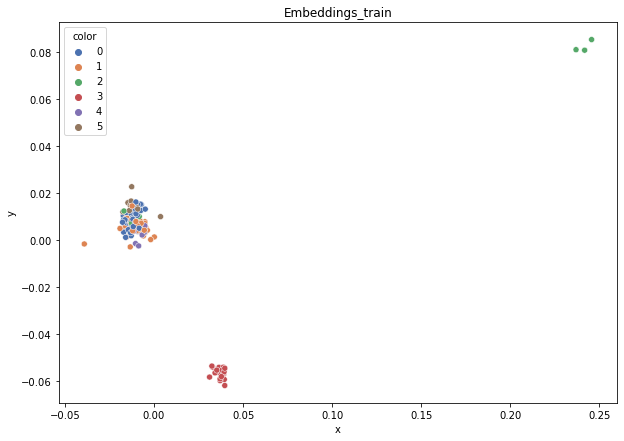

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/discriminant_analysis.py:715: UserWarning: Variables are collinear
  warnings.warn("Variables are collinear")
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/discriminant_analysis.py:715: UserWarning: Variables are collinear
  warnings.warn("Variables are collinear")
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/discriminant_analysis.py:715: UserWarning: Variables are collinear
  warnings.warn("Variables are collinear")


DT-f1-new-features: 0.429
DT-f1-old+new-features: 0.401
DT-f1-old-features: 0.73
DT-gmean-new-features: 0.47
DT-gmean-old+new-features: 0.45
DT-gmean-old-features: 0.737
KNN-f1-new-features: 0.59
KNN-f1-old+new-features: 0.678
KNN-f1-old-features: 0.678
KNN-gmean-new-features: 0.592
KNN-gmean-old+new-features: 0.681
KNN-gmean-old-features: 0.681
LDA-f1-new-features: 0.516
LDA-f1-old+new-features: 0.496
LDA-f1-old-features: 0.55
LDA-gmean-new-features: 0.526
LDA-gmean-old+new-features: 0.514
LDA-gmean-old-features: 0.222
QDA-f1-new-features: 0.298
QDA-f1-old+new-features: 0.229
QDA-f1-old-features: 0.553
QDA-gmean-new-features: 0.024
QDA-gmean-old+new-features: 0.02
QDA-gmean-old-features: 0.217
RF24-f1-new-features: 0.557
RF24-f1-old+new-features: 0.521
RF24-f1-old-features: 0.857
RF24-gmean-new-features: 0.553
RF24-gmean-old+new-features: 0.212
RF24-gmean-old-features: 0.865
new_ecoli


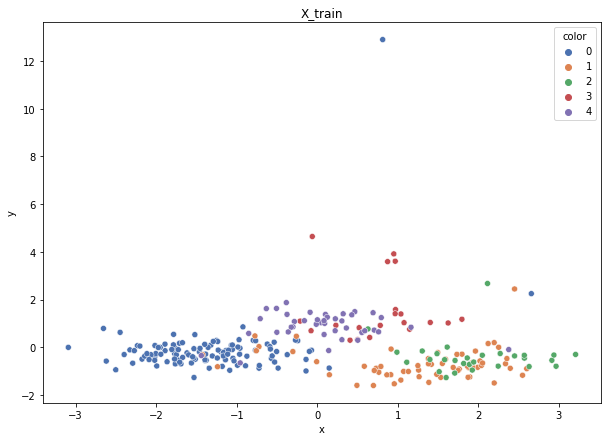

Class cardinalities: Counter({0: 116, 1: 61, 4: 41, 2: 30, 3: 20})
Weights: {0: 0.0649452946471851, 1: 0.1235025275257946, 2: 0.2511218059691157, 3: 0.37668270895367356, 4: 0.183747662904231}


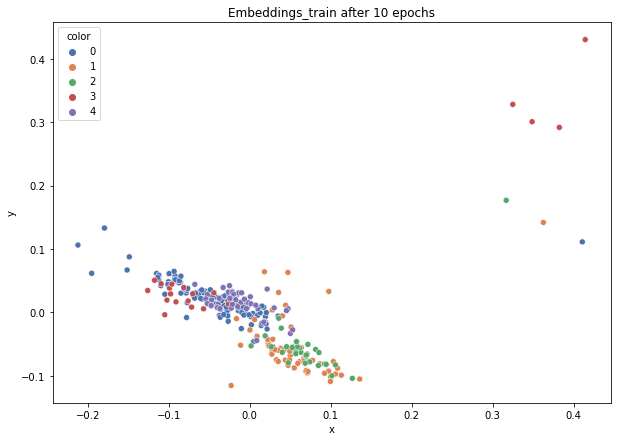

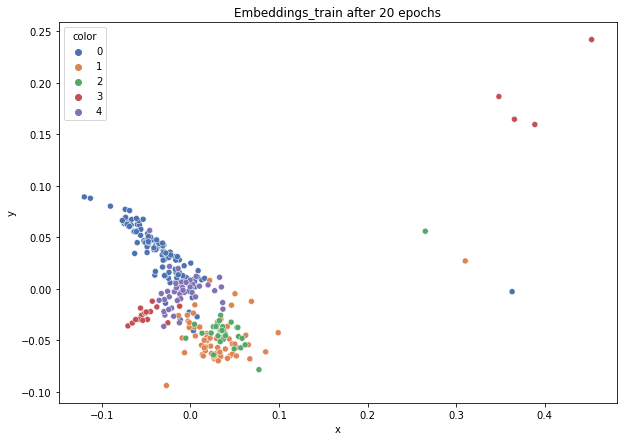

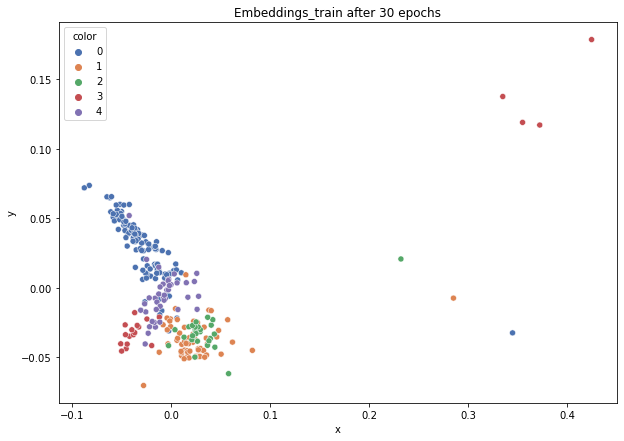

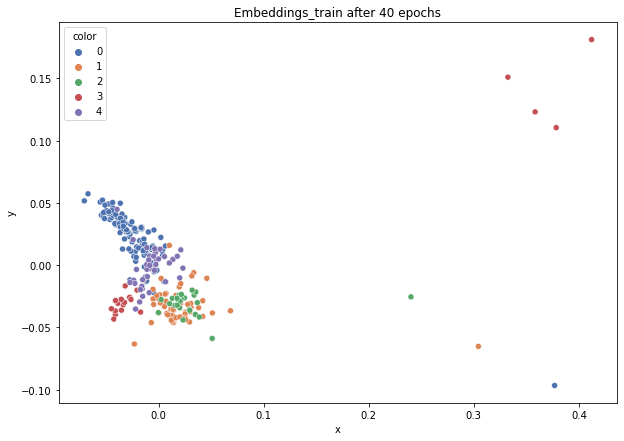

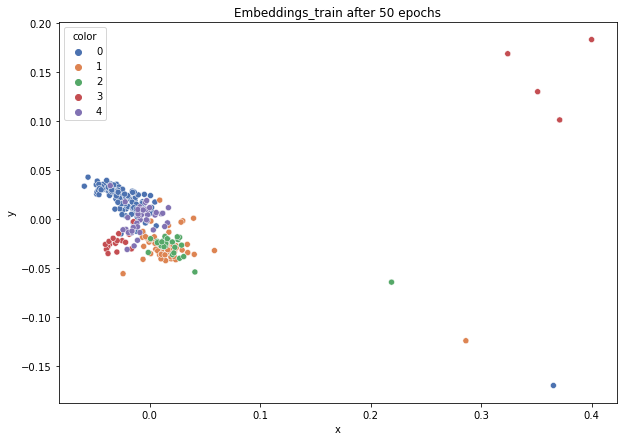

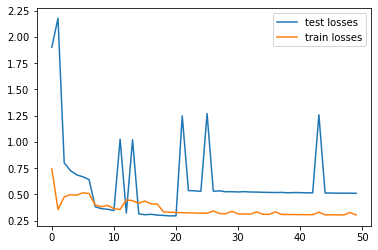

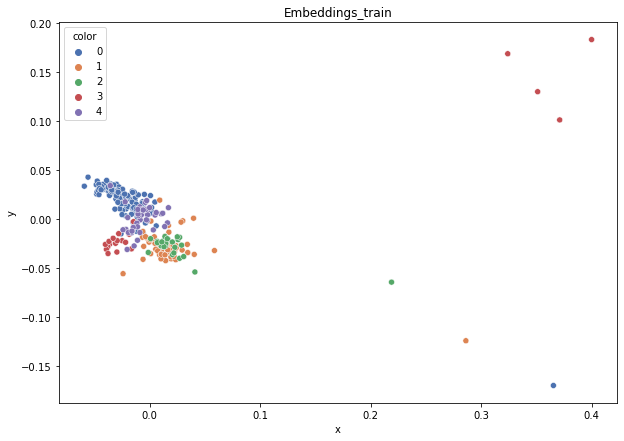

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/discriminant_analysis.py:715: UserWarning: Variables are collinear
  warnings.warn("Variables are collinear")
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/discriminant_analysis.py:715: UserWarning: Variables are collinear
  warnings.warn("Variables are collinear")


DT-f1-new-features: 0.628
DT-f1-old+new-features: 0.776
DT-f1-old-features: 0.634
DT-gmean-new-features: 0.649
DT-gmean-old+new-features: 0.781
DT-gmean-old-features: 0.537
KNN-f1-new-features: 0.743
KNN-f1-old+new-features: 0.749
KNN-f1-old-features: 0.749
KNN-gmean-new-features: 0.698
KNN-gmean-old+new-features: 0.719
KNN-gmean-old-features: 0.719
LDA-f1-new-features: 0.785
LDA-f1-old+new-features: 0.835
LDA-f1-old-features: 0.809
LDA-gmean-new-features: 0.767
LDA-gmean-old+new-features: 0.839
LDA-gmean-old-features: 0.791
QDA-f1-new-features: 0.758
QDA-f1-old+new-features: 0.567
QDA-f1-old-features: 0.287
QDA-gmean-new-features: 0.757
QDA-gmean-old+new-features: 0.548
QDA-gmean-old-features: 0.042
RF24-f1-new-features: 0.79
RF24-f1-old+new-features: 0.835
RF24-f1-old-features: 0.769
RF24-gmean-new-features: 0.776
RF24-gmean-old+new-features: 0.839
RF24-gmean-old-features: 0.771


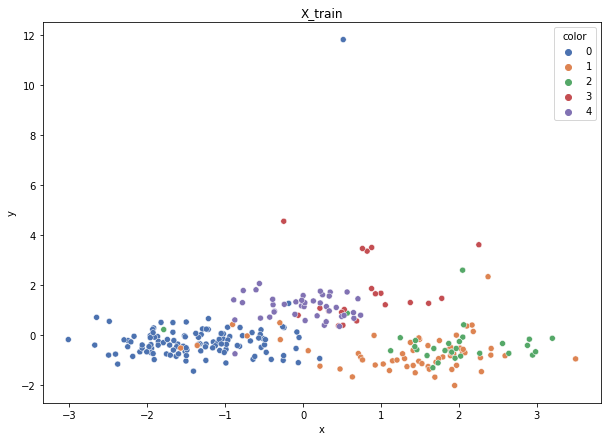

Class cardinalities: Counter({0: 116, 1: 61, 4: 42, 2: 30, 3: 20})
Weights: {0: 0.06523067522150933, 1: 0.12404521845401774, 2: 0.25222527752316937, 3: 0.3783379162847541, 4: 0.18016091251654956}


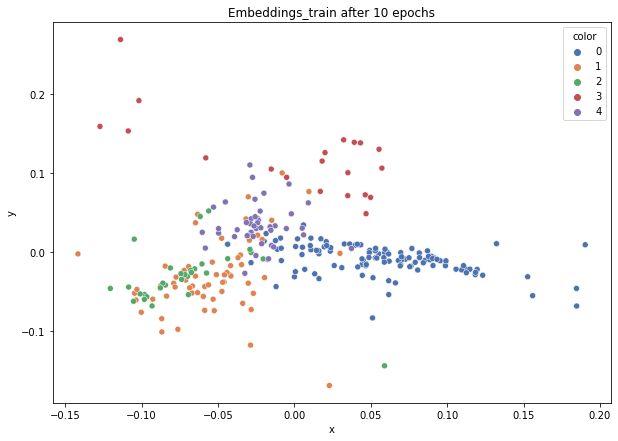

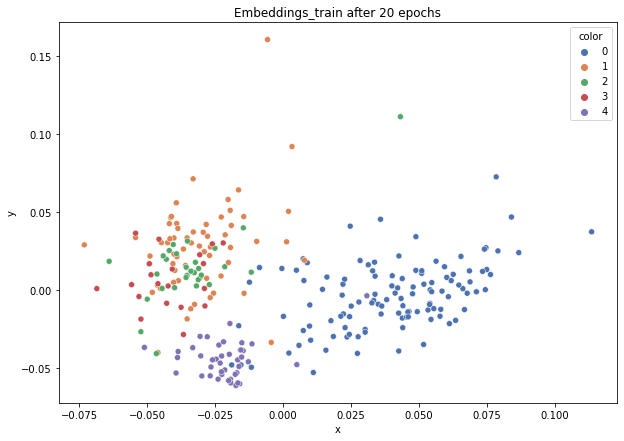

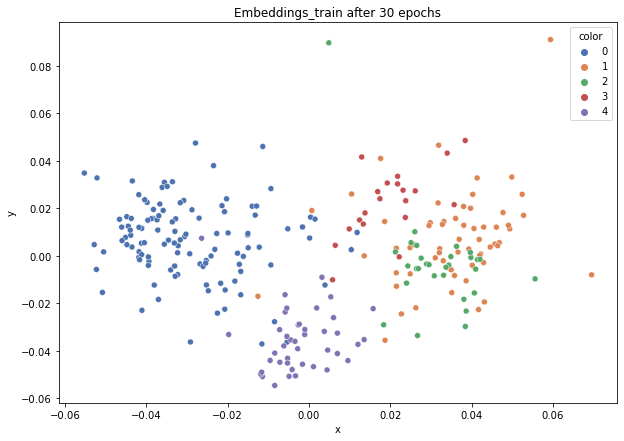

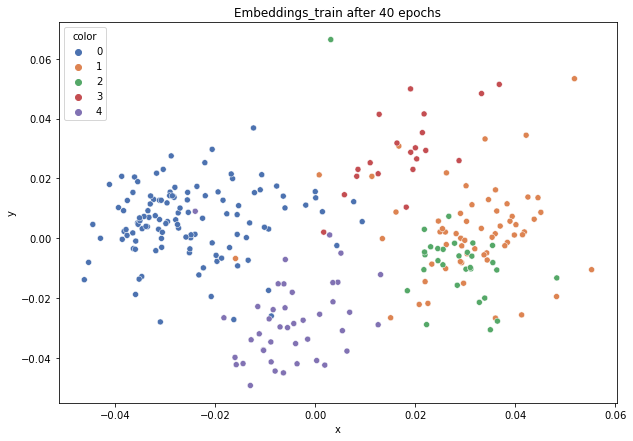

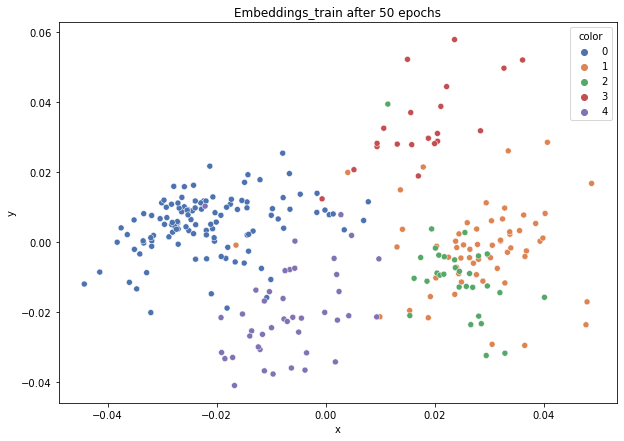

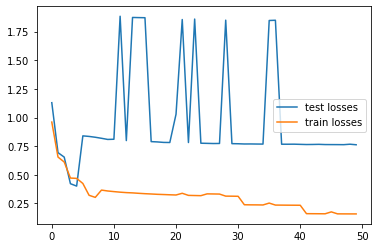

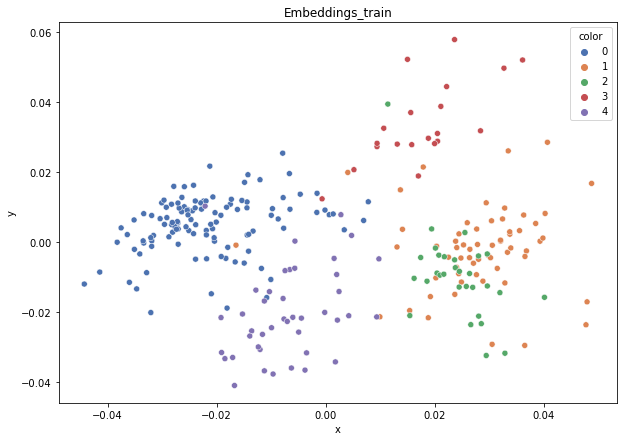

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/discriminant_analysis.py:715: UserWarning: Variables are collinear
  warnings.warn("Variables are collinear")
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/discriminant_analysis.py:715: UserWarning: Variables are collinear
  warnings.warn("Variables are collinear")


DT-f1-new-features: 0.756
DT-f1-old+new-features: 0.739
DT-f1-old-features: 0.707
DT-gmean-new-features: 0.719
DT-gmean-old+new-features: 0.725
DT-gmean-old-features: 0.688
KNN-f1-new-features: 0.799
KNN-f1-old+new-features: 0.728
KNN-f1-old-features: 0.728
KNN-gmean-new-features: 0.787
KNN-gmean-old+new-features: 0.709
KNN-gmean-old-features: 0.709
LDA-f1-new-features: 0.864
LDA-f1-old+new-features: 0.859
LDA-f1-old-features: 0.853
LDA-gmean-new-features: 0.857
LDA-gmean-old+new-features: 0.84
LDA-gmean-old-features: 0.84
QDA-f1-new-features: 0.77
QDA-f1-old+new-features: 0.637
QDA-f1-old-features: 0.494
QDA-gmean-new-features: 0.759
QDA-gmean-old+new-features: 0.648
QDA-gmean-old-features: 0.344
RF24-f1-new-features: 0.841
RF24-f1-old+new-features: 0.837
RF24-f1-old-features: 0.841
RF24-gmean-new-features: 0.829
RF24-gmean-old+new-features: 0.81
RF24-gmean-old-features: 0.829


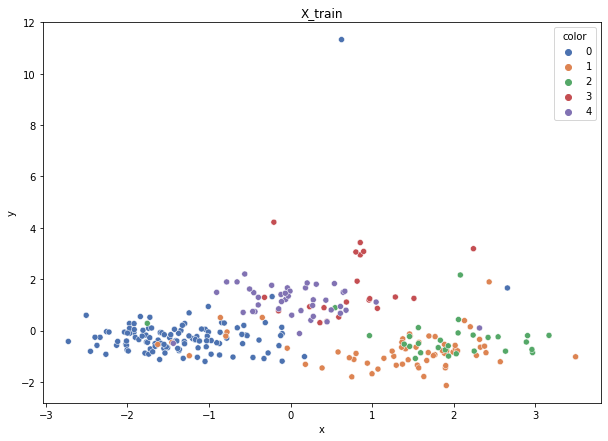

Class cardinalities: Counter({0: 116, 1: 62, 4: 42, 2: 29, 3: 20})
Weights: {0: 0.06479675120436358, 1: 0.12123263128558347, 2: 0.2591870048174543, 3: 0.37582115698530877, 4: 0.17896245570728986}


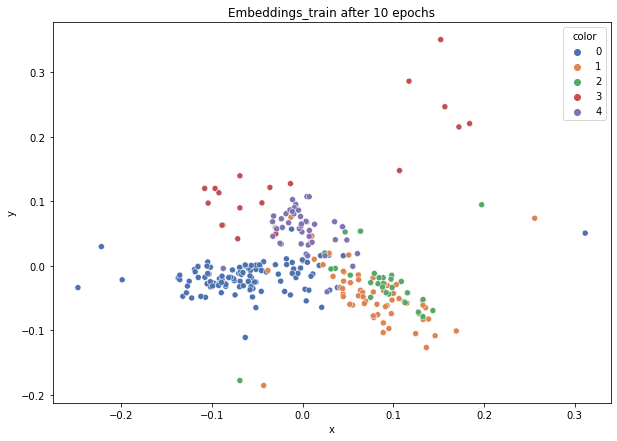

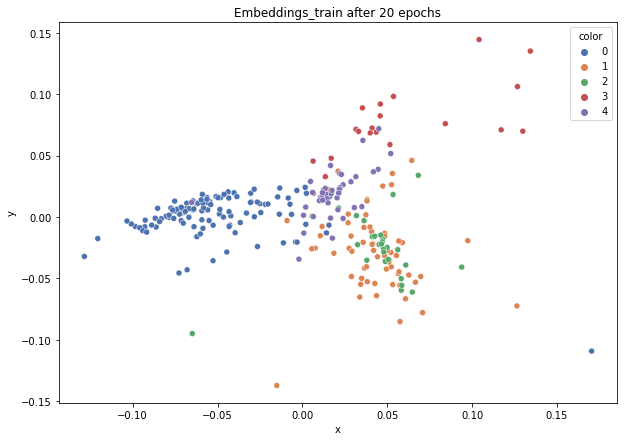

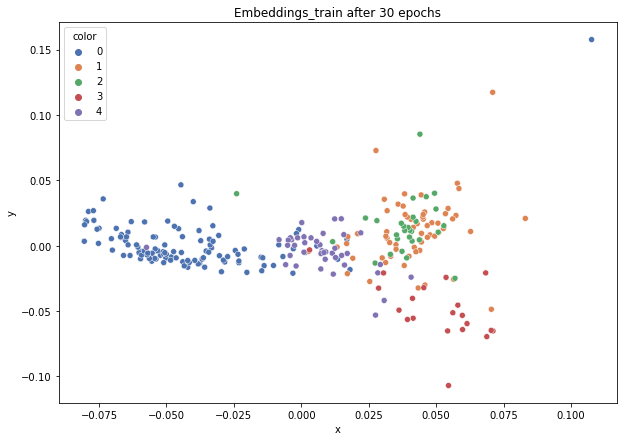

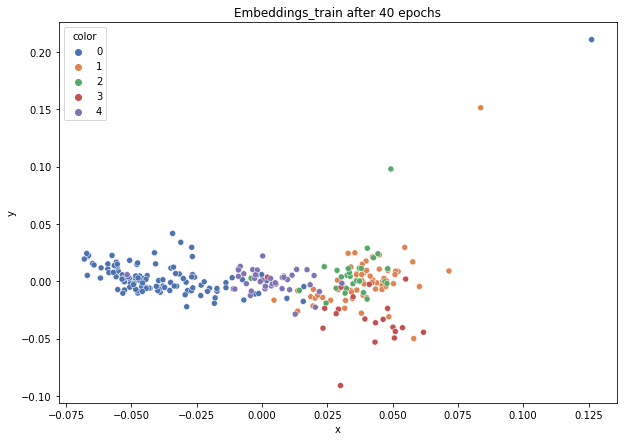

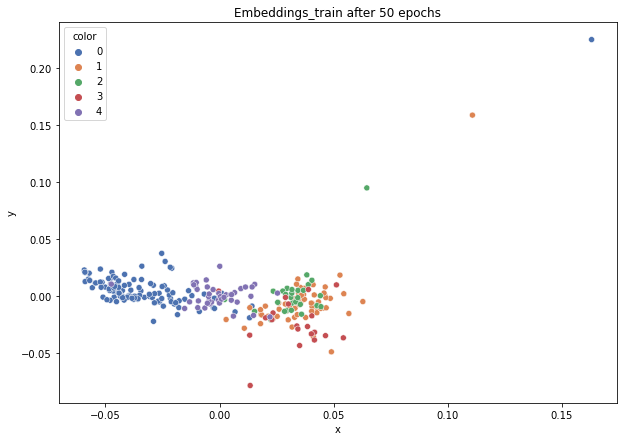

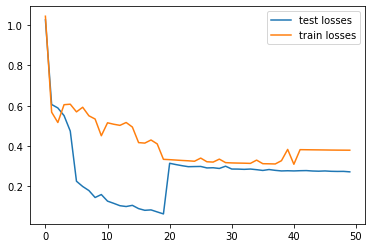

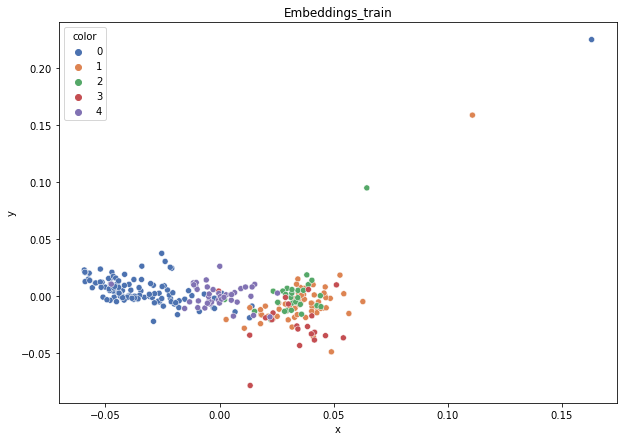

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/discriminant_analysis.py:715: UserWarning: Variables are collinear
  warnings.warn("Variables are collinear")
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/discriminant_analysis.py:715: UserWarning: Variables are collinear
  warnings.warn("Variables are collinear")


DT-f1-new-features: 0.737
DT-f1-old+new-features: 0.695
DT-f1-old-features: 0.722
DT-gmean-new-features: 0.716
DT-gmean-old+new-features: 0.681
DT-gmean-old-features: 0.69
KNN-f1-new-features: 0.799
KNN-f1-old+new-features: 0.862
KNN-f1-old-features: 0.862
KNN-gmean-new-features: 0.776
KNN-gmean-old+new-features: 0.815
KNN-gmean-old-features: 0.815
LDA-f1-new-features: 0.841
LDA-f1-old+new-features: 0.909
LDA-f1-old-features: 0.872
LDA-gmean-new-features: 0.803
LDA-gmean-old+new-features: 0.899
LDA-gmean-old-features: 0.852
QDA-f1-new-features: 0.66
QDA-f1-old+new-features: 0.407
QDA-f1-old-features: 0.176
QDA-gmean-new-features: 0.578
QDA-gmean-old+new-features: 0.055
QDA-gmean-old-features: 0.011
RF24-f1-new-features: 0.837
RF24-f1-old+new-features: 0.858
RF24-f1-old-features: 0.879
RF24-gmean-new-features: 0.788
RF24-gmean-old+new-features: 0.815
RF24-gmean-old-features: 0.846


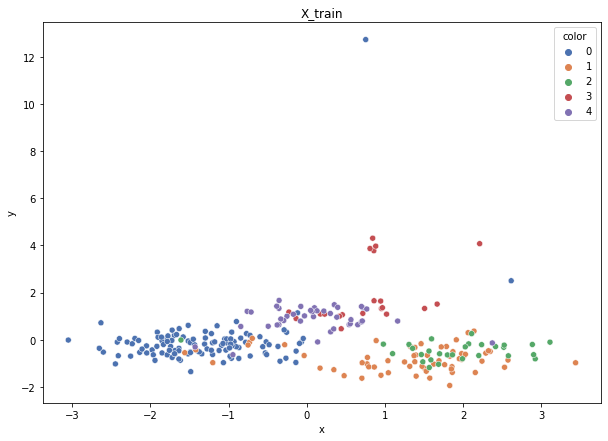

Class cardinalities: Counter({0: 116, 1: 62, 4: 42, 2: 29, 3: 20})
Weights: {0: 0.06479675120436358, 1: 0.12123263128558347, 2: 0.2591870048174543, 3: 0.37582115698530877, 4: 0.17896245570728986}


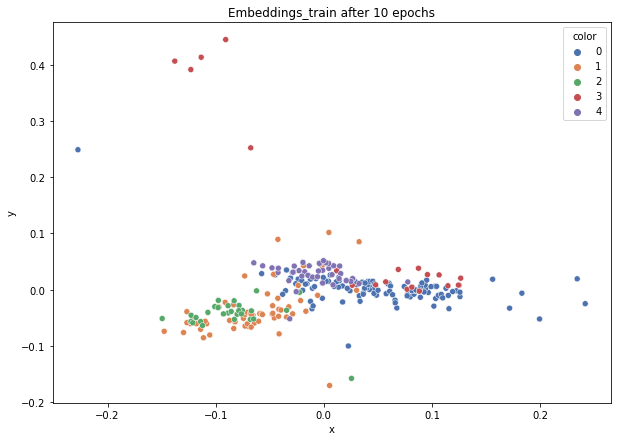

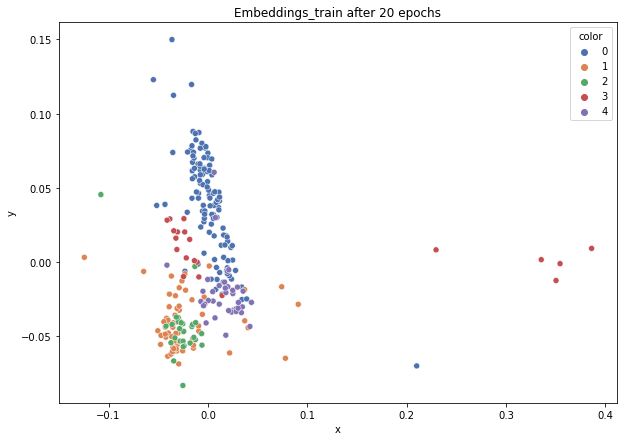

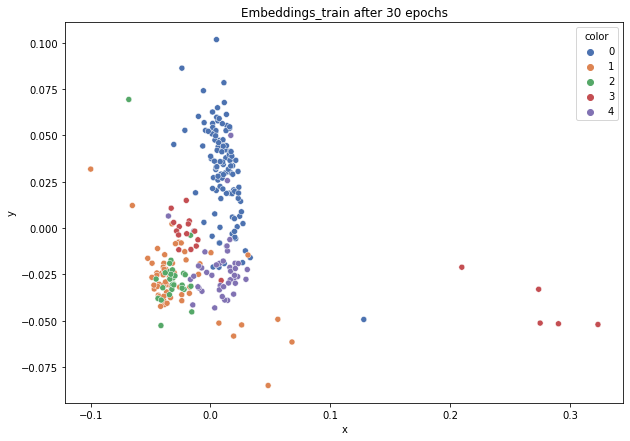

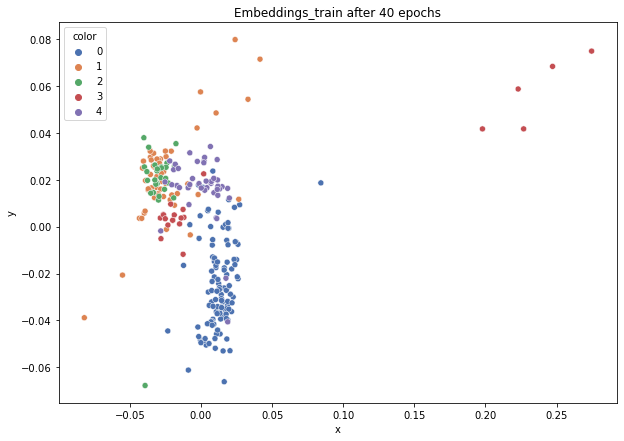

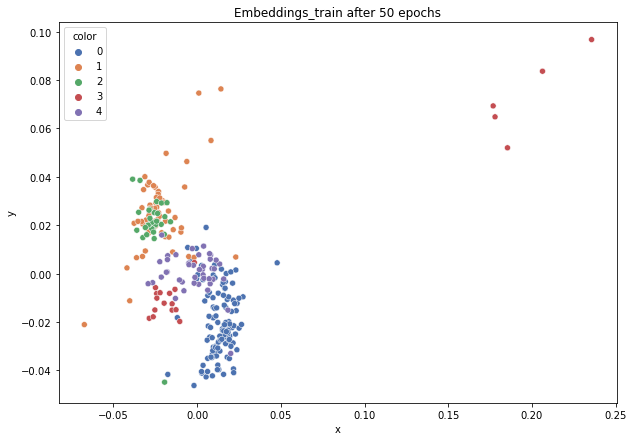

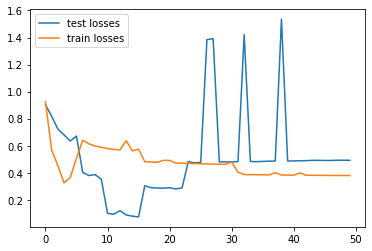

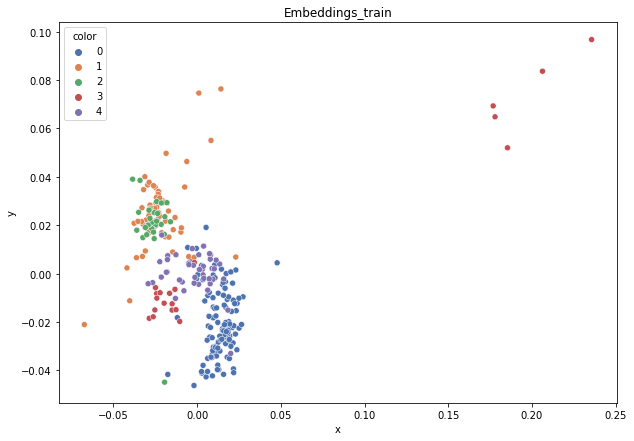

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/discriminant_analysis.py:715: UserWarning: Variables are collinear
  warnings.warn("Variables are collinear")
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/discriminant_analysis.py:715: UserWarning: Variables are collinear
  warnings.warn("Variables are collinear")


DT-f1-new-features: 0.665
DT-f1-old+new-features: 0.683
DT-f1-old-features: 0.649
DT-gmean-new-features: 0.669
DT-gmean-old+new-features: 0.669
DT-gmean-old-features: 0.606
KNN-f1-new-features: 0.709
KNN-f1-old+new-features: 0.817
KNN-f1-old-features: 0.817
KNN-gmean-new-features: 0.695
KNN-gmean-old+new-features: 0.782
KNN-gmean-old-features: 0.782
LDA-f1-new-features: 0.731
LDA-f1-old+new-features: 0.76
LDA-f1-old-features: 0.74
LDA-gmean-new-features: 0.688
LDA-gmean-old+new-features: 0.72
LDA-gmean-old-features: 0.718
QDA-f1-new-features: 0.669
QDA-f1-old+new-features: 0.411
QDA-f1-old-features: 0.328
QDA-gmean-new-features: 0.63
QDA-gmean-old+new-features: 0.334
QDA-gmean-old-features: 0.235
RF24-f1-new-features: 0.712
RF24-f1-old+new-features: 0.793
RF24-f1-old-features: 0.753
RF24-gmean-new-features: 0.646
RF24-gmean-old+new-features: 0.746
RF24-gmean-old-features: 0.719


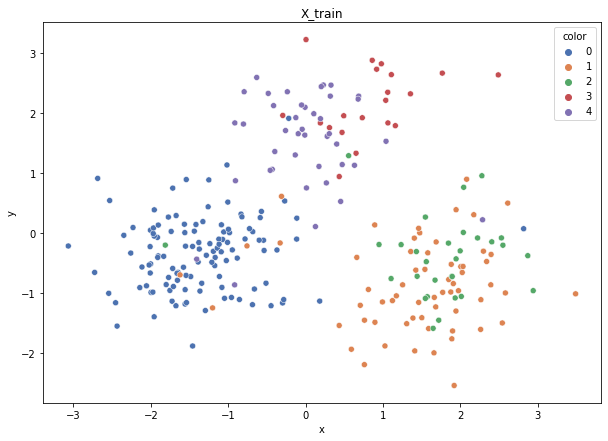

Class cardinalities: Counter({0: 116, 1: 62, 4: 41, 2: 30, 3: 20})
Weights: {0: 0.06507492234699798, 1: 0.12175308052018977, 2: 0.25162303307505884, 3: 0.3774345496125883, 4: 0.18411441444516502}


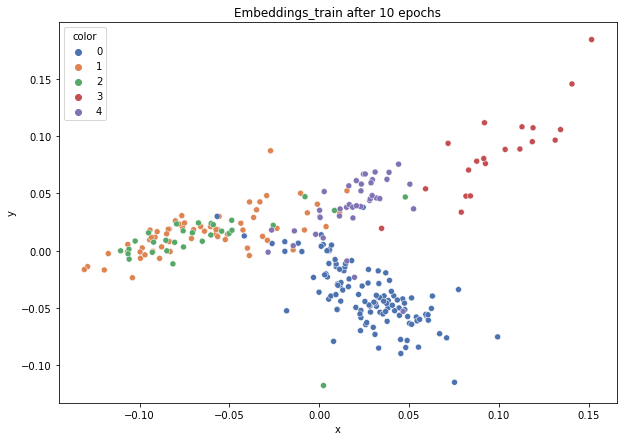

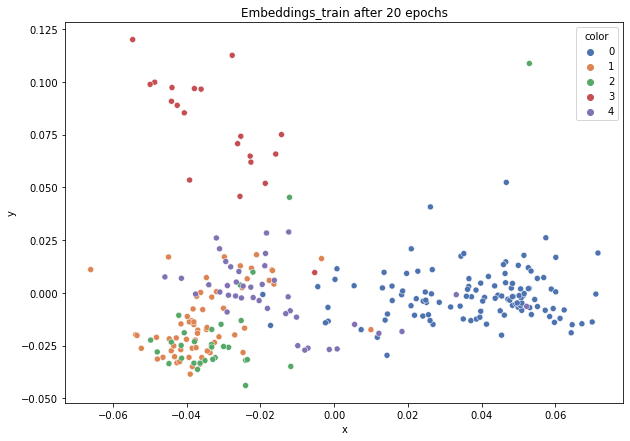

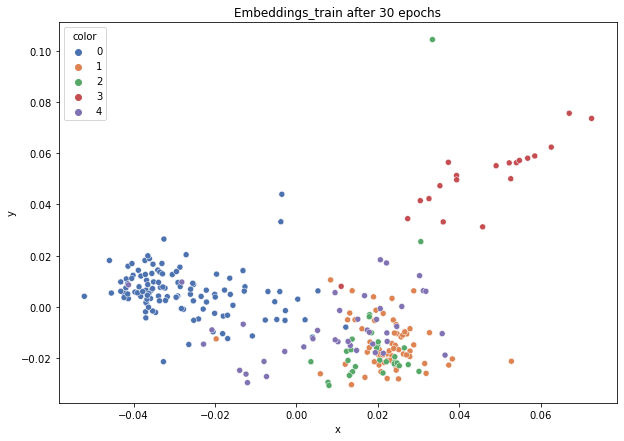

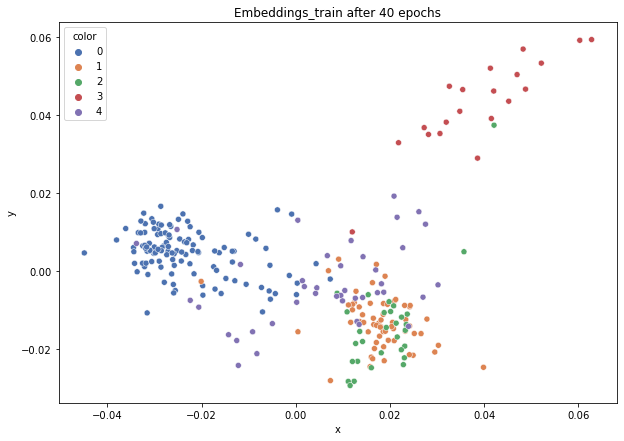

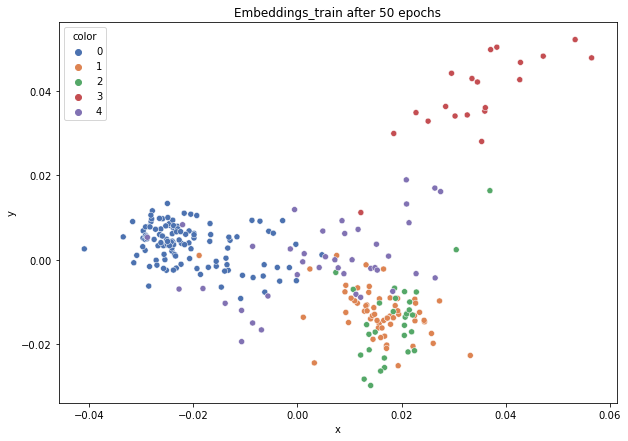

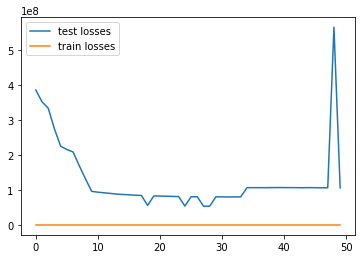

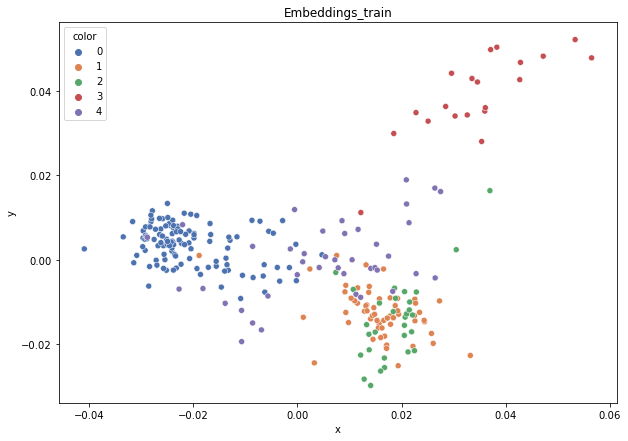

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/discriminant_analysis.py:715: UserWarning: Variables are collinear
  warnings.warn("Variables are collinear")
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/discriminant_analysis.py:715: UserWarning: Variables are collinear
  warnings.warn("Variables are collinear")


DT-f1-new-features: 0.557
DT-f1-old+new-features: 0.71
DT-f1-old-features: 0.793
DT-gmean-new-features: 0.568
DT-gmean-old+new-features: 0.746
DT-gmean-old-features: 0.822
KNN-f1-new-features: 0.768
KNN-f1-old+new-features: 0.808
KNN-f1-old-features: 0.808
KNN-gmean-new-features: 0.775
KNN-gmean-old+new-features: 0.84
KNN-gmean-old-features: 0.84
LDA-f1-new-features: 0.72
LDA-f1-old+new-features: 0.792
LDA-f1-old-features: 0.86
LDA-gmean-new-features: 0.68
LDA-gmean-old+new-features: 0.787
LDA-gmean-old-features: 0.873
QDA-f1-new-features: 0.696
QDA-f1-old+new-features: 0.601
QDA-f1-old-features: 0.333
QDA-gmean-new-features: 0.641
QDA-gmean-old+new-features: 0.493
QDA-gmean-old-features: 0.299
RF24-f1-new-features: 0.766
RF24-f1-old+new-features: 0.795
RF24-f1-old-features: 0.887
RF24-gmean-new-features: 0.737
RF24-gmean-old+new-features: 0.787
RF24-gmean-old-features: 0.876
new_led7digit


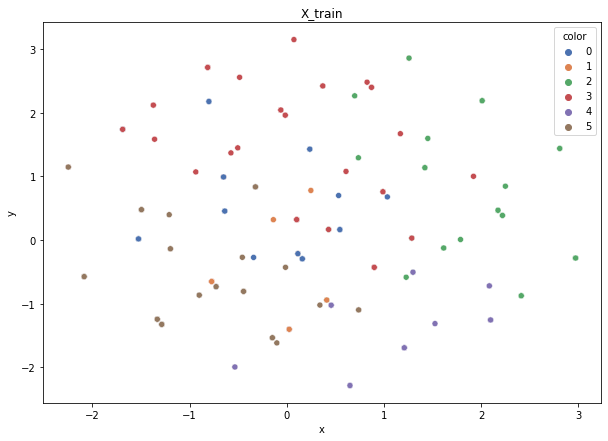

Class cardinalities: Counter({3: 87, 5: 79, 0: 78, 2: 75, 4: 41, 1: 40})
Weights: {0: 0.12859532399632337, 2: 0.1337391369561763, 3: 0.11529235944497956, 4: 0.24464476272471275, 5: 0.1269675350849775, 1: 0.25076088179283057}


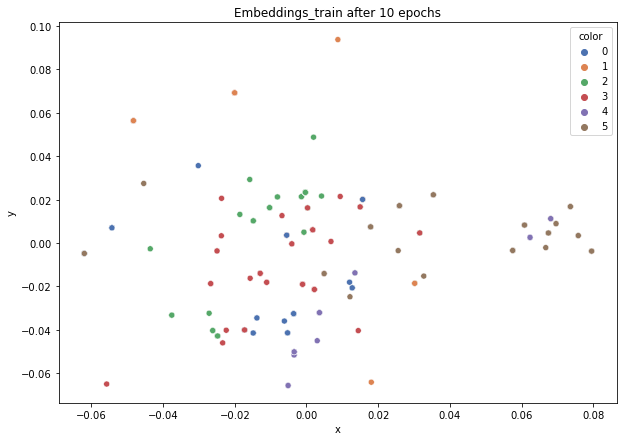

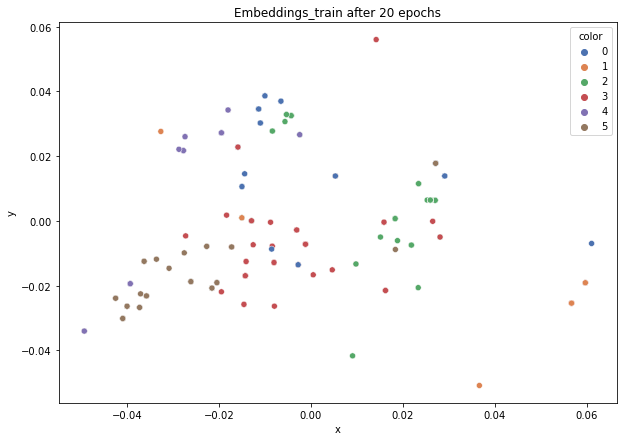

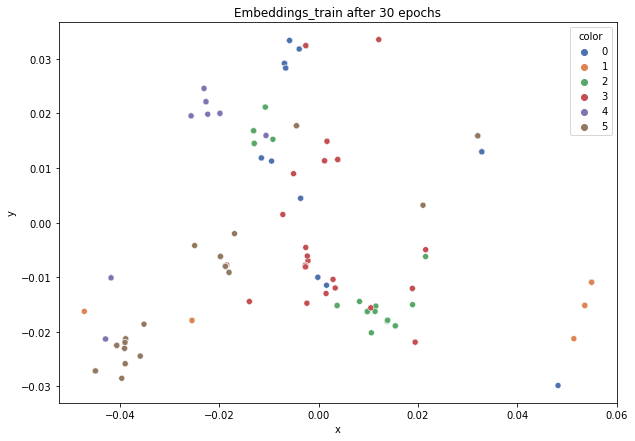

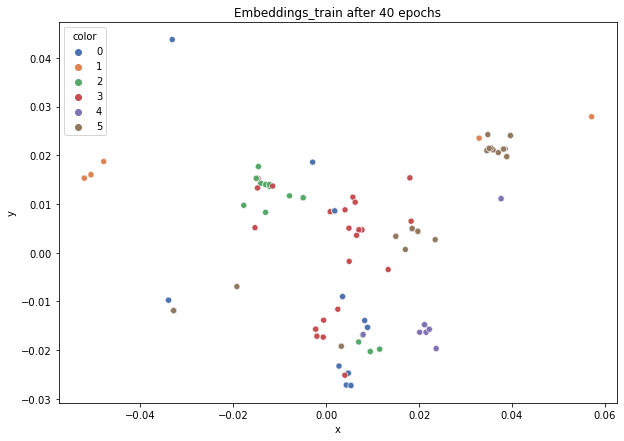

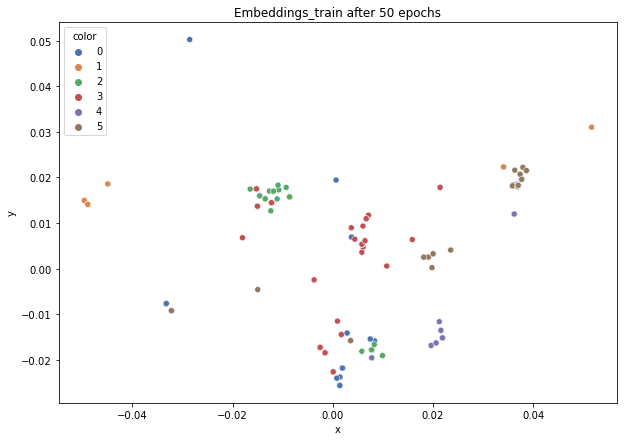

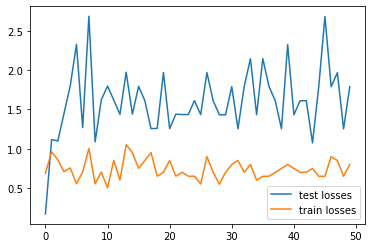

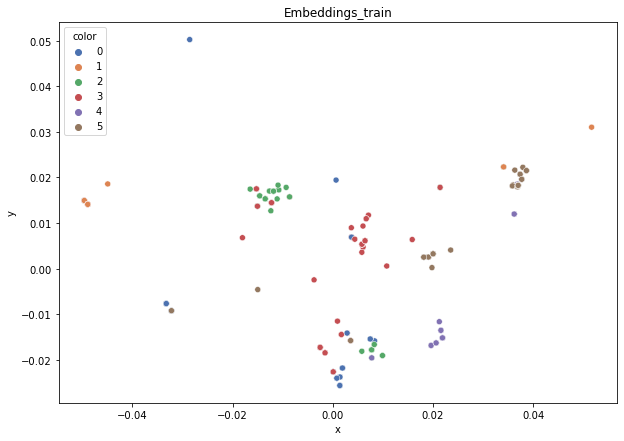

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/discriminant_analysis.py:715: UserWarning: Variables are collinear
  warnings.warn("Variables are collinear")
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/discriminant_analysis.py:715: UserWarning: Variables are collinear
  warnings.warn("Variables are collinear")


DT-f1-new-features: 0.731
DT-f1-old+new-features: 0.743
DT-f1-old-features: 0.789
DT-gmean-new-features: 0.712
DT-gmean-old+new-features: 0.745
DT-gmean-old-features: 0.797
KNN-f1-new-features: 0.695
KNN-f1-old+new-features: 0.749
KNN-f1-old-features: 0.741
KNN-gmean-new-features: 0.674
KNN-gmean-old+new-features: 0.726
KNN-gmean-old-features: 0.719
LDA-f1-new-features: 0.721
LDA-f1-old+new-features: 0.754
LDA-f1-old-features: 0.804
LDA-gmean-new-features: 0.707
LDA-gmean-old+new-features: 0.751
LDA-gmean-old-features: 0.806
QDA-f1-new-features: 0.723
QDA-f1-old+new-features: 0.589
QDA-f1-old-features: 0.709
QDA-gmean-new-features: 0.702
QDA-gmean-old+new-features: 0.241
QDA-gmean-old-features: 0.689
RF24-f1-new-features: 0.741
RF24-f1-old+new-features: 0.747
RF24-f1-old-features: 0.796
RF24-gmean-new-features: 0.718
RF24-gmean-old+new-features: 0.727
RF24-gmean-old-features: 0.797


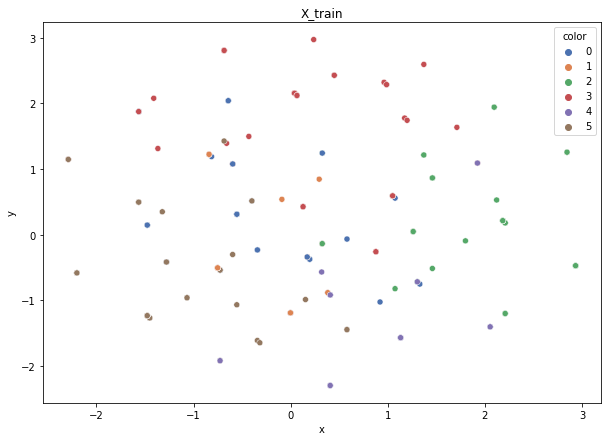

Class cardinalities: Counter({3: 87, 5: 80, 0: 78, 2: 75, 4: 41, 1: 39})
Weights: {0: 0.1279755802357915, 2: 0.13309460344522317, 3: 0.114736727107951, 4: 0.2434657380095546, 5: 0.12477619072989674, 1: 0.255951160471583}


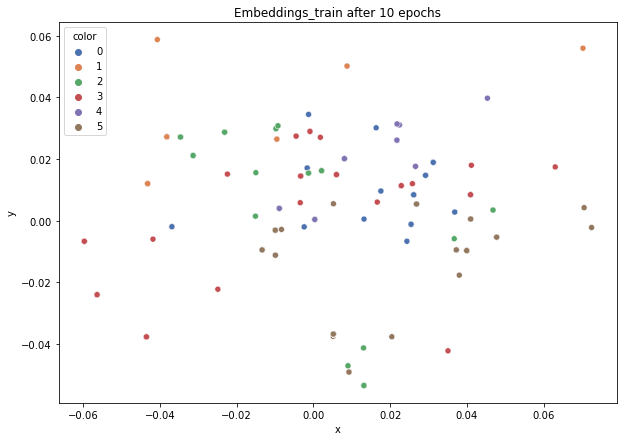

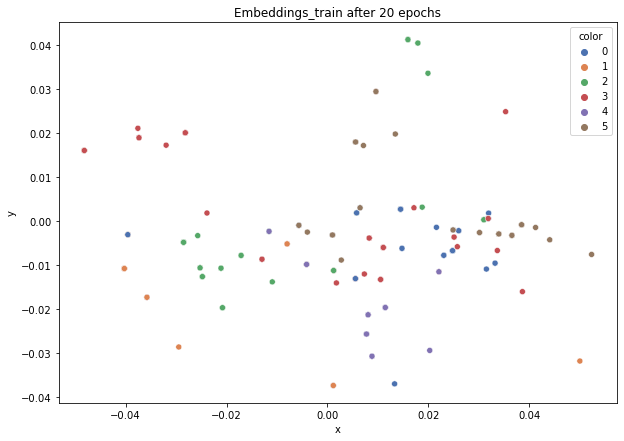

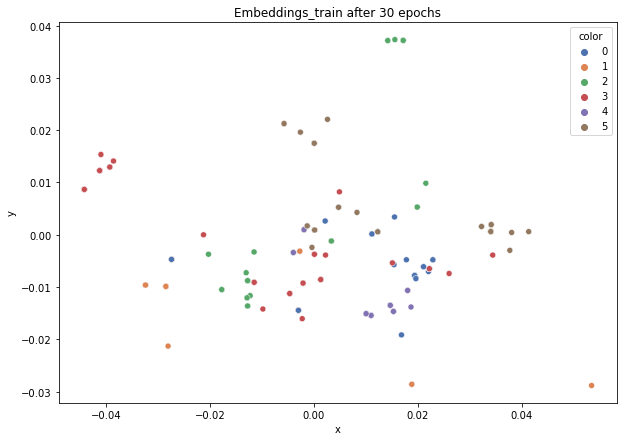

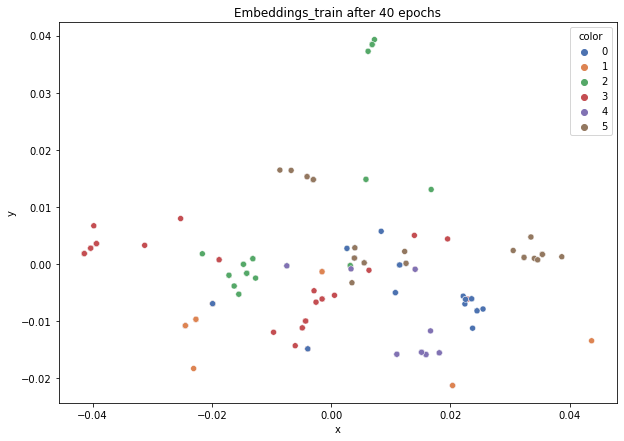

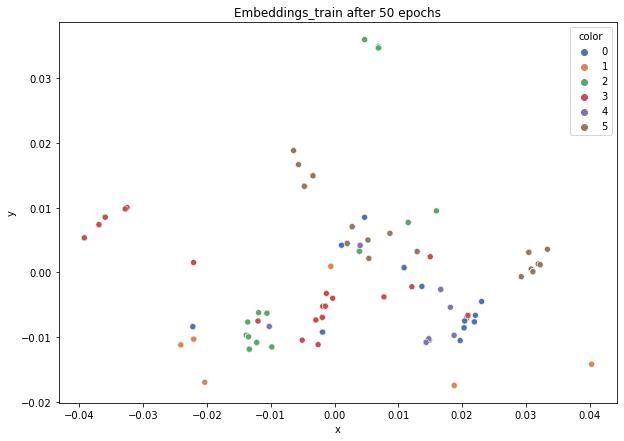

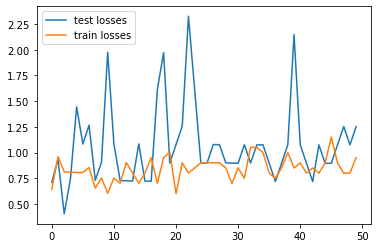

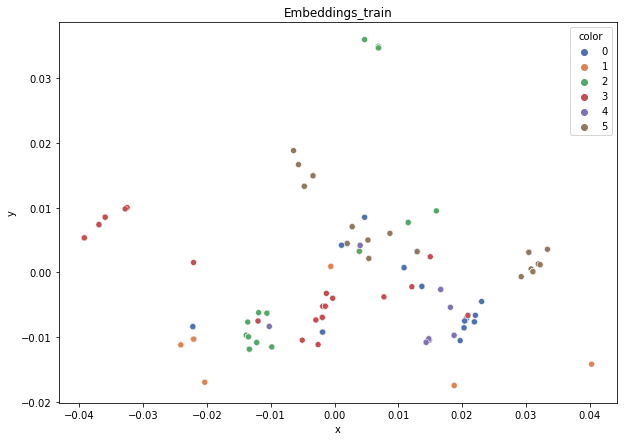

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/discriminant_analysis.py:715: UserWarning: Variables are collinear
  warnings.warn("Variables are collinear")


DT-f1-new-features: 0.745
DT-f1-old+new-features: 0.745
DT-f1-old-features: 0.779
DT-gmean-new-features: 0.724
DT-gmean-old+new-features: 0.724
DT-gmean-old-features: 0.755
KNN-f1-new-features: 0.655
KNN-f1-old+new-features: 0.692
KNN-f1-old-features: 0.692
KNN-gmean-new-features: 0.613
KNN-gmean-old+new-features: 0.283
KNN-gmean-old-features: 0.283
LDA-f1-new-features: 0.713
LDA-f1-old+new-features: 0.729
LDA-f1-old-features: 0.756
LDA-gmean-new-features: 0.689
LDA-gmean-old+new-features: 0.703
LDA-gmean-old-features: 0.729
QDA-f1-new-features: 0.732
QDA-f1-old+new-features: 0.475
QDA-f1-old-features: 0.745
QDA-gmean-new-features: 0.699
QDA-gmean-old+new-features: 0.086
QDA-gmean-old-features: 0.695
RF24-f1-new-features: 0.743
RF24-f1-old+new-features: 0.776
RF24-f1-old-features: 0.767
RF24-gmean-new-features: 0.713
RF24-gmean-old+new-features: 0.747
RF24-gmean-old-features: 0.735


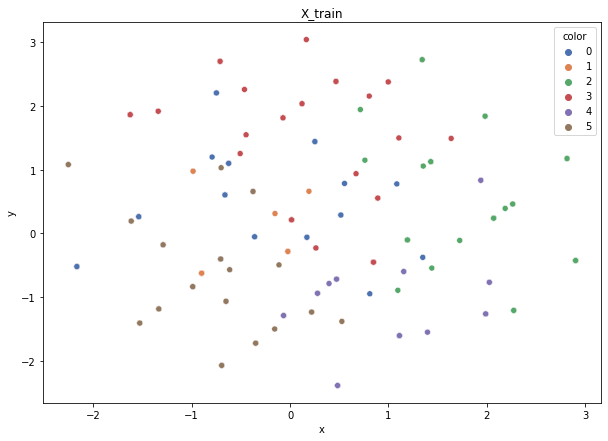

Class cardinalities: Counter({3: 86, 5: 79, 0: 78, 2: 76, 4: 42, 1: 39})
Weights: {0: 0.12857143873483481, 2: 0.1319548976489094, 3: 0.11661130489903622, 4: 0.23877552907897892, 5: 0.12694395216857107, 1: 0.25714287746966963}


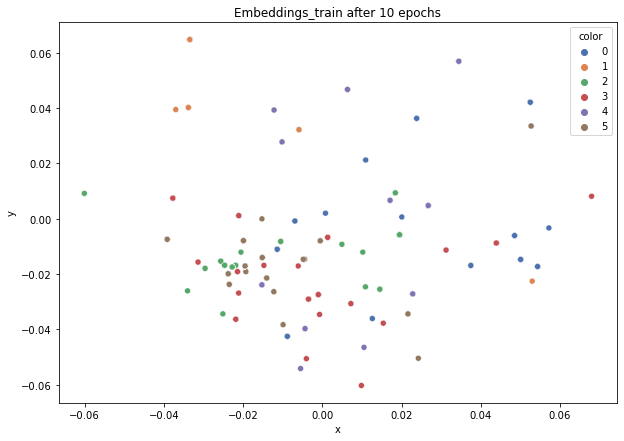

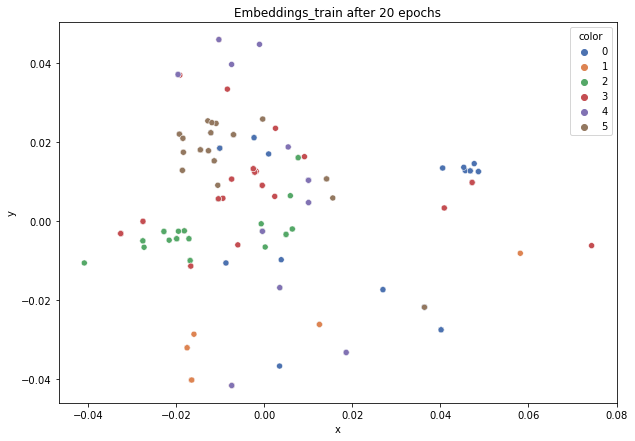

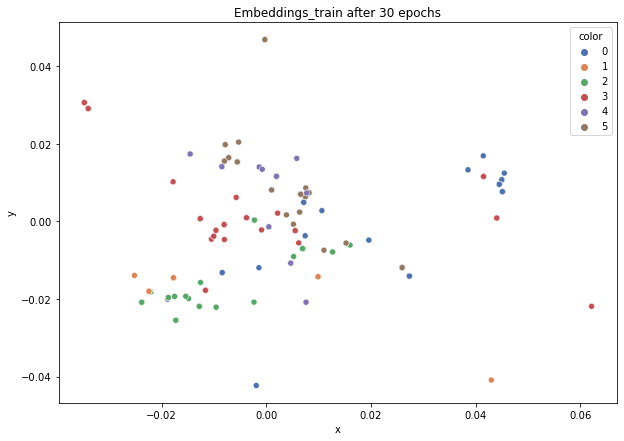

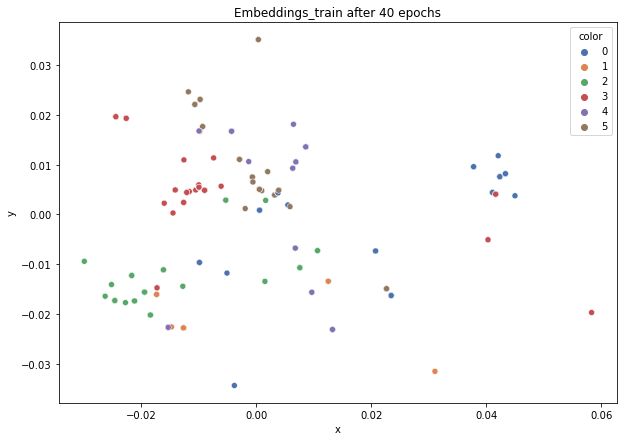

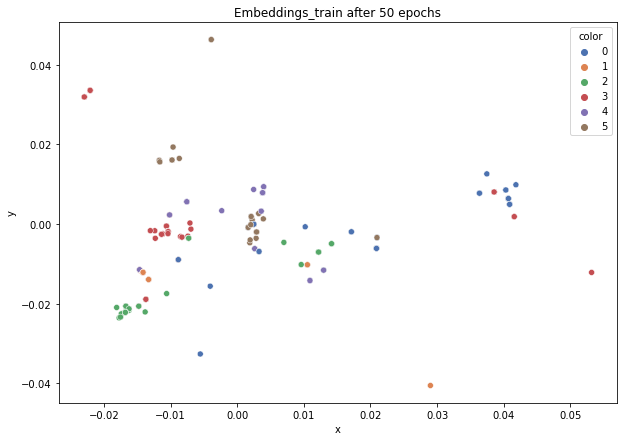

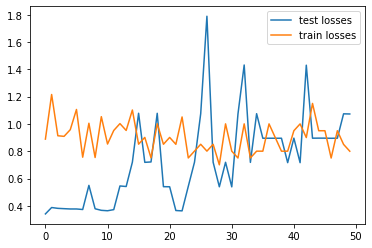

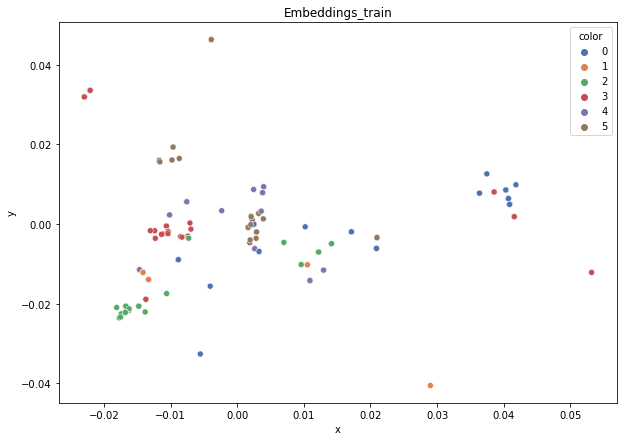

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/discriminant_analysis.py:715: UserWarning: Variables are collinear
  warnings.warn("Variables are collinear")


DT-f1-new-features: 0.774
DT-f1-old+new-features: 0.773
DT-f1-old-features: 0.782
DT-gmean-new-features: 0.778
DT-gmean-old+new-features: 0.776
DT-gmean-old-features: 0.783
KNN-f1-new-features: 0.619
KNN-f1-old+new-features: 0.728
KNN-f1-old-features: 0.739
KNN-gmean-new-features: 0.484
KNN-gmean-old+new-features: 0.731
KNN-gmean-old-features: 0.739
LDA-f1-new-features: 0.779
LDA-f1-old+new-features: 0.832
LDA-f1-old-features: 0.824
LDA-gmean-new-features: 0.778
LDA-gmean-old+new-features: 0.833
LDA-gmean-old-features: 0.824
QDA-f1-new-features: 0.786
QDA-f1-old+new-features: 0.748
QDA-f1-old-features: 0.769
QDA-gmean-new-features: 0.786
QDA-gmean-old+new-features: 0.711
QDA-gmean-old-features: 0.761
RF24-f1-new-features: 0.783
RF24-f1-old+new-features: 0.783
RF24-f1-old-features: 0.793
RF24-gmean-new-features: 0.785
RF24-gmean-old+new-features: 0.785
RF24-gmean-old-features: 0.793


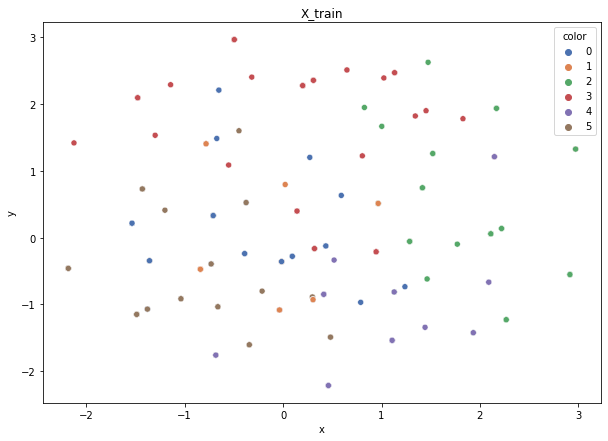

Class cardinalities: Counter({3: 86, 0: 79, 5: 79, 2: 75, 4: 42, 1: 39})
Weights: {0: 0.12692720893782067, 2: 0.13369666008117112, 3: 0.11659592448939342, 4: 0.23874403585923412, 5: 0.12692720893782067, 1: 0.2571089616945598}


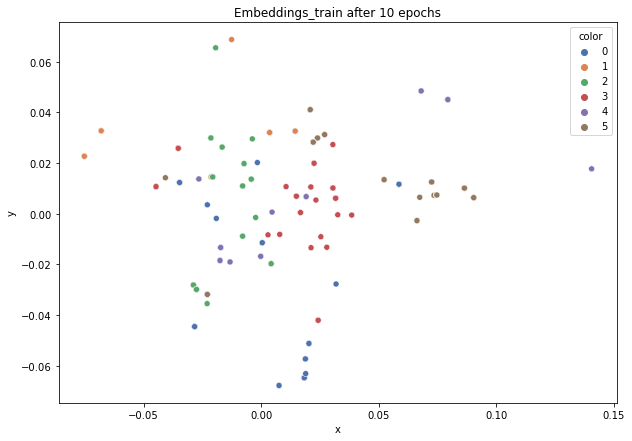

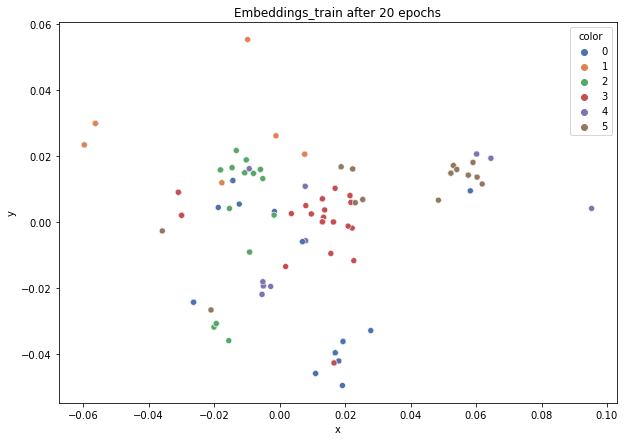

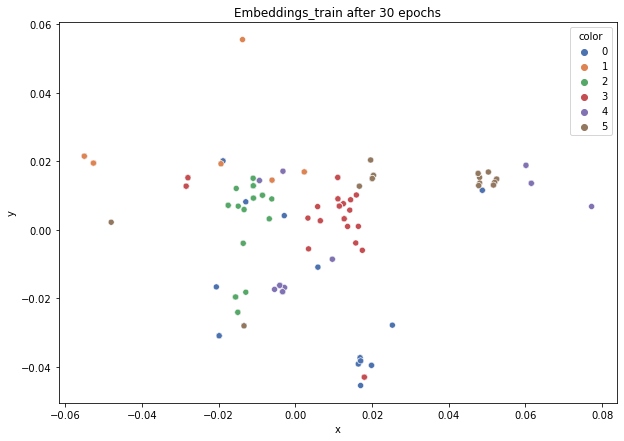

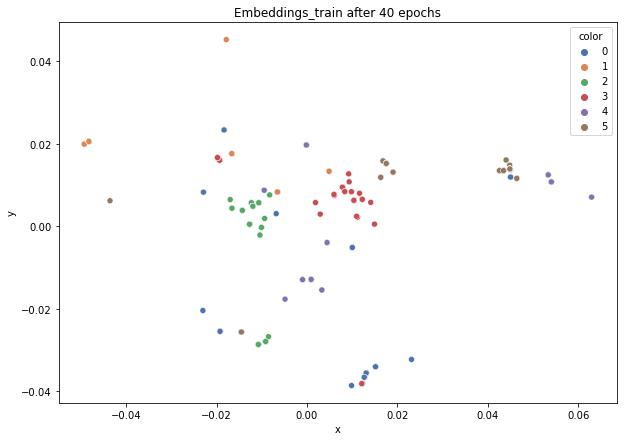

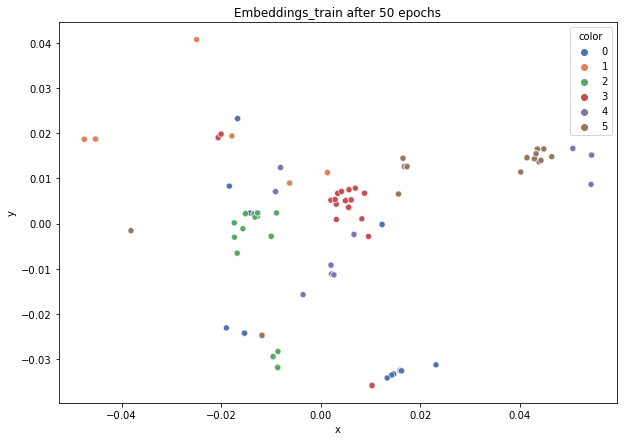

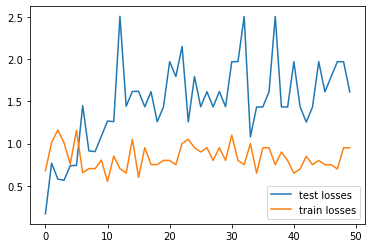

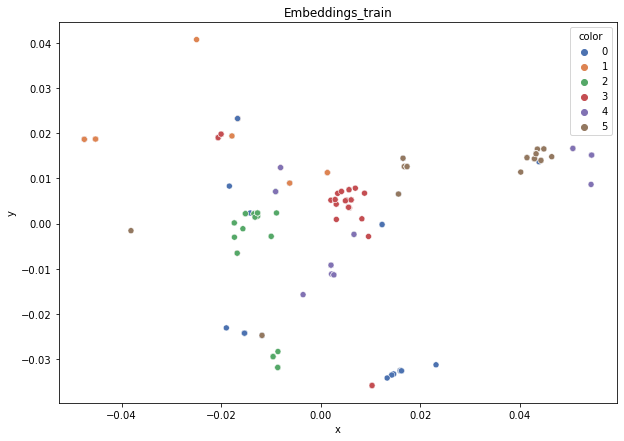

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/discriminant_analysis.py:715: UserWarning: Variables are collinear
  warnings.warn("Variables are collinear")


DT-f1-new-features: 0.725
DT-f1-old+new-features: 0.711
DT-f1-old-features: 0.716
DT-gmean-new-features: 0.717
DT-gmean-old+new-features: 0.693
DT-gmean-old-features: 0.698
KNN-f1-new-features: 0.592
KNN-f1-old+new-features: 0.714
KNN-f1-old-features: 0.714
KNN-gmean-new-features: 0.241
KNN-gmean-old+new-features: 0.704
KNN-gmean-old-features: 0.704
LDA-f1-new-features: 0.754
LDA-f1-old+new-features: 0.775
LDA-f1-old-features: 0.784
LDA-gmean-new-features: 0.742
LDA-gmean-old+new-features: 0.764
LDA-gmean-old-features: 0.777
QDA-f1-new-features: 0.735
QDA-f1-old+new-features: 0.711
QDA-f1-old-features: 0.722
QDA-gmean-new-features: 0.729
QDA-gmean-old+new-features: 0.68
QDA-gmean-old-features: 0.704
RF24-f1-new-features: 0.706
RF24-f1-old+new-features: 0.723
RF24-f1-old-features: 0.763
RF24-gmean-new-features: 0.699
RF24-gmean-old+new-features: 0.713
RF24-gmean-old-features: 0.751


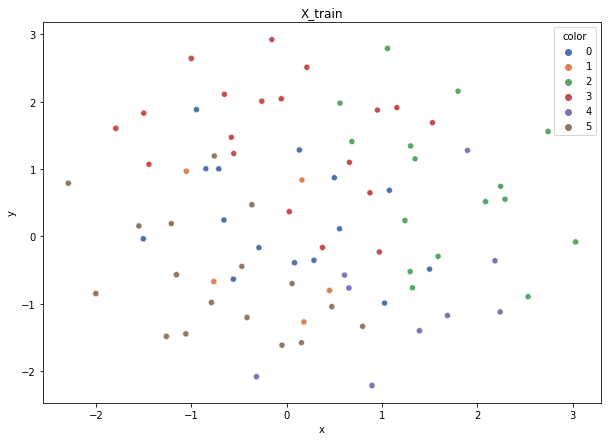

Class cardinalities: Counter({3: 86, 0: 79, 5: 79, 2: 75, 4: 42, 1: 39})
Weights: {0: 0.12692720893782067, 2: 0.13369666008117112, 3: 0.11659592448939342, 4: 0.23874403585923412, 5: 0.12692720893782067, 1: 0.2571089616945598}


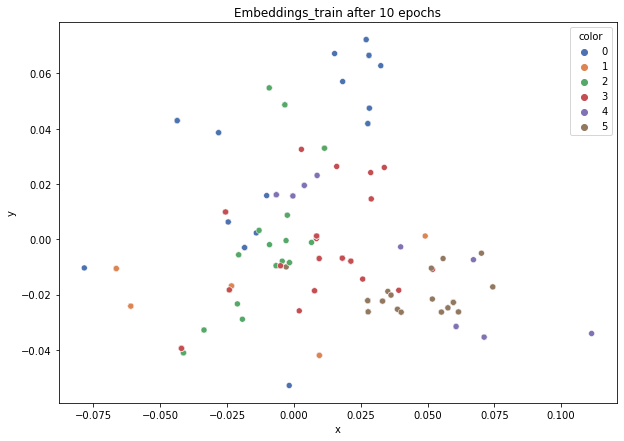

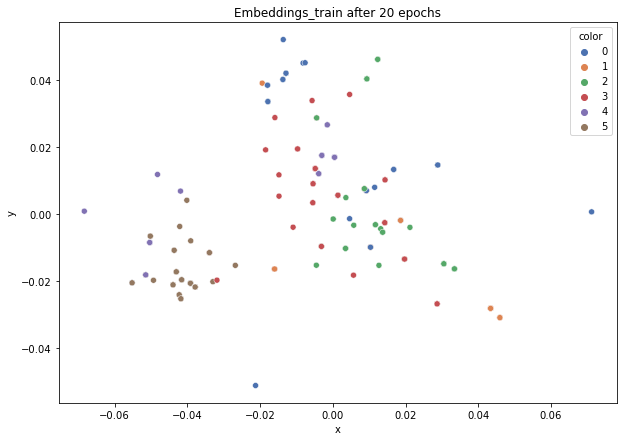

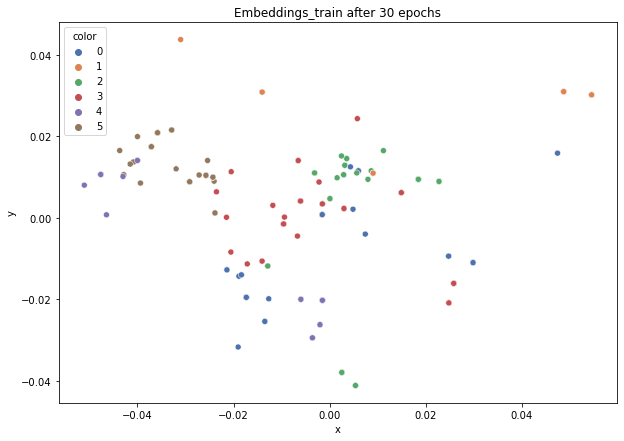

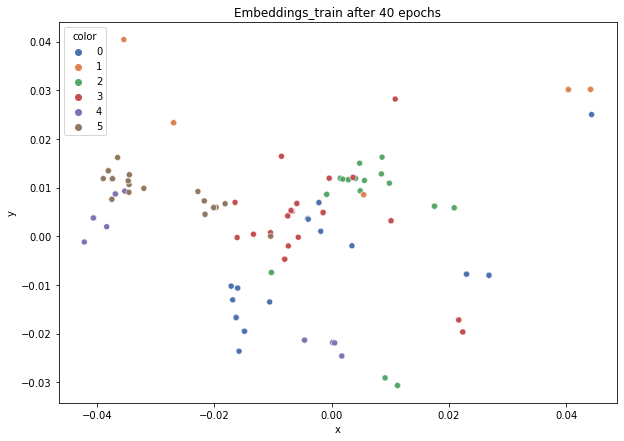

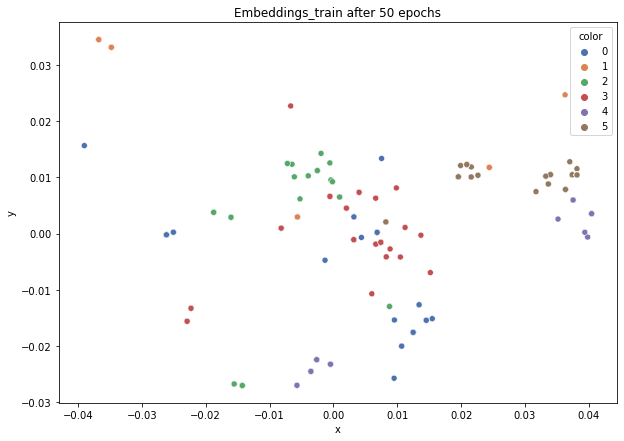

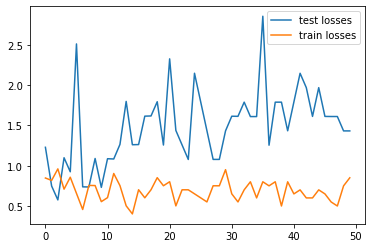

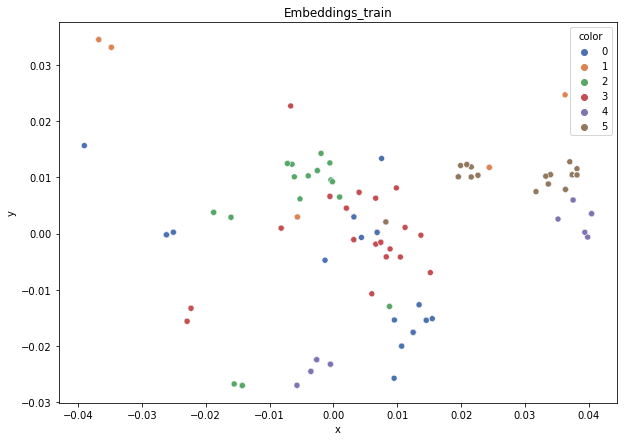

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/discriminant_analysis.py:715: UserWarning: Variables are collinear
  warnings.warn("Variables are collinear")


DT-f1-new-features: 0.761
DT-f1-old+new-features: 0.737
DT-f1-old-features: 0.802
DT-gmean-new-features: 0.759
DT-gmean-old+new-features: 0.736
DT-gmean-old-features: 0.806
KNN-f1-new-features: 0.805
KNN-f1-old+new-features: 0.785
KNN-f1-old-features: 0.785
KNN-gmean-new-features: 0.8
KNN-gmean-old+new-features: 0.796
KNN-gmean-old-features: 0.796
LDA-f1-new-features: 0.722
LDA-f1-old+new-features: 0.786
LDA-f1-old-features: 0.822
LDA-gmean-new-features: 0.715
LDA-gmean-old+new-features: 0.788
LDA-gmean-old-features: 0.822
QDA-f1-new-features: 0.742
QDA-f1-old+new-features: 0.593
QDA-f1-old-features: 0.8
QDA-gmean-new-features: 0.736
QDA-gmean-old+new-features: 0.247
QDA-gmean-old-features: 0.797
RF24-f1-new-features: 0.781
RF24-f1-old+new-features: 0.781
RF24-f1-old-features: 0.802
RF24-gmean-new-features: 0.781
RF24-gmean-old+new-features: 0.781
RF24-gmean-old-features: 0.806
new_winequality-red


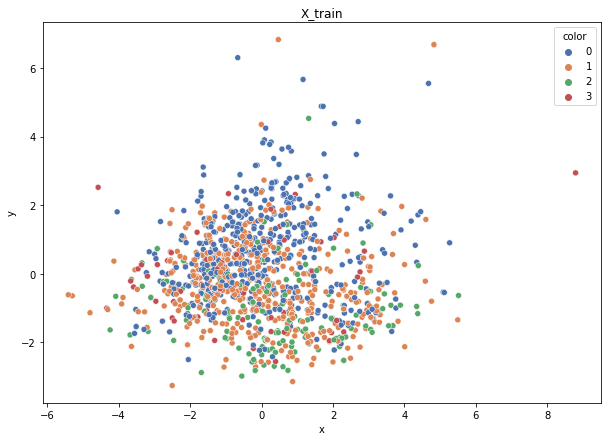

Class cardinalities: Counter({0: 544, 1: 511, 2: 159, 3: 65})
Weights: {0: 0.07217510080141348, 1: 0.07683611513888246, 2: 0.246938709660182, 3: 0.6040500743995221}


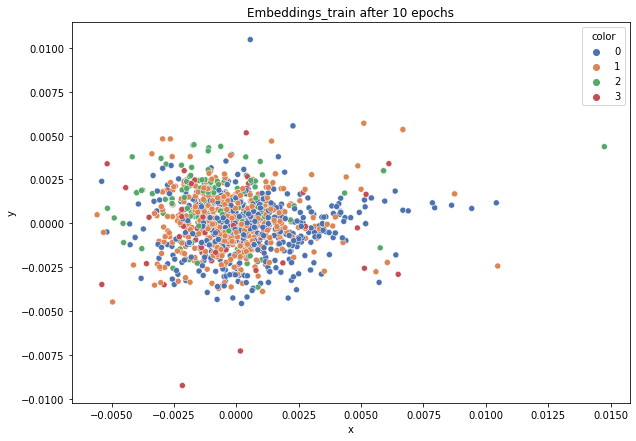

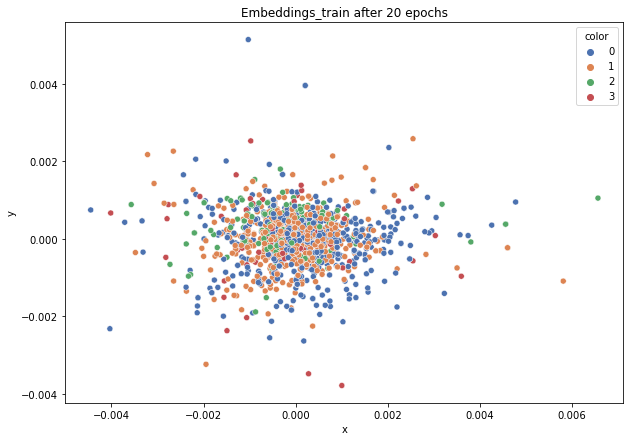

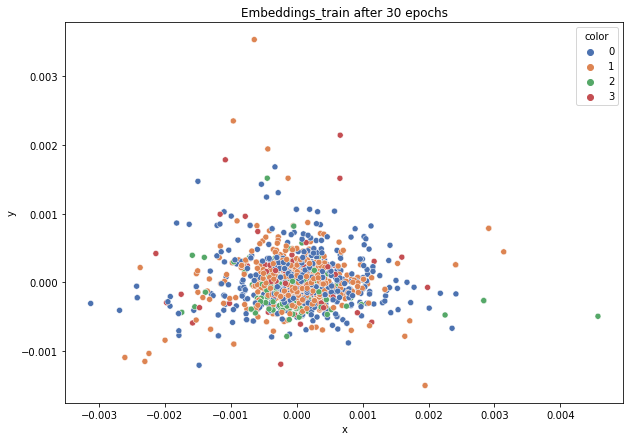

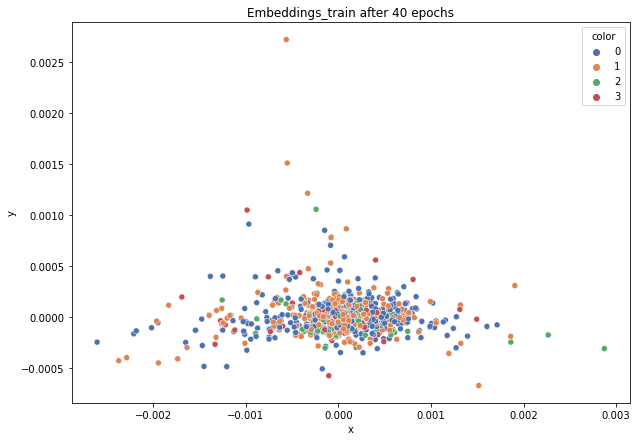

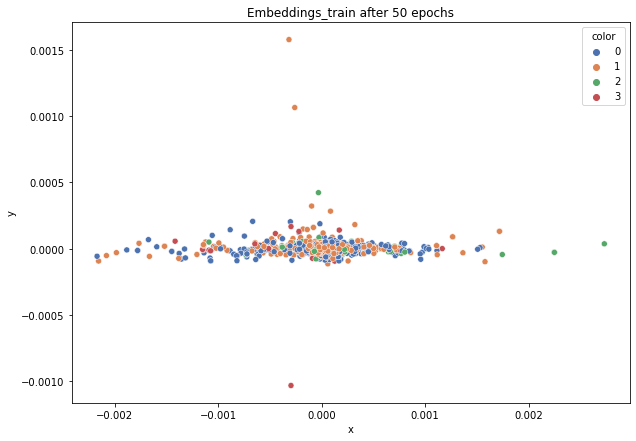

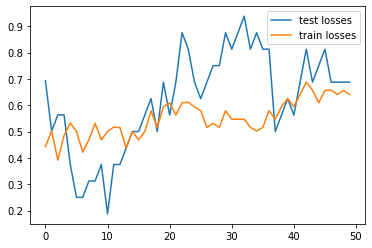

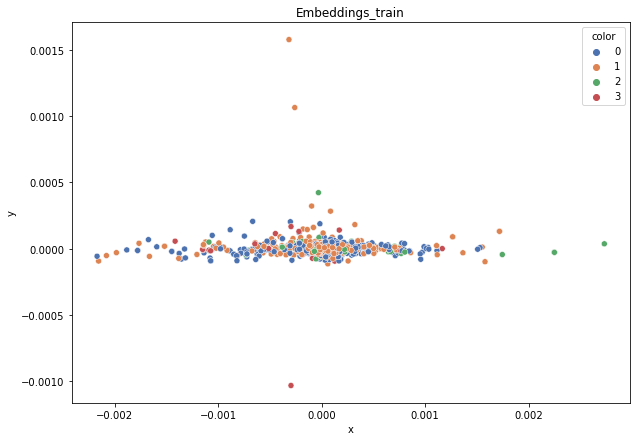

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/discriminant_analysis.py:715: UserWarning: Variables are collinear
  warnings.warn("Variables are collinear")
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/discriminant_analysis.py:715: UserWarning: Variables are collinear
  warnings.warn("Variables are collinear")


DT-f1-new-features: 0.41
DT-f1-old+new-features: 0.518
DT-f1-old-features: 0.503
DT-gmean-new-features: 0.356
DT-gmean-old+new-features: 0.473
DT-gmean-old-features: 0.368
KNN-f1-new-features: 0.488
KNN-f1-old+new-features: 0.555
KNN-f1-old-features: 0.555
KNN-gmean-new-features: 0.354
KNN-gmean-old+new-features: 0.487
KNN-gmean-old-features: 0.487
LDA-f1-new-features: 0.331
LDA-f1-old+new-features: 0.453
LDA-f1-old-features: 0.458
LDA-gmean-new-features: 0.095
LDA-gmean-old+new-features: 0.332
LDA-gmean-old-features: 0.328
QDA-f1-new-features: 0.341
QDA-f1-old+new-features: 0.403
QDA-f1-old-features: 0.403
QDA-gmean-new-features: 0.29
QDA-gmean-old+new-features: 0.114
QDA-gmean-old-features: 0.111
RF24-f1-new-features: 0.484
RF24-f1-old+new-features: 0.568
RF24-f1-old-features: 0.581
RF24-gmean-new-features: 0.128
RF24-gmean-old+new-features: 0.389
RF24-gmean-old-features: 0.402


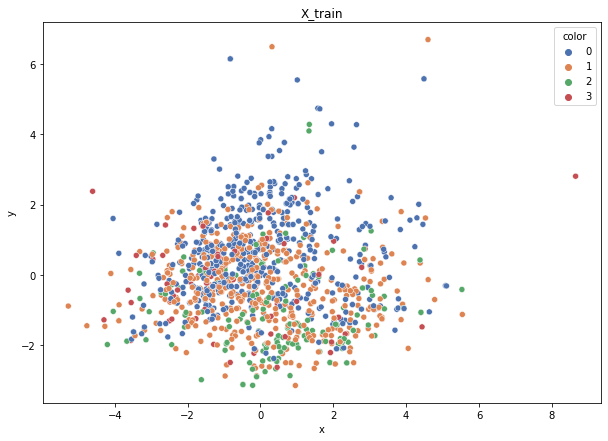

Class cardinalities: Counter({0: 545, 1: 510, 2: 159, 3: 65})
Weights: {0: 0.072041356277607, 1: 0.07698537092410943, 2: 0.24693420862450194, 3: 0.6040390641737817}


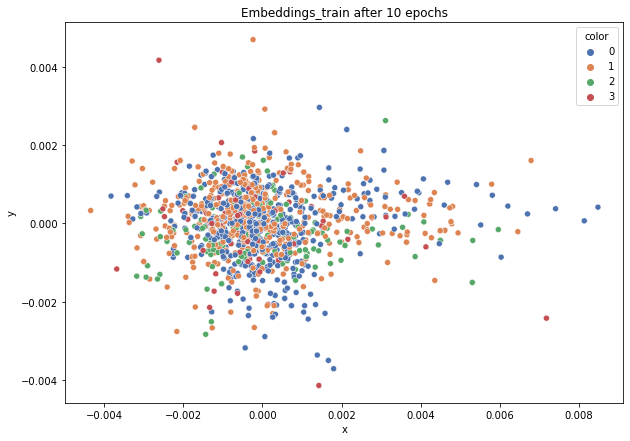

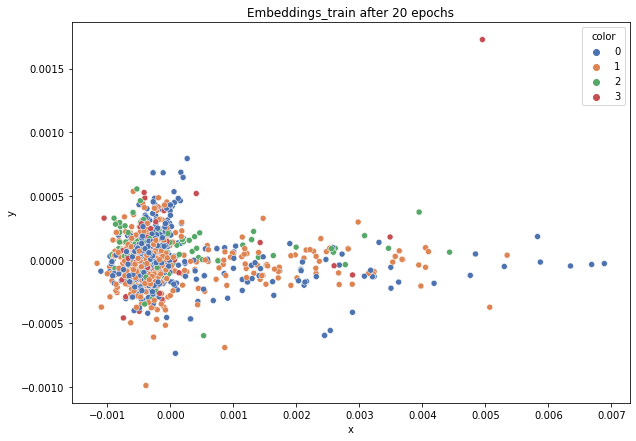

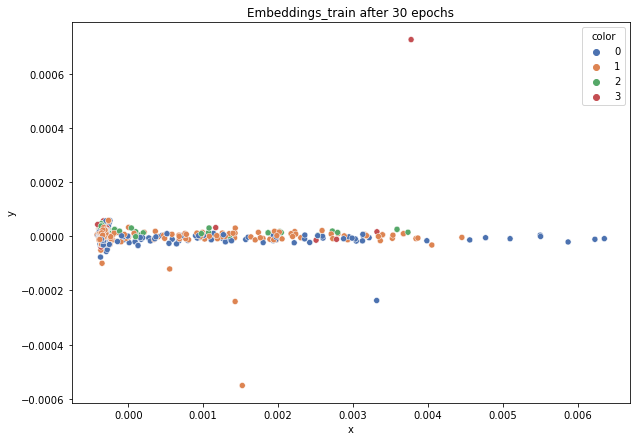

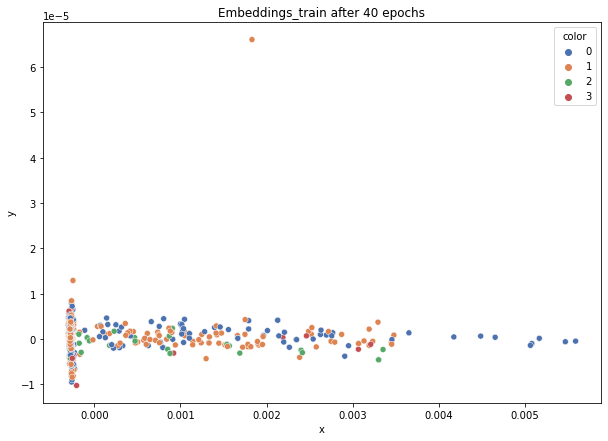

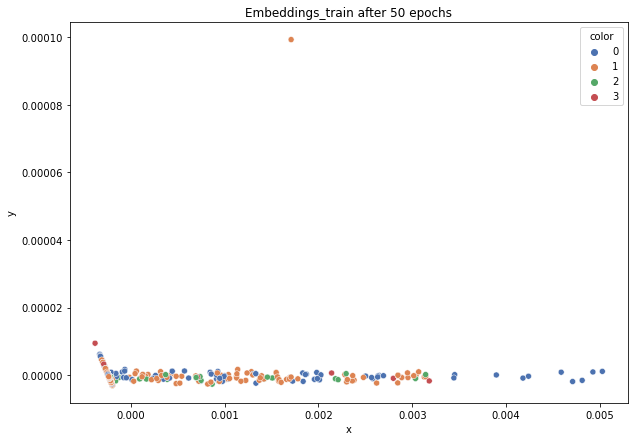

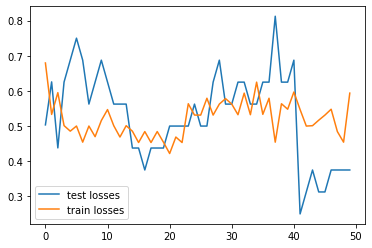

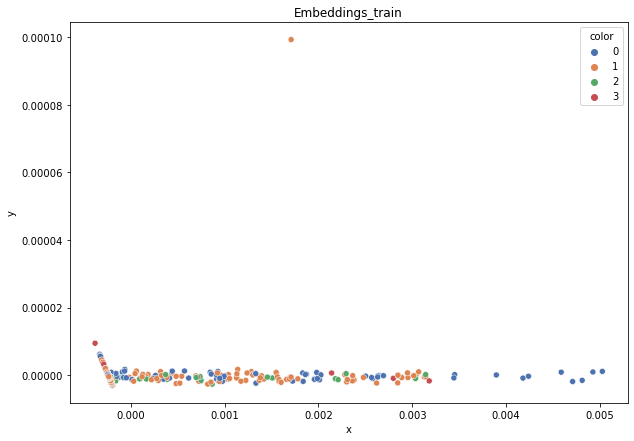

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/discriminant_analysis.py:715: UserWarning: Variables are collinear
  warnings.warn("Variables are collinear")


DT-f1-new-features: 0.281
DT-f1-old+new-features: 0.484
DT-f1-old-features: 0.505
DT-gmean-new-features: 0.329
DT-gmean-old+new-features: 0.442
DT-gmean-old-features: 0.48
KNN-f1-new-features: 0.401
KNN-f1-old+new-features: 0.555
KNN-f1-old-features: 0.555
KNN-gmean-new-features: 0.337
KNN-gmean-old+new-features: 0.512
KNN-gmean-old-features: 0.512
LDA-f1-new-features: 0.304
LDA-f1-old+new-features: 0.463
LDA-f1-old-features: 0.453
LDA-gmean-new-features: 0.066
LDA-gmean-old+new-features: 0.397
LDA-gmean-old-features: 0.348
QDA-f1-new-features: 0.264
QDA-f1-old+new-features: 0.379
QDA-f1-old-features: 0.478
QDA-gmean-new-features: 0.143
QDA-gmean-old+new-features: 0.329
QDA-gmean-old-features: 0.421
RF24-f1-new-features: 0.356
RF24-f1-old+new-features: 0.587
RF24-f1-old-features: 0.558
RF24-gmean-new-features: 0.353
RF24-gmean-old+new-features: 0.457
RF24-gmean-old-features: 0.439


/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/discriminant_analysis.py:715: UserWarning: Variables are collinear
  warnings.warn("Variables are collinear")


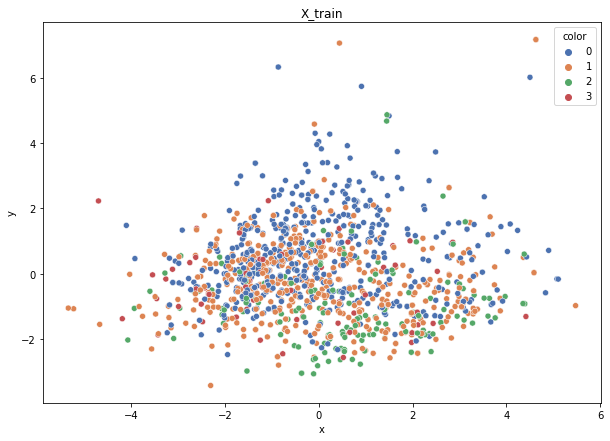

Class cardinalities: Counter({0: 545, 1: 510, 2: 159, 3: 65})
Weights: {0: 0.072041356277607, 1: 0.07698537092410943, 2: 0.24693420862450194, 3: 0.6040390641737817}


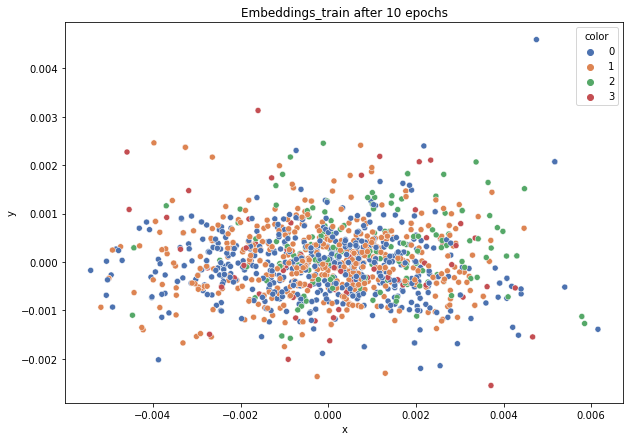

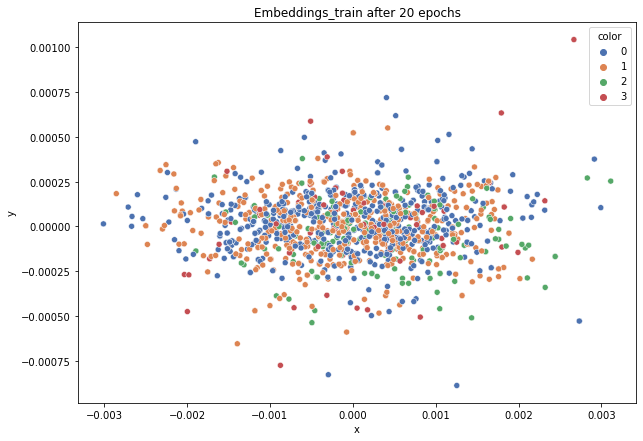

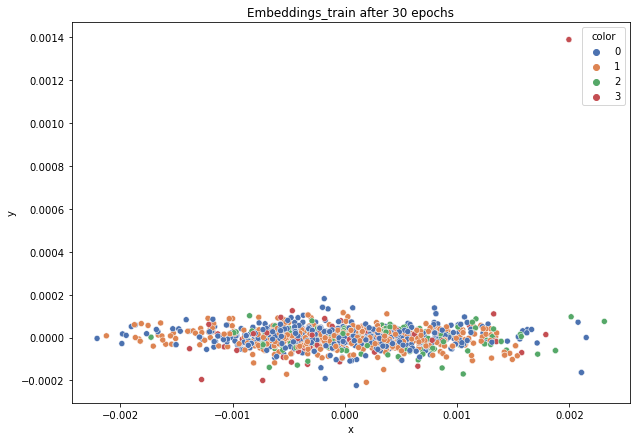

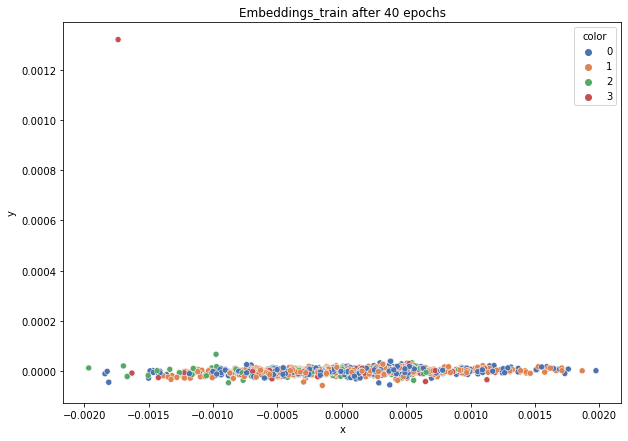

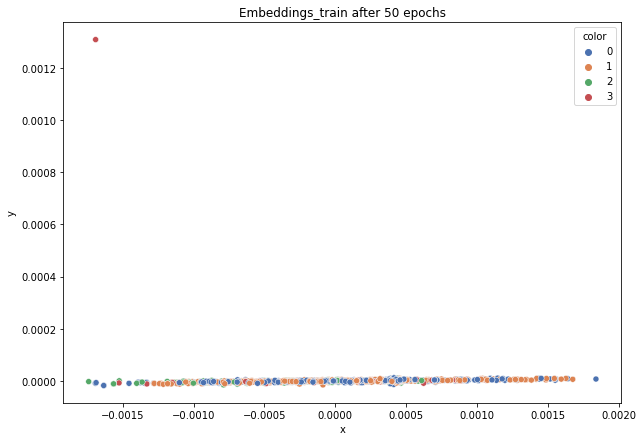

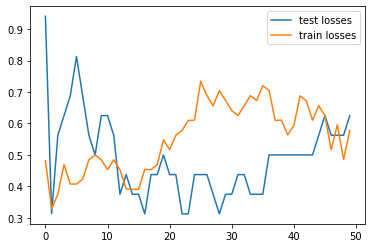

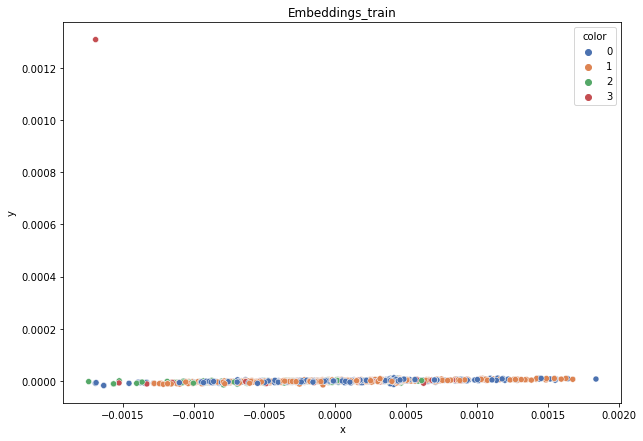

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/discriminant_analysis.py:715: UserWarning: Variables are collinear
  warnings.warn("Variables are collinear")
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/discriminant_analysis.py:715: UserWarning: Variables are collinear
  warnings.warn("Variables are collinear")


DT-f1-new-features: 0.413
DT-f1-old+new-features: 0.478
DT-f1-old-features: 0.514
DT-gmean-new-features: 0.375
DT-gmean-old+new-features: 0.454
DT-gmean-old-features: 0.468
KNN-f1-new-features: 0.432
KNN-f1-old+new-features: 0.544
KNN-f1-old-features: 0.544
KNN-gmean-new-features: 0.316
KNN-gmean-old+new-features: 0.516
KNN-gmean-old-features: 0.516
LDA-f1-new-features: 0.33
LDA-f1-old+new-features: 0.413
LDA-f1-old-features: 0.445
LDA-gmean-new-features: 0.091
LDA-gmean-old+new-features: 0.312
LDA-gmean-old-features: 0.321
QDA-f1-new-features: 0.411
QDA-f1-old+new-features: 0.444
QDA-f1-old-features: 0.42
QDA-gmean-new-features: 0.341
QDA-gmean-old+new-features: 0.337
QDA-gmean-old-features: 0.306
RF24-f1-new-features: 0.451
RF24-f1-old+new-features: 0.539
RF24-f1-old-features: 0.515
RF24-gmean-new-features: 0.123
RF24-gmean-old+new-features: 0.385
RF24-gmean-old-features: 0.138


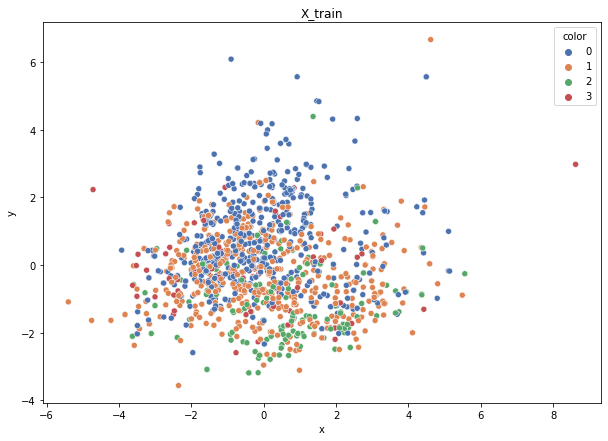

Class cardinalities: Counter({0: 545, 1: 510, 2: 160, 3: 64})
Weights: {0: 0.07147706120661339, 2: 0.24346873973502686, 3: 0.6086718493375671, 1: 0.07638234972079273}


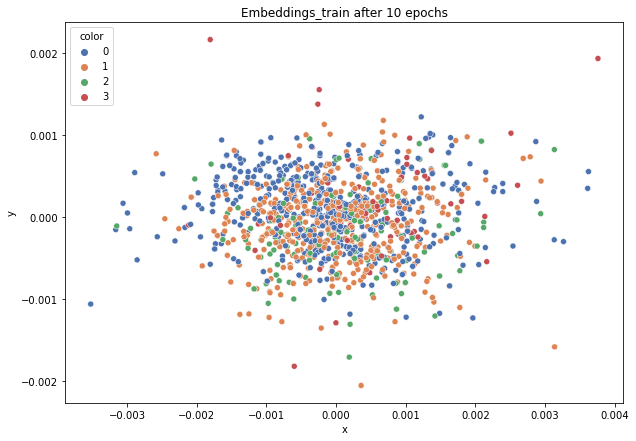

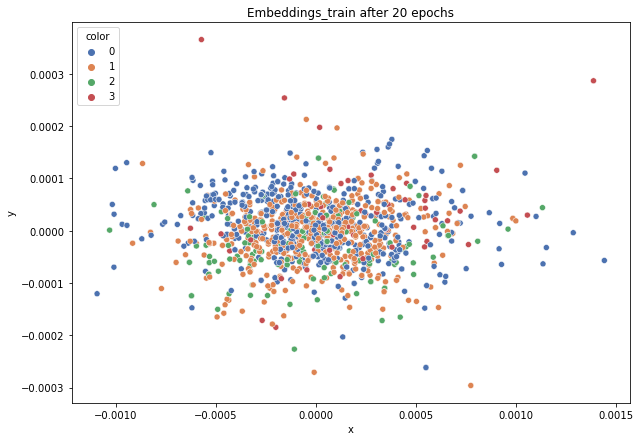

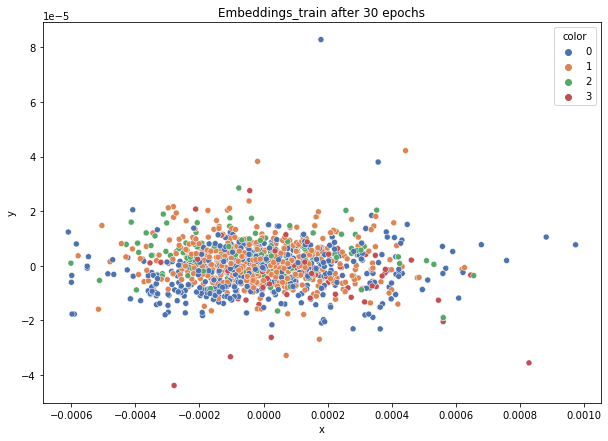

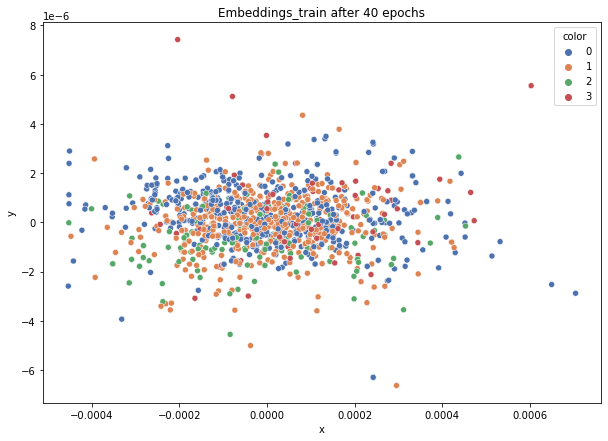

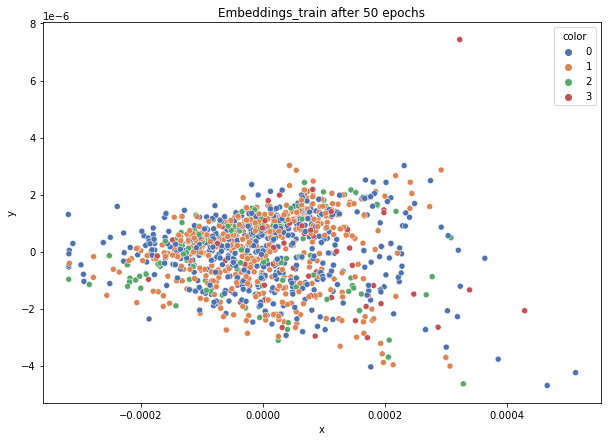

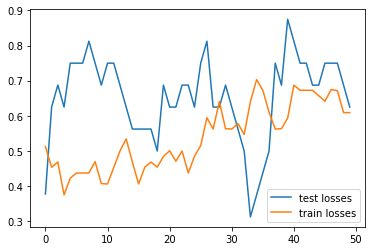

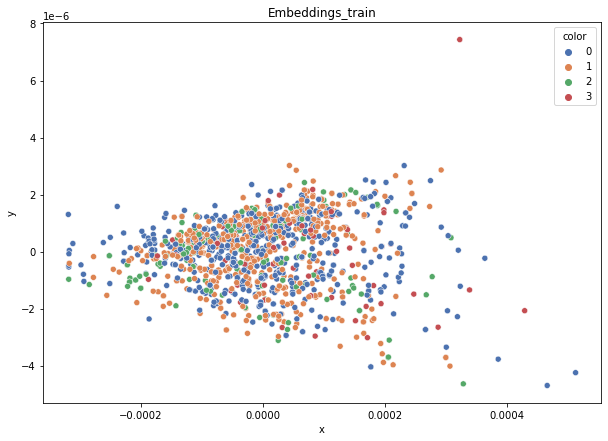

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/discriminant_analysis.py:715: UserWarning: Variables are collinear
  warnings.warn("Variables are collinear")
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/discriminant_analysis.py:715: UserWarning: Variables are collinear
  warnings.warn("Variables are collinear")


DT-f1-new-features: 0.399
DT-f1-old+new-features: 0.471
DT-f1-old-features: 0.427
DT-gmean-new-features: 0.388
DT-gmean-old+new-features: 0.438
DT-gmean-old-features: 0.378
KNN-f1-new-features: 0.412
KNN-f1-old+new-features: 0.486
KNN-f1-old-features: 0.486
KNN-gmean-new-features: 0.338
KNN-gmean-old+new-features: 0.421
KNN-gmean-old-features: 0.421
LDA-f1-new-features: 0.415
LDA-f1-old+new-features: 0.42
LDA-f1-old-features: 0.411
LDA-gmean-new-features: 0.335
LDA-gmean-old+new-features: 0.351
LDA-gmean-old-features: 0.11
QDA-f1-new-features: 0.404
QDA-f1-old+new-features: 0.409
QDA-f1-old-features: 0.418
QDA-gmean-new-features: 0.288
QDA-gmean-old+new-features: 0.308
QDA-gmean-old-features: 0.361
RF24-f1-new-features: 0.431
RF24-f1-old+new-features: 0.532
RF24-f1-old-features: 0.513
RF24-gmean-new-features: 0.353
RF24-gmean-old+new-features: 0.438
RF24-gmean-old-features: 0.401


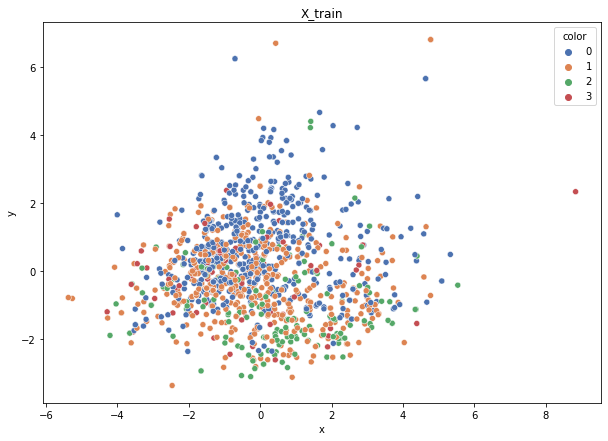

Class cardinalities: Counter({0: 545, 1: 511, 2: 159, 3: 65})
Weights: {0: 0.07205221139741194, 1: 0.07684629199919668, 2: 0.24697141642509127, 3: 0.6041300801783002}


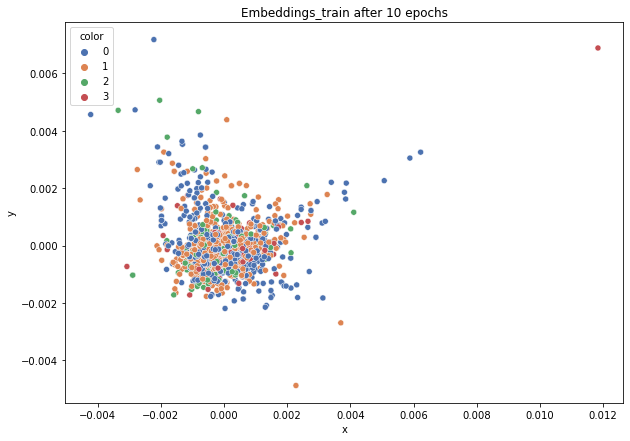

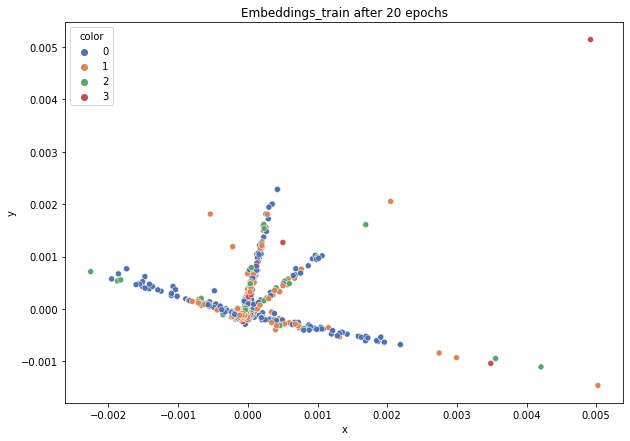

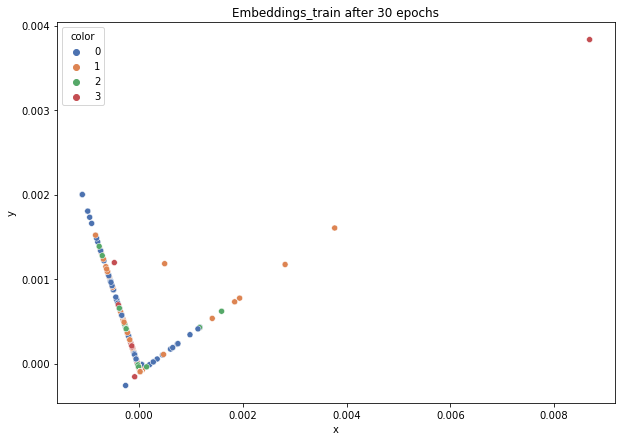

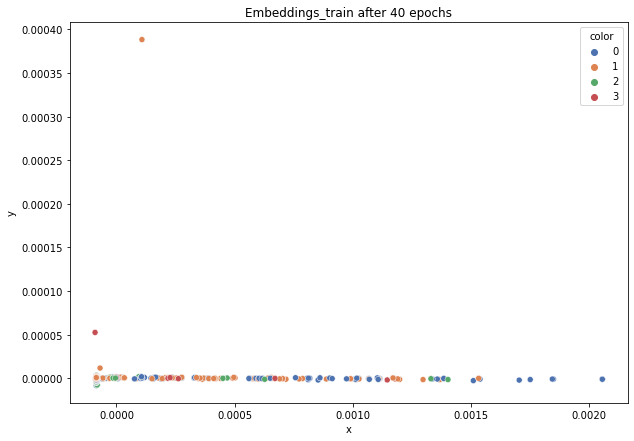

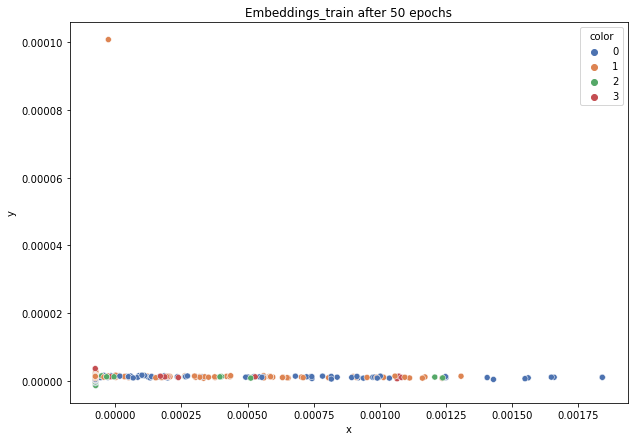

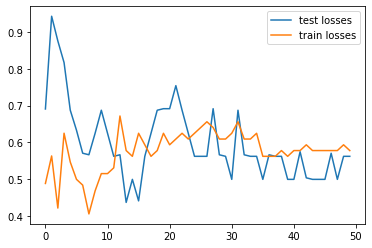

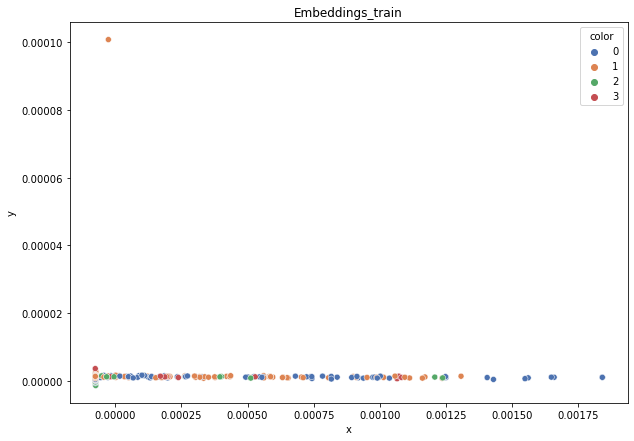

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/discriminant_analysis.py:715: UserWarning: Variables are collinear
  warnings.warn("Variables are collinear")


DT-f1-new-features: 0.132
DT-f1-old+new-features: 0.469
DT-f1-old-features: 0.463
DT-gmean-new-features: 0.051
DT-gmean-old+new-features: 0.434
DT-gmean-old-features: 0.399
KNN-f1-new-features: 0.472
KNN-f1-old+new-features: 0.537
KNN-f1-old-features: 0.537
KNN-gmean-new-features: 0.393
KNN-gmean-old+new-features: 0.437
KNN-gmean-old-features: 0.437
LDA-f1-new-features: 0.395
LDA-f1-old+new-features: 0.522
LDA-f1-old-features: 0.512
LDA-gmean-new-features: 0.325
LDA-gmean-old+new-features: 0.492
LDA-gmean-old-features: 0.431
QDA-f1-new-features: 0.331
QDA-f1-old+new-features: 0.413
QDA-f1-old-features: 0.512
QDA-gmean-new-features: 0.271
QDA-gmean-old+new-features: 0.387
QDA-gmean-old-features: 0.449
RF24-f1-new-features: 0.171
RF24-f1-old+new-features: 0.588
RF24-f1-old-features: 0.608
RF24-gmean-new-features: 0.062
RF24-gmean-old+new-features: 0.467
RF24-gmean-old-features: 0.472
thyroid-newthyroid


/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/discriminant_analysis.py:715: UserWarning: Variables are collinear
  warnings.warn("Variables are collinear")


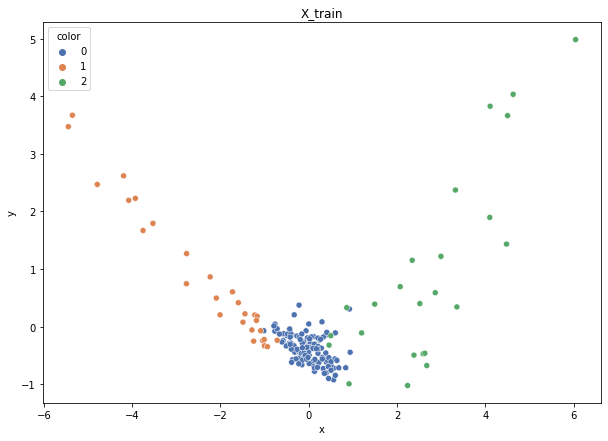

Class cardinalities: Counter({0: 120, 1: 28, 2: 24})
Weights: {0: 0.09722222222222222, 1: 0.41666666666666663, 2: 0.4861111111111111}


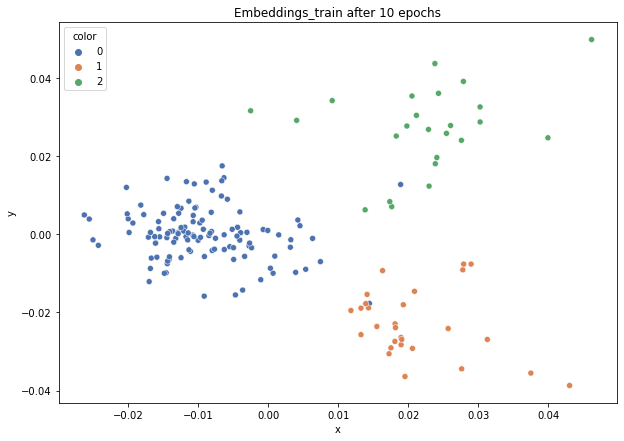

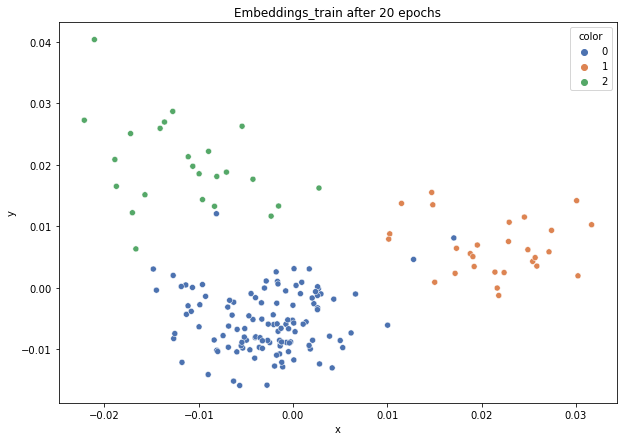

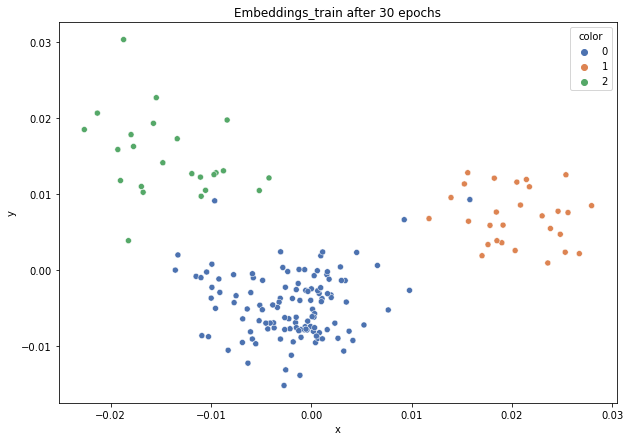

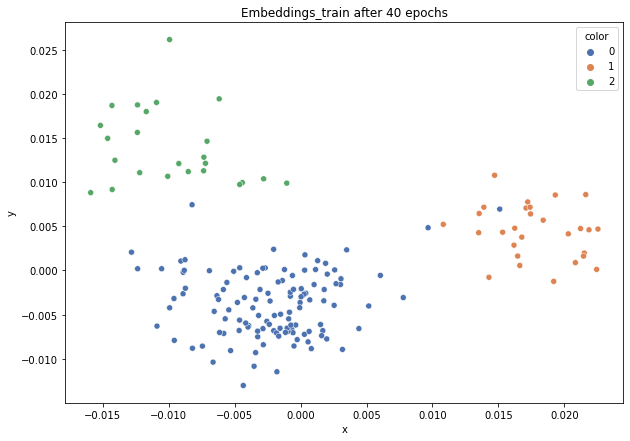

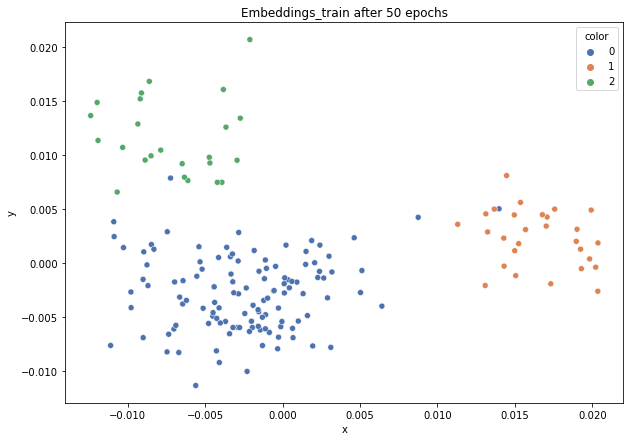

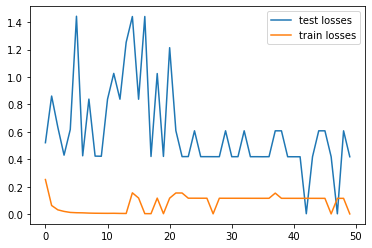

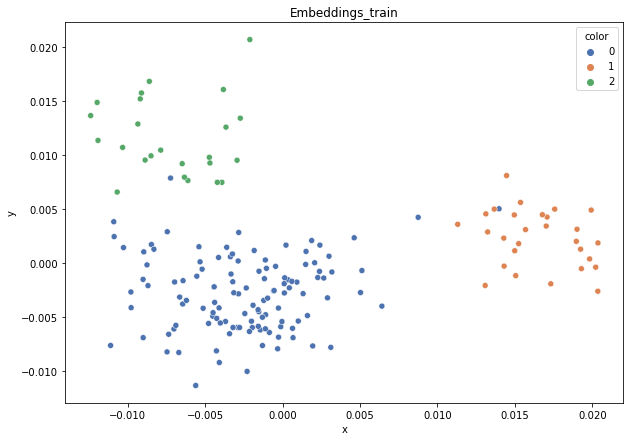

DT-f1-new-features: 0.674
DT-f1-old+new-features: 0.674
DT-f1-old-features: 0.902
DT-gmean-new-features: 0.523
DT-gmean-old+new-features: 0.523
DT-gmean-old-features: 0.884
KNN-f1-new-features: 0.842
KNN-f1-old+new-features: 0.964
KNN-f1-old-features: 0.964
KNN-gmean-new-features: 0.754
KNN-gmean-old+new-features: 0.941
KNN-gmean-old-features: 0.941
LDA-f1-new-features: 0.842
LDA-f1-old+new-features: 0.892
LDA-f1-old-features: 0.898
LDA-gmean-new-features: 0.754
LDA-gmean-old+new-features: 0.83
LDA-gmean-old-features: 0.841
QDA-f1-new-features: 0.825
QDA-f1-old+new-features: 0.906
QDA-f1-old-features: 0.964
QDA-gmean-new-features: 0.754
QDA-gmean-old+new-features: 0.884
QDA-gmean-old-features: 0.941
RF24-f1-new-features: 0.808
RF24-f1-old+new-features: 0.808
RF24-f1-old-features: 0.933
RF24-gmean-new-features: 0.709
RF24-gmean-old+new-features: 0.709
RF24-gmean-old-features: 0.894


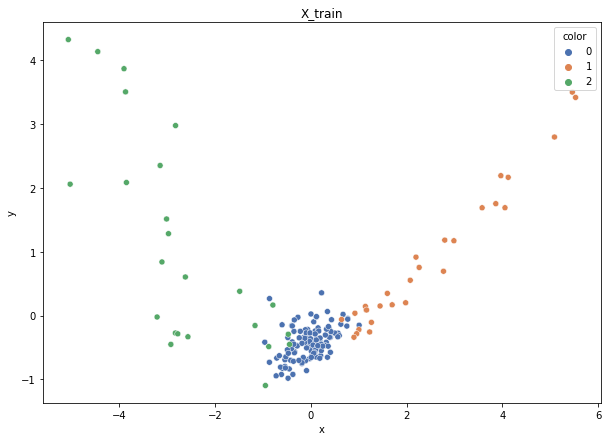

Class cardinalities: Counter({0: 120, 1: 28, 2: 24})
Weights: {0: 0.09722222222222222, 1: 0.41666666666666663, 2: 0.4861111111111111}


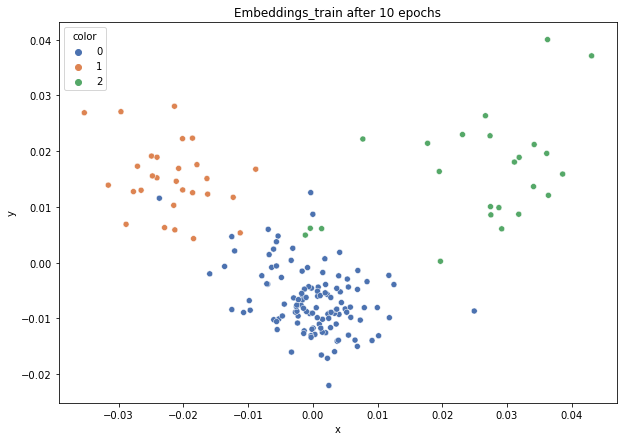

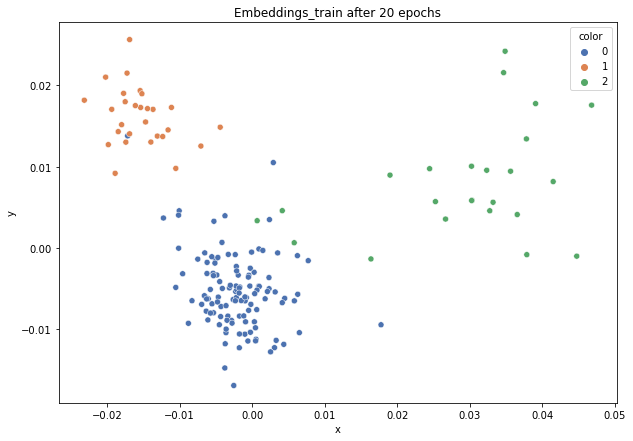

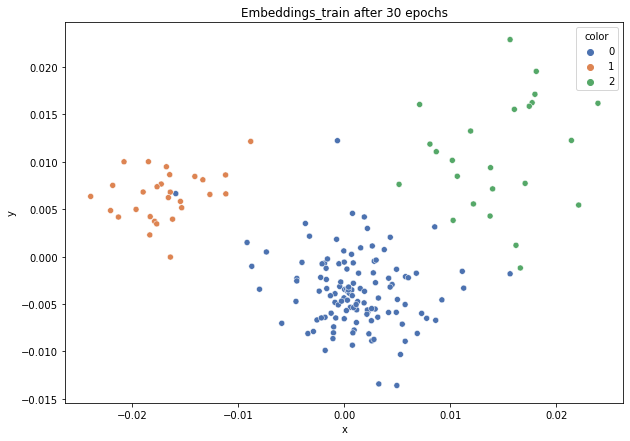

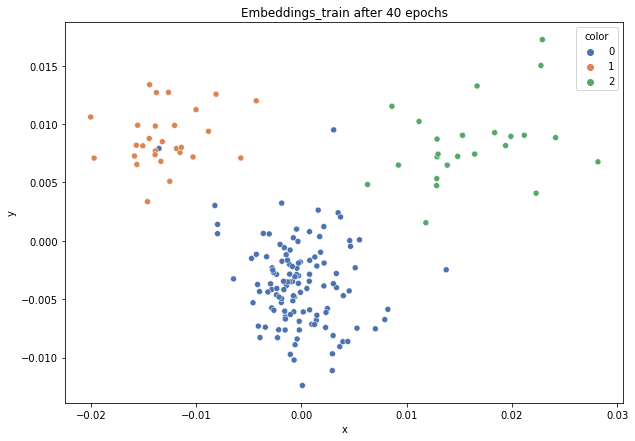

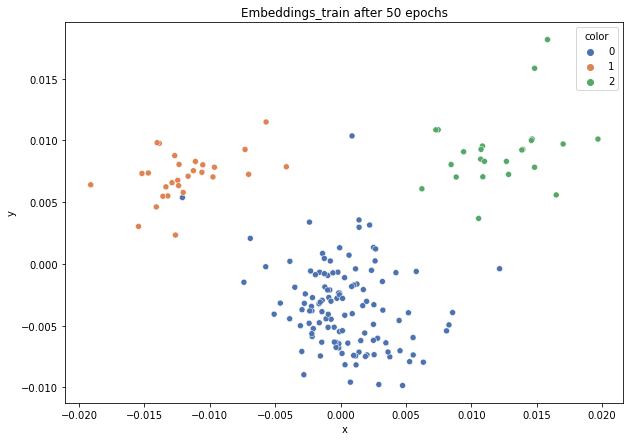

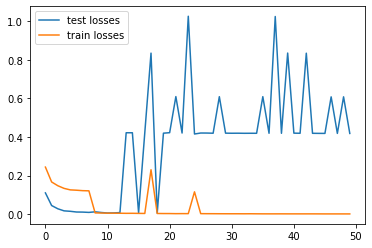

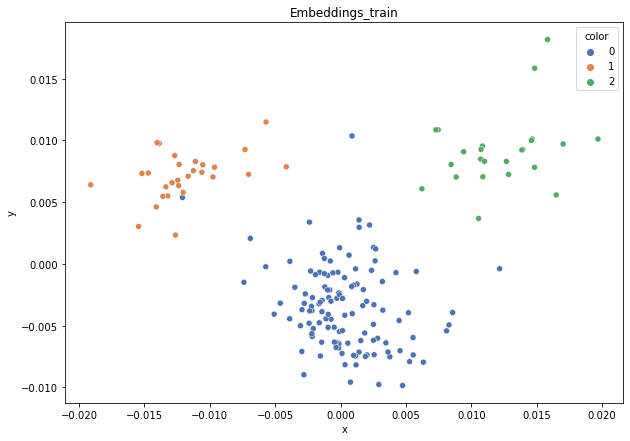

DT-f1-new-features: 0.906
DT-f1-old+new-features: 0.906
DT-f1-old-features: 0.947
DT-gmean-new-features: 0.92
DT-gmean-old+new-features: 0.92
DT-gmean-old-features: 0.977
KNN-f1-new-features: 0.845
KNN-f1-old+new-features: 0.972
KNN-f1-old-features: 0.972
KNN-gmean-new-features: 0.821
KNN-gmean-old+new-features: 0.989
KNN-gmean-old-features: 0.989
LDA-f1-new-features: 0.933
LDA-f1-old+new-features: 0.964
LDA-f1-old-features: 0.933
LDA-gmean-new-features: 0.93
LDA-gmean-old+new-features: 0.941
LDA-gmean-old-features: 0.894
QDA-f1-new-features: 0.857
QDA-f1-old+new-features: 0.934
QDA-f1-old-features: 0.969
QDA-gmean-new-features: 0.781
QDA-gmean-old+new-features: 0.894
QDA-gmean-old-features: 0.989
RF24-f1-new-features: 0.875
RF24-f1-old+new-features: 0.964
RF24-f1-old-features: 0.969
RF24-gmean-new-features: 0.874
RF24-gmean-old+new-features: 0.941
RF24-gmean-old-features: 0.95


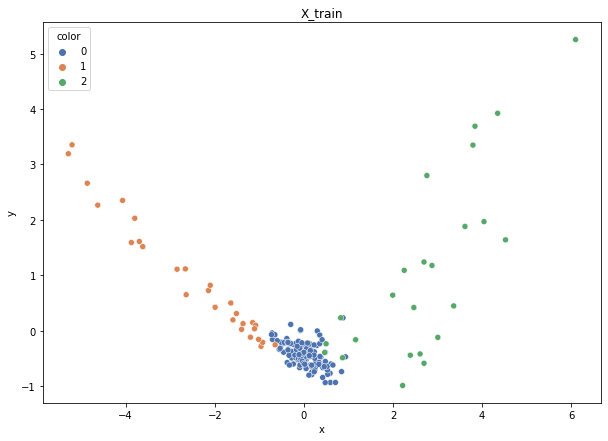

Class cardinalities: Counter({0: 120, 1: 28, 2: 24})
Weights: {0: 0.09722222222222222, 1: 0.41666666666666663, 2: 0.4861111111111111}


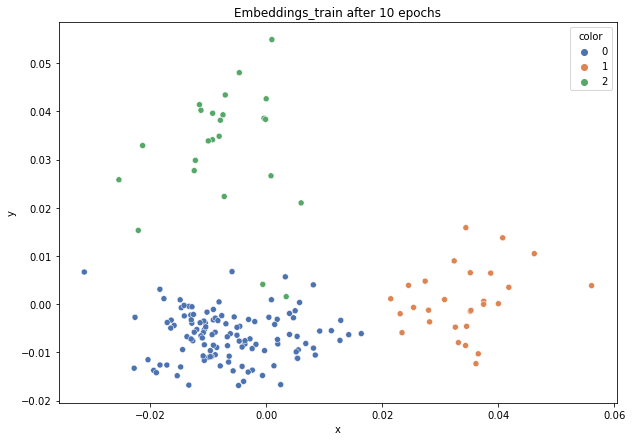

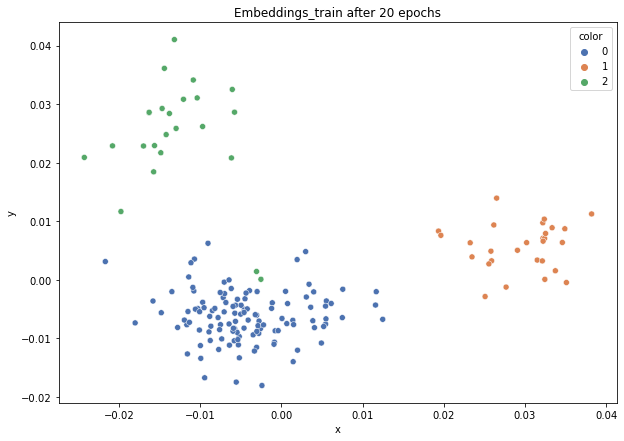

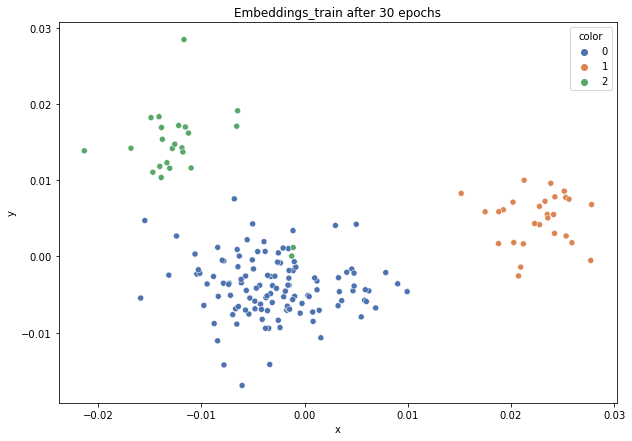

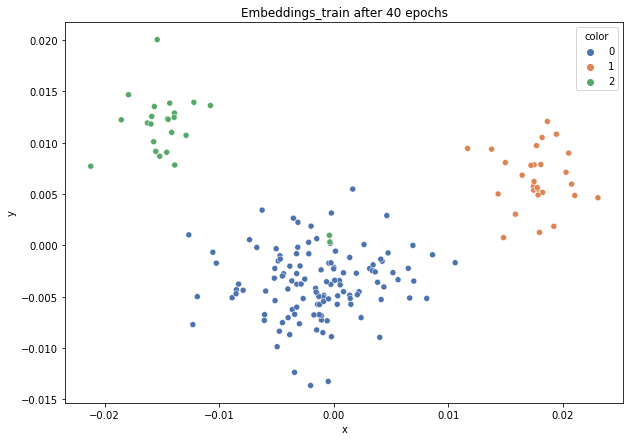

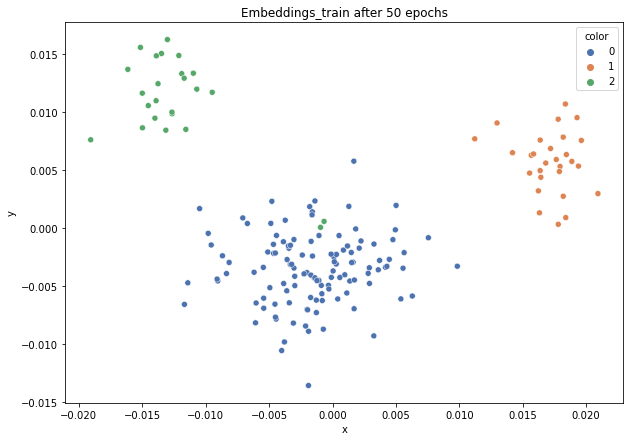

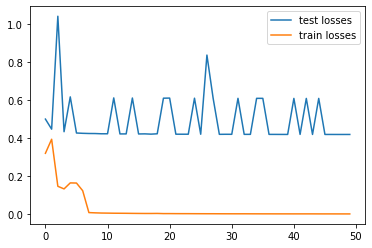

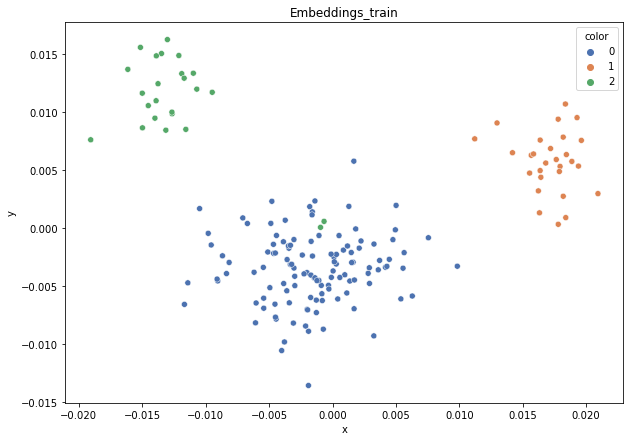

DT-f1-new-features: 0.895
DT-f1-old+new-features: 0.905
DT-f1-old-features: 0.905
DT-gmean-new-features: 0.864
DT-gmean-old+new-features: 0.92
DT-gmean-old-features: 0.92
KNN-f1-new-features: 0.895
KNN-f1-old+new-features: 0.902
KNN-f1-old-features: 0.902
KNN-gmean-new-features: 0.864
KNN-gmean-old+new-features: 0.884
KNN-gmean-old-features: 0.884
LDA-f1-new-features: 0.936
LDA-f1-old+new-features: 0.936
LDA-f1-old-features: 0.817
LDA-gmean-new-features: 0.93
LDA-gmean-old+new-features: 0.93
LDA-gmean-old-features: 0.725
QDA-f1-new-features: 0.895
QDA-f1-old+new-features: 0.936
QDA-f1-old-features: 0.936
QDA-gmean-new-features: 0.864
QDA-gmean-old+new-features: 0.93
QDA-gmean-old-features: 0.93
RF24-f1-new-features: 0.972
RF24-f1-old+new-features: 0.972
RF24-f1-old-features: 0.933
RF24-gmean-new-features: 0.989
RF24-gmean-old+new-features: 0.989
RF24-gmean-old-features: 0.894


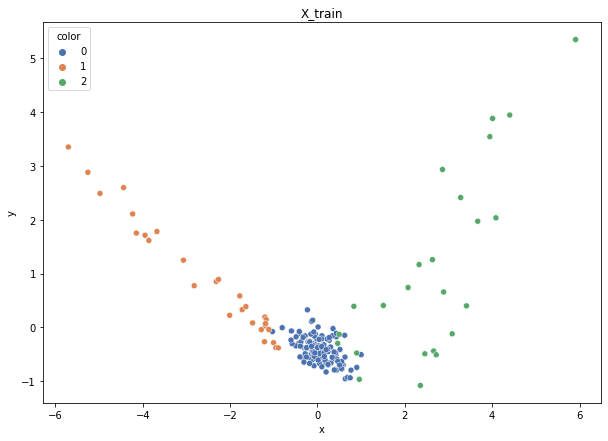

Class cardinalities: Counter({0: 120, 1: 28, 2: 24})
Weights: {0: 0.09722222222222222, 1: 0.41666666666666663, 2: 0.4861111111111111}


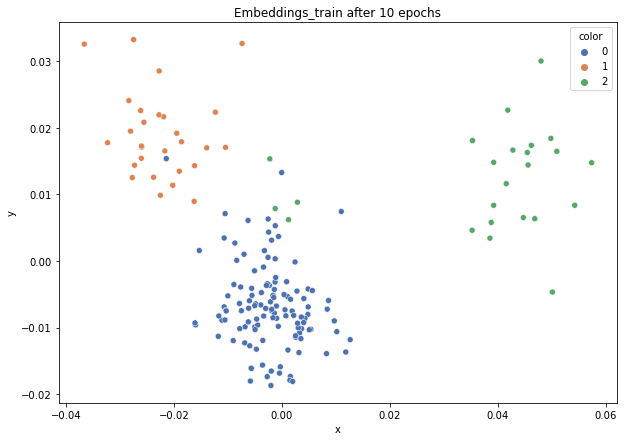

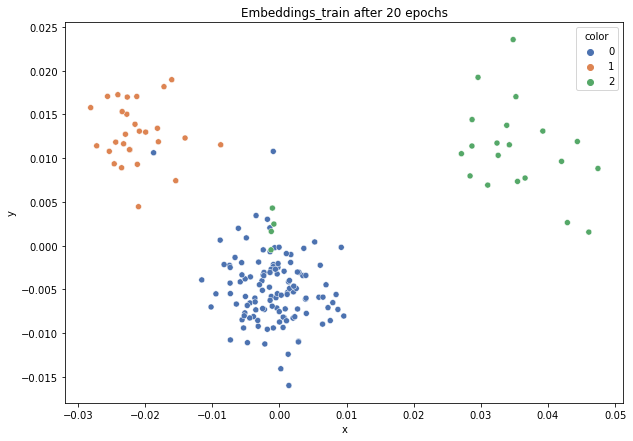

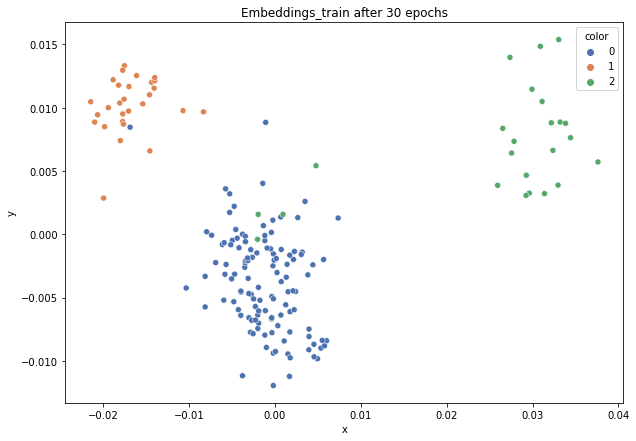

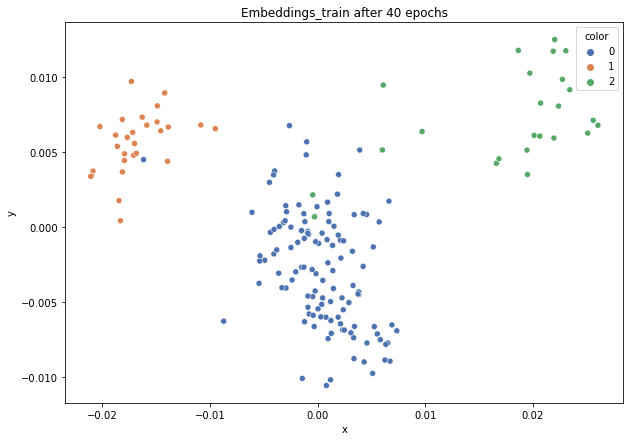

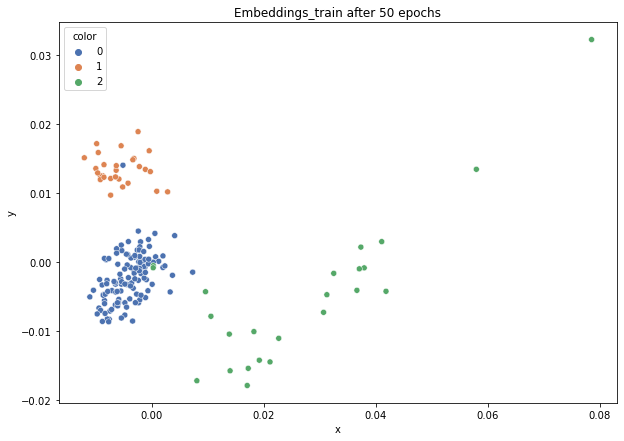

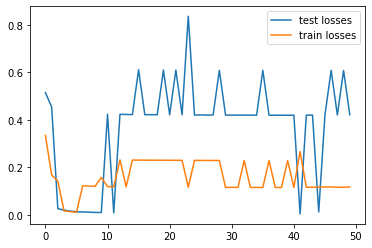

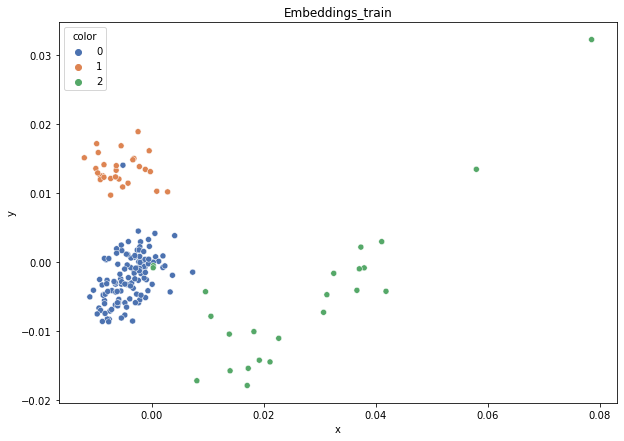

DT-f1-new-features: 0.645
DT-f1-old+new-features: 0.645
DT-f1-old-features: 0.902
DT-gmean-new-features: 0.562
DT-gmean-old+new-features: 0.562
DT-gmean-old-features: 0.884
KNN-f1-new-features: 0.809
KNN-f1-old+new-features: 0.941
KNN-f1-old-features: 0.941
KNN-gmean-new-features: 0.763
KNN-gmean-old+new-features: 0.977
KNN-gmean-old-features: 0.977
LDA-f1-new-features: 0.809
LDA-f1-old+new-features: 0.941
LDA-f1-old-features: 0.898
LDA-gmean-new-features: 0.763
LDA-gmean-old+new-features: 0.939
LDA-gmean-old-features: 0.841
QDA-f1-new-features: 0.813
QDA-f1-old+new-features: 0.902
QDA-f1-old-features: 0.969
QDA-gmean-new-features: 0.801
QDA-gmean-old+new-features: 0.884
QDA-gmean-old-features: 0.989
RF24-f1-new-features: 0.832
RF24-f1-old+new-features: 0.858
RF24-f1-old-features: 0.902
RF24-gmean-new-features: 0.772
RF24-gmean-old+new-features: 0.781
RF24-gmean-old-features: 0.884


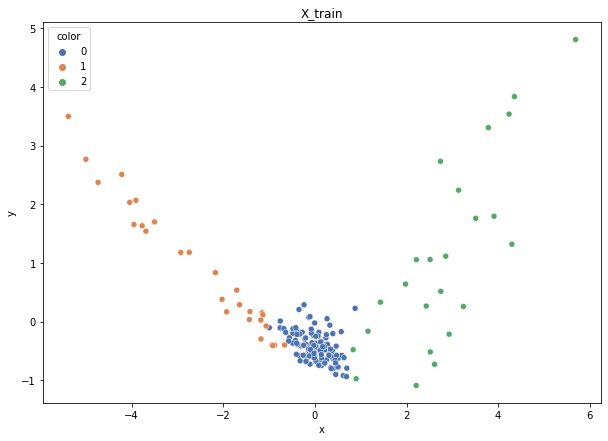

Class cardinalities: Counter({0: 120, 1: 28, 2: 24})
Weights: {0: 0.09722222222222222, 1: 0.41666666666666663, 2: 0.4861111111111111}


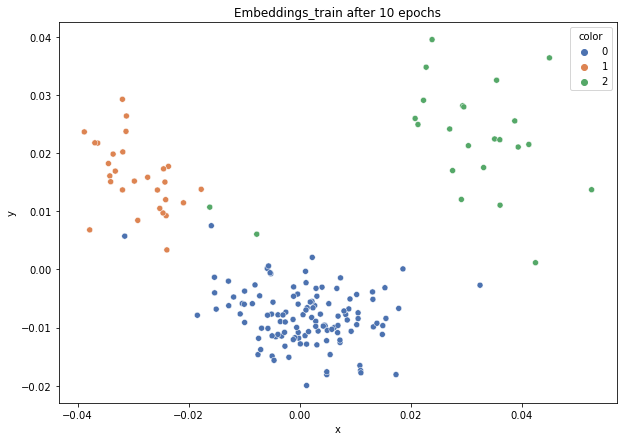

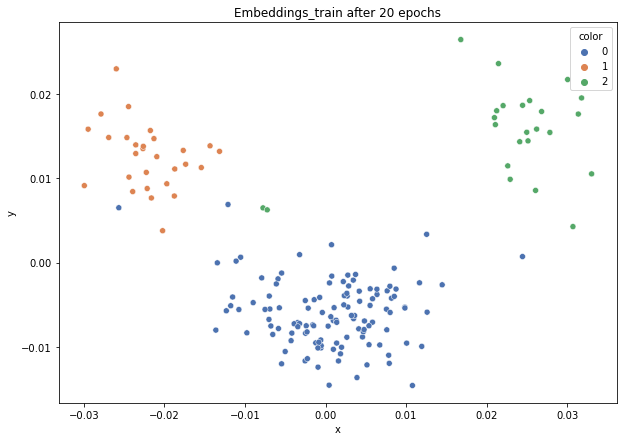

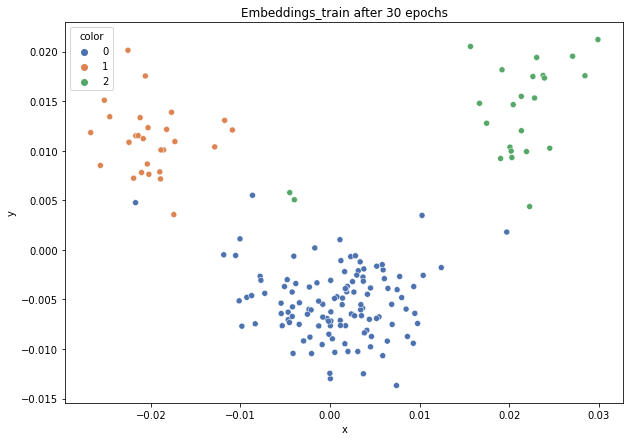

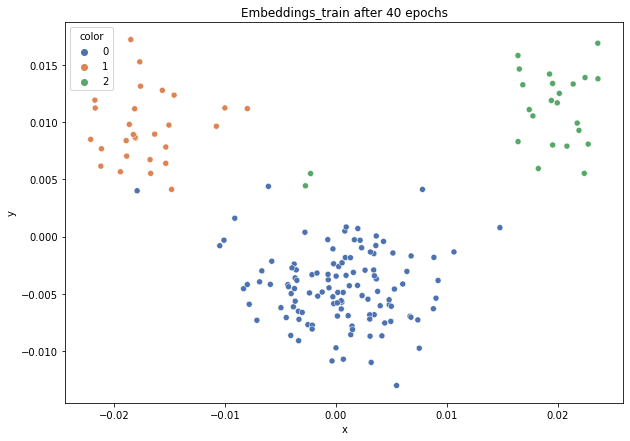

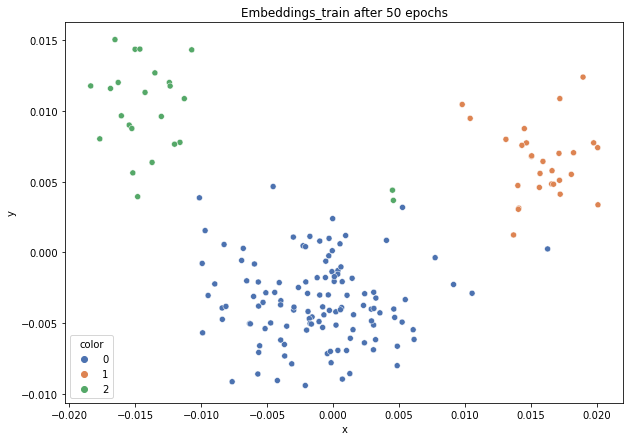

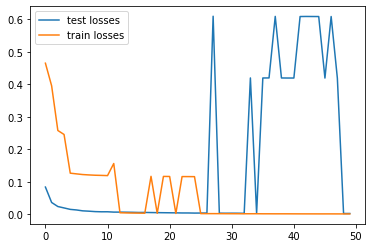

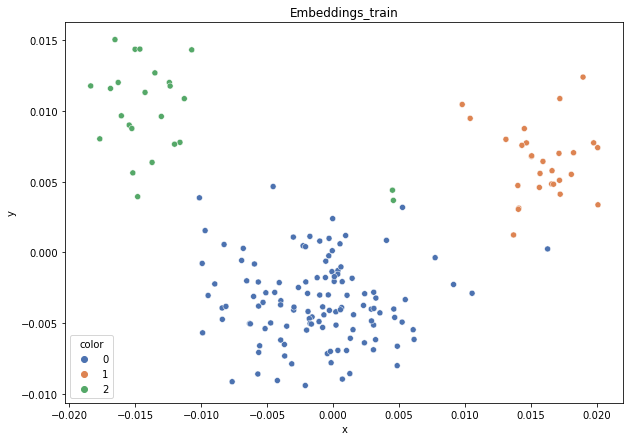

DT-f1-new-features: 0.771
DT-f1-old+new-features: 0.771
DT-f1-old-features: 0.893
DT-gmean-new-features: 0.686
DT-gmean-old+new-features: 0.686
DT-gmean-old-features: 0.864
KNN-f1-new-features: 0.845
KNN-f1-old+new-features: 0.873
KNN-f1-old-features: 0.873
KNN-gmean-new-features: 0.785
KNN-gmean-old+new-features: 0.794
KNN-gmean-old-features: 0.794
LDA-f1-new-features: 0.873
LDA-f1-old+new-features: 0.923
LDA-f1-old-features: 0.721
LDA-gmean-new-features: 0.794
LDA-gmean-old+new-features: 0.874
LDA-gmean-old-features: 0.598
QDA-f1-new-features: 0.845
QDA-f1-old+new-features: 0.873
QDA-f1-old-features: 0.895
QDA-gmean-new-features: 0.785
QDA-gmean-old+new-features: 0.794
QDA-gmean-old-features: 0.864
RF24-f1-new-features: 0.785
RF24-f1-old+new-features: 0.873
RF24-f1-old-features: 0.923
RF24-gmean-new-features: 0.686
RF24-gmean-old+new-features: 0.794
RF24-gmean-old-features: 0.874


In [12]:
result_dict = defaultdict(list)

safety_dict = defaultdict(list)

if test_all_ds:
    ds_names = dt_name_to_cols_to_encode.keys()
else:
    ds_names = [ds_name]
for dataset_name in ds_names:
# for dataset_name in list(datasets.keys()):
    print(dataset_name)
    result_dict["dataset"].append(dataset_name)
    fold_result_dict = defaultdict(list)

    safety_dict["dataset"].append(dataset_name)
    fold_safety_dict = defaultdict(list)

    X, y = datasets[dataset_name]['data'], datasets[dataset_name]['target']
    X_encoded, y = datasets[f"{dataset_name}_encoded"]['data'], datasets[f"{dataset_name}_encoded"]['target']

    skf = StratifiedKFold(n_splits=5, random_state=0, shuffle=True)
    n_splits = skf.get_n_splits(X, y)

    folds = []
    if test_on_all_folds:
        folds = skf.split(X, y)
    else:
        folds = list(skf.split(X, y))[1:2]

    for train_index, test_index in folds:
        try:
            X_train, X_test = X[train_index], X[test_index]
            X_train_norm, X_test_norm = standardize(X_train, X_test)
            y_train, y_test = y[train_index], y[test_index]


            X_train_enc, X_test_enc = X_encoded[train_index], X_encoded[test_index]
            X_train_enc, X_test_enc = standardize(X_train_enc, X_test_enc)


            # PCA X_train
            pca = PCA(n_components=2)
            pca.fit(X_train_enc)
            plot_embeddings(pca.transform(X_train_enc), y_train)
            plt.title("X_train")
            plt.show()

            weights = ex.weights_calculation_strategy1(X_train, y_train)
            cfg =  config[dataset_name]
            # pretrain ANN triplets
            embeddings_train, embeddings_test = ex.train_triplets(X_train_enc, y_train, X_test_enc, y_test, weights,cfg, pca)

            s_dict = calc_safety5(embeddings_test, y_test)
            for k, v in s_dict.items():
                fold_safety_dict[f"emb-{k}"].append(v)

            s_dict = calc_safety5(X_test_enc, y_test)
            for k,v in s_dict.items():
                fold_safety_dict[f"raw-{k}"].append(v)

            # PCA embeddings_train
            pca = PCA(n_components=2)
            plot_embeddings(pca.fit_transform(embeddings_train), y_train)
            plt.title("Embeddings_train")
            plt.show()

            X_train_new = np.hstack([X_train_norm, embeddings_train])
            X_test_new = np.hstack([X_test_norm, embeddings_test])

            classifiers = instantiate_classifiers()
            for clf_name, clf in classifiers.items():
                clf.fit(X_train_norm, y_train)
                preds = clf.predict(X_test_norm)

                gmean = gmean_score(y_test, preds)
                f1 = f1_score(y_test, preds, average='macro')
                fold_result_dict[f"{clf_name}-f1-old-features"].append(f1)
                fold_result_dict[f"{clf_name}-gmean-old-features"].append(gmean)

            classifiers = instantiate_classifiers()
            for clf_name, clf in classifiers.items():
                clf.fit(X_train_new, y_train)
                preds = clf.predict(X_test_new)

                gmean = gmean_score(y_test, preds)
                f1 = f1_score(y_test, preds, average='macro')
                fold_result_dict[f"{clf_name}-f1-old+new-features"].append(f1)
                fold_result_dict[f"{clf_name}-gmean-old+new-features"].append(gmean)

            classifiers = instantiate_classifiers()
            for clf_name, clf in classifiers.items():
                clf.fit(embeddings_train, y_train)
                preds = clf.predict(embeddings_test)

                gmean = gmean_score(y_test, preds)
                f1 = f1_score(y_test, preds, average='macro')
                fold_result_dict[f"{clf_name}-f1-new-features"].append(f1)
                fold_result_dict[f"{clf_name}-gmean-new-features"].append(gmean)
            for key in sorted(list(fold_result_dict.keys())):
                print(f"{key}: {np.round(fold_result_dict[key][-1],3)}")
        except:
            print("Error in one of the folds")

    for k in fold_result_dict:
        result_dict[k].append(np.mean(fold_result_dict[k]))

    for k in fold_safety_dict:
        safety_dict[k].append(np.sum(fold_safety_dict[k]) / X.shape[0])

In [13]:
results_df = pd.DataFrame.from_dict(result_dict)

In [14]:
# safety_dict['emb-outlier'].append("None")

In [15]:
safety_df = pd.DataFrame.from_dict(safety_dict)

In [16]:
results_df

,dataset,RF24-f1-old-features,RF24-gmean-old-features,DT-f1-old-features,DT-gmean-old-features,KNN-f1-old-features,KNN-gmean-old-features,QDA-f1-old-features,QDA-gmean-old-features,LDA-f1-old-features,...,RF24-f1-new-features,RF24-gmean-new-features,DT-f1-new-features,DT-gmean-new-features,KNN-f1-new-features,KNN-gmean-new-features,QDA-f1-new-features,QDA-gmean-new-features,LDA-f1-new-features,LDA-gmean-new-features
0,cmc,0.514118,0.512655,0.467266,0.470278,0.422592,0.412867,0.508046,0.519498,0.488274,...,0.394825,0.372352,0.349877,0.352623,0.390786,0.383908,0.390342,0.366420,0.319857,0.271421
1,dermatology,0.964200,0.962295,0.949703,0.951222,0.937131,0.932309,0.777500,0.747057,0.958265,...,0.902202,0.904522,0.687056,0.662816,0.929251,0.930652,0.701598,0.276166,0.914998,0.913077
2,hayes-roth,0.852497,0.841131,0.851208,0.838449,0.672362,0.636136,0.637542,0.633175,0.559310,...,0.805997,0.788018,0.675918,0.634411,0.817606,0.803416,0.736460,0.708078,0.803427,0.785377
3,new_vehicle,0.957161,0.962521,0.896672,0.898498,0.912321,0.912341,0.969460,0.973731,0.939198,...,0.810124,0.803172,0.715009,0.718988,0.818367,0.817108,0.845304,0.839053,0.865591,0.863417
4,new_yeast,0.562953,0.338100,0.442388,0.282887,0.486925,0.408416,0.151335,0.045770,0.531617,...,0.412497,0.223870,0.293890,0.169322,0.412326,0.279153,0.366957,0.212539,0.398906,0.212616
5,1czysty-cut,0.934189,0.938694,0.935490,0.936512,0.945528,0.943824,0.814045,0.716022,0.264241,...,0.902170,0.898328,0.871022,0.878549,0.916711,0.918558,0.914978,0.928112,0.829176,0.823099
6,2delikatne-cut,0.761136,0.756883,0.724198,0.737376,0.699865,0.678350,0.658847,0.514531,0.273738,...,0.617495,0.625877,0.574389,0.580469,0.563013,0.535892,0.738033,0.822005,0.755659,0.769264
7,3mocniej-cut,0.560931,0.519703,0.504810,0.502048,0.508642,0.457700,0.274510,0.010000,0.274510,...,0.354466,0.250987,0.378017,0.258346,0.412642,0.298391,0.431572,0.365893,0.464184,0.316955
8,4delikatne-bezover-cut,0.820201,0.835313,0.796105,0.813035,0.767612,0.760887,0.793653,0.717321,0.268589,...,0.746877,0.731157,0.699256,0.705314,0.695979,0.691836,0.802578,0.841813,0.753340,0.719130
9,balance-scale,0.593905,0.092184,0.605016,0.416495,0.560676,0.089082,0.857046,0.916265,0.607652,...,0.524331,0.243463,0.505118,0.382355,0.513619,0.296693,0.537008,0.435566,0.512973,0.226760


In [17]:
safety_df[sorted(safety_df.filter(regex=("dataset|emb")).columns)].style.highlight_max(color = 'lightgreen', axis = 1)

,dataset,emb-borderline,emb-outlier,emb-rare,emb-safe
0,cmc,0.528853,0.109980,0.266802,0.094365
1,dermatology,0.183060,0.013661,0.027322,0.775956
2,hayes-roth,0.331250,0.050000,0.068750,0.550000
3,new_vehicle,0.275414,0.039007,0.080378,0.605201
4,new_yeast,0.424528,0.204178,0.263477,0.107817
5,1czysty-cut,0.145000,0.013333,0.038333,0.803333
6,2delikatne-cut,0.330000,0.065833,0.113333,0.490833
7,3mocniej-cut,0.263333,0.207500,0.123333,0.405833
8,4delikatne-bezover-cut,0.290833,0.024167,0.095833,0.589167
9,balance-scale,0.395200,0.092800,0.108800,0.403200


In [18]:
safety_df[sorted(safety_df.filter(regex=("dataset|raw")).columns)].style.highlight_max(color = 'lightgreen', axis = 1)

,dataset,raw-borderline,raw-outlier,raw-rare,raw-safe
0,cmc,0.505092,0.117447,0.260692,0.116768
1,dermatology,0.464481,0.060109,0.144809,0.330601
2,hayes-roth,0.687500,0.031250,0.131250,0.150000
3,new_vehicle,0.255319,0.020095,0.053191,0.671395
4,new_yeast,0.415768,0.164420,0.174528,0.245283
5,1czysty-cut,0.131667,0.003333,0.015000,0.850000
6,2delikatne-cut,0.209167,0.010000,0.060833,0.720000
7,3mocniej-cut,0.232500,0.062500,0.079167,0.625833
8,4delikatne-bezover-cut,0.185833,0.010833,0.040833,0.762500
9,balance-scale,0.505600,0.064000,0.120000,0.310400


In [19]:
safety_df[sorted(safety_df.filter(regex=("dataset|.*safe")).columns)].style.highlight_max(color = 'lightgreen', axis = 1)

,dataset,emb-safe,raw-safe
0,cmc,0.094365,0.116768
1,dermatology,0.775956,0.330601
2,hayes-roth,0.550000,0.150000
3,new_vehicle,0.605201,0.671395
4,new_yeast,0.107817,0.245283
5,1czysty-cut,0.803333,0.850000
6,2delikatne-cut,0.490833,0.720000
7,3mocniej-cut,0.405833,0.625833
8,4delikatne-bezover-cut,0.589167,0.762500
9,balance-scale,0.403200,0.310400


In [20]:
results_df.filter(regex=("dataset|RF24-f1*")).style.highlight_max(color = 'lightgreen', axis = 1)

,dataset,RF24-f1-old-features,RF24-f1-old+new-features,RF24-f1-new-features
0,cmc,0.514118,0.469372,0.394825
1,dermatology,0.964200,0.920258,0.902202
2,hayes-roth,0.852497,0.815645,0.805997
3,new_vehicle,0.957161,0.902291,0.810124
4,new_yeast,0.562953,0.530834,0.412497
5,1czysty-cut,0.934189,0.935563,0.902170
6,2delikatne-cut,0.761136,0.739763,0.617495
7,3mocniej-cut,0.560931,0.577881,0.354466
8,4delikatne-bezover-cut,0.820201,0.805367,0.746877
9,balance-scale,0.593905,0.537487,0.524331


In [21]:
results_df.filter(regex=("dataset|RF24-gmean*")).style.highlight_max(color = 'lightgreen', axis = 1)

,dataset,RF24-gmean-old-features,RF24-gmean-old+new-features,RF24-gmean-new-features
0,cmc,0.512655,0.452888,0.372352
1,dermatology,0.962295,0.924747,0.904522
2,hayes-roth,0.841131,0.801051,0.788018
3,new_vehicle,0.962521,0.899734,0.803172
4,new_yeast,0.338100,0.328803,0.223870
5,1czysty-cut,0.938694,0.932141,0.898328
6,2delikatne-cut,0.756883,0.739494,0.625877
7,3mocniej-cut,0.519703,0.527569,0.250987
8,4delikatne-bezover-cut,0.835313,0.802705,0.731157
9,balance-scale,0.092184,0.232460,0.243463


In [22]:
results_df.filter(regex=("dataset|DT-f1*")).style.highlight_max(color = 'lightgreen', axis = 1)

,dataset,DT-f1-old-features,DT-f1-old+new-features,DT-f1-new-features
0,cmc,0.467266,0.400121,0.349877
1,dermatology,0.949703,0.635260,0.687056
2,hayes-roth,0.851208,0.720497,0.675918
3,new_vehicle,0.896672,0.777092,0.715009
4,new_yeast,0.442388,0.400106,0.293890
5,1czysty-cut,0.935490,0.929114,0.871022
6,2delikatne-cut,0.724198,0.719321,0.574389
7,3mocniej-cut,0.504810,0.512105,0.378017
8,4delikatne-bezover-cut,0.796105,0.796595,0.699256
9,balance-scale,0.605016,0.521309,0.505118


In [23]:
results_df.filter(regex=("dataset|DT-gmean*")).style.highlight_max(color = 'lightgreen', axis = 1)

,dataset,DT-gmean-old-features,DT-gmean-old+new-features,DT-gmean-new-features
0,cmc,0.470278,0.398986,0.352623
1,dermatology,0.951222,0.597084,0.662816
2,hayes-roth,0.838449,0.687469,0.634411
3,new_vehicle,0.898498,0.784471,0.718988
4,new_yeast,0.282887,0.315680,0.169322
5,1czysty-cut,0.936512,0.937835,0.878549
6,2delikatne-cut,0.737376,0.725768,0.580469
7,3mocniej-cut,0.502048,0.502479,0.258346
8,4delikatne-bezover-cut,0.813035,0.804954,0.705314
9,balance-scale,0.416495,0.381351,0.382355


In [24]:
results_df.filter(regex=("dataset|KNN-f1*")).style.highlight_max(color = 'lightgreen', axis = 1)

,dataset,KNN-f1-old-features,KNN-f1-old+new-features,KNN-f1-new-features
0,cmc,0.422592,0.420677,0.390786
1,dermatology,0.937131,0.932193,0.929251
2,hayes-roth,0.672362,0.692160,0.817606
3,new_vehicle,0.912321,0.912321,0.818367
4,new_yeast,0.486925,0.486925,0.412326
5,1czysty-cut,0.945528,0.945528,0.916711
6,2delikatne-cut,0.699865,0.699865,0.563013
7,3mocniej-cut,0.508642,0.508642,0.412642
8,4delikatne-bezover-cut,0.767612,0.767612,0.695979
9,balance-scale,0.560676,0.564602,0.513619


In [25]:
results_df.filter(regex=("dataset|KNN-gmean*")).style.highlight_max(color = 'lightgreen', axis = 1)

,dataset,KNN-gmean-old-features,KNN-gmean-old+new-features,KNN-gmean-new-features
0,cmc,0.412867,0.413157,0.383908
1,dermatology,0.932309,0.929973,0.930652
2,hayes-roth,0.636136,0.655561,0.803416
3,new_vehicle,0.912341,0.912341,0.817108
4,new_yeast,0.408416,0.408416,0.279153
5,1czysty-cut,0.943824,0.943824,0.918558
6,2delikatne-cut,0.678350,0.678350,0.535892
7,3mocniej-cut,0.457700,0.457700,0.298391
8,4delikatne-bezover-cut,0.760887,0.760887,0.691836
9,balance-scale,0.089082,0.089738,0.296693


In [26]:
results_df.filter(regex=("dataset|QDA-f1*")).style.highlight_max(color = 'lightgreen', axis = 1)

,dataset,QDA-f1-old-features,QDA-f1-old+new-features,QDA-f1-new-features
0,cmc,0.508046,0.464901,0.390342
1,dermatology,0.777500,0.858443,0.701598
2,hayes-roth,0.637542,0.626149,0.736460
3,new_vehicle,0.969460,0.953172,0.845304
4,new_yeast,0.151335,0.232882,0.366957
5,1czysty-cut,0.814045,0.945351,0.914978
6,2delikatne-cut,0.658847,0.746889,0.738033
7,3mocniej-cut,0.274510,0.449103,0.431572
8,4delikatne-bezover-cut,0.793653,0.822090,0.802578
9,balance-scale,0.857046,0.671451,0.537008


In [27]:
results_df.filter(regex=("dataset|QDA-gmean*")).style.highlight_max(color = 'lightgreen', axis = 1)

,dataset,QDA-gmean-old-features,QDA-gmean-old+new-features,QDA-gmean-new-features
0,cmc,0.519498,0.467006,0.366420
1,dermatology,0.747057,0.843560,0.276166
2,hayes-roth,0.633175,0.490715,0.708078
3,new_vehicle,0.973731,0.948715,0.839053
4,new_yeast,0.045770,0.088400,0.212539
5,1czysty-cut,0.716022,0.954202,0.928112
6,2delikatne-cut,0.514531,0.827027,0.822005
7,3mocniej-cut,0.010000,0.445928,0.365893
8,4delikatne-bezover-cut,0.717321,0.862880,0.841813
9,balance-scale,0.916265,0.557832,0.435566


In [28]:
results_df.filter(regex=("dataset|LDA-f1*")).style.highlight_max(color = 'lightgreen', axis = 1)

,dataset,LDA-f1-old-features,LDA-f1-old+new-features,LDA-f1-new-features
0,cmc,0.488274,0.473685,0.319857
1,dermatology,0.958265,0.914998,0.914998
2,hayes-roth,0.559310,0.797399,0.803427
3,new_vehicle,0.939198,0.924446,0.865591
4,new_yeast,0.531617,0.514275,0.398906
5,1czysty-cut,0.264241,0.843252,0.829176
6,2delikatne-cut,0.273738,0.756453,0.755659
7,3mocniej-cut,0.274510,0.462035,0.464184
8,4delikatne-bezover-cut,0.268589,0.791929,0.753340
9,balance-scale,0.607652,0.614834,0.512973


In [29]:
results_df.filter(regex=("dataset|LDA-gmean*")).style.highlight_max(color = 'lightgreen', axis = 1)

,dataset,LDA-gmean-old-features,LDA-gmean-old+new-features,LDA-gmean-new-features
0,cmc,0.468850,0.462178,0.271421
1,dermatology,0.957095,0.913077,0.913077
2,hayes-roth,0.526678,0.777644,0.785377
3,new_vehicle,0.944372,0.923749,0.863417
4,new_yeast,0.283300,0.313935,0.212616
5,1czysty-cut,0.014473,0.835246,0.823099
6,2delikatne-cut,0.009984,0.762958,0.769264
7,3mocniej-cut,0.010000,0.309081,0.316955
8,4delikatne-bezover-cut,0.023236,0.776106,0.719130
9,balance-scale,0.096584,0.332837,0.226760
